In [1]:
# depending on where you run this, this may have to be %matplotlib notebook
%matplotlib inline

import os
import astropy
import requests
import pandas as pd
import numpy as np
import lightkurve as lk 
from scipy.interpolate import interp1d
from astropy.modeling import models, fitting
import matplotlib.pyplot as plt
import emcee
import sys
import csv
from astropy.timeseries import LombScargle
from os.path import basename, exists

# change these paths to wherever you have the files
# sys.path.insert(1,'/Users/neisner/Documents/code/utils/')
import filters # Suzanne's functions
import norm

# change these paths to wherever you have the files
# sys.path.insert(1,'/Users/neisner/Documents/code/ETV')
import etv_functions # Nora's functions 

%matplotlib inline

In [2]:
from IPython.display import display, HTML, Javascript, clear_output

display(HTML("<style>.container { width:99% !important; }</style>"))  # Jupyter 6
display(HTML("<style>.jp-Notebook { --jp-notebook-max-width: 98%; }</style>"))  # Jupyter 7

# define the paths where the data will be stores - NEED TO CHANGE THIS TO YOUR OWN PATH
outfile_base = './etv_out'  # for ETV
lk_download_dir = 'C:/dev/_juypter/PH_TESS_LightCurveViewer/data'  

# A command from shell that can be run to notify users, e.g., fitting is finished. Use "echo" if you do not have one
NOTIFY_CMD = "win-notify.bat"

if hasattr(lk, "conf"):  # default download dir
    lk.conf.cache_dir = lk_download_dir
if hasattr(lk.search, "sr_cache"):   # PR for persistent query result cache
    lk.search.sr_cache.cache_dir = lk_download_dir  # None
    lk.search.sr_cache.expire_second = 86400

In [3]:
# define the plotting parameters

figsize = (8,4)

In [4]:
# import the data

# choose a TIC ID to analyze
ticid =  180943676

# define the paths where the data will be stores - NEED TO CHANGE THIS TO YOUR OWN PATH
outfile_path = f"{outfile_base}/tic{ticid}_etv_primary.csv"
outfile_path_s = f"{outfile_base}/tic{ticid}_etv_secondary.csv"


# import data using Lightkurve
# sr = lk.search_lightcurve('TIC {}'.format(ticid), author = 'SPOC')  
if not "../.." in sys.path:
    sys.path.append("../..")
import lightkurve_ext as lke  # at ../../
import astropy.units as u

sr = lk.search_lightcurve('TIC {}'.format(ticid))  # get long cadence data too
sr = lke.filter_by_priority(sr, author_priority=['SPOC', 'TESS-SPOC'], exptime_priority=['short', 'long', 'fast'])
sr = sr[sr.exptime != 1800 *u.s]  # exclude 30min cadence data for now (sector 5)
sr = sr[np.isin(sr.author, ['SPOC', 'TESS-SPOC'])]  # exclude QLP to ensure for uniformity in the data
sr = lke._sort_chronologically(sr)  # workaround lightkurve v2.4.2+ change in sort order
display(sr)
search_result = sr.download_all().stitch()

time = search_result.time.value
flux = search_result.flux.value
fluxerr = search_result.flux_err.value
len(search_result)

#,mission,year,author,exptime,target_name,distance,proposal_id
,,,,s,,arcsec,
0,TESS Sector 06,2018,SPOC,120,180943676,0.0,N/A
1,TESS Sector 07,2019,SPOC,120,180943676,0.0,N/A
2,TESS Sector 32,2020,TESS-SPOC,600,180943676,0.0,N/A
3,TESS Sector 33,2020,TESS-SPOC,600,180943676,0.0,N/A


38108

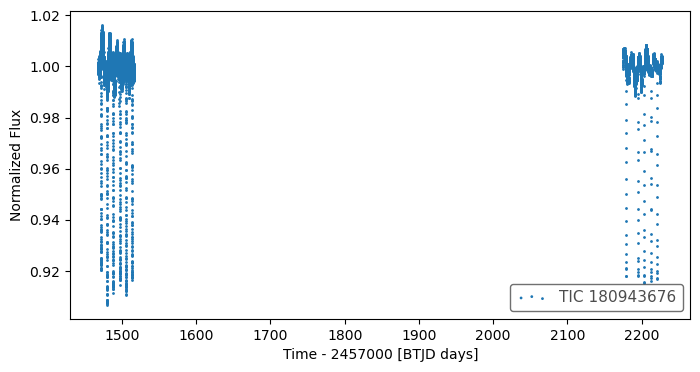

In [5]:
%matplotlib inline
# %matplotlib widget

# mask out data you don't like...

fig, ax = plt.subplots(figsize=figsize)
search_result.scatter(ax = ax)

# t0 = 2337.376
# period_triple = 0.774

mask = time < 0  # (time > 2893.16-1) & (time < 2893.16+1) 

time = time[~mask]
flux = flux[~mask]
fluxerr = fluxerr[~mask]

# make sure that therte are no nans!

finite_mask = np.isfinite(time) * np.isfinite(flux) * np.isfinite(fluxerr)

# make a dictionary of the data 

data = pd.DataFrame({'time': time[finite_mask], 'flux': flux[finite_mask], 'err': fluxerr[finite_mask]})


In [ ]:
do_bls = True

if do_bls:
    if not "../.." in sys.path:
        sys.path.append("../..")
    import lightkurve_ext_pg_runner as lke_pg_runner  # at ../../

    bls_result = lke_pg_runner.run_bls(
        search_result.remove_nans(),
        pg_kwargs=dict(
            minimum_period=1, maximum_period=20,
            frequency_factor=1,            
            duration=[3.4957 / 24 * f for f in [0.975, 1, 1.025, 1.05, 1.1, 1.15,]],  # based on observed primary eclipse duration for better fit
        ),
    )
    !$NOTIFY_CMD  "BLS Done"

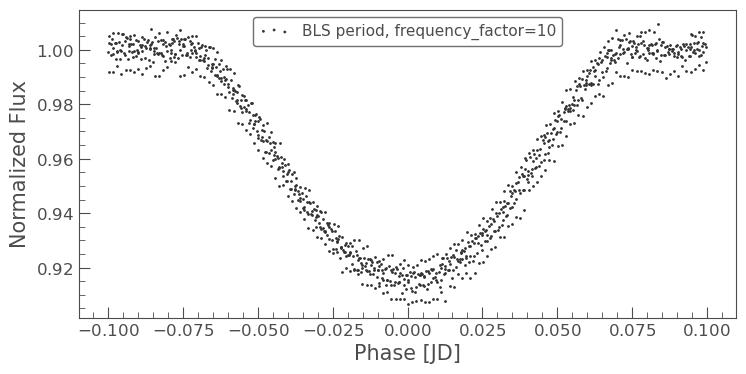

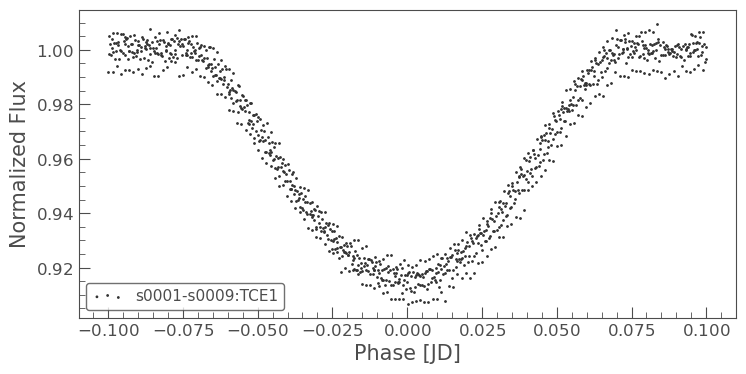

In [15]:
# Visaully compare different candidate period
ax = search_result.normalize().fold(epoch_time=1471.4196, period=8.418132651611877).truncate(-0.1, 0.1).scatter(label="BLS period, frequency_factor=10");  # HWHM 0.001571020094789155
ax = search_result.normalize().fold(epoch_time=1471.4196, period=8.418147).truncate(-0.1, 0.1).scatter(label="s0001-s0009:TCE1");

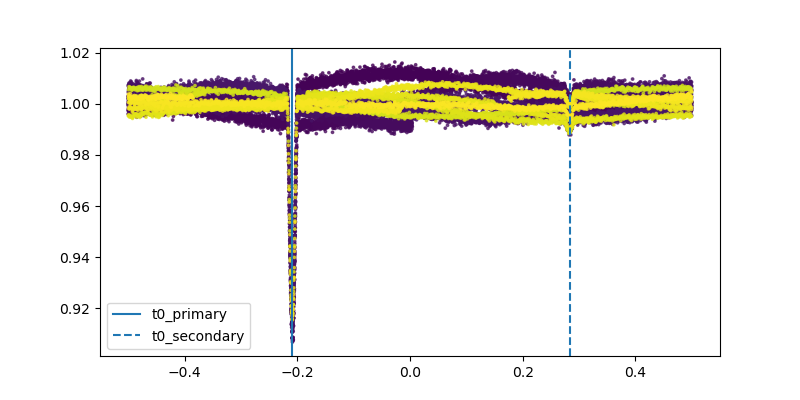

In [15]:
%matplotlib inline
# %matplotlib widget

# define the orbital period and the t0 

# FILL-IN THE eclipse epoch / period, 
# epoch=1471.4196, duration_hr=3.4957, period=8.418147, label="s0001-s0009:TCE1",
# epoch=1475.5596, duration_hr=3.5877, period=8.418509, label="s0001-s0009:TCE2",
period = 8.418147

t0_primary = 1471.4196
t0_secondary = 1475.5596

duration_hr_primary = 3.4957  # used for the window to cut the lighcurve around eclipses in later cells
duration_hr_secondary = 3.5877


t0_for_plotting = 0  # keep 0 for plotting purposes
# t0_for_plotting = t0_primary - np.abs(t0_primary - t0_secondary) * 0.25  # use a custom one so that the eclipses are not near the edge (-0.5 or +0.5)

phase = etv_functions.phase_data(data['time'], t0_for_plotting, period)

fig, ax = plt.subplots(figsize = (8,4))

plt.scatter(phase,data['flux'], s = 3, alpha = 0.7, c = data['time'])

# add the phase to the dataframe
data['phase'] = phase

plt.axvline(etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0], label="t0_primary")
if t0_secondary is not None:
    plt.axvline(etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0], linestyle="--", label="t0_secondary")
plt.legend()
# plt.ylim(0.535, 0.55)
# plt.xlim(-0.5, 0.1)
plt.show();

### Now that the data is ready we can start 

In [14]:
# show data to visualize what's changed in each step below
data  

,time,flux,err,phase
0,1468.274029,1.000600,0.001243,0.417723
1,1468.275418,1.000401,0.001243,0.417888
2,1468.276807,1.000403,0.001243,0.418053
3,1468.278196,1.001733,0.001244,0.418218
4,1468.279585,1.001345,0.001244,0.418383
...,...,...,...,...
37864,2227.540171,1.002541,0.000552,-0.388302
37865,2227.547115,1.003185,0.000552,-0.387477
37866,2227.554059,1.002917,0.000552,-0.386652
37867,2227.561003,1.002231,0.000552,-0.385827


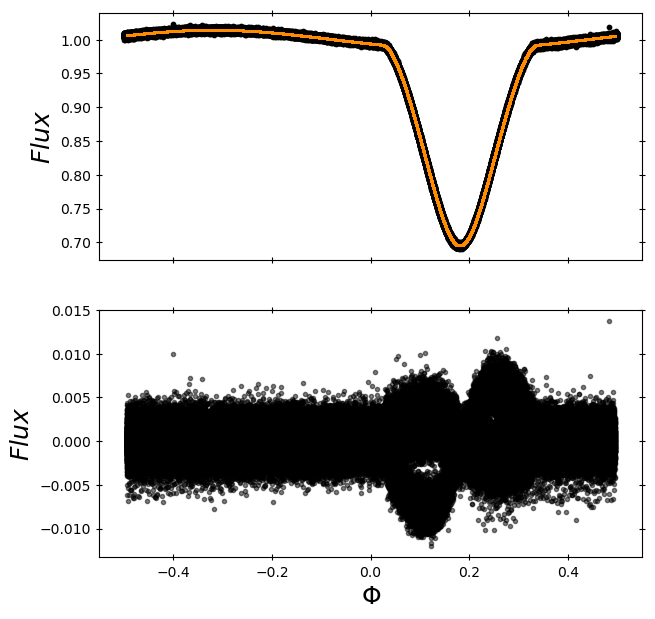

,time,flux,err,phase,flux_sub_binary,binary_model
0,2036.277928,0.992195,0.001203,-0.000954,-0.002081,0.994276
1,2036.280706,0.992246,0.001204,0.003178,-0.001719,0.993965
2,2036.282095,0.994305,0.001205,0.005244,0.000492,0.993814
3,2036.283484,0.990921,0.001204,0.007310,-0.002748,0.993669
4,2036.284872,0.993279,0.001203,0.009376,-0.000252,0.993531
...,...,...,...,...,...,...
269128,3178.449947,0.991693,0.001013,-0.000091,-0.002517,0.994210
269129,3178.452262,0.993297,0.001013,0.003353,-0.000655,0.993952
269130,3178.454577,0.990698,0.001013,0.006796,-0.003006,0.993705
269131,3178.456892,0.992573,0.001014,0.010239,-0.000900,0.993473


In [65]:
# phase fold the data and create an appoximate binary model (top) and subtract it from the data (bottom)
#_, _ , flux_sub_binary, model, _, _ = etv_functions.trend_removal_interact(period, 0, data['time'], data['flux'], data['time'], data['flux'])

data = etv_functions.trend_removal_interact(period, t0_for_plotting, data)
data

10 266425 901
reached the end
10 252115 901
reached the end
10 250236 901
reached the end
10 250000 901
reached the end
10 249956 901
reached the end


,time,flux,err,phase,flux_sub_binary,binary_model,flux_detrended
0,2036.277928,0.992195,0.001203,-0.000954,-0.002081,0.994276,0.993616
1,2036.280706,0.992246,0.001204,0.003178,-0.001719,0.993965,0.993663
2,2036.282095,0.994305,0.001205,0.005244,0.000492,0.993814,0.995718
3,2036.283484,0.990921,0.001204,0.007310,-0.002748,0.993669,0.992329
4,2036.284872,0.993279,0.001203,0.009376,-0.000252,0.993531,0.994683
...,...,...,...,...,...,...,...
269128,3178.449947,0.991693,0.001013,-0.000091,-0.002517,0.994210,0.992630
269129,3178.452262,0.993297,0.001013,0.003353,-0.000655,0.993952,0.994231
269130,3178.454577,0.990698,0.001013,0.006796,-0.003006,0.993705,0.991630
269131,3178.456892,0.992573,0.001014,0.010239,-0.000900,0.993473,0.993502


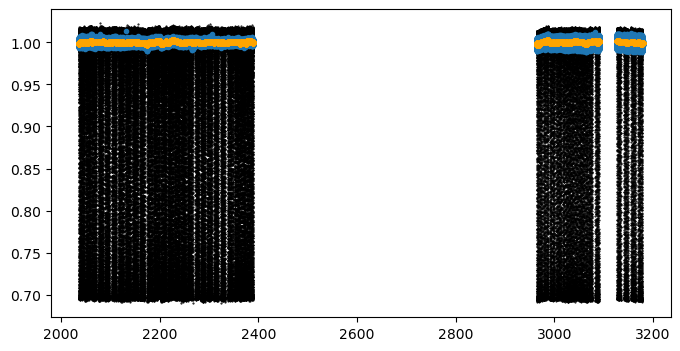

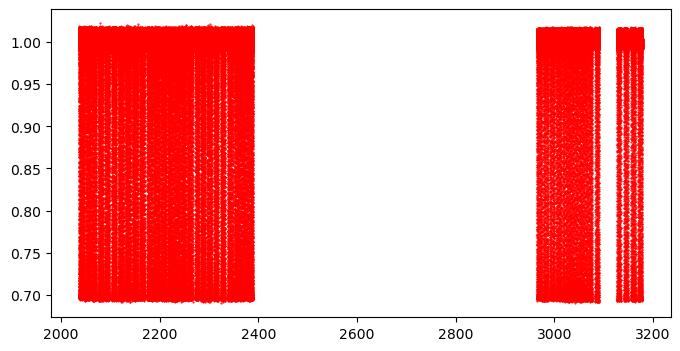

In [68]:
# if you want to detrend the data run this line!

data = etv_functions.detrend_suz(data, T_dur = 10, plot = True)
data

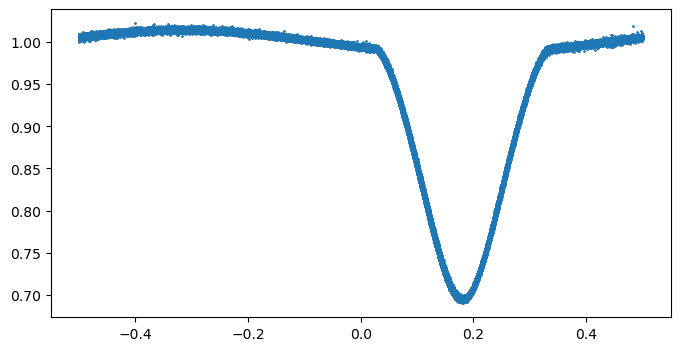

In [69]:
# plot the phase folded data here so that you know at what phase you want to cut the data to model 
fig, ax = plt.subplots(figsize = figsize)
plt.scatter(data.phase, data.flux_detrended, s = 1)
plt.show()

Primary:   2036.4003 0.18107699241803732
window_width_p (phase): 0.1735437079745317


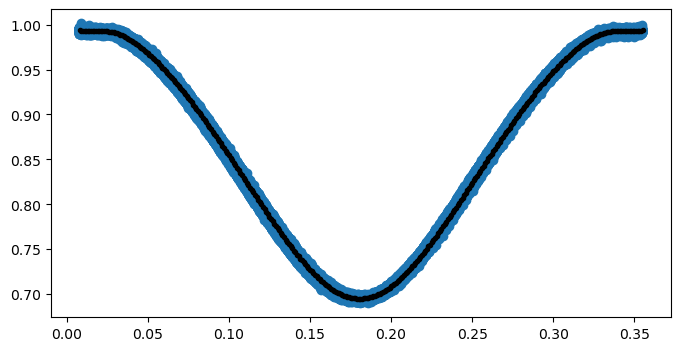

In [72]:
# define the midpoints of the primary and secondary eclipses and the window width

# if these don't look central - change them!! the eclipses should be central
midpoint_p =  etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0]  # convet to time in phase
print('Primary:  ', t0_primary, midpoint_p)

# change depending on the width of the eclipses, default to be slightly larger than the primary eclipse
window_width_p = 1.4 * duration_hr_primary / 24 / period
print("window_width_p (phase):", window_width_p)

data_primary = data[(data['phase'] > midpoint_p - window_width_p) & (data['phase'] < midpoint_p + window_width_p) ]
ph_binned,flux_binned,err_binned = etv_functions.run_binning_phased(data_primary.phase, data_primary.flux, yerr=data_primary.err,nbins=1000)


# -- -- -- -- -- -- -- -- -- 

fig = plt.subplots(figsize=figsize, sharex=True)
plt.errorbar(ph_binned, flux_binned, yerr=err_binned, fmt=".k", capsize=0, zorder = 2)
plt.scatter(data_primary.phase, data_primary.flux, zorder = -2)
plt.show()

if t0_secondary is not None:
    midpoint_s =  etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0]
    print('Secondary:', t0_secondary, midpoint_s)
    
    window_width_s = 1.2 * duration_hr_secondary / 24 / period
    print("window_width_s (phase):", window_width_s)
    
    data_secondary = data[(data['phase'] > midpoint_s - window_width_s) & (data['phase'] < midpoint_s + window_width_s) ]
    ph_binned_s,flux_binned_s,err_binned_s = etv_functions.run_binning_phased(data_secondary.phase, data_secondary.flux, yerr=data_secondary.err,nbins=1000)

    # -- -- -- -- -- -- -- -- -- 
    fig = plt.subplots(figsize=figsize, sharex=True)
    plt.errorbar(ph_binned_s, flux_binned_s, yerr=err_binned_s, fmt=".k", capsize=0, zorder = 2)
    plt.scatter(data_secondary.phase, data_secondary.flux, zorder = -2)
    plt.show() 

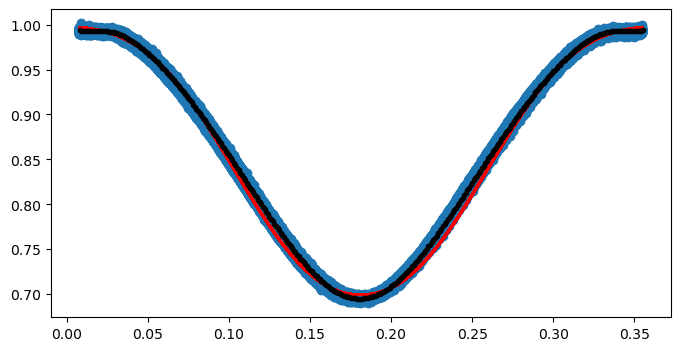

In [71]:
### # you need initial guesses!! The order is :
# alpha0, alpha1, t0, d, Tau - CHANGE THESE TO YOUR OWN INITIAL GUESSES
# median flux, -eclipse depth, t0, related to duration, related to shape (U or V) 
# t0 in normalixed phase
start_vals = [1, -0.3, midpoint_p, 0.07, 1.1]
start_vals_s = None # [1, -0.45, midpoint_s, 0.012, 1.2]

# - - -- - 

etv_functions.plot_initial_guess(data_primary, ph_binned, flux_binned, err_binned, *start_vals)
if t0_secondary is not None:
    etv_functions.plot_initial_guess(data_secondary, ph_binned_s, flux_binned_s, err_binned_s, *start_vals_s)


100%|██████████████████████████████████████████████████████████| 1000/1000 [15:05<00:00,  1.10it/s]


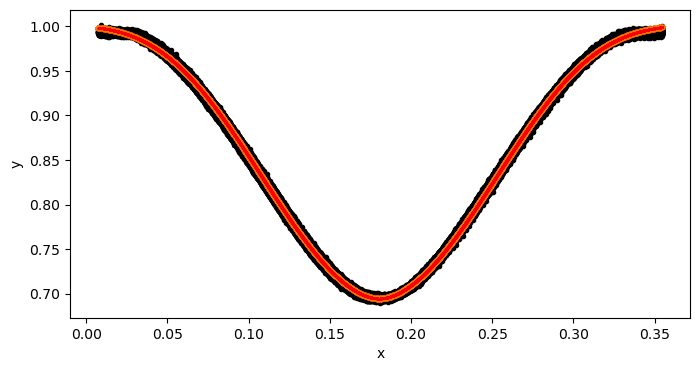

In [73]:
# run the initial model fit using MCMC for the primary and secondary eclipses 

mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau = etv_functions.run_mcmc_initial_fit(data_primary, start_vals, nruns = 1000, plot_chains = False, plot = True)
if t0_secondary is not None:
    mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s = etv_functions.run_mcmc_initial_fit(data_secondary, start_vals_s, nruns = 1000, plot_chains = False, plot = True)
!$NOTIFY_CMD "Initial fit done"

1699

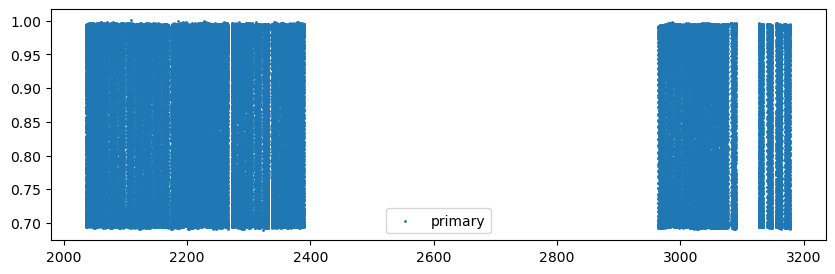

In [74]:
fig = plt.subplots(figsize=(10, 3), sharex=True)
plt.scatter(data_primary.time,data_primary.flux , s = 1, label = 'primary')
if t0_secondary is not None:
    plt.scatter(data_secondary.time,data_secondary.flux , s = 1, label = 'secondary')
plt.legend()

# calculate the number of transits there are within the data 
n_transits = int((max(data_primary.time) - min(data_primary.time)) / period)
n_transits

2036.4003 0.672261 2036.4003


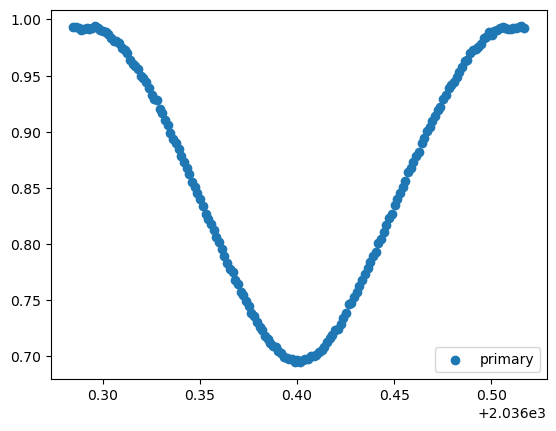

2036.4003 0.672261 2037.072561


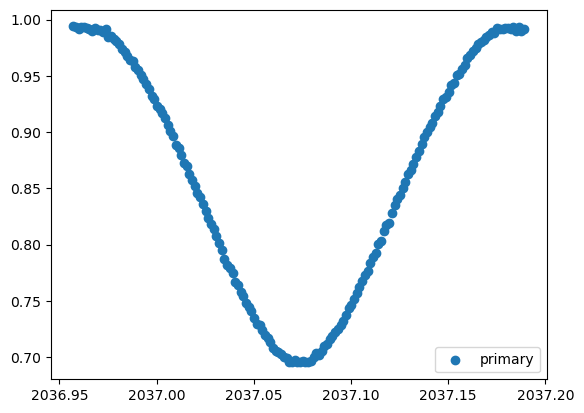

2036.4003 0.672261 2037.744822


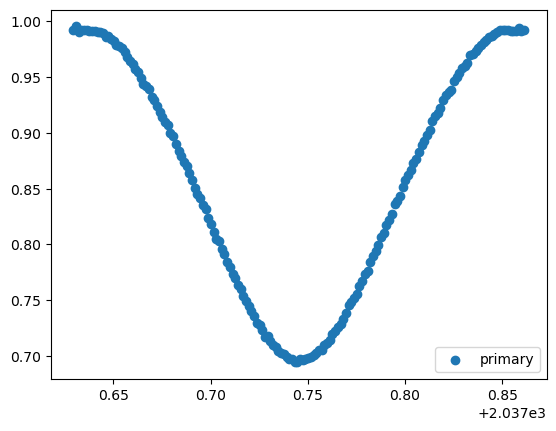

In [75]:
tr_index = range(0,n_transits)

for i in tr_index[0:3]:        
    transit_time = t0_primary+(period*i)
    x = np.array(data_primary.time)
    y = np.array(data_primary.flux) 
    yerr = np.array(data_primary.err)
    
    print (t0_primary, period, transit_time)
    
    mask = (x > (transit_time - (0.2*period))) & (x < (transit_time + (0.2*period))) 
    
    x = np.array(x[mask])
    y = np.array(y[mask]) 
    yerr = np.array(yerr[mask])
    fig, ax = plt.subplots()
    plt.scatter(x,y, label="primary")
    plt.legend(loc="lower right")
    plt.show()
    

if t0_secondary is not None:
    for i in tr_index[0:3]:        
        transit_time = t0_secondary+(period*i)
        x = np.array(data_secondary.time)
        y = np.array(data_secondary.flux) 
        yerr = np.array(data_secondary.err)
        
        print (t0_secondary, period, transit_time)
        
        mask = (x > (transit_time - (0.2*period))) & (x < (transit_time + (0.2*period))) 
        
        x = np.array(x[mask])
        y = np.array(y[mask]) 
        yerr = np.array(yerr[mask])
        fig, ax = plt.subplots()
        plt.scatter(x,y, label="secondary")
        plt.legend(loc="lower right")
        plt.show()

In [76]:
print("Primary   - Start params")
print(*start_vals)
print("Primary   - Initial params")
print(mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau)

if t0_secondary is not None:
    print("Secondary - Start params")
    print(*start_vals_s)
    print("Secondary - Initial params")
    print(mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s)

Primary   - Start params
1 -0.3 0.18107699241803732 0.07 1.1
Primary   - Initial params
1.0019893158108606 -0.3074318350805525 0.18030609273784778 0.07313067337191818 0.9099527924331019


Fitting individual primary eclipses...
Creating new manifest file
2036.4003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


  0%|                                                                    | 0/10000 [00:00<?, ?it/s]C:\pkg\_winNonPortables\miniforge3\envs\my_lk_plus\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in scalar subtract
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1328.34it/s]


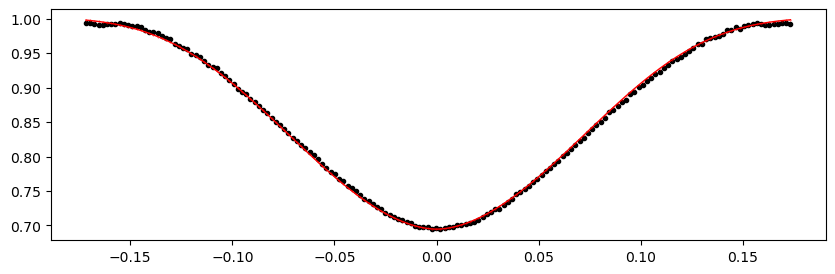

2037.072561 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1325.94it/s]


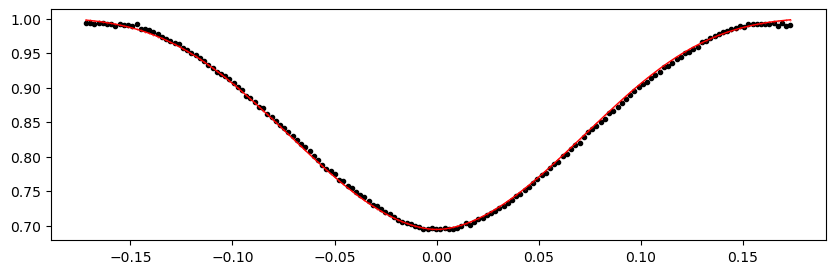

2037.744822 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.89it/s]


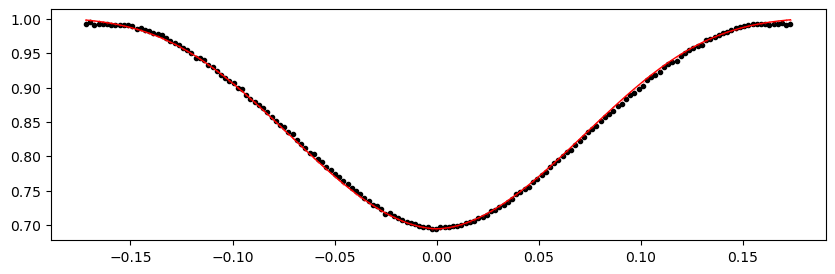

2038.417083 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.36it/s]


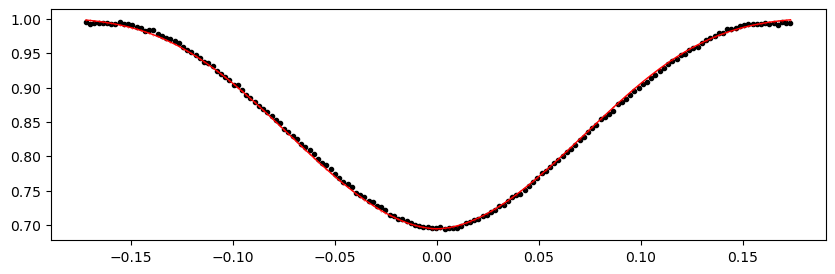

2039.089344 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.06it/s]


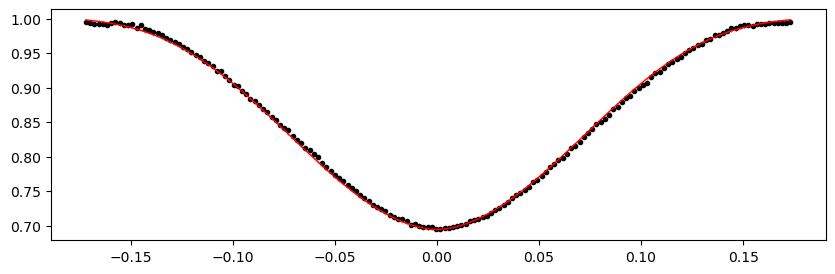

2039.761605 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.83it/s]


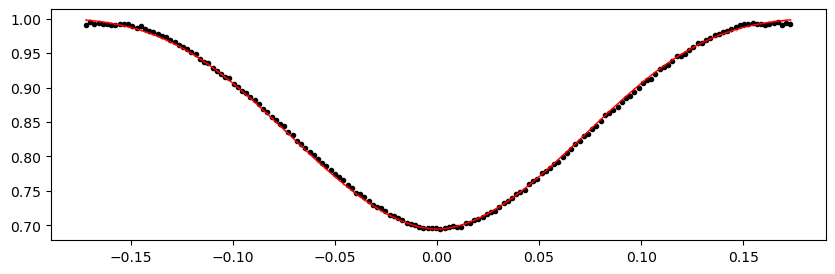

2040.433866 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.86it/s]


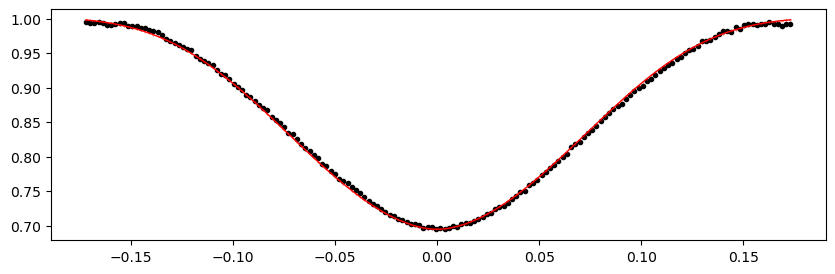

2041.106127 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.21it/s]


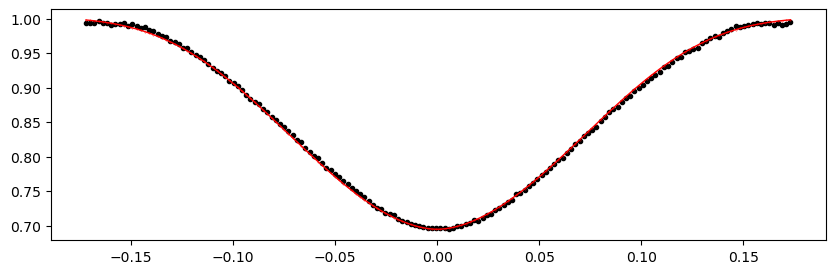

2041.778388 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.03it/s]


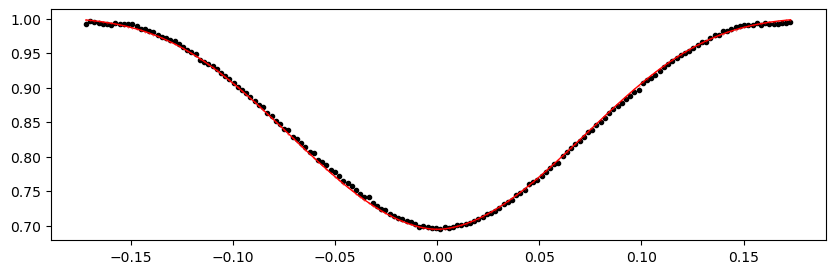

2042.450649 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.78it/s]


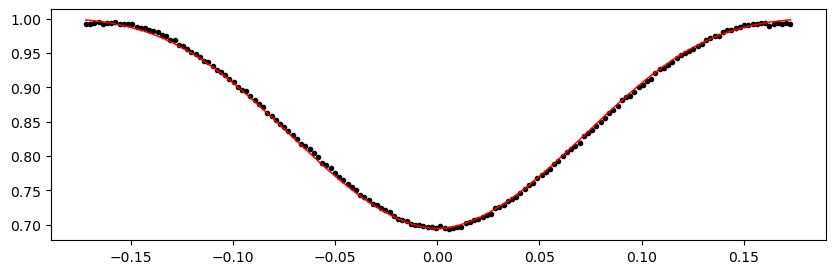

2043.12291 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.38it/s]


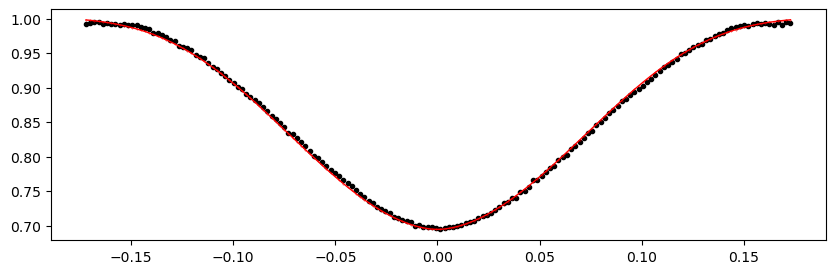

2043.795171 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.52it/s]


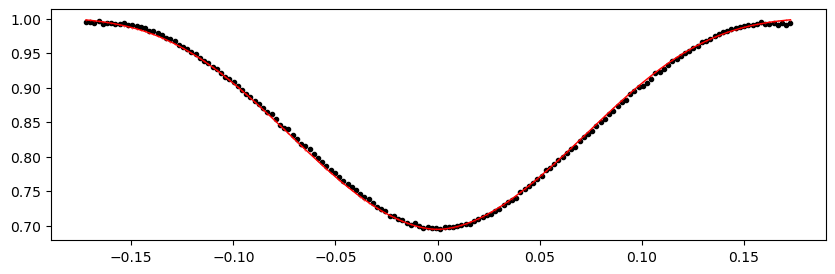

2044.467432 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.79it/s]


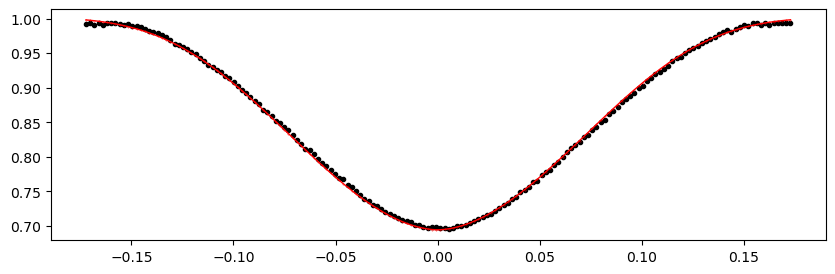

2045.139693 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.02it/s]


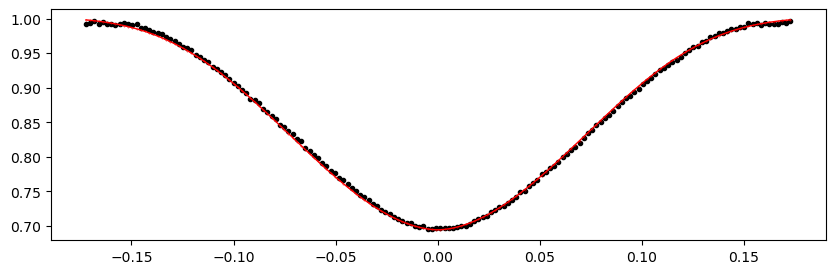

2045.811954 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.30it/s]


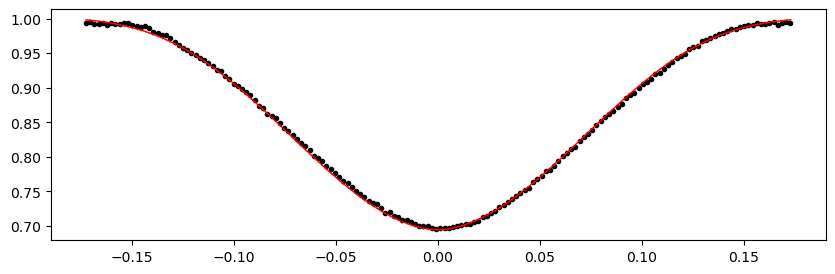

2046.484215 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.31it/s]


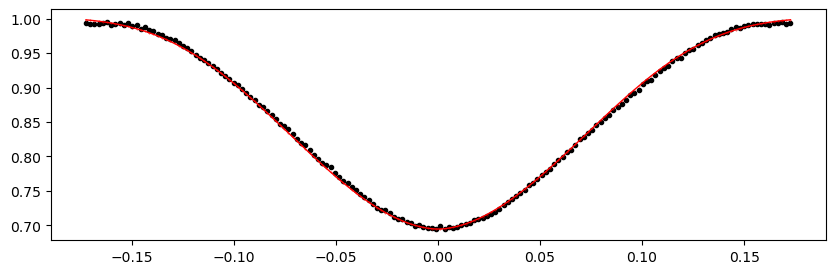

2047.156476 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.67it/s]


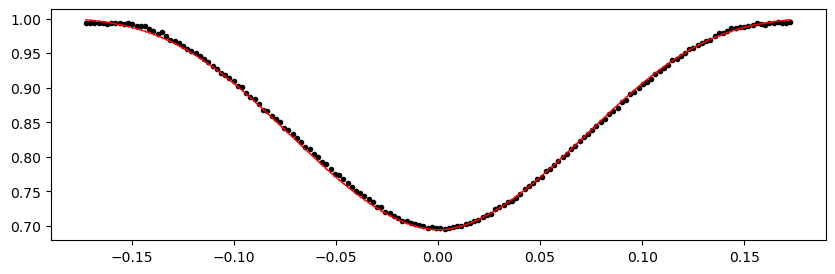

2047.828737 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.64it/s]


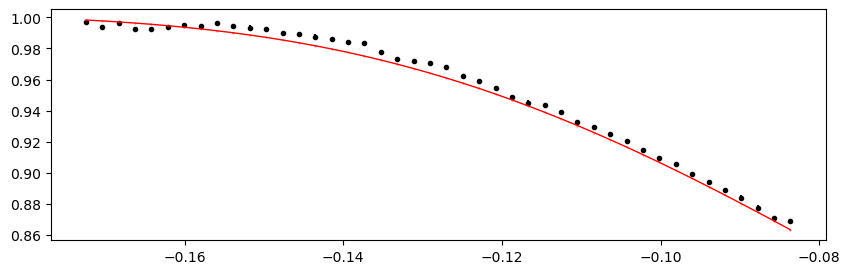

2049.173259 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.52it/s]


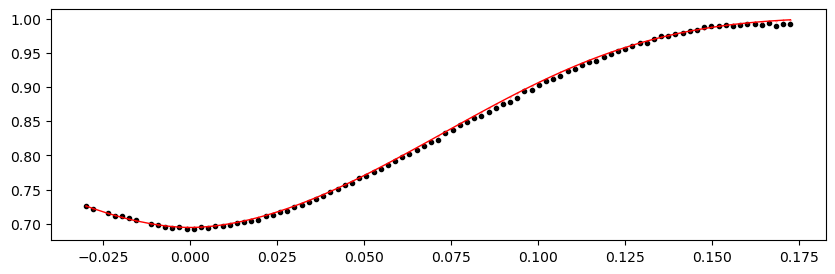

2049.84552 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.49it/s]


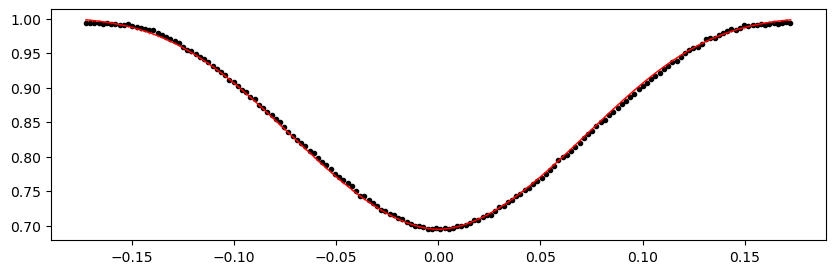

2050.517781 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.78it/s]


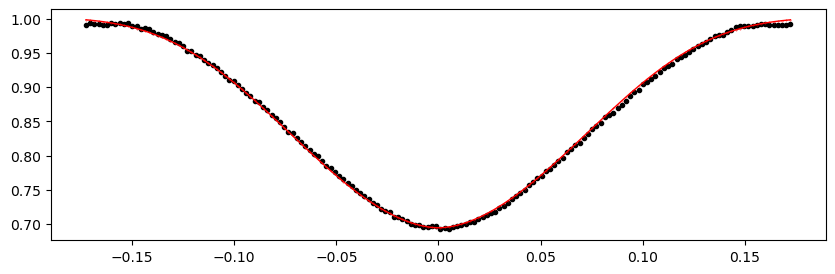

2051.190042 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.07it/s]


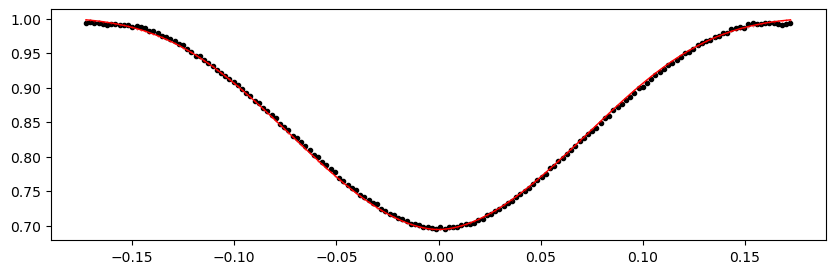

2051.862303 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.37it/s]


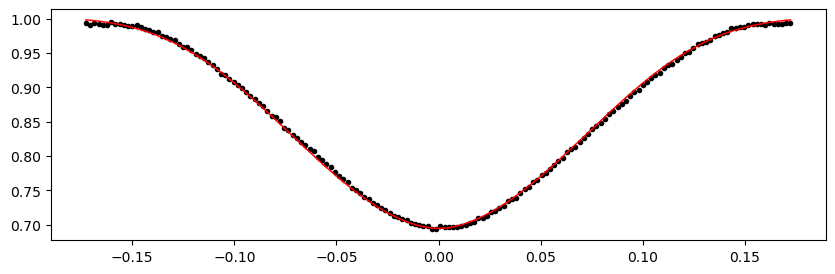

2052.534564 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1356.31it/s]


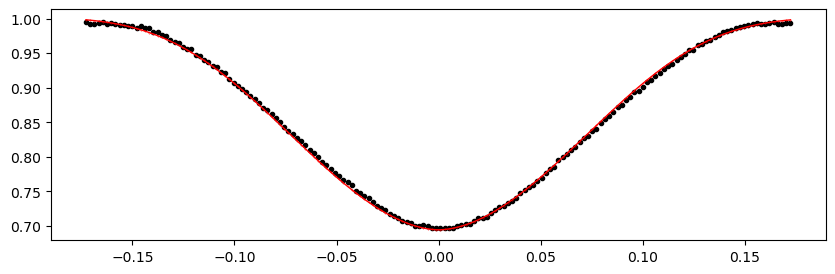

2053.206825 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1350.47it/s]


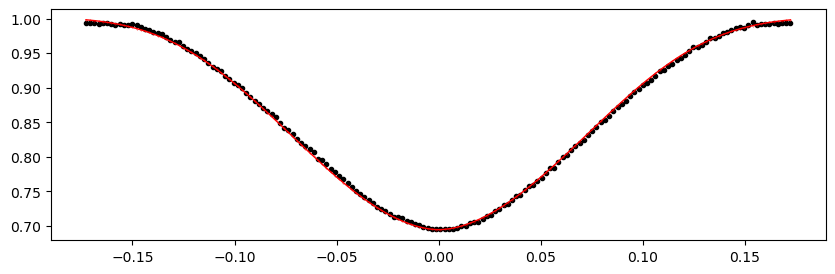

2053.879086 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.13it/s]


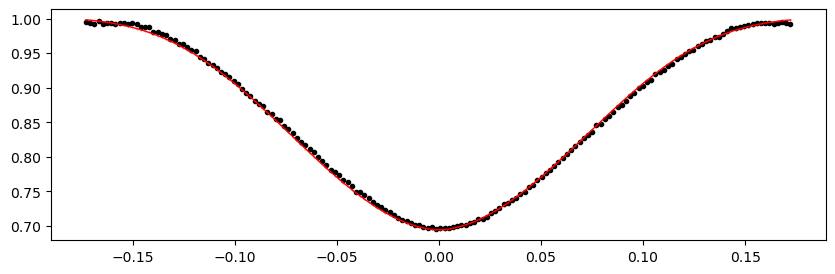

2054.551347 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.52it/s]


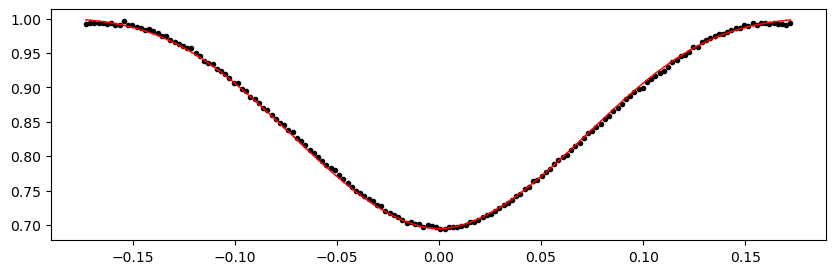

2055.2236080000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1313.26it/s]


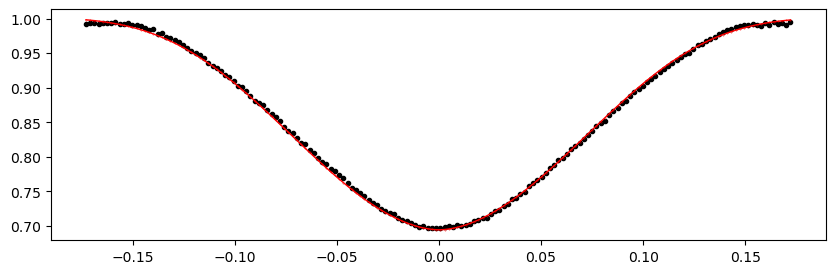

2055.895869 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1318.92it/s]


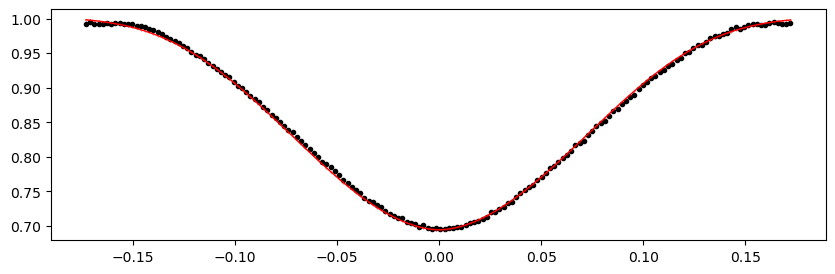

2056.56813 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.12it/s]


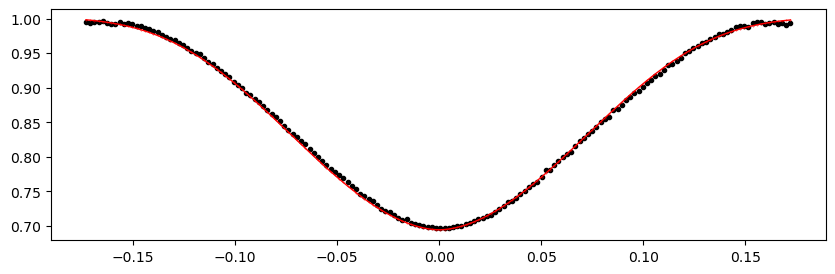

2057.240391 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.65it/s]


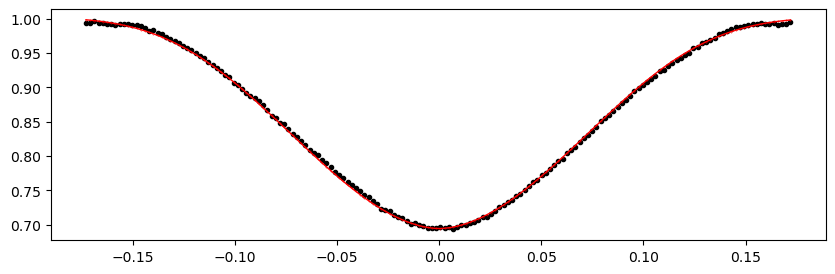

2057.912652 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.28it/s]


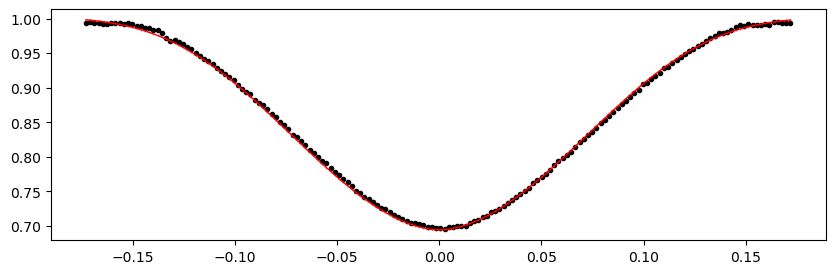

2058.584913 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.31it/s]


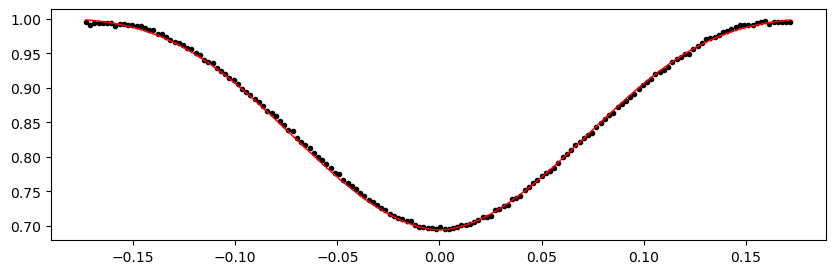

2059.257174 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.21it/s]


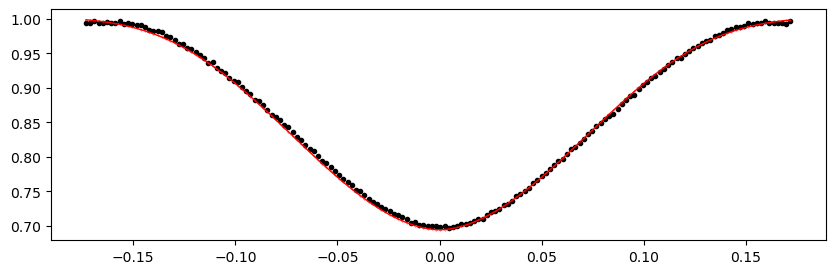

2059.929435 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.31it/s]


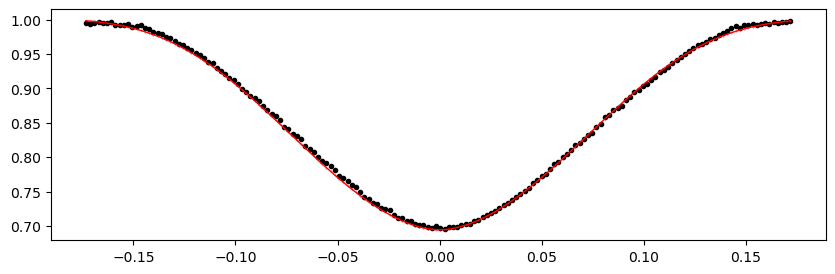

2060.601696 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1271.79it/s]


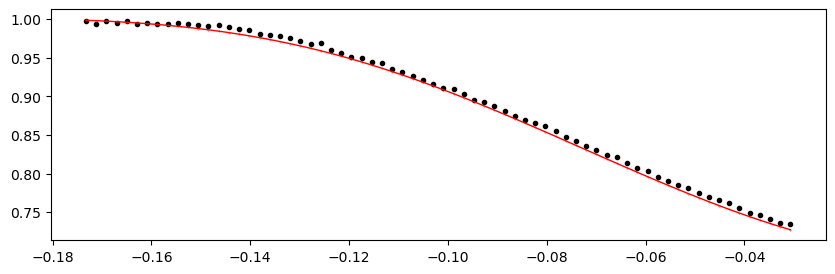

2061.946218 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1195.70it/s]


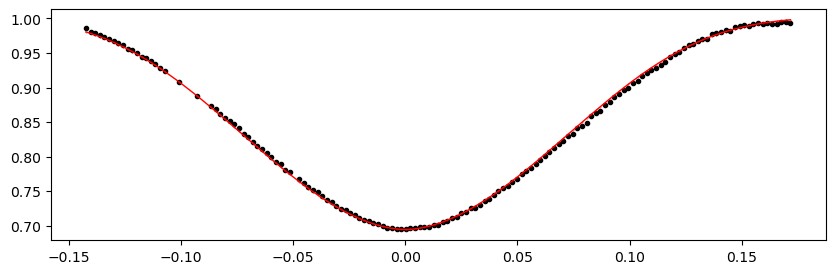

2062.618479 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1356.77it/s]


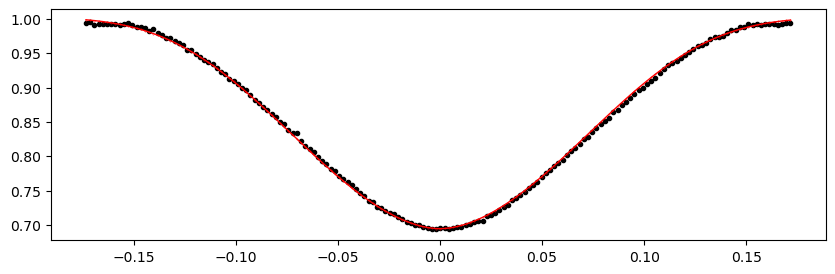

2063.29074 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.49it/s]


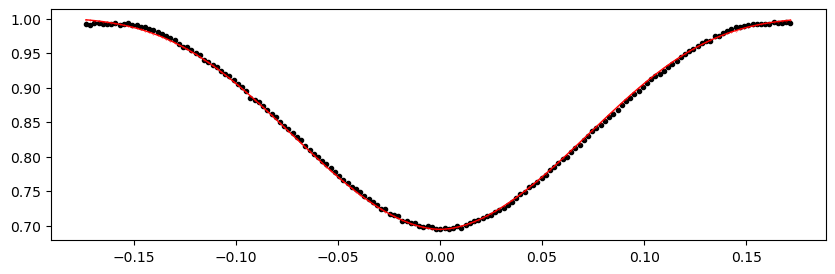

2063.963001 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.39it/s]


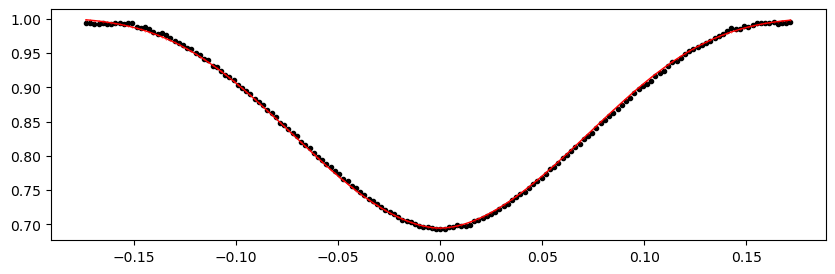

2064.6352620000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.73it/s]


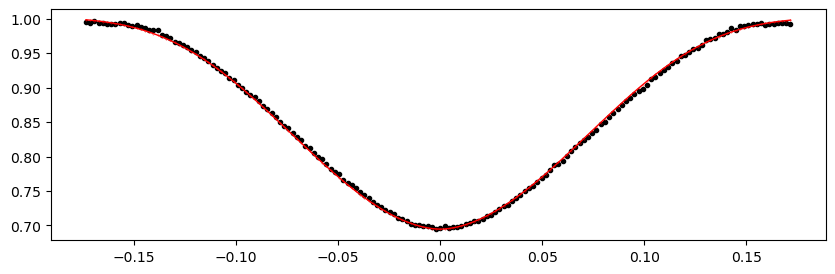

2065.307523 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1360.86it/s]


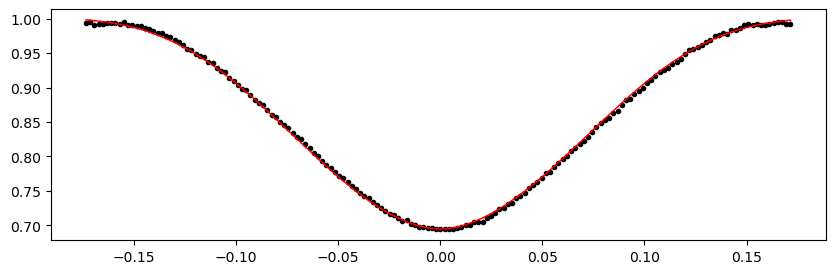

2065.979784 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1263.05it/s]


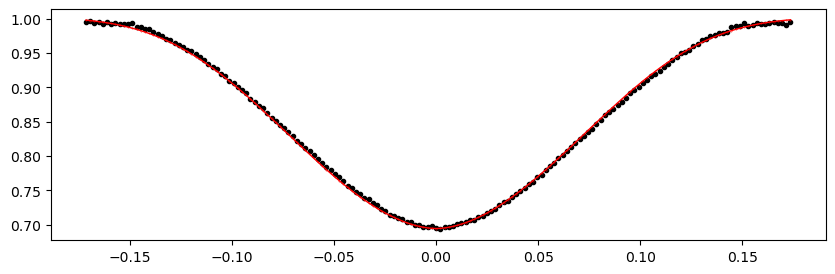

2066.652045 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:09<00:00, 1107.82it/s]


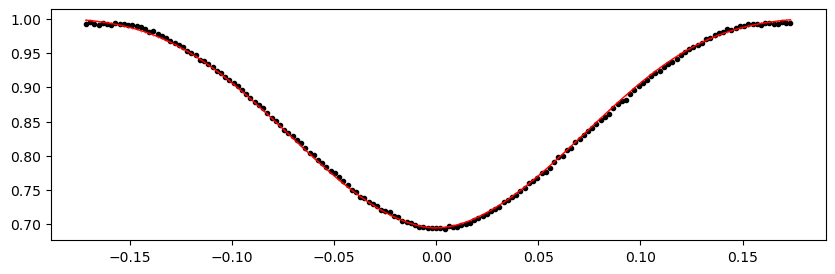

2067.324306 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1310.59it/s]


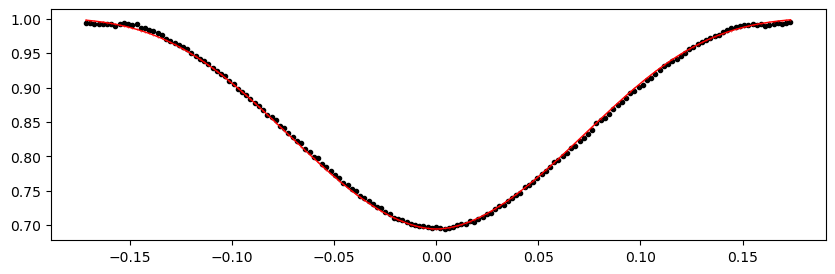

2067.996567 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.73it/s]


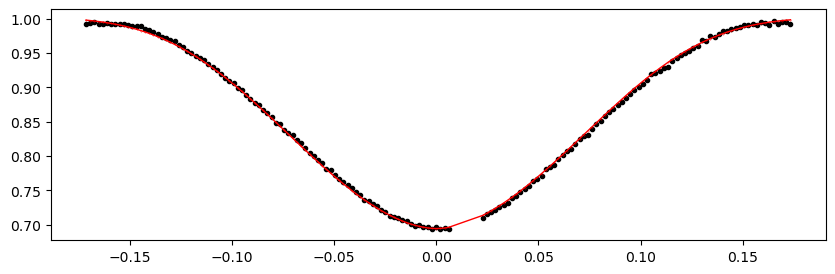

2068.668828 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1372.75it/s]


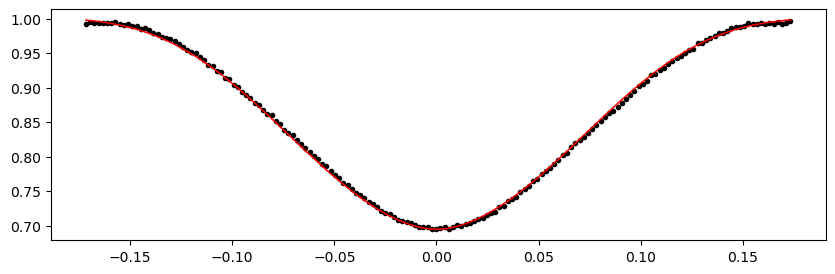

2069.341089 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.39it/s]


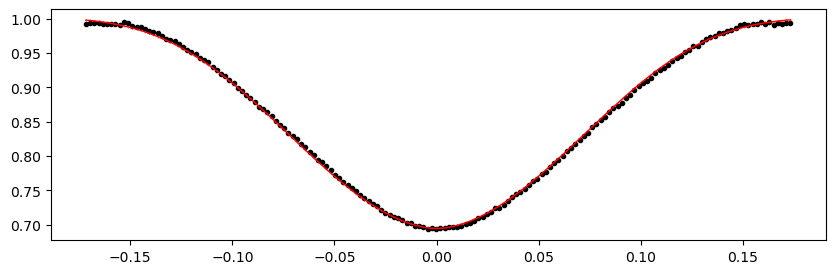

2070.01335 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1372.83it/s]


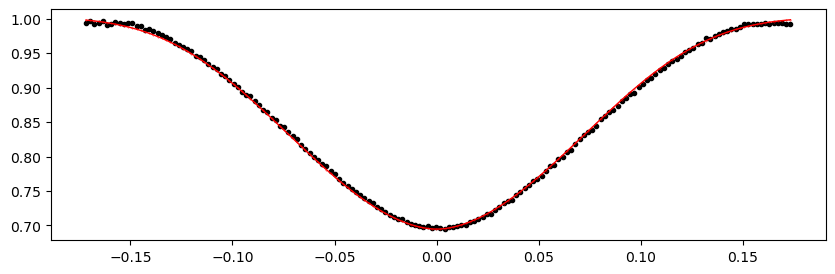

2070.685611 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1371.05it/s]


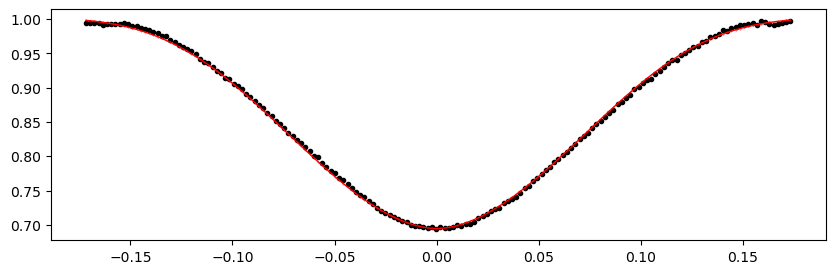

2071.357872 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1372.80it/s]


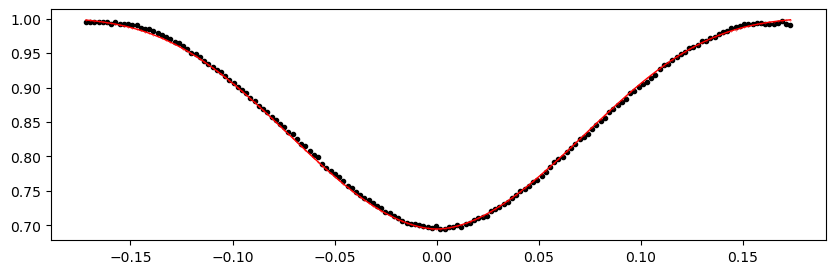

2075.391438 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1364.19it/s]


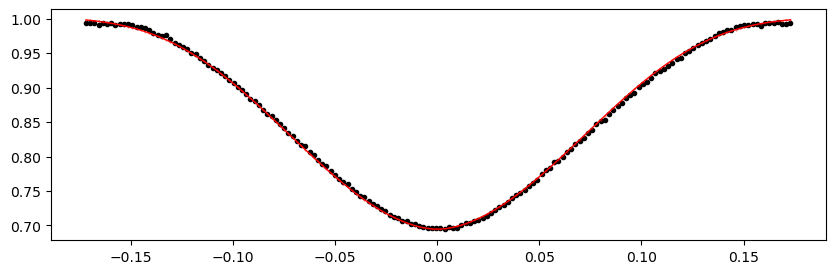

2076.063699 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.90it/s]


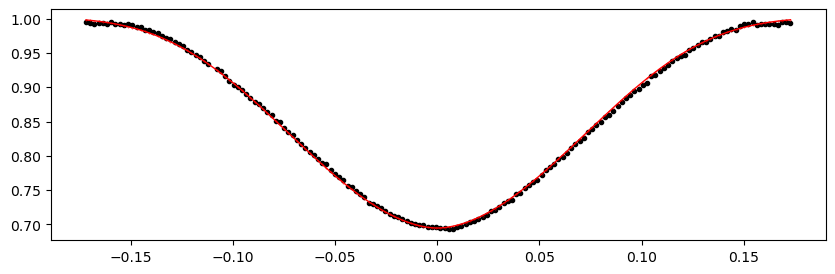

2076.73596 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.79it/s]


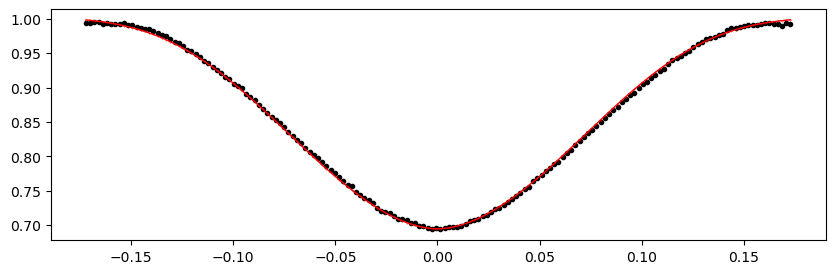

2077.408221 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.91it/s]


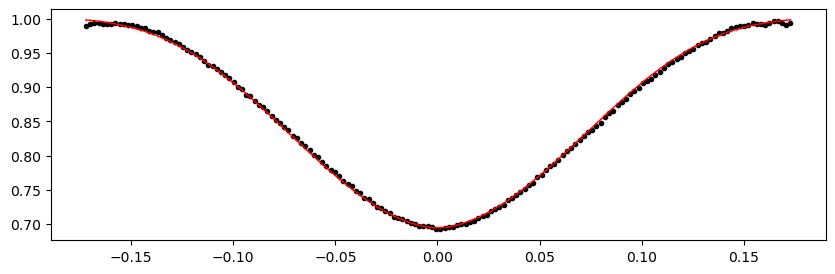

2078.080482 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.70it/s]


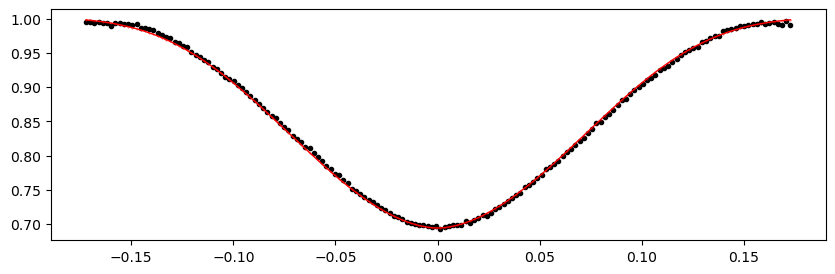

2078.752743 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.81it/s]


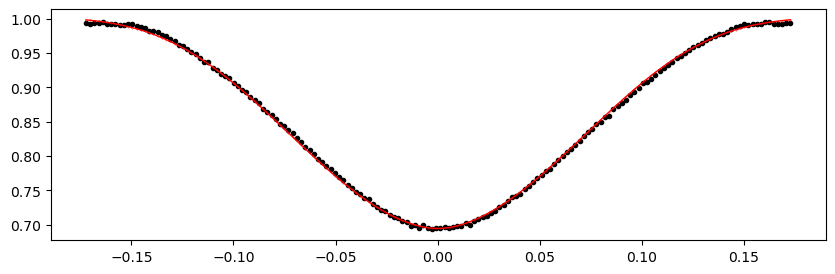

2079.425004 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1379.57it/s]


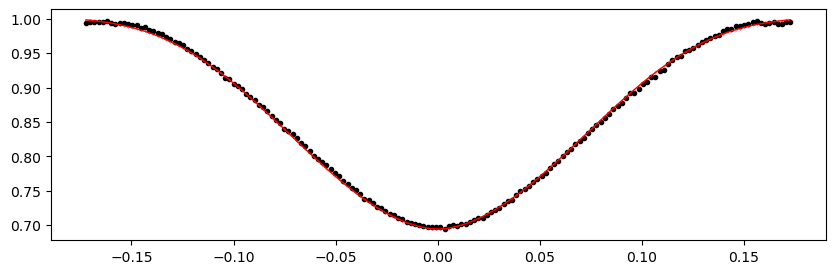

2080.097265 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1372.76it/s]


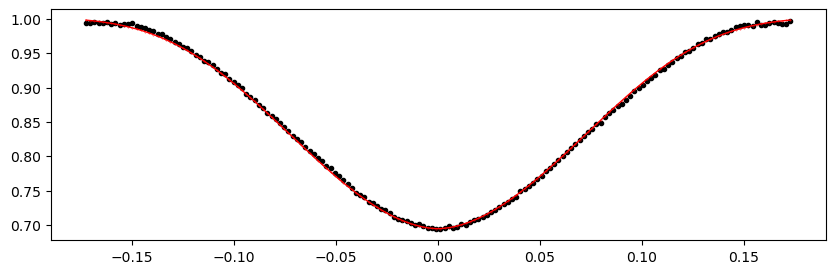

2080.769526 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.79it/s]


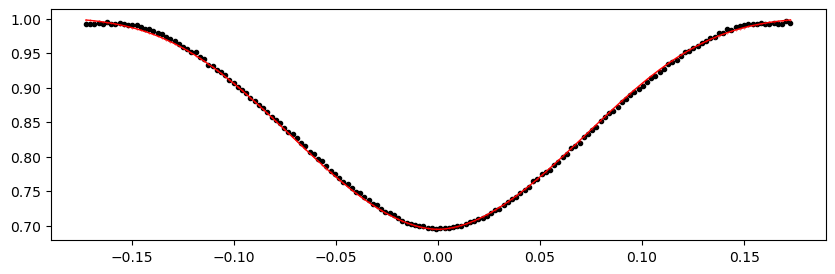

2081.441787 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.55it/s]


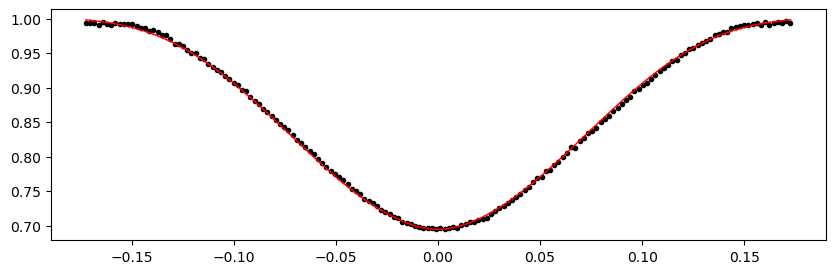

2082.114048 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.76it/s]


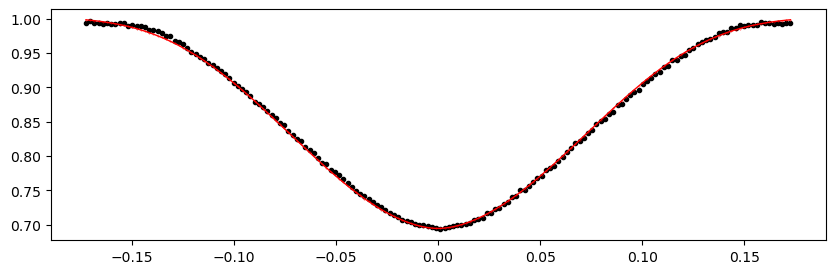

2082.786309 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.78it/s]


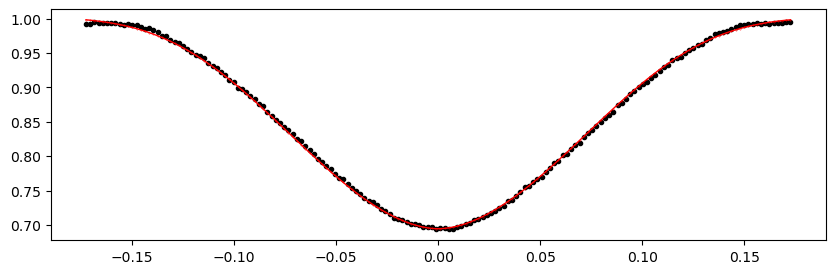

2083.4585700000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.83it/s]


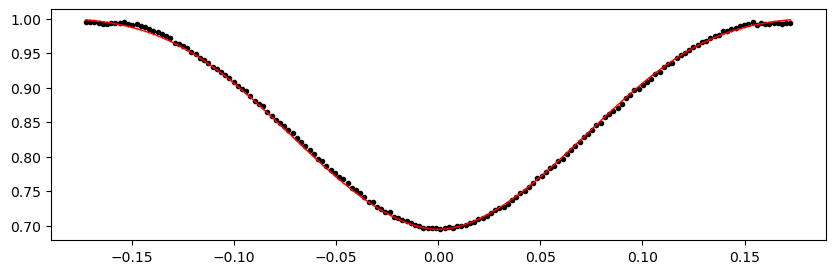

2084.130831 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1367.00it/s]


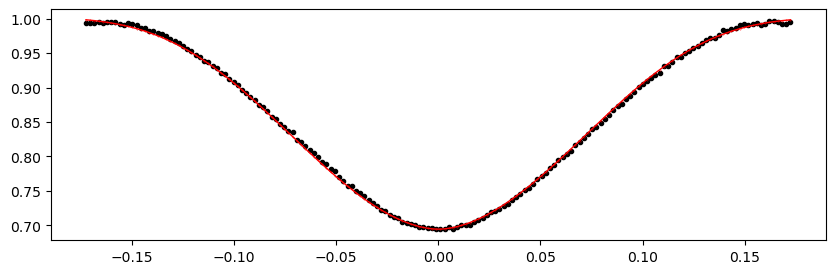

2084.803092 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1370.67it/s]


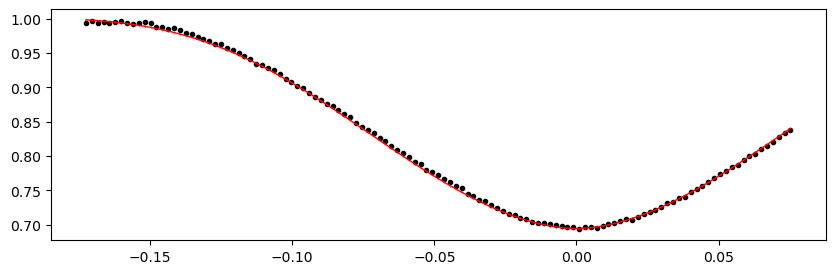

2085.475353 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1375.58it/s]


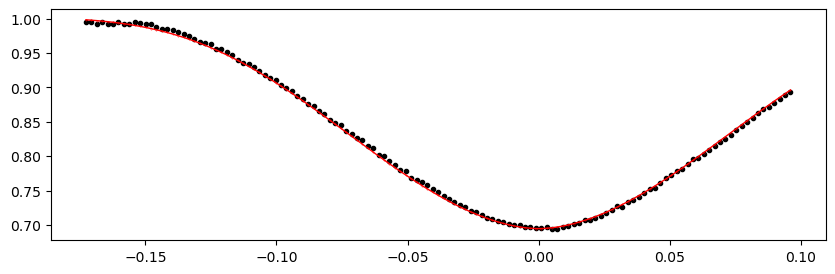

2088.164397 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1360.72it/s]


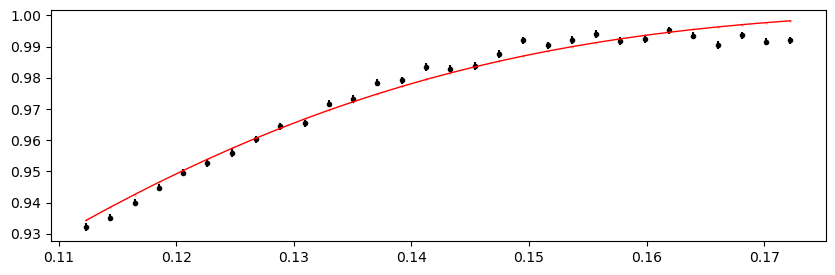

2088.836658 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.73it/s]


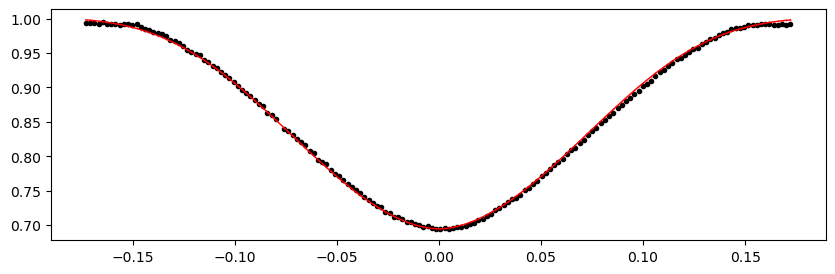

2089.508919 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1371.08it/s]


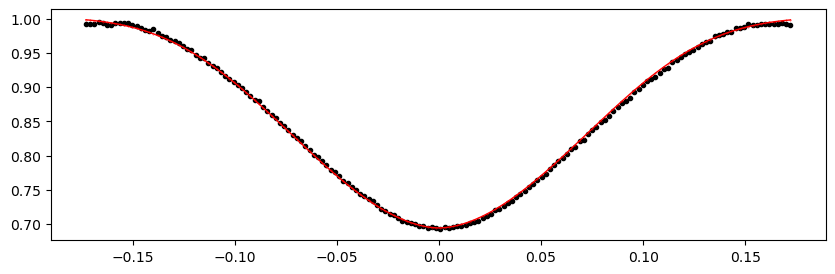

2090.18118 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1361.11it/s]


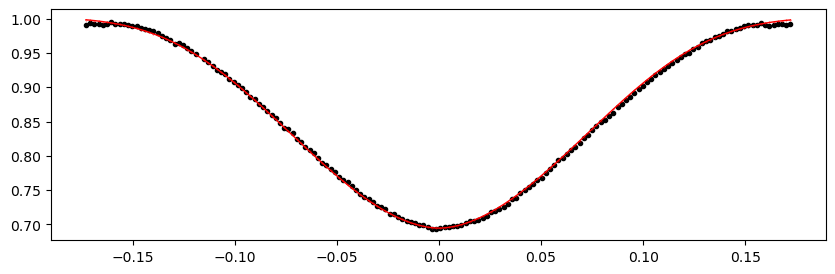

2090.853441 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.91it/s]


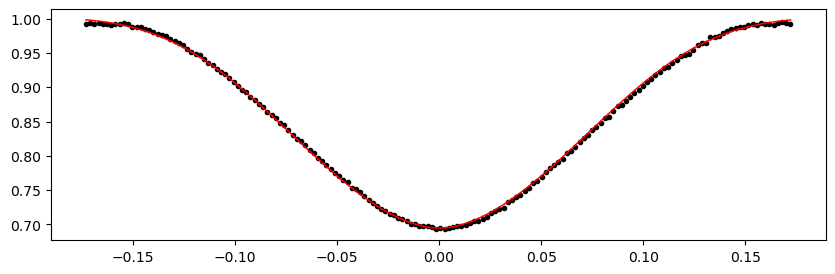

2091.525702 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.65it/s]


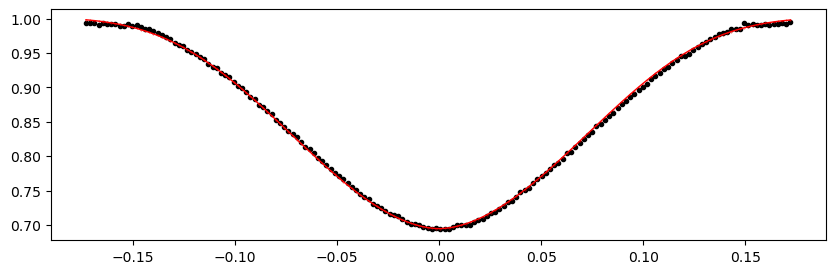

2092.197963 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.78it/s]


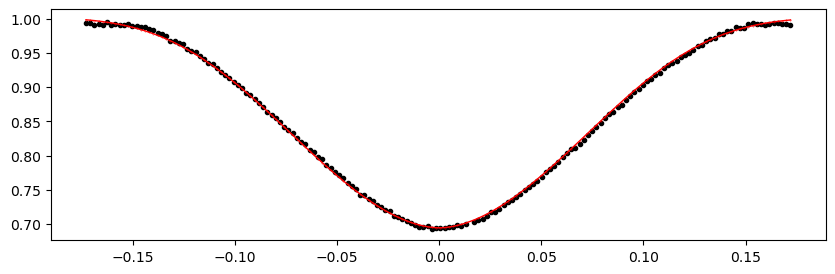

2092.8702240000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1375.73it/s]


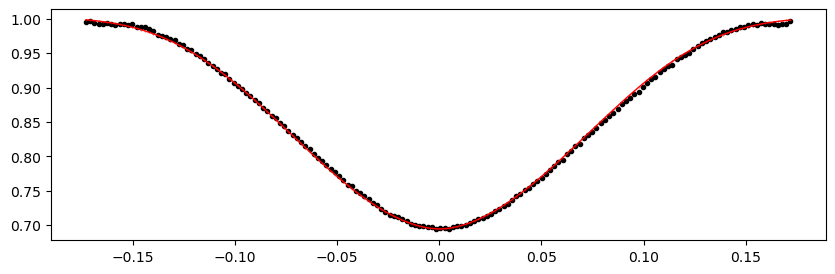

2093.542485 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.82it/s]


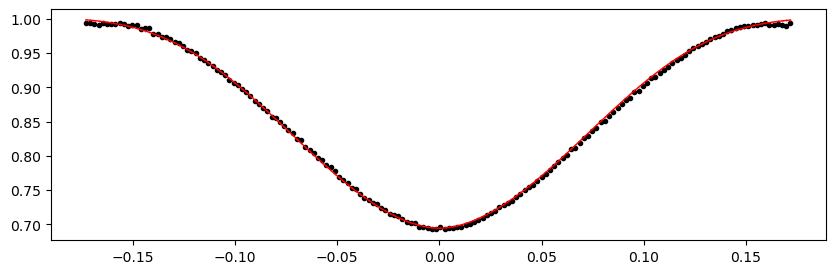

2094.214746 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1354.97it/s]


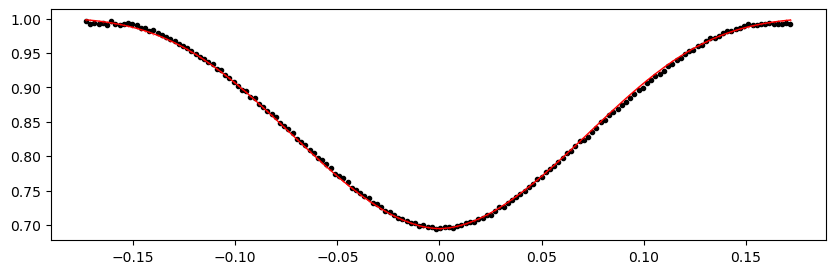

2094.887007 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|███████████████████████████████████████████████████████| 10000/10000 [00:10<00:00, 976.13it/s]


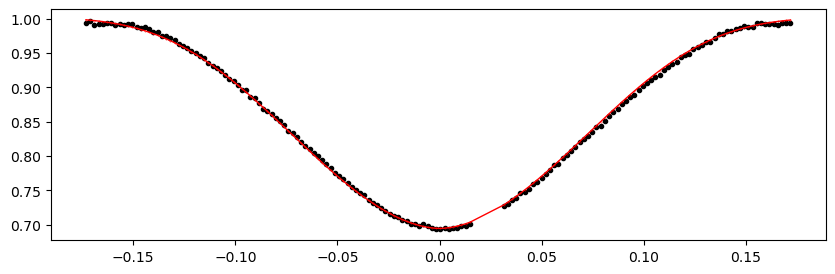

2095.559268 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:09<00:00, 1061.94it/s]


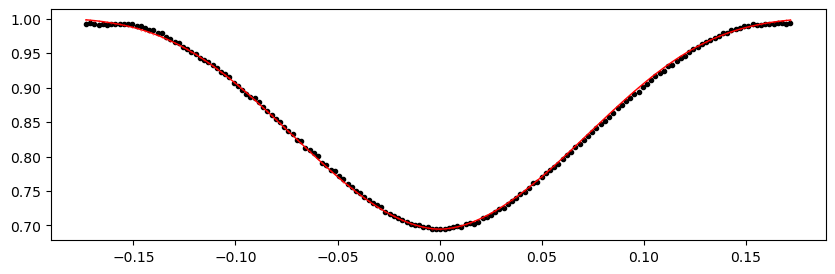

2096.231529 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1306.59it/s]


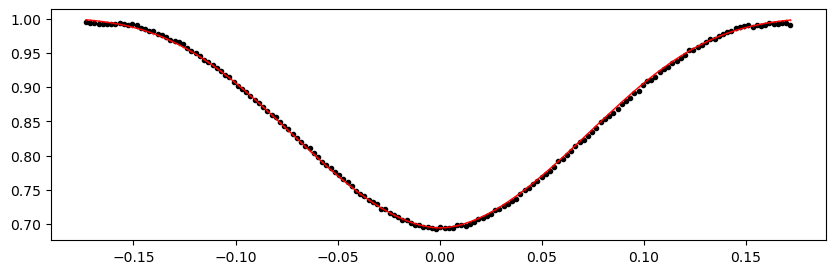

2096.90379 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1240.02it/s]


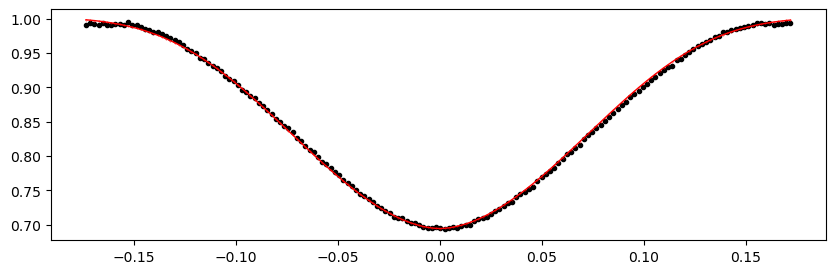

2097.576051 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1311.74it/s]


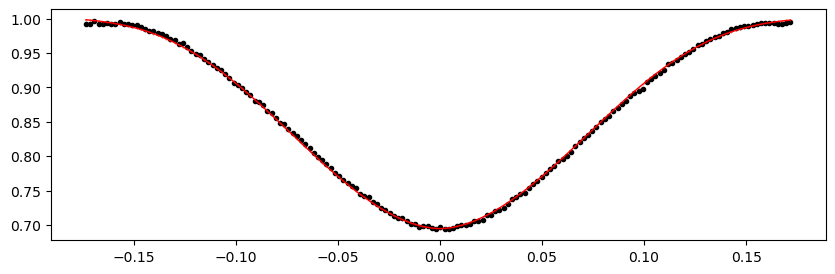

2098.248312 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1298.04it/s]


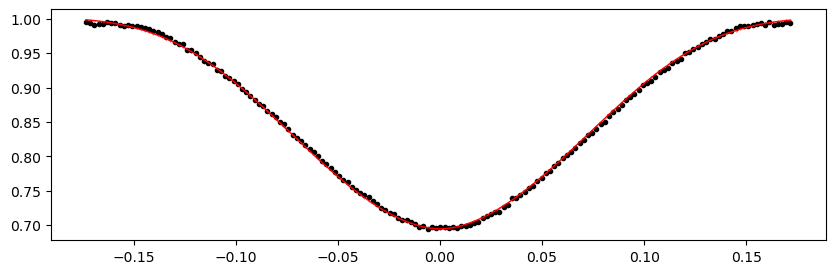

2102.2818780000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1301.79it/s]


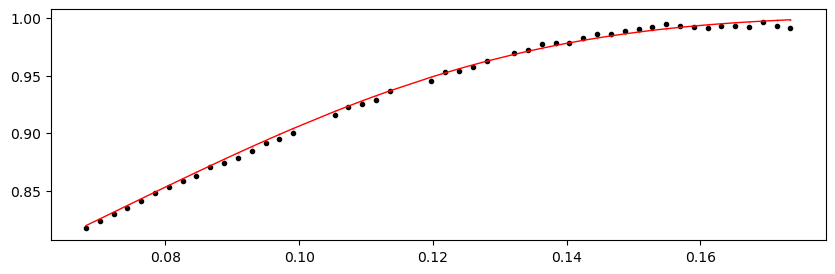

2102.954139 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1280.08it/s]


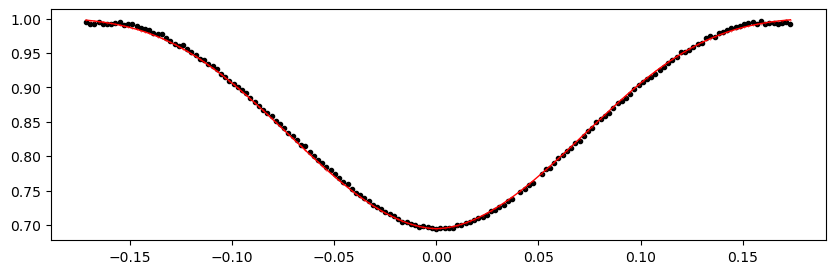

2103.6264 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1310.18it/s]


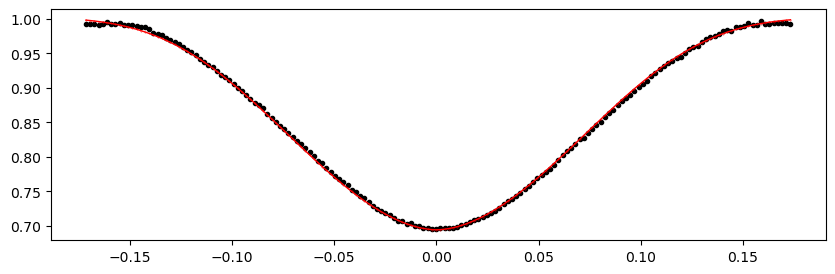

2104.298661 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1261.20it/s]


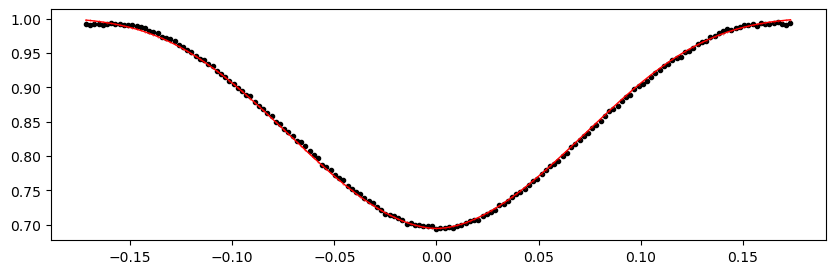

2104.970922 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1208.00it/s]


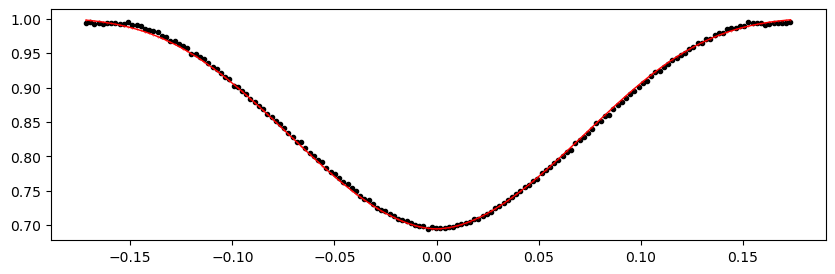

2105.643183 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1277.82it/s]


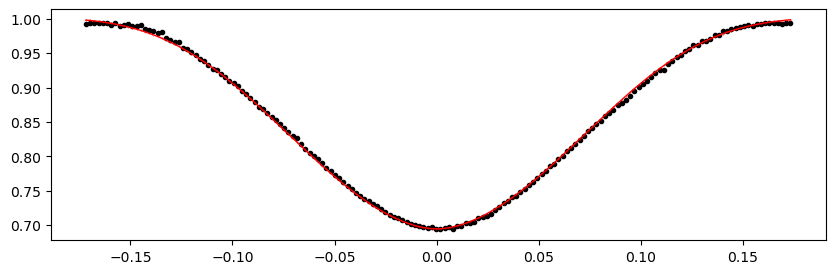

2106.315444 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1320.94it/s]


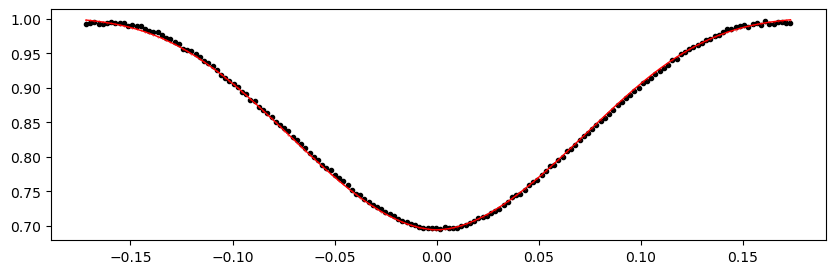

2106.987705 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1309.52it/s]


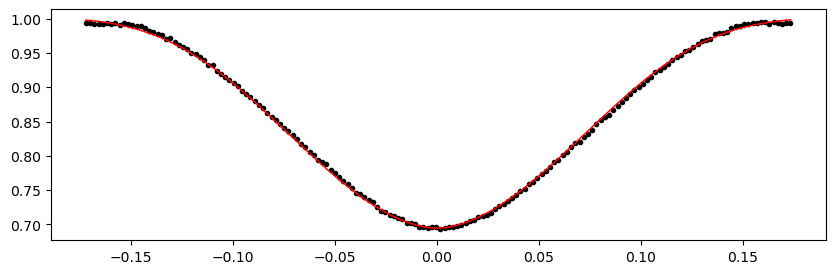

2107.659966 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.36it/s]


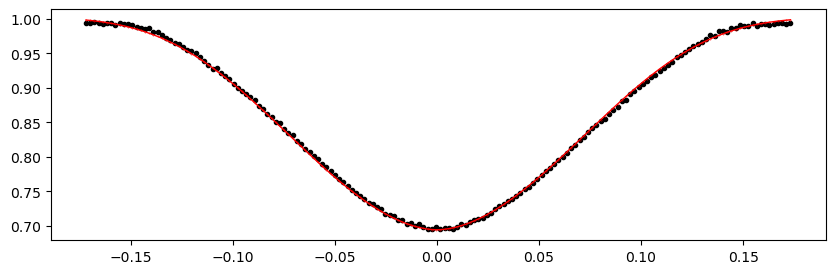

2108.332227 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.27it/s]


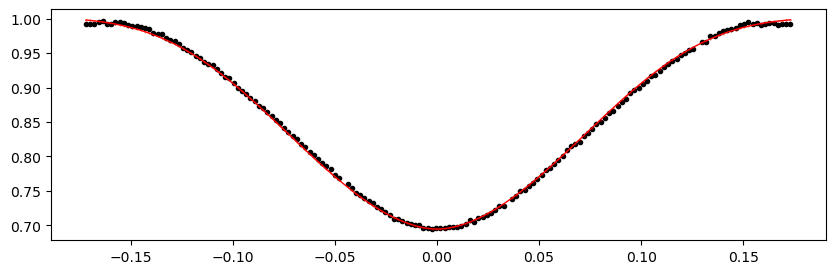

2109.004488 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1308.71it/s]


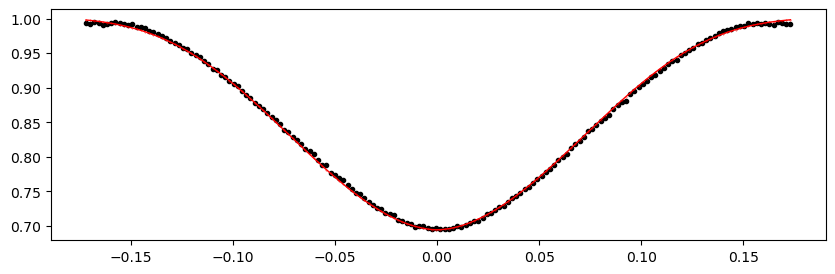

2109.676749 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1301.79it/s]


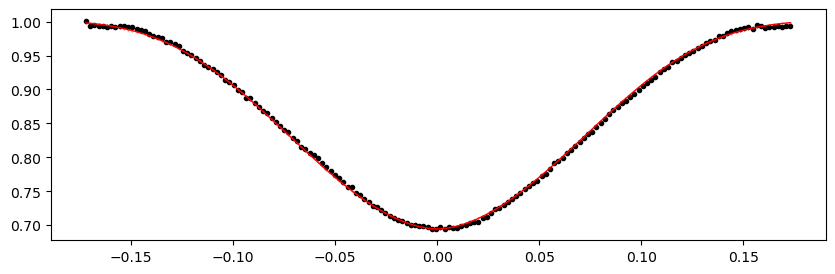

2110.34901 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1304.55it/s]


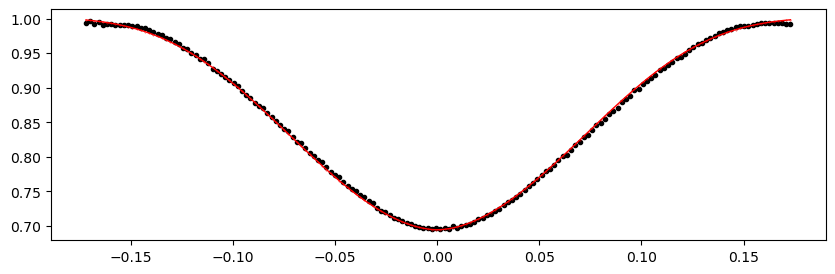

2111.021271 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.55it/s]


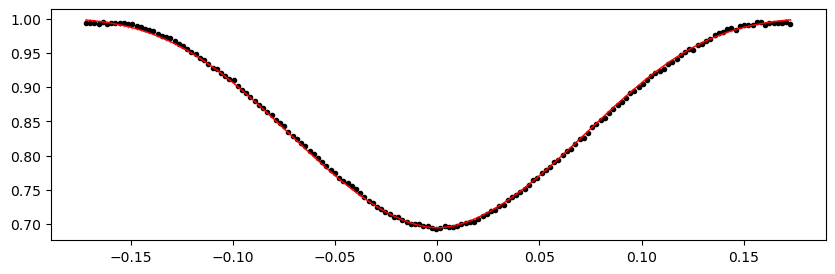

2111.6935320000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.95it/s]


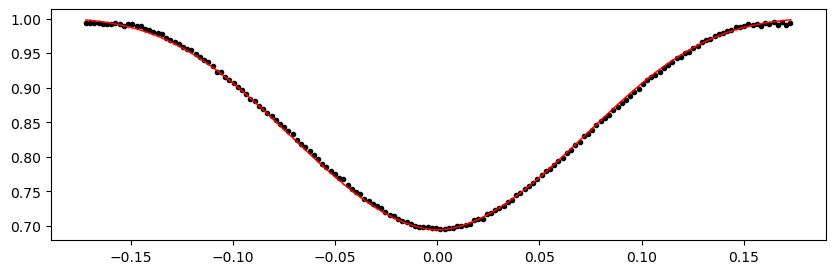

2112.365793 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1318.88it/s]


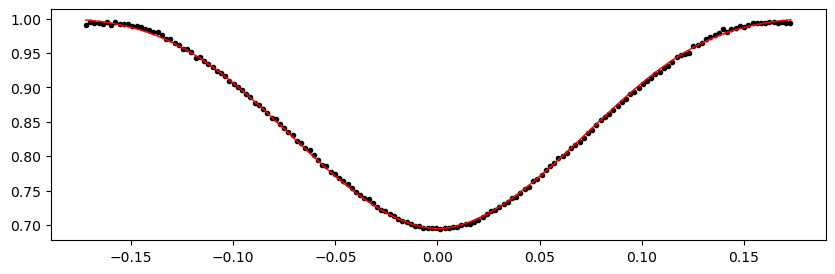

2116.399359 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1302.58it/s]


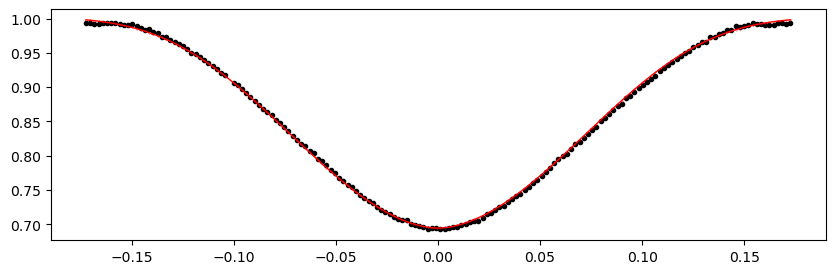

2117.07162 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1314.62it/s]


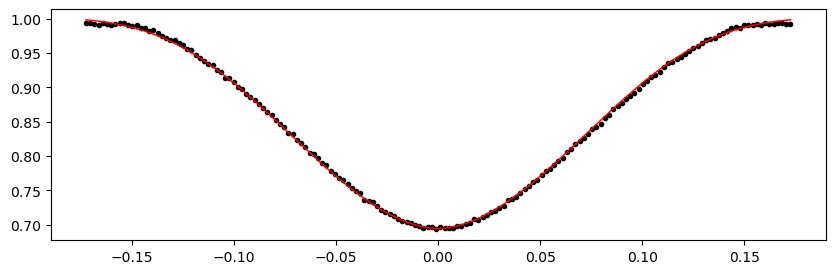

2117.743881 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1294.05it/s]


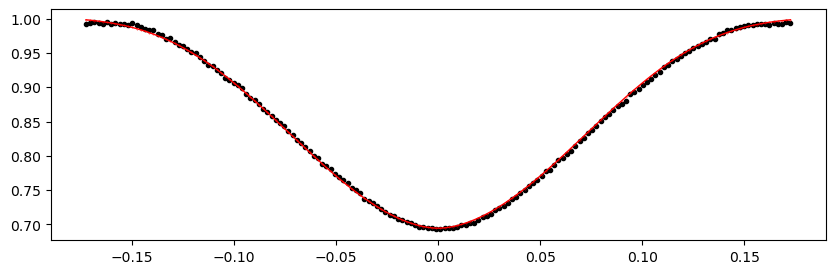

2118.416142 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1302.76it/s]


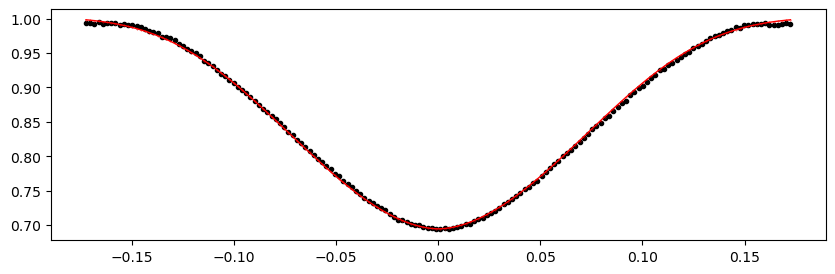

2119.088403 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1309.60it/s]


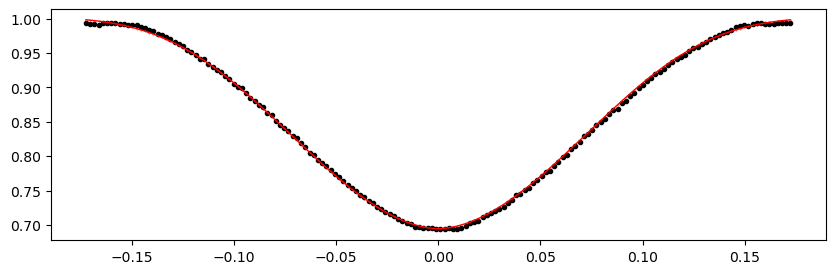

2119.760664 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1318.97it/s]


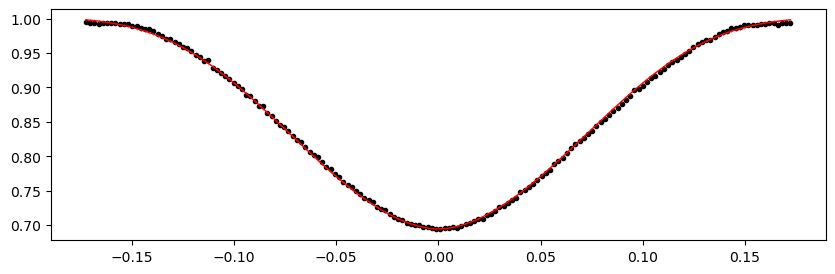

2120.432925 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1294.00it/s]


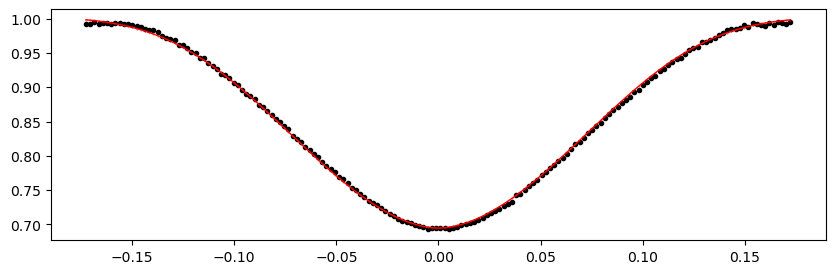

2121.1051860000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1312.85it/s]


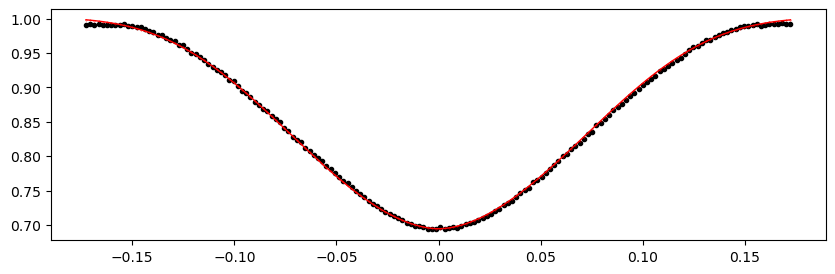

2121.777447 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1309.07it/s]


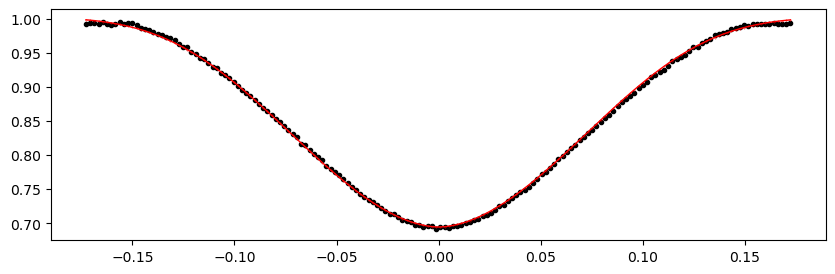

2122.449708 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1322.46it/s]


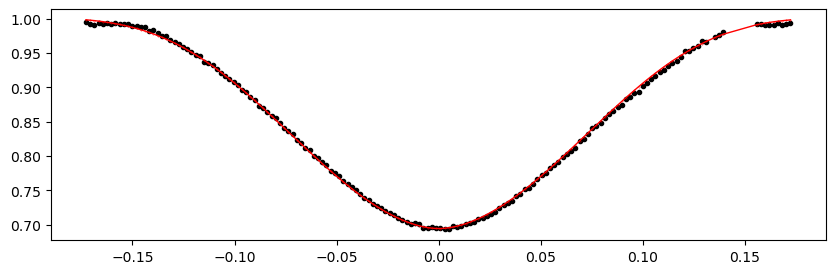

2123.121969 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1301.25it/s]


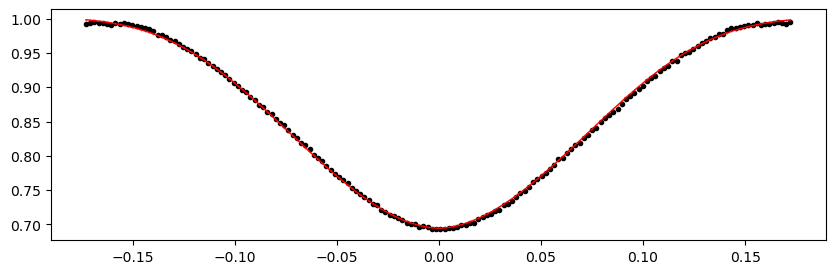

2123.79423 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1322.70it/s]


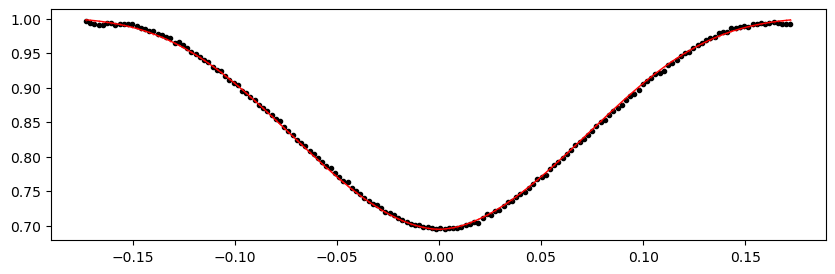

2124.466491 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1319.22it/s]


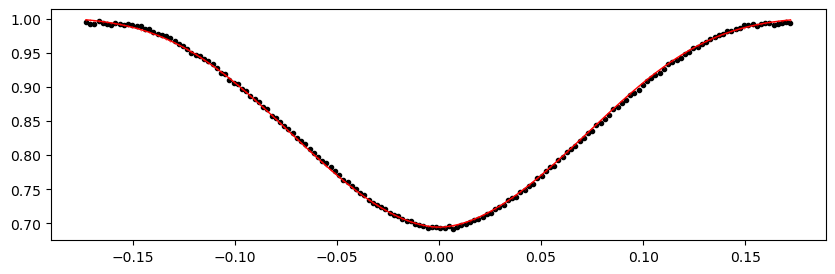

2125.138752 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1299.32it/s]


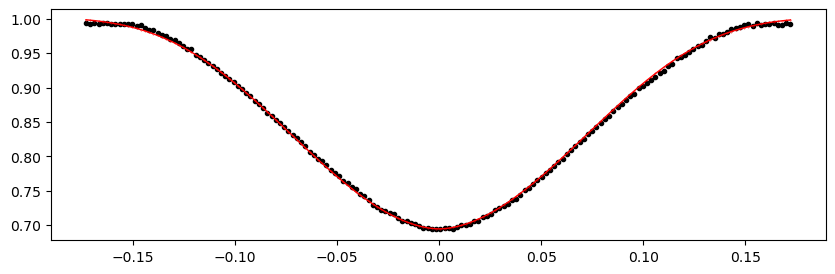

2125.811013 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1320.75it/s]


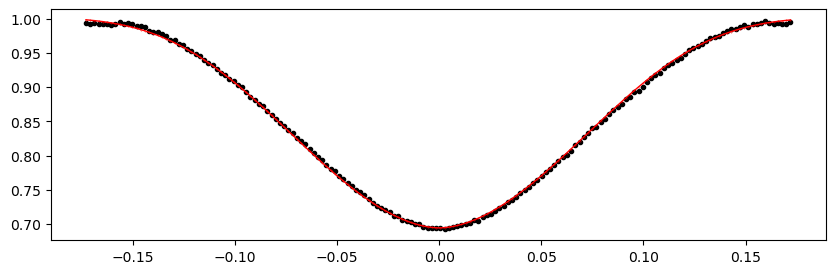

2126.483274 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1314.43it/s]


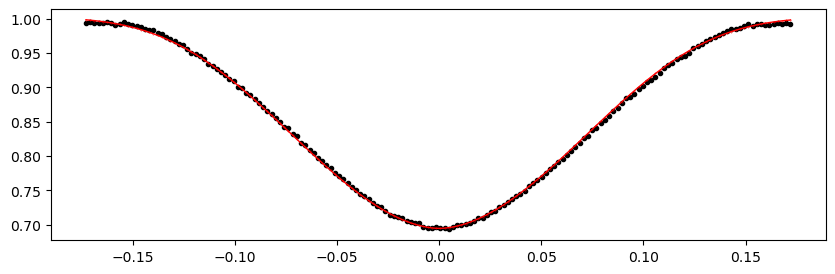

2127.155535 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1246.86it/s]


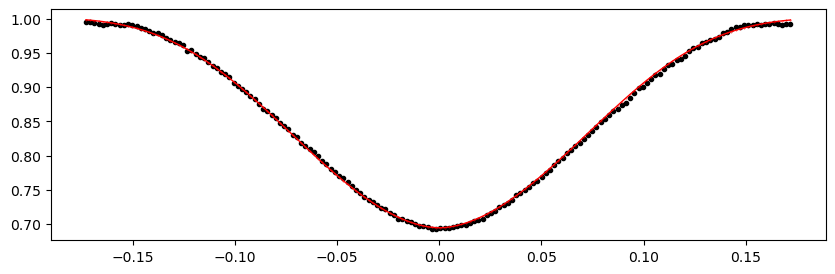

2130.5168400000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1217.74it/s]


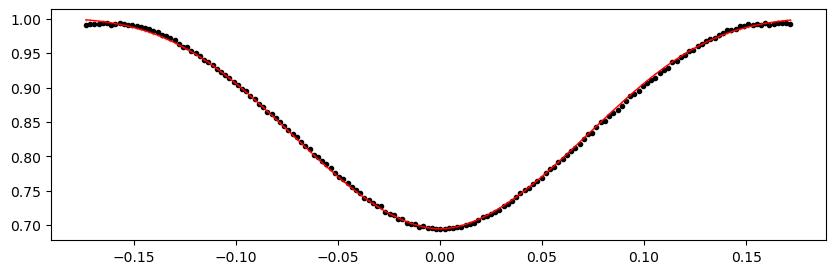

2131.189101 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1294.70it/s]


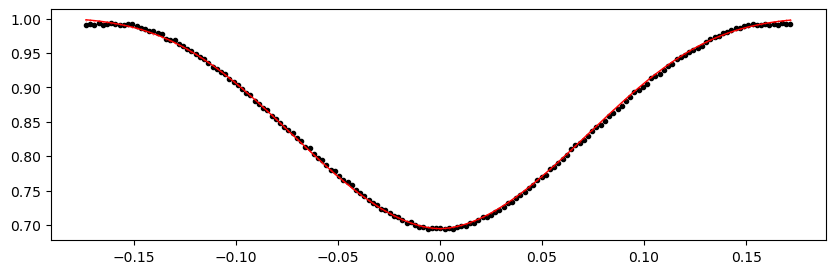

2131.861362 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1308.87it/s]


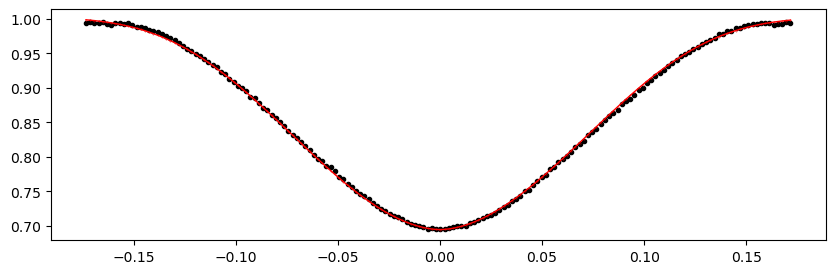

2132.533623 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1299.55it/s]


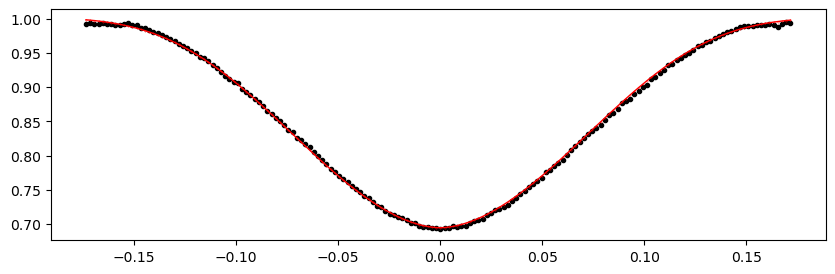

2133.205884 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1291.95it/s]


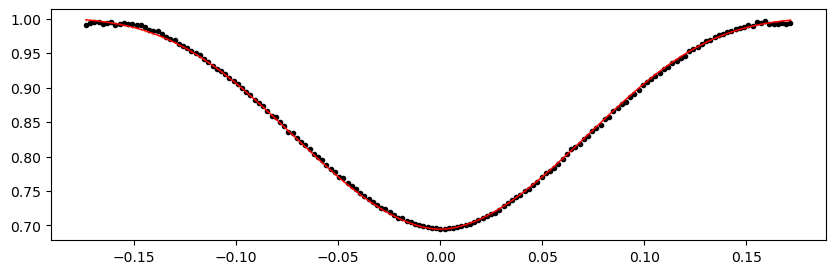

2133.878145 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1303.76it/s]


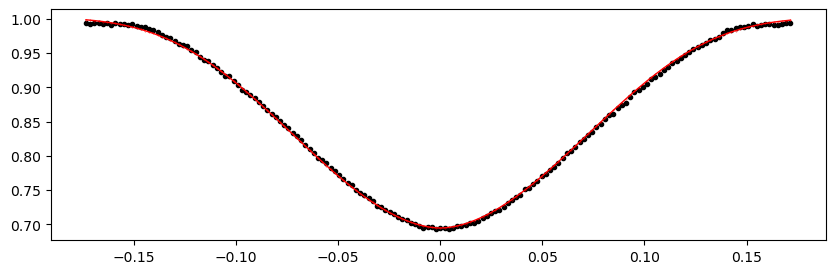

2134.550406 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1304.61it/s]


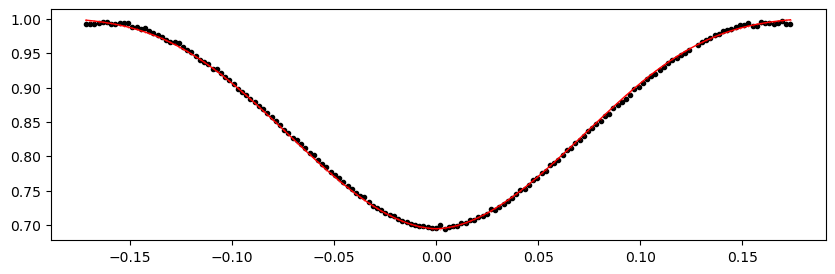

2135.222667 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.31it/s]


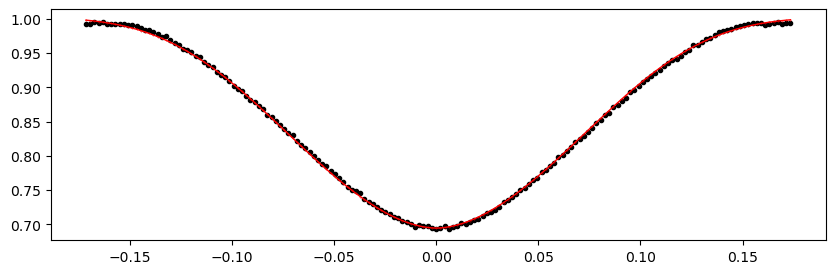

2135.894928 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1298.76it/s]


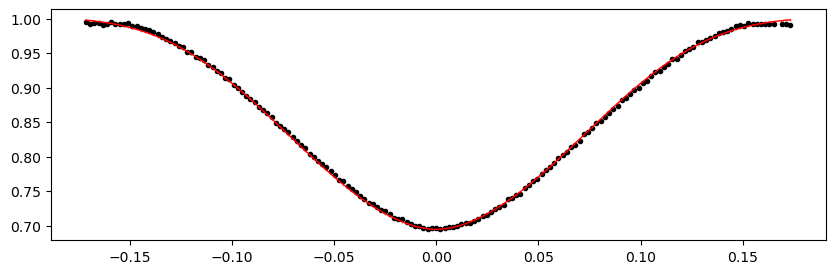

2136.567189 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1320.68it/s]


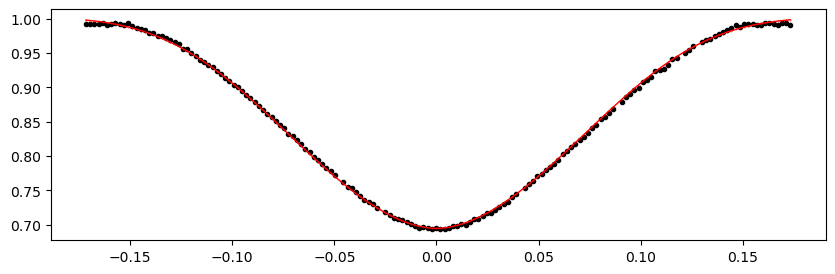

2137.23945 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.02it/s]


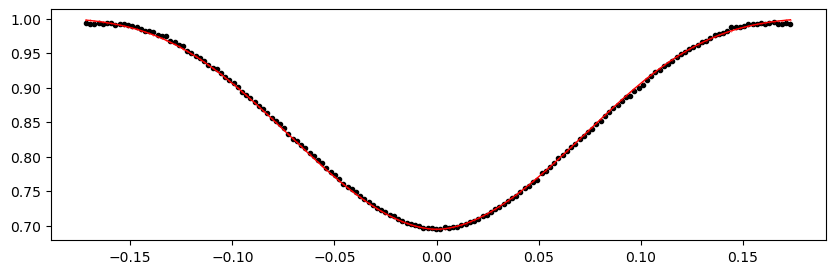

2137.911711 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1312.76it/s]


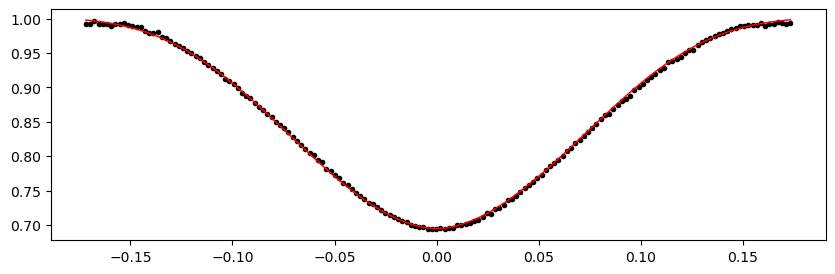

2138.583972 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.06it/s]


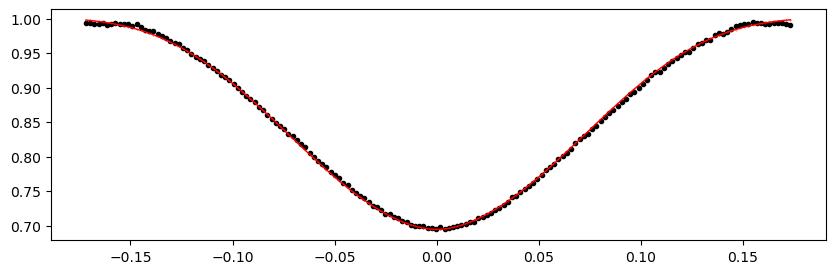

2139.256233 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1295.36it/s]


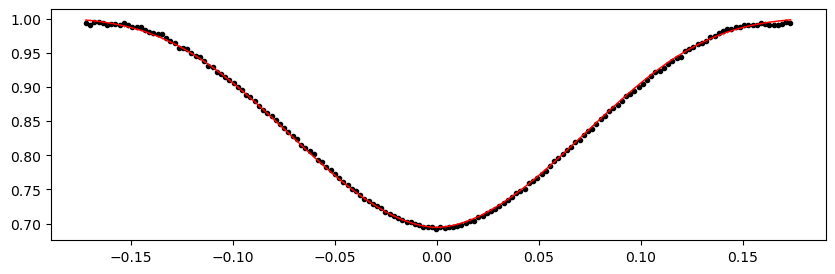

2139.9284940000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1321.57it/s]


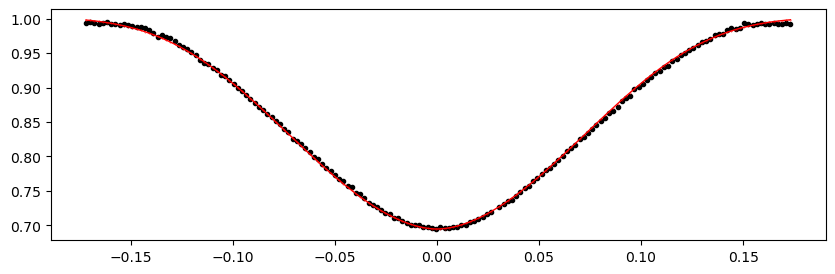

2140.600755 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1303.10it/s]


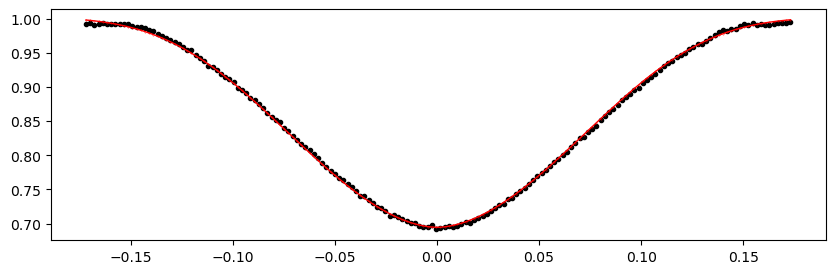

2141.273016 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1303.73it/s]


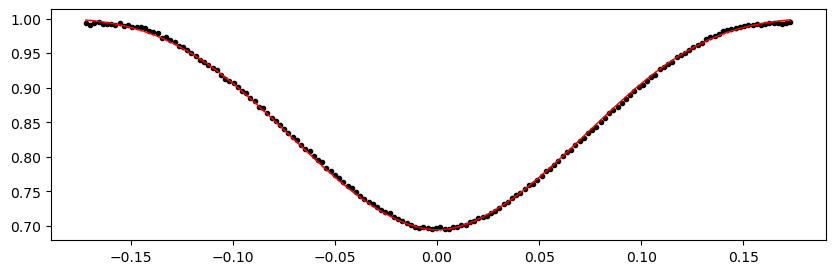

2144.634321 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.65it/s]


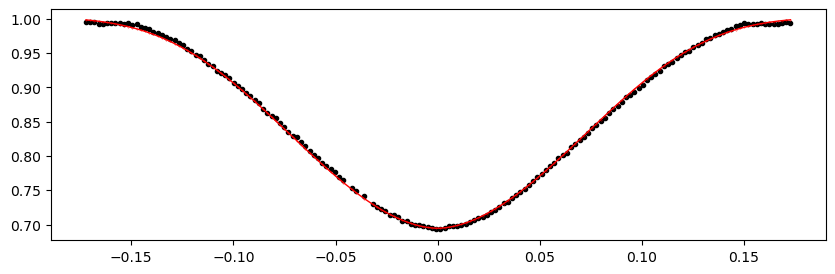

2145.306582 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1300.36it/s]


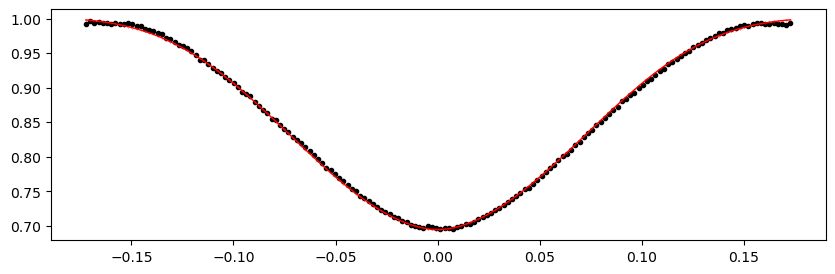

2145.978843 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.28it/s]


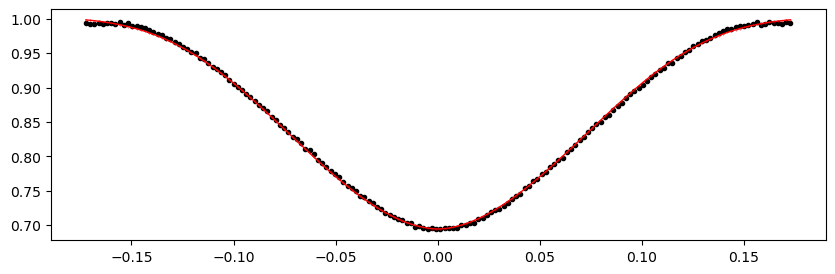

2146.651104 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.04it/s]


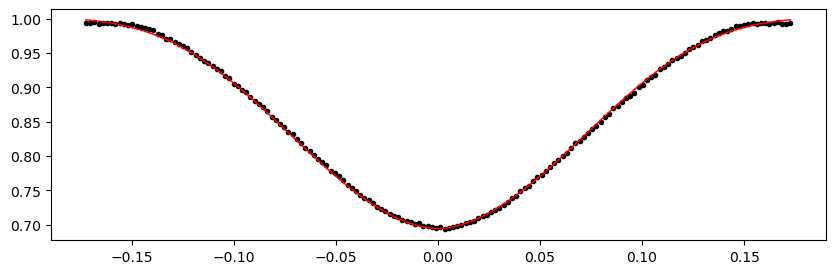

2147.323365 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1281.77it/s]


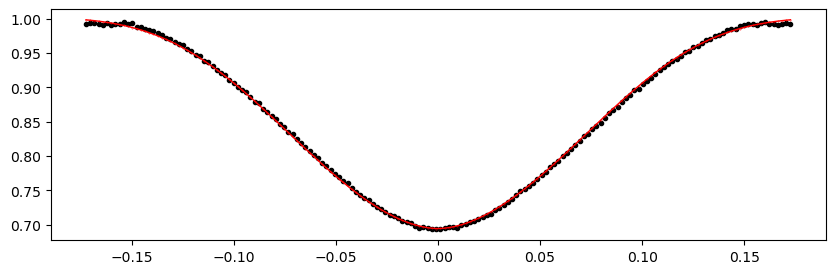

2147.995626 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1315.33it/s]


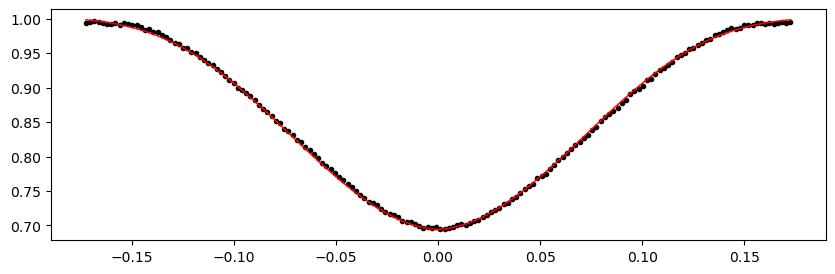

2148.667887 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1318.43it/s]


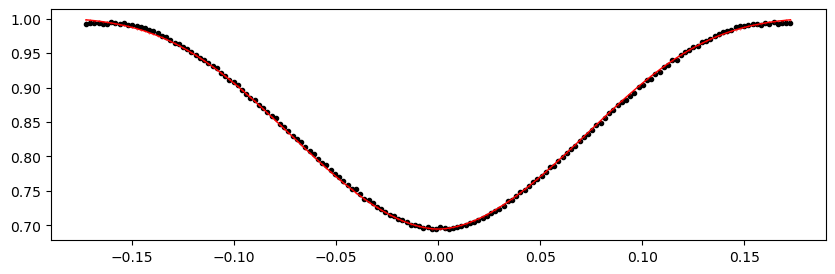

2149.340148 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1312.39it/s]


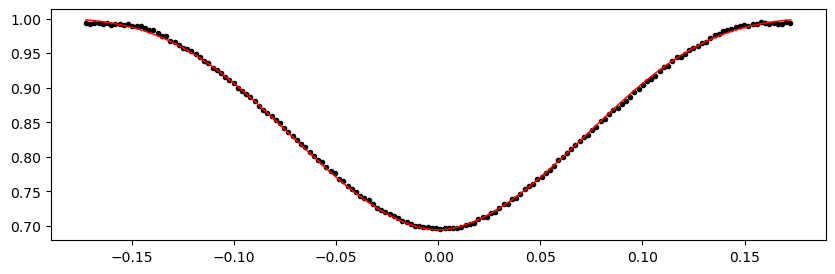

2150.012409 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1303.96it/s]


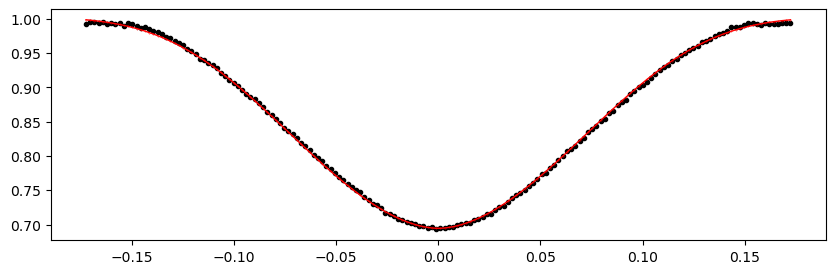

2150.68467 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1290.33it/s]


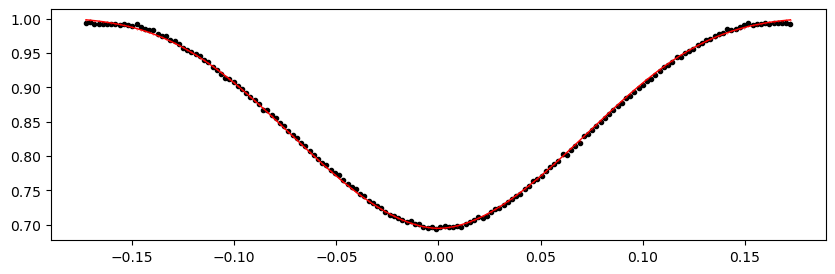

2151.356931 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1268.55it/s]


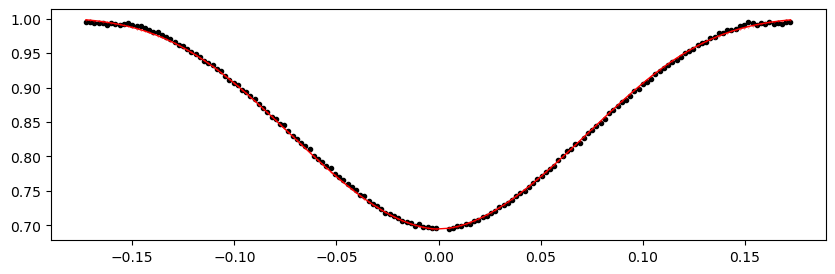

2152.029192 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1278.76it/s]


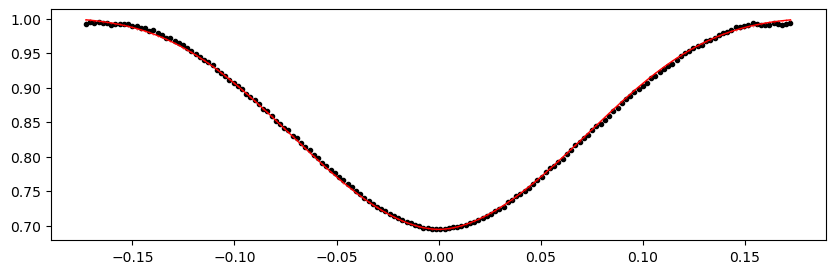

2152.701453 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1254.66it/s]


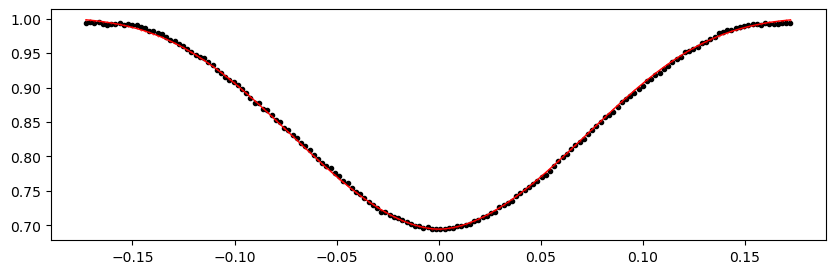

2153.373714 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1288.64it/s]


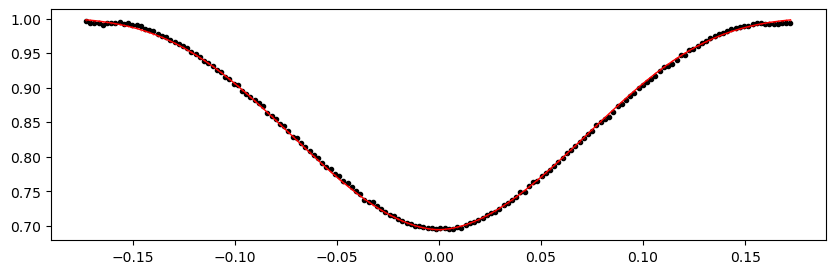

2154.045975 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1291.34it/s]


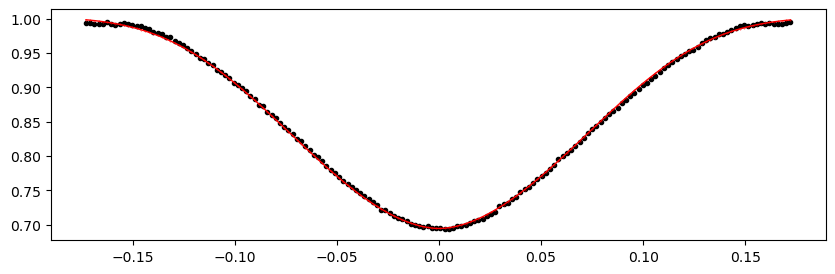

2154.718236 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1284.80it/s]


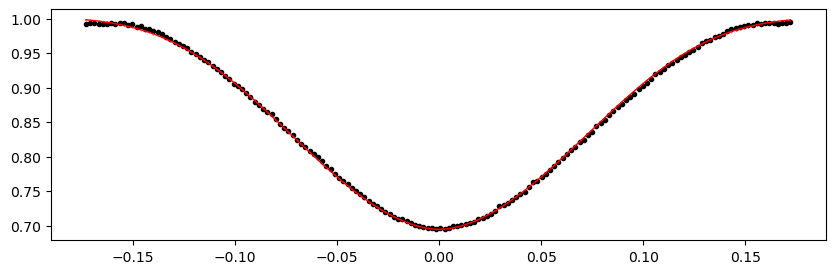

2155.390497 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1304.56it/s]


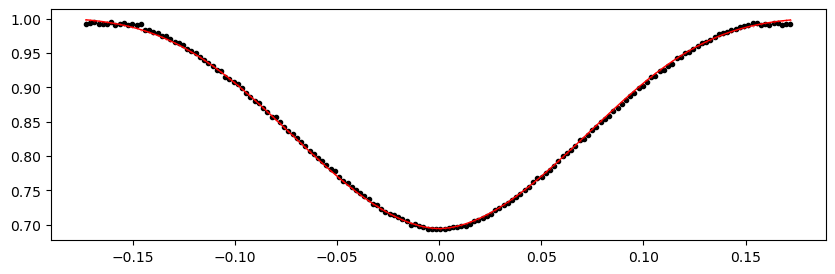

2156.062758 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1303.81it/s]


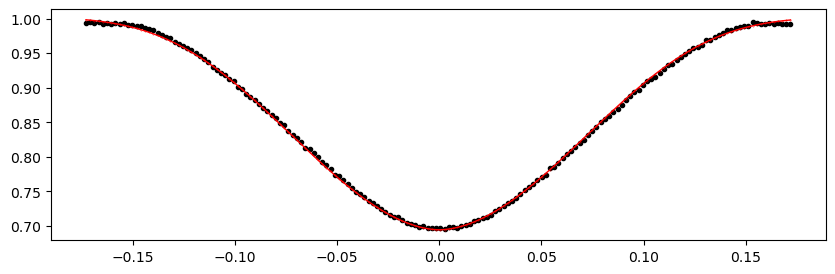

2159.424063 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1322.73it/s]


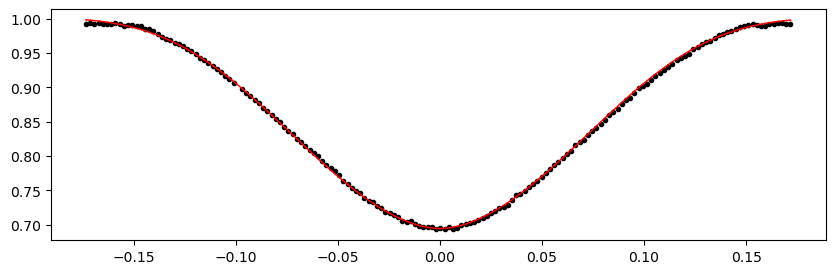

2160.096324 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.69it/s]


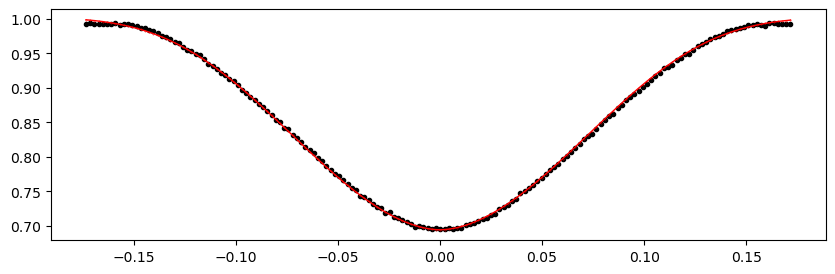

2160.768585 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1298.74it/s]


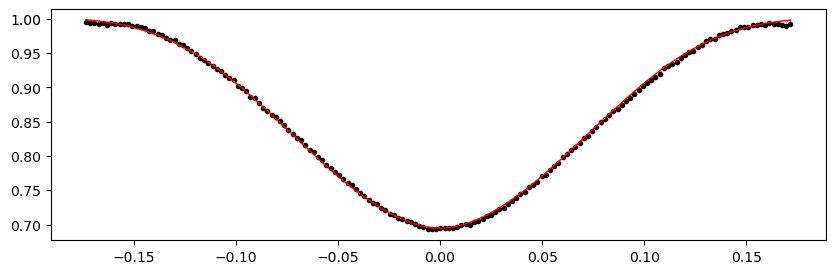

2161.440846 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.68it/s]


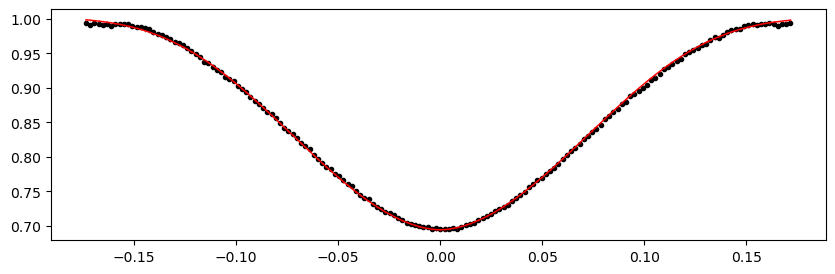

2162.113107 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1309.36it/s]


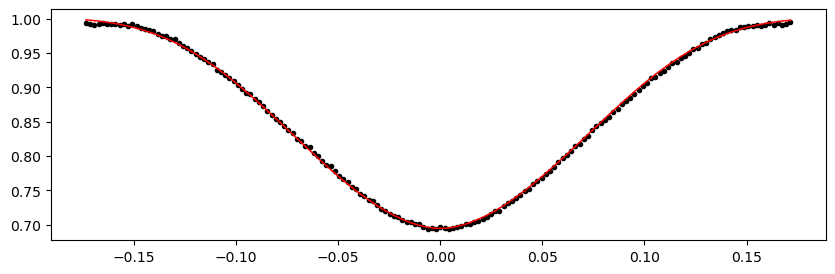

2162.785368 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1311.51it/s]


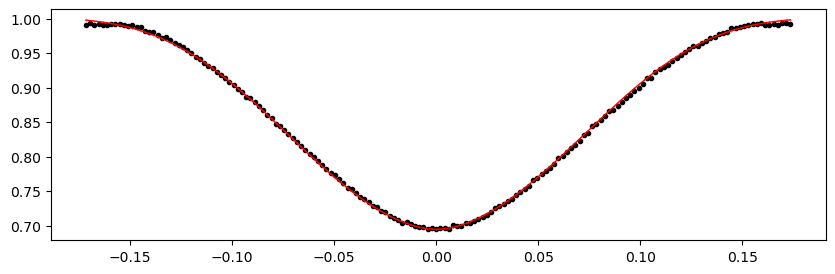

2163.457629 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1297.03it/s]


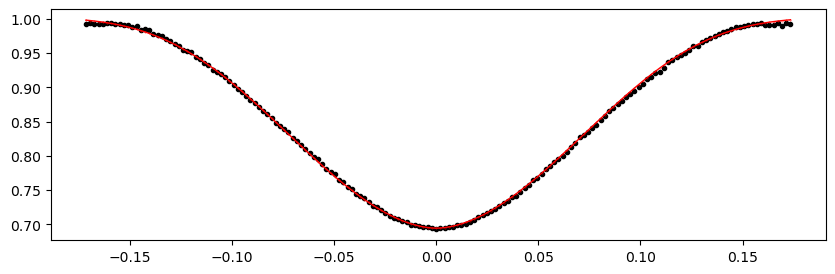

2164.12989 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.65it/s]


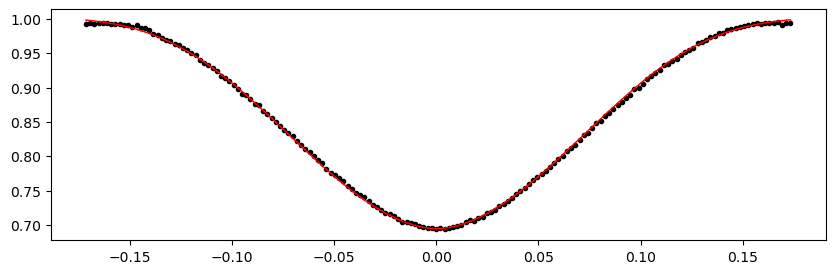

2164.802151 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1278.98it/s]


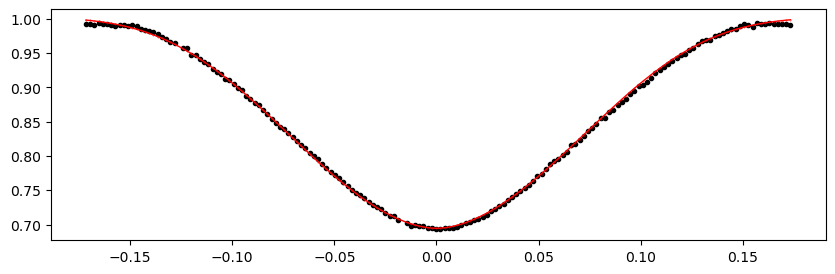

2165.474412 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1297.90it/s]


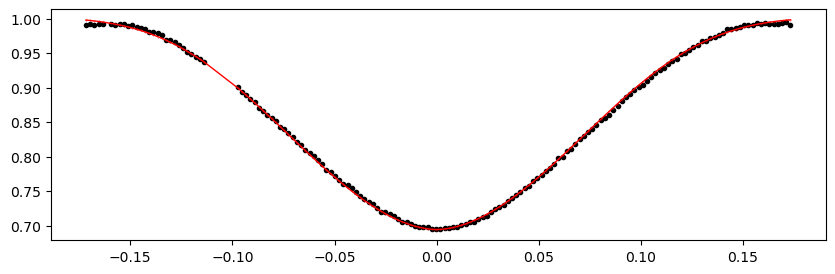

2166.146673 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1283.76it/s]


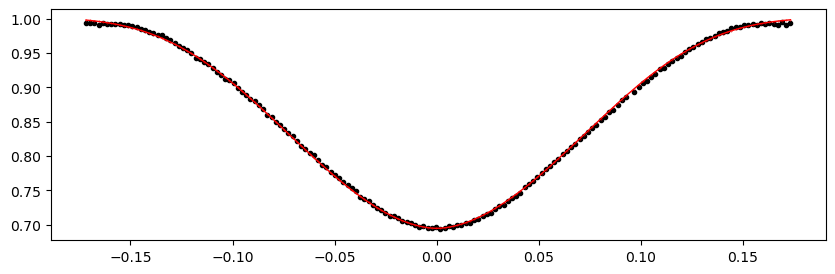

2166.818934 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1297.05it/s]


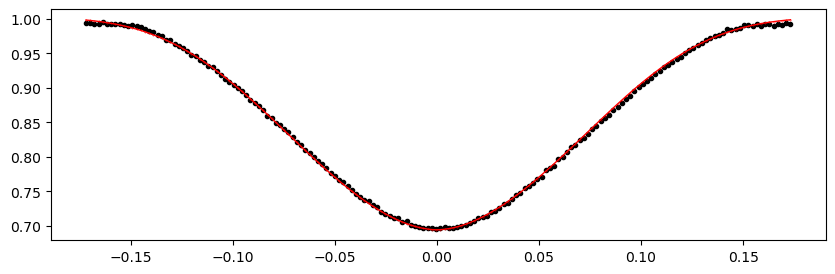

2167.491195 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1302.08it/s]


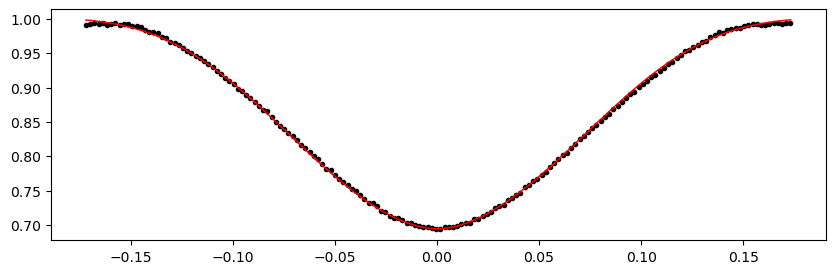

2168.163456 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1310.82it/s]


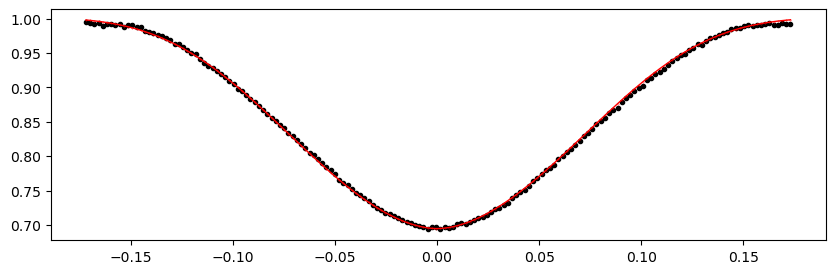

2168.835717 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1297.66it/s]


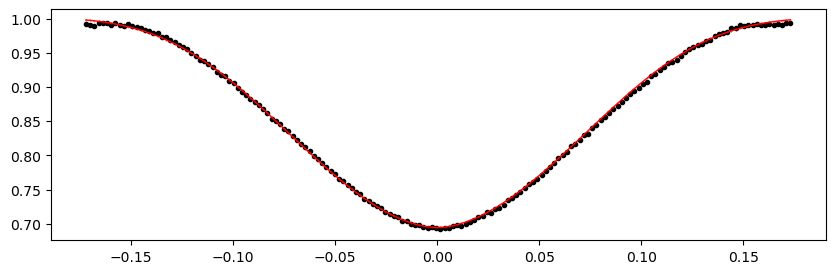

2169.507978 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1313.97it/s]


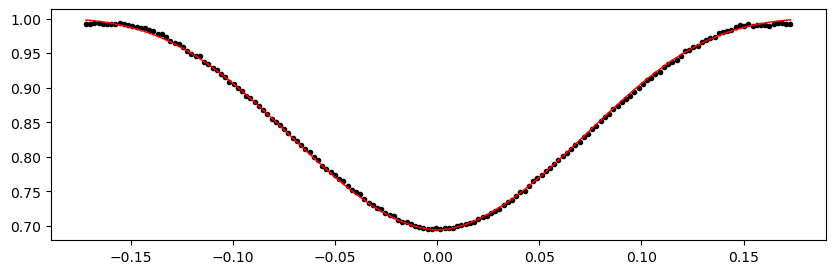

2174.213805 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1320.56it/s]


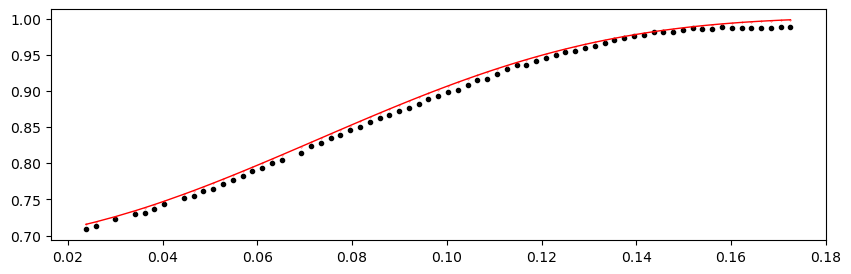

2174.886066 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1318.76it/s]


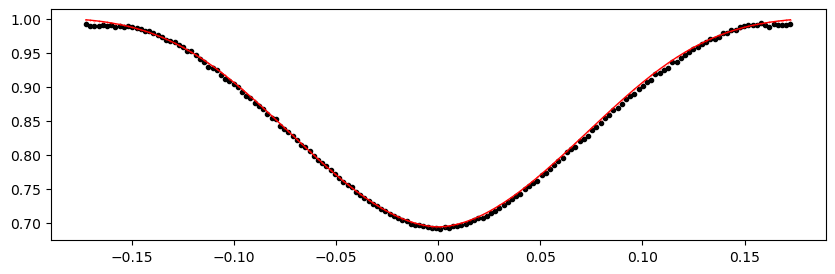

2175.558327 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1312.82it/s]


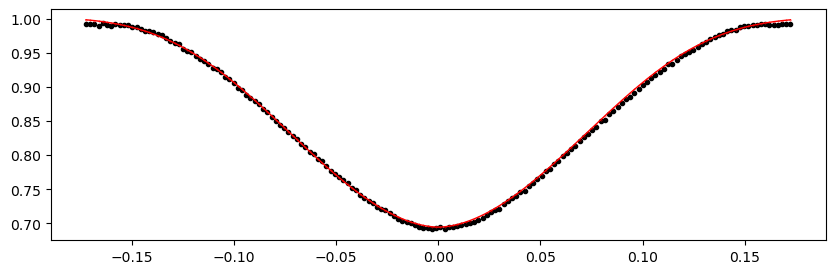

2176.230588 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1295.34it/s]


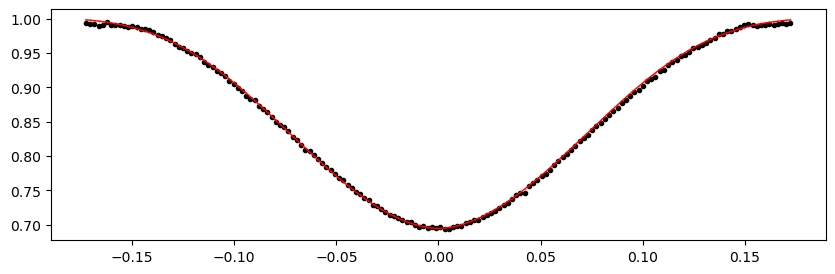

2176.902849 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1310.87it/s]


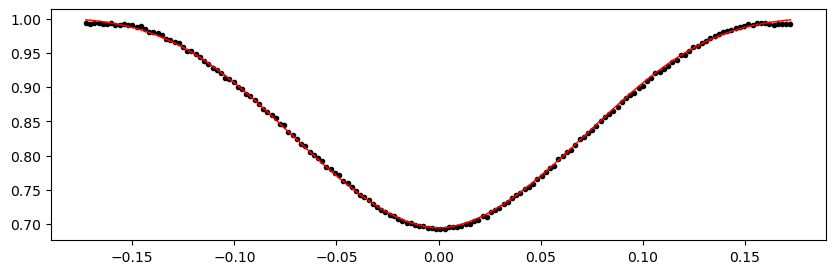

2177.57511 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1296.57it/s]


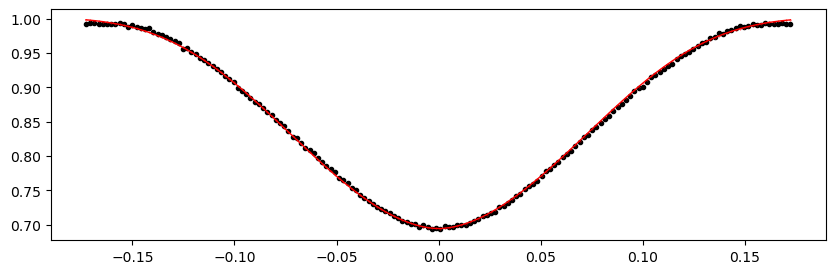

2178.247371 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1242.17it/s]


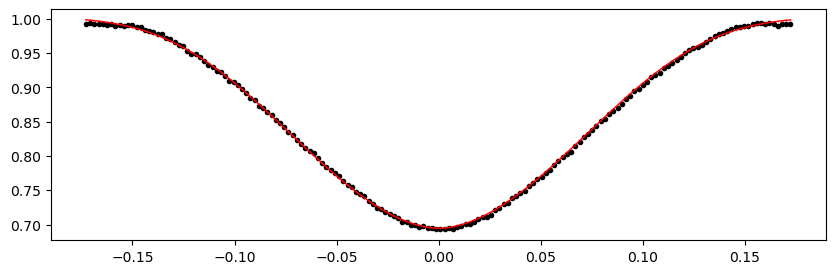

2178.919632 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1256.22it/s]


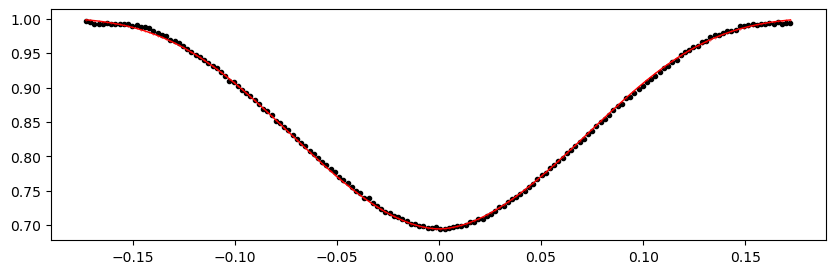

2179.591893 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1258.65it/s]


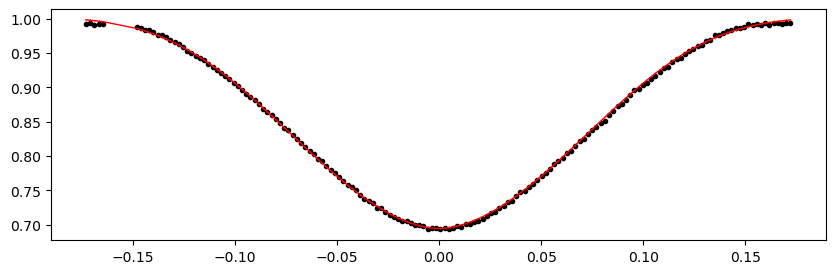

2180.264154 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.64it/s]


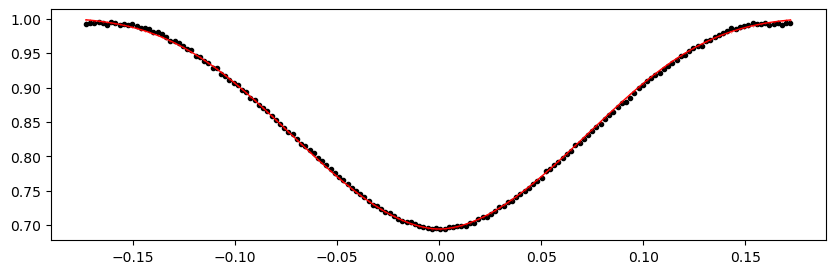

2180.936415 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1264.26it/s]


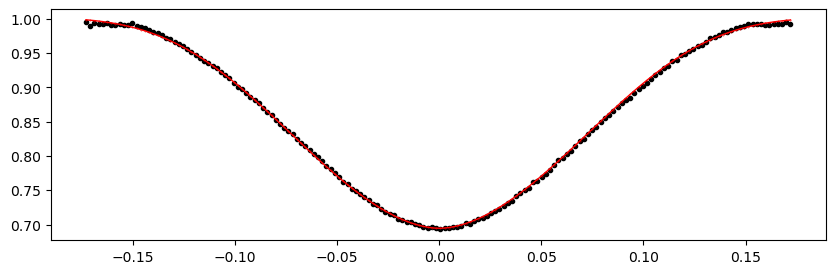

2181.608676 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1256.98it/s]


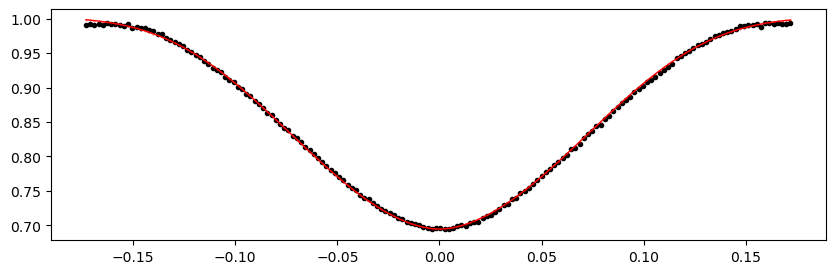

2182.280937 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.35it/s]


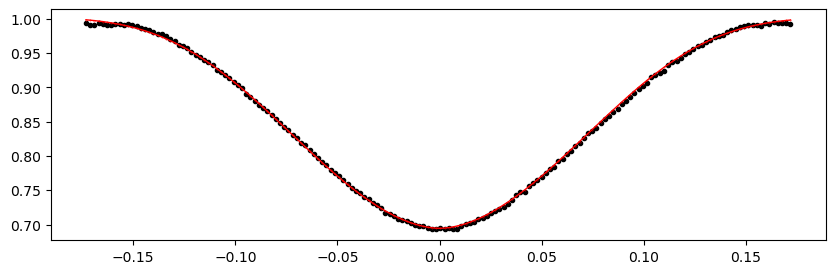

2182.953198 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1314.04it/s]


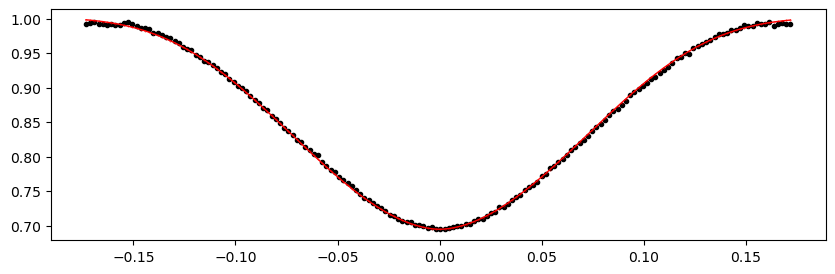

2183.625459 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1315.78it/s]


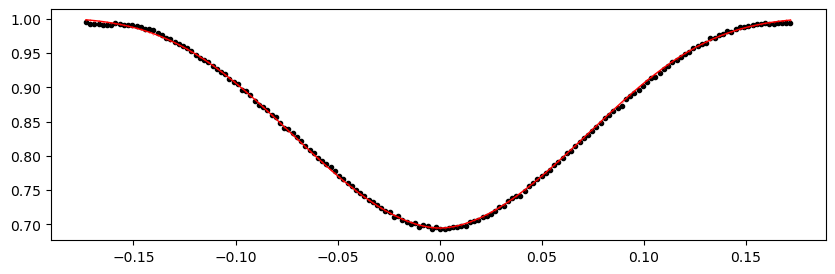

2184.29772 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1314.09it/s]


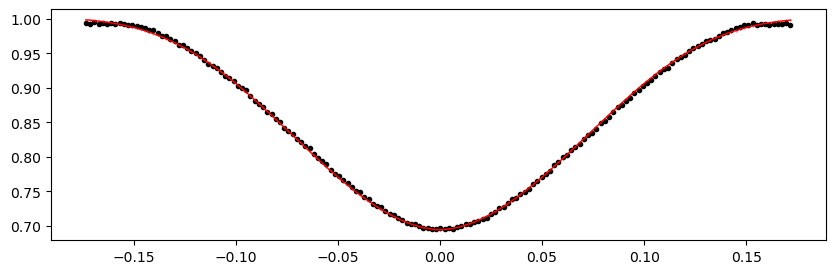

2184.969981 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1306.40it/s]


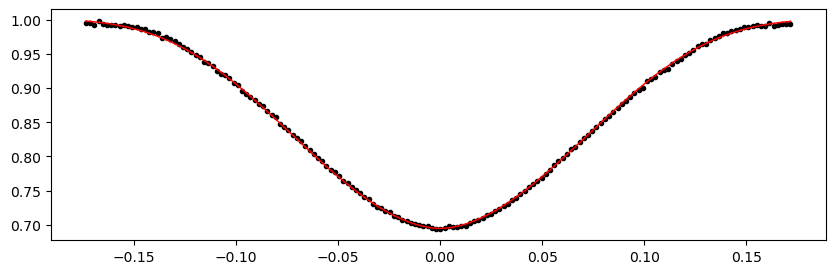

2185.642242 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1300.45it/s]


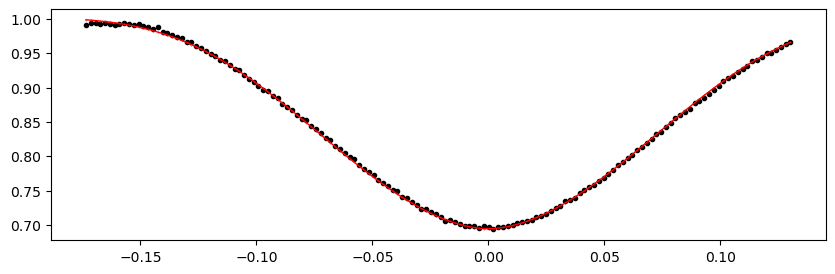

2187.659025 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1325.40it/s]


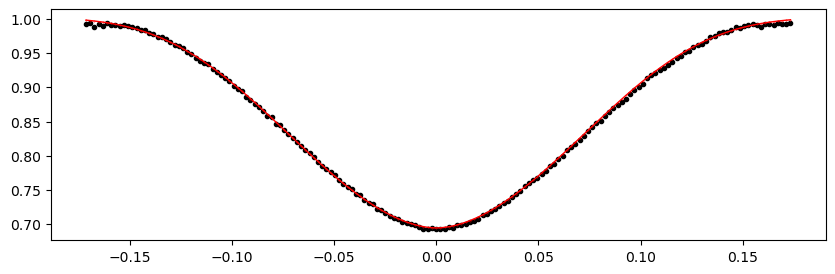

2188.331286 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.89it/s]


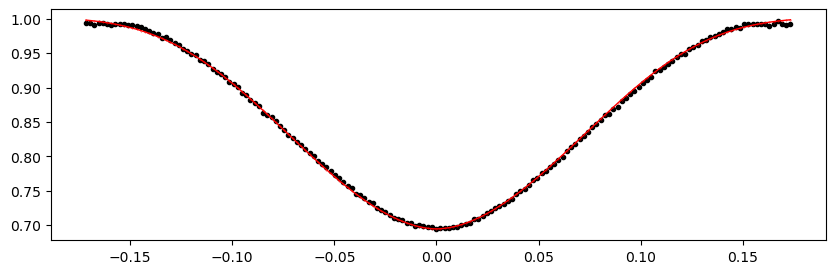

2189.0035470000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1305.74it/s]


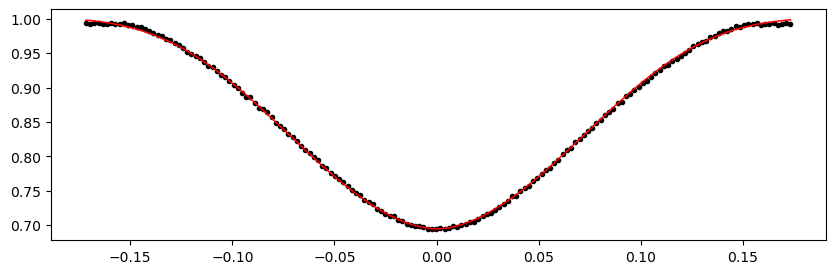

2189.675808 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1304.65it/s]


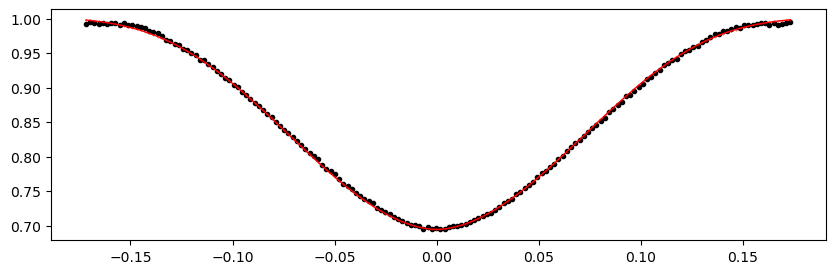

2190.348069 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1305.96it/s]


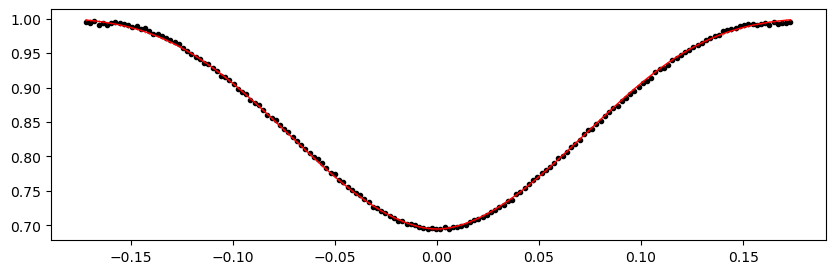

2191.02033 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1297.03it/s]


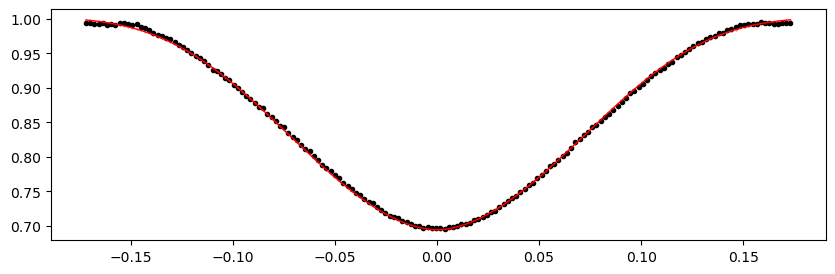

2191.692591 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1305.59it/s]


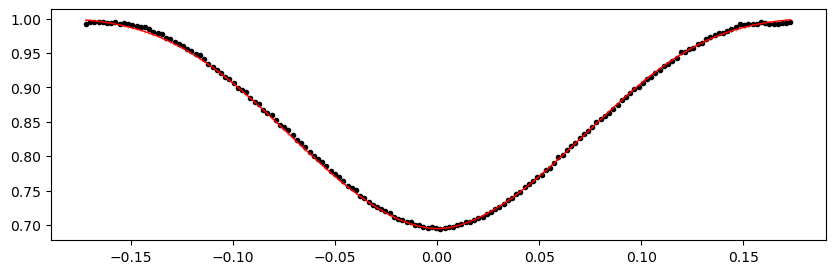

2192.364852 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1300.56it/s]


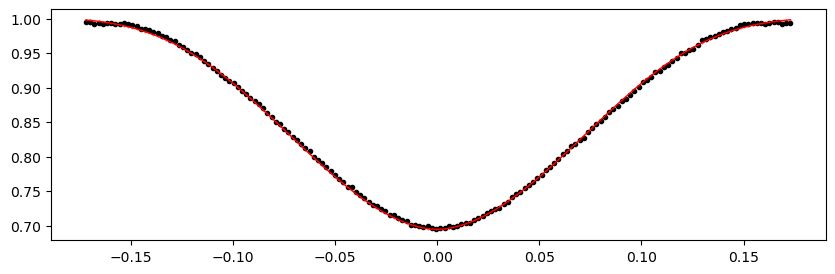

2193.037113 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1291.08it/s]


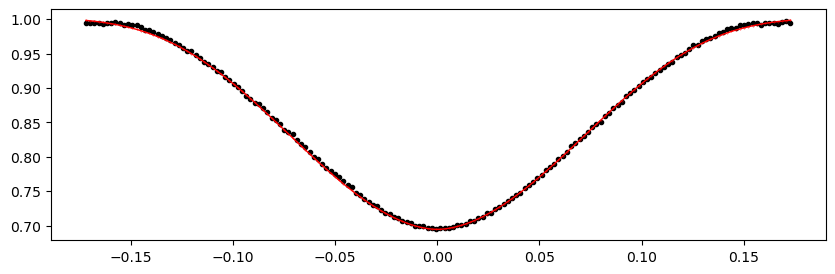

2193.709374 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1311.17it/s]


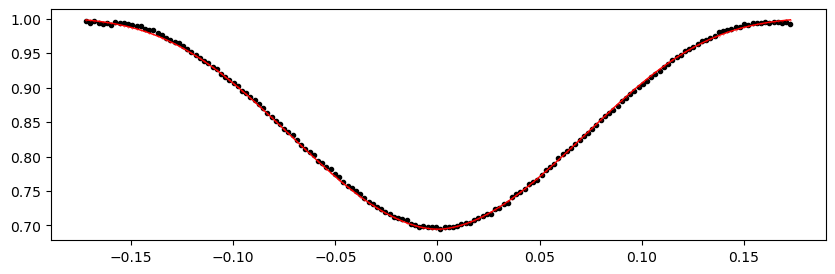

2194.381635 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1296.93it/s]


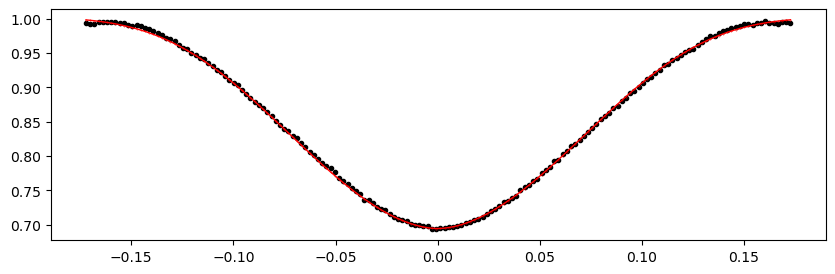

2195.053896 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.12it/s]


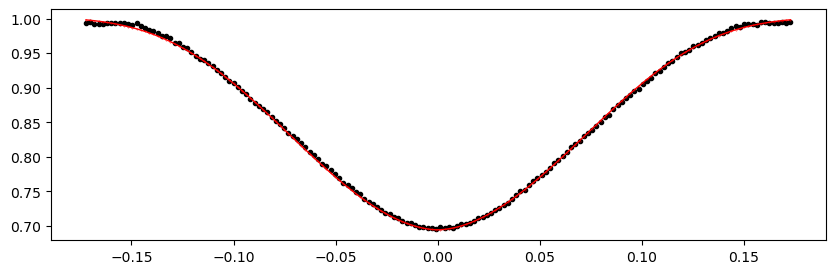

2195.726157 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1299.91it/s]


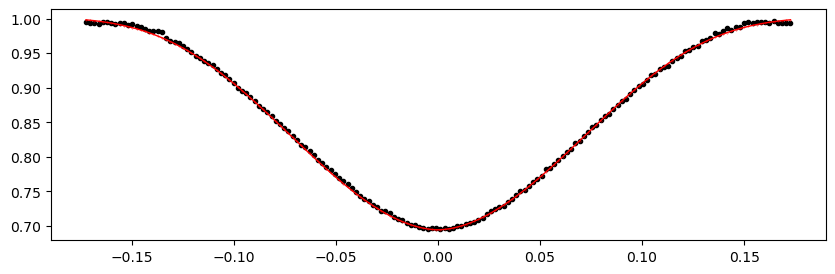

2196.398418 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1286.62it/s]


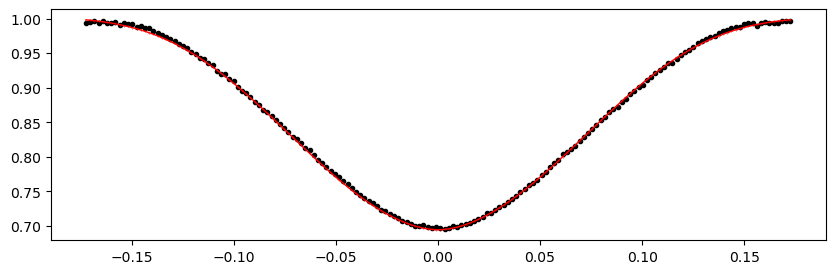

2197.070679 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1321.96it/s]


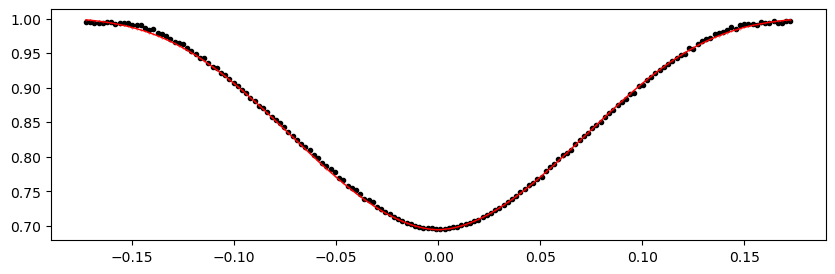

2197.74294 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1293.32it/s]


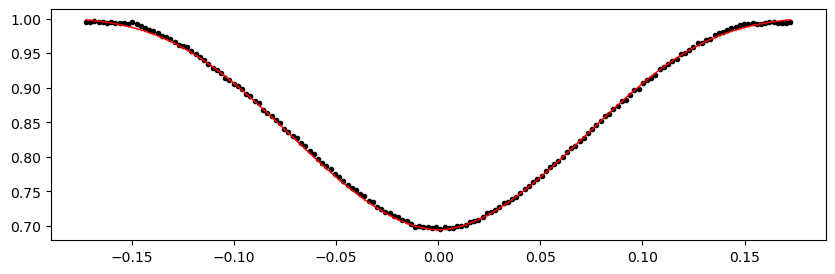

2198.415201 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1310.45it/s]


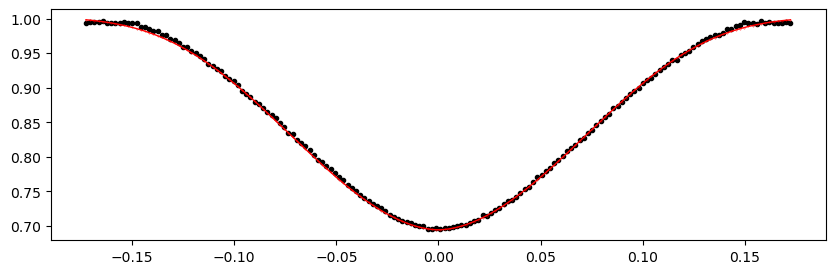

2199.087462 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1250.88it/s]


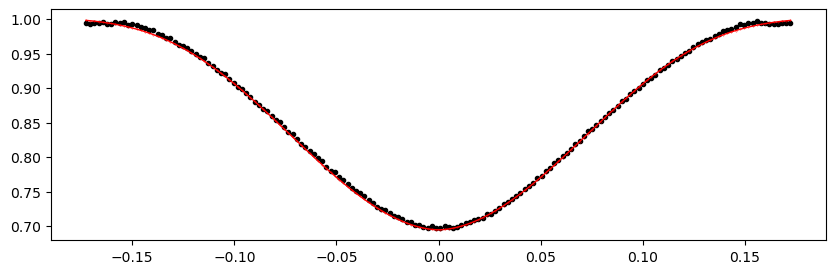

2199.759723 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1243.27it/s]


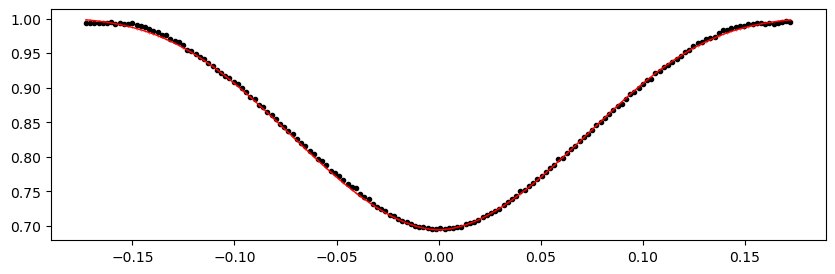

2201.776506 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1281.53it/s]


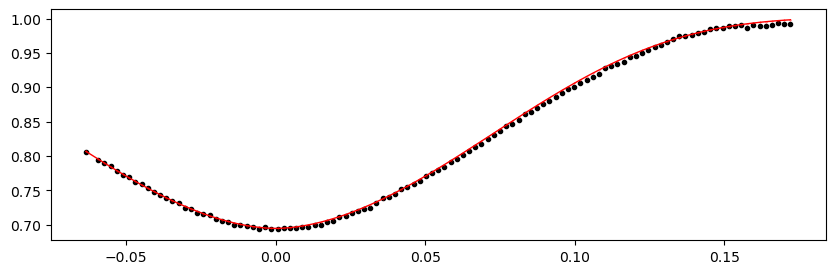

2202.448767 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1306.64it/s]


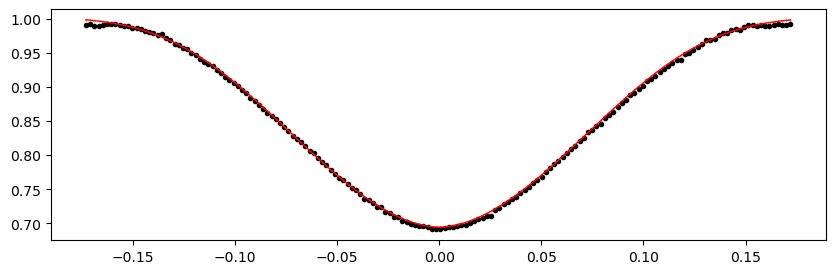

2203.121028 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1276.01it/s]


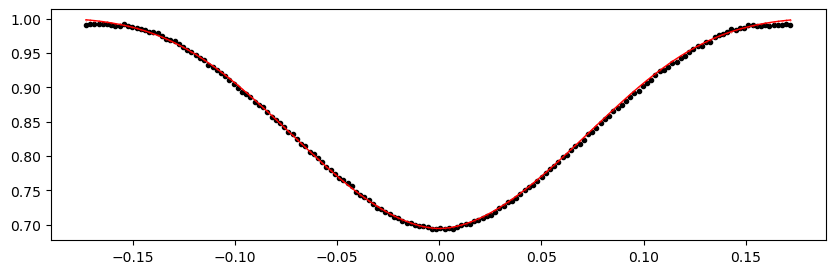

2203.793289 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1298.72it/s]


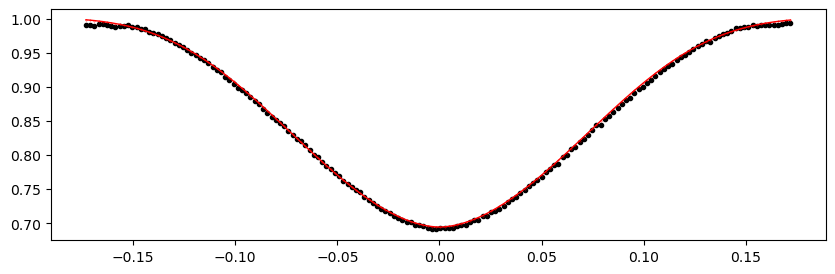

2204.46555 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1298.69it/s]


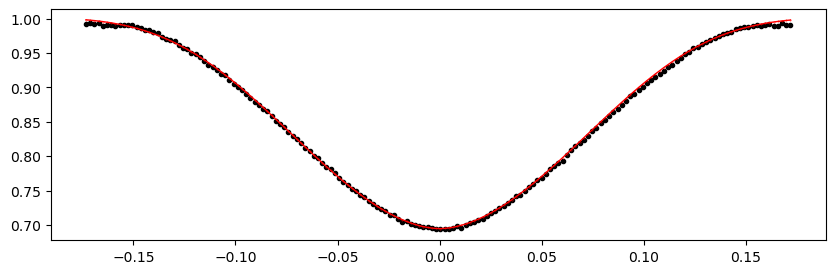

2205.137811 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1244.58it/s]


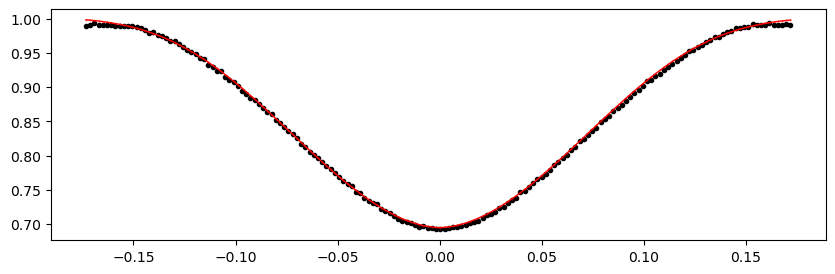

2205.810072 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1297.01it/s]


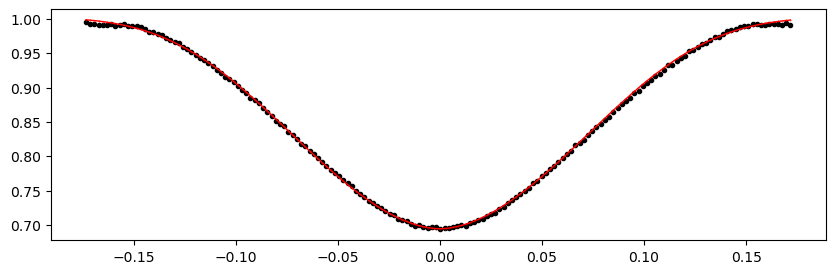

2206.482333 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1302.32it/s]


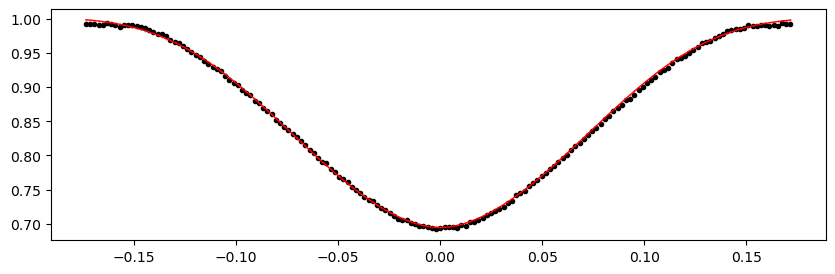

2207.154594 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1289.38it/s]


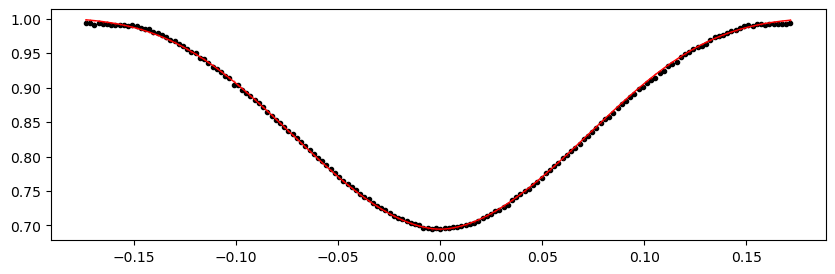

2207.8268550000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1274.64it/s]


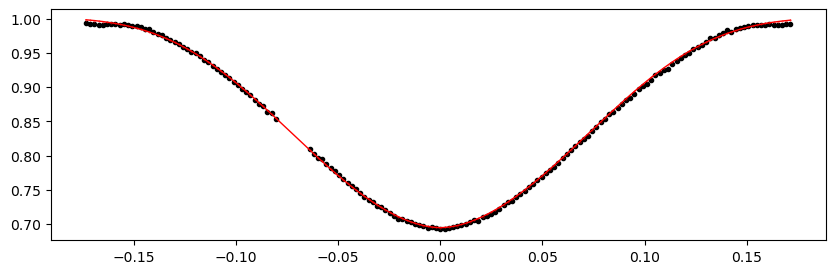

2208.499116 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.10it/s]


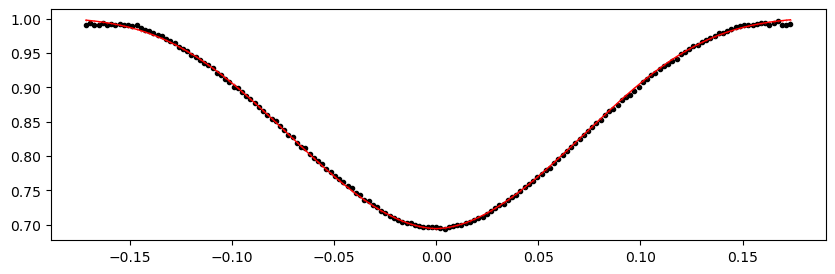

2209.171377 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.39it/s]


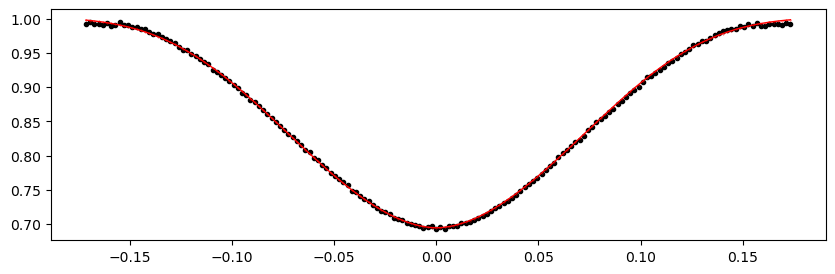

2209.843638 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1358.68it/s]


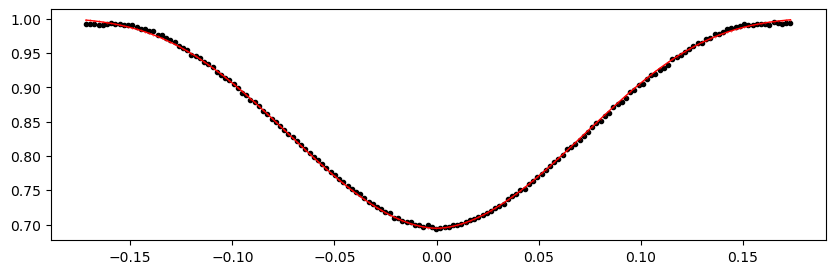

2210.515899 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1354.85it/s]


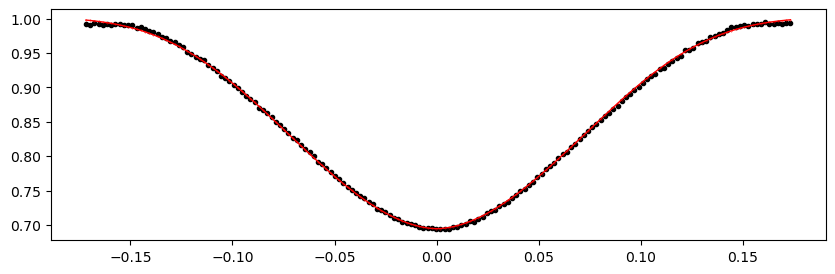

2211.18816 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.44it/s]


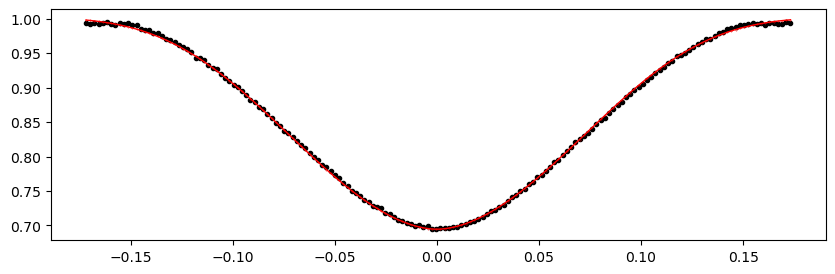

2211.860421 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.81it/s]


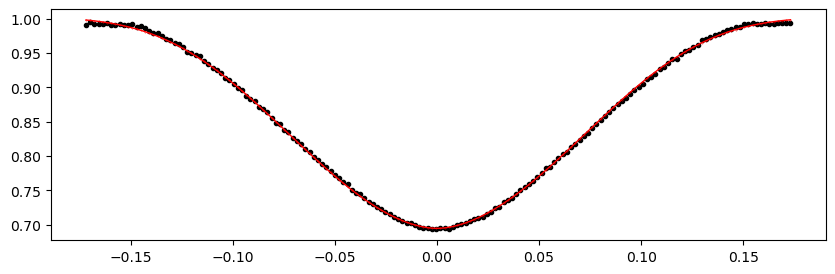

2212.532682 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.17it/s]


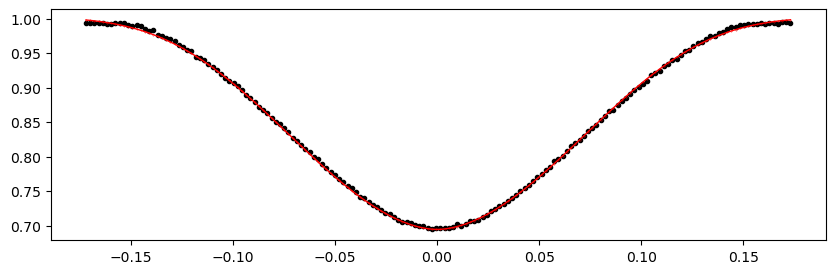

2213.204943 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1358.14it/s]


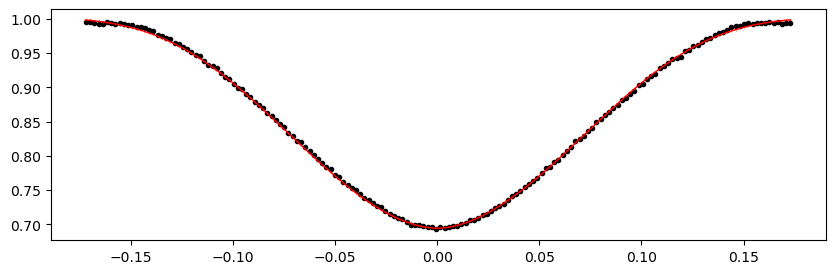

2213.877204 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.32it/s]


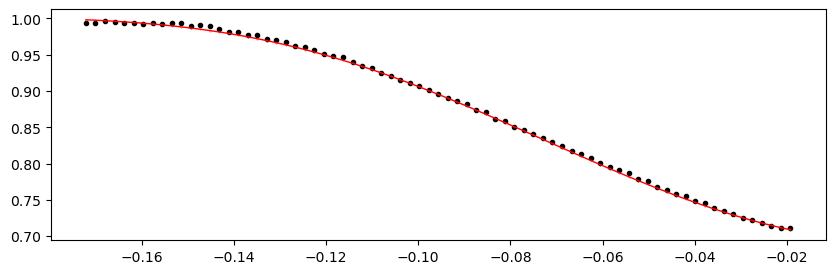

2215.893987 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.26it/s]


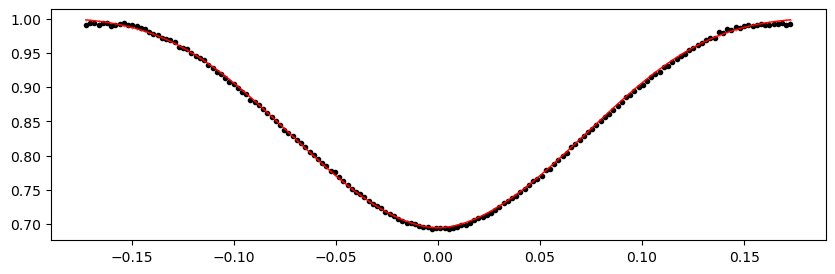

2216.566248 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.10it/s]


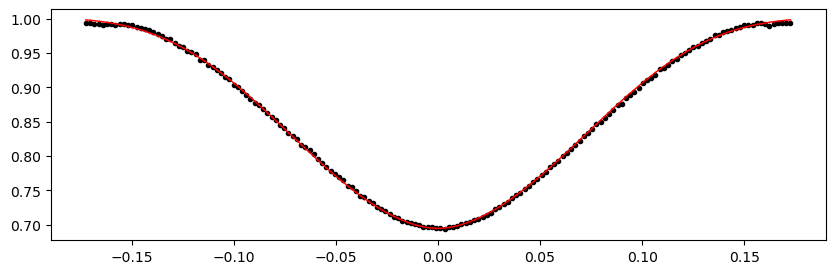

2217.238509 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.66it/s]


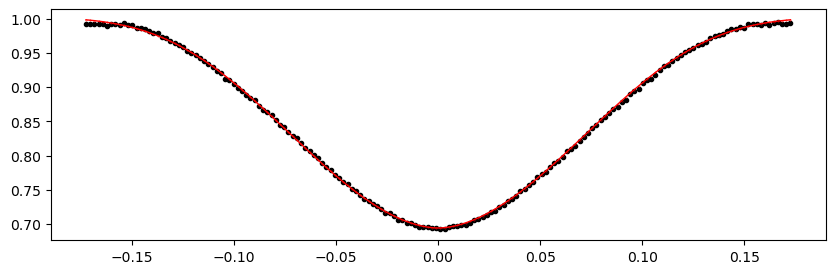

2217.91077 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.51it/s]


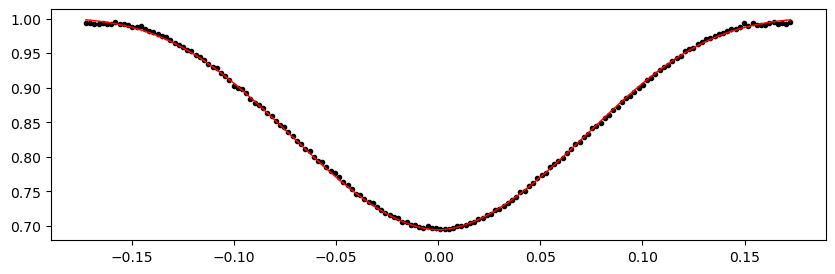

2218.583031 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.98it/s]


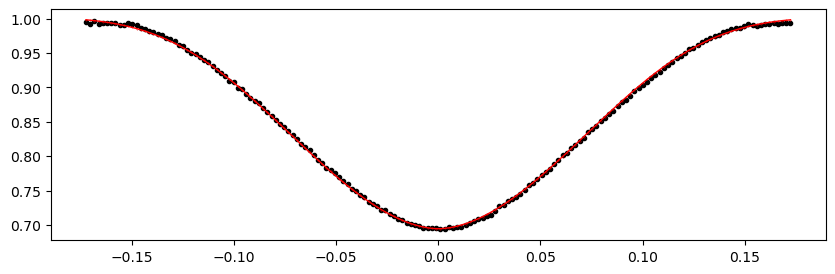

2219.255292 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.63it/s]


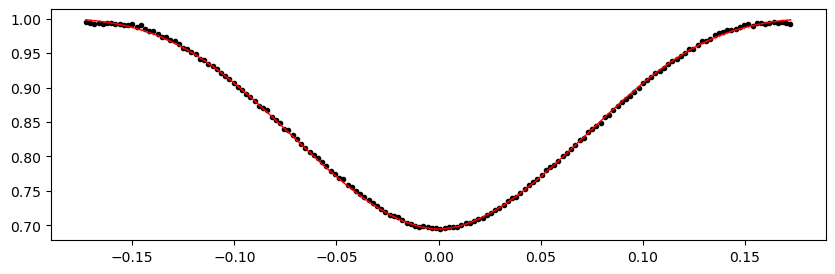

2219.927553 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1357.93it/s]


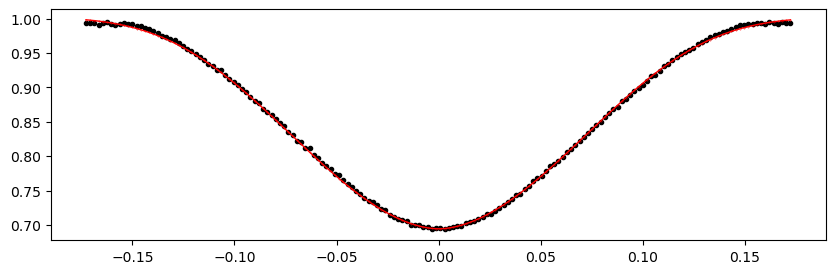

2220.599814 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.30it/s]


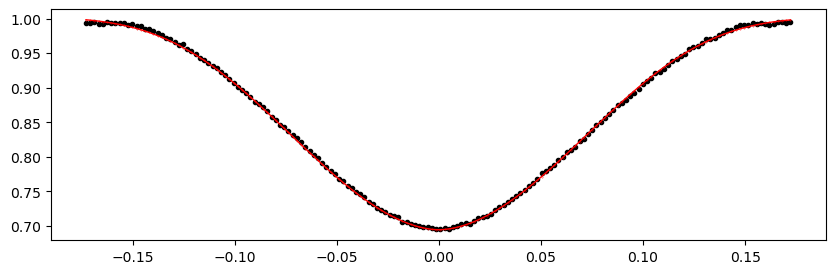

2221.272075 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.09it/s]


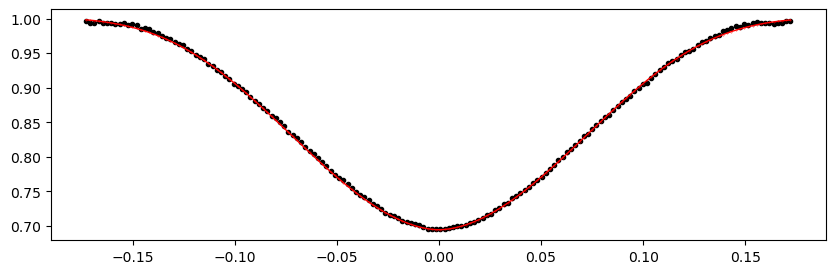

2221.944336 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.81it/s]


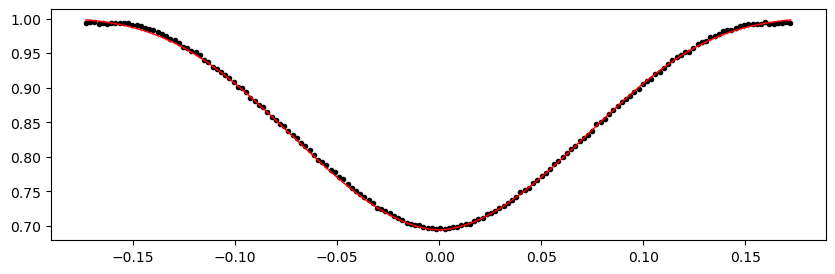

2222.616597 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1360.83it/s]


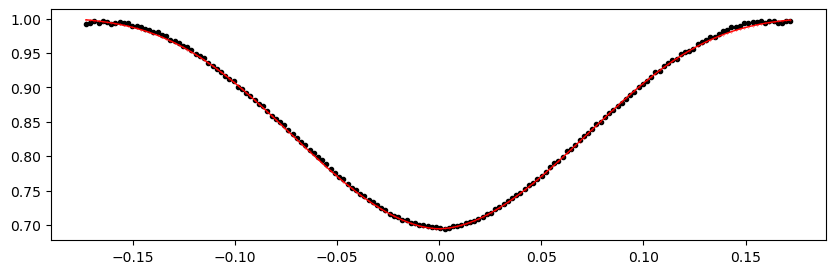

2223.288858 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.04it/s]


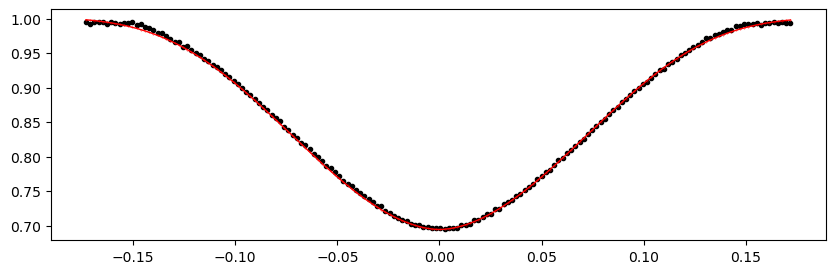

2223.961119 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.05it/s]


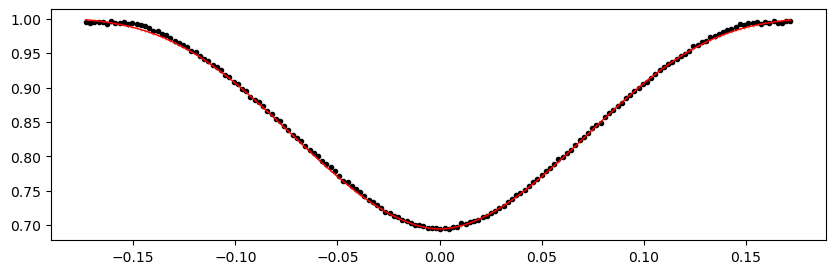

2224.63338 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.84it/s]


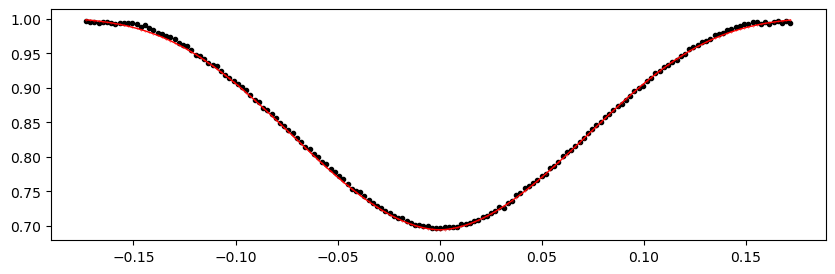

2225.305641 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1317.76it/s]


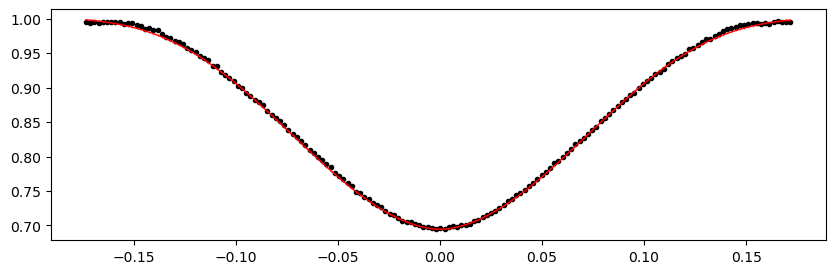

2225.977902 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1321.48it/s]


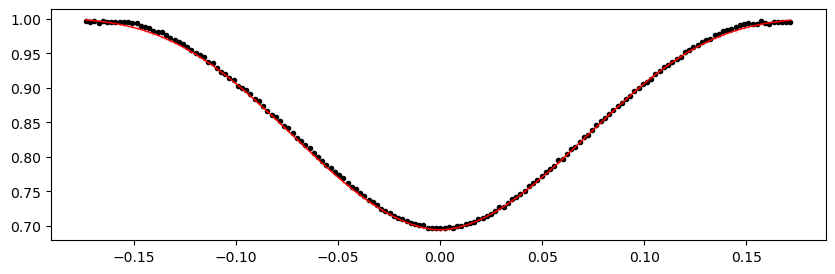

2226.6501630000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1135.38it/s]


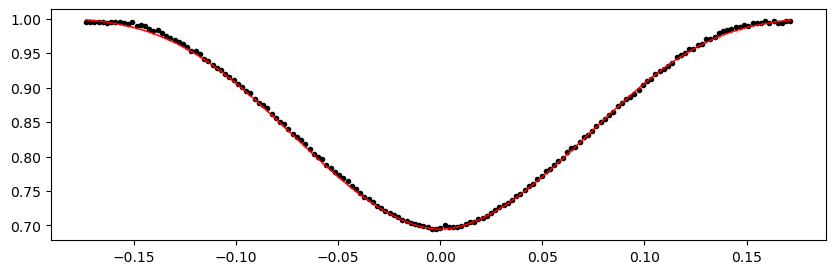

2227.322424 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:09<00:00, 1089.61it/s]


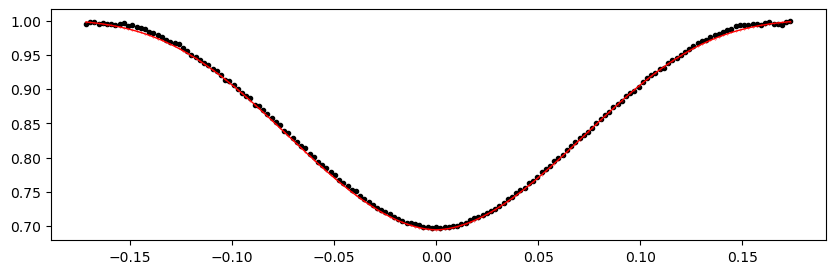

2229.339207 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1248.91it/s]


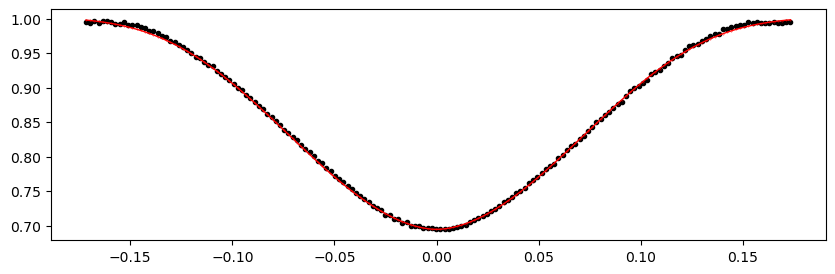

2230.011468 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1332.72it/s]


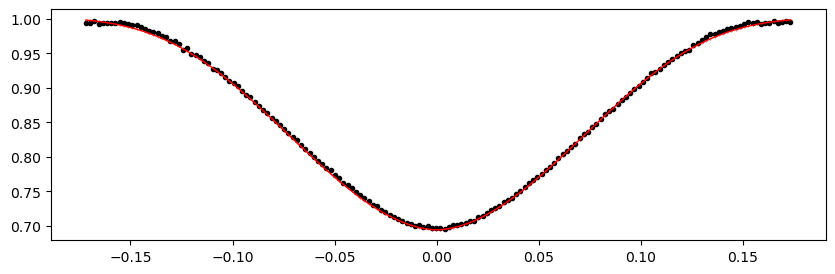

2230.683729 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.41it/s]


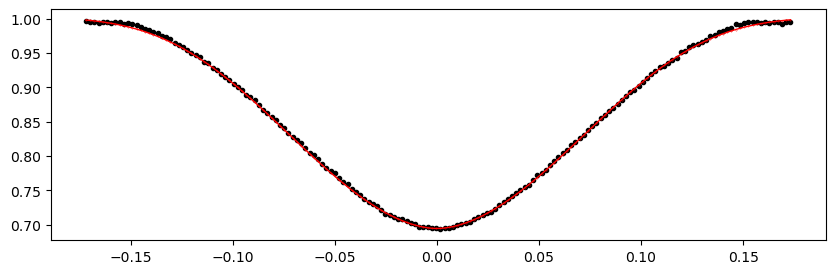

2231.35599 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.72it/s]


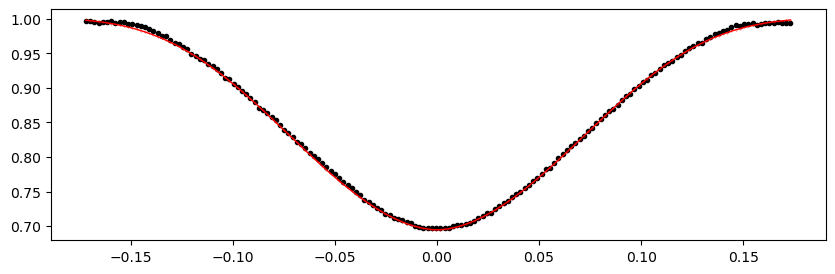

2232.028251 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.98it/s]


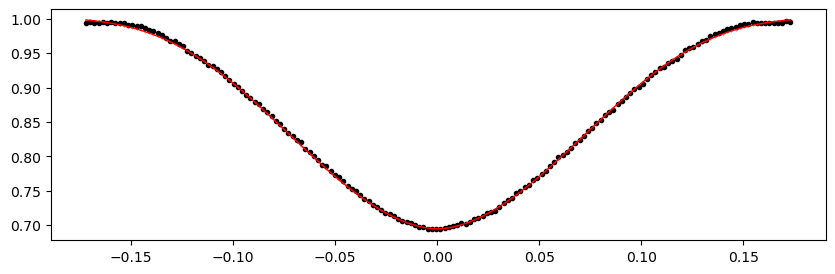

2232.700512 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.38it/s]


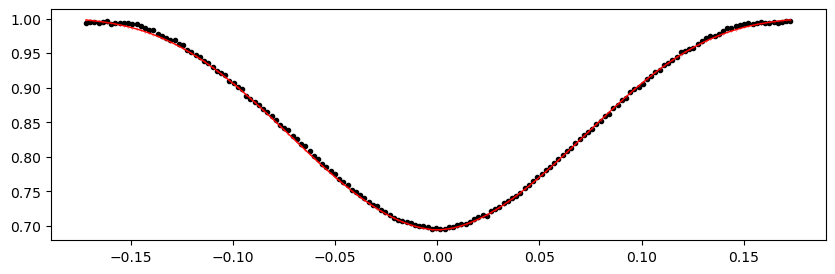

2233.372773 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1332.40it/s]


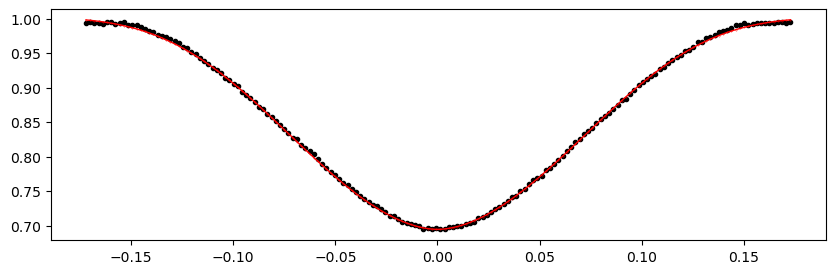

2234.045034 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.00it/s]


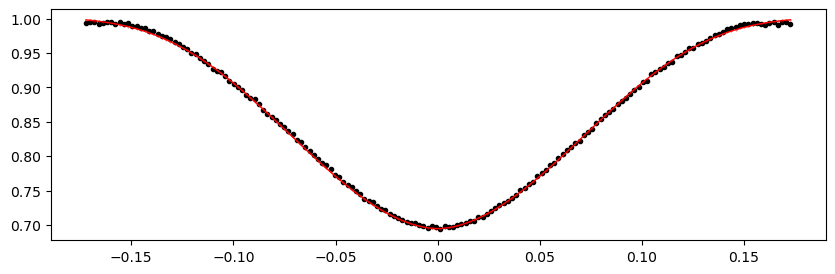

2234.717295 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1282.17it/s]


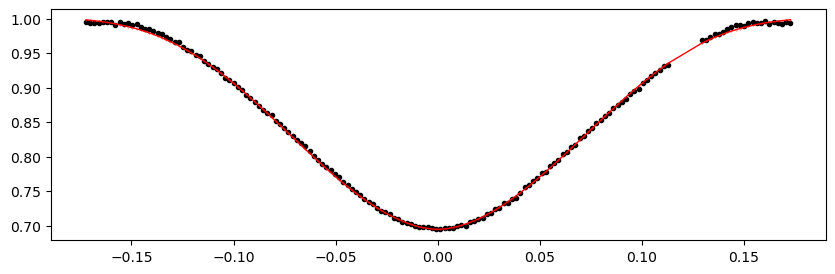

2235.389556 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1323.00it/s]


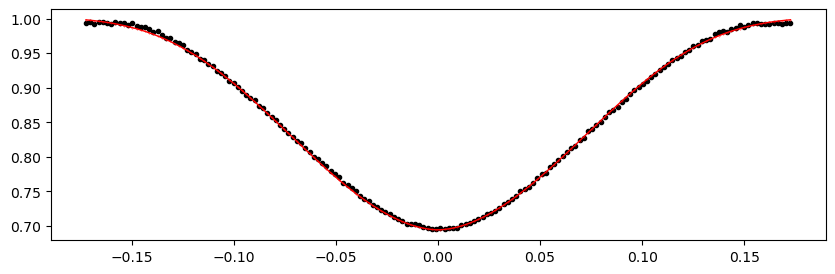

2236.061817 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1325.46it/s]


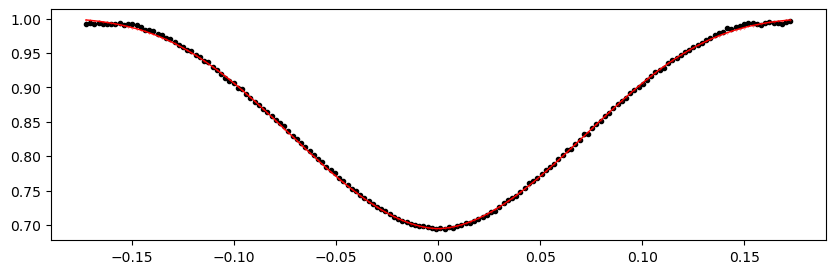

2236.734078 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.75it/s]


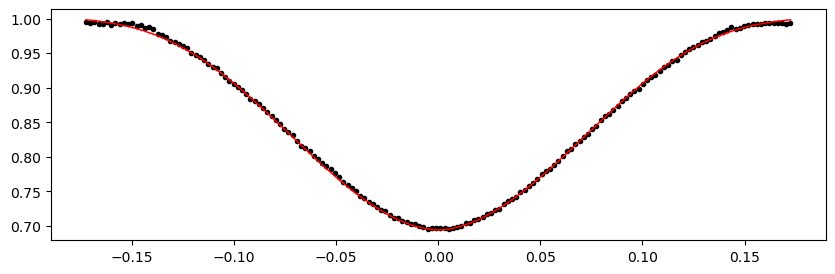

2237.406339 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1278.43it/s]


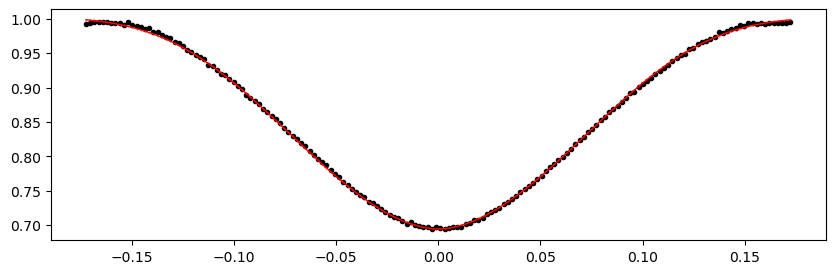

2238.0786 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1257.47it/s]


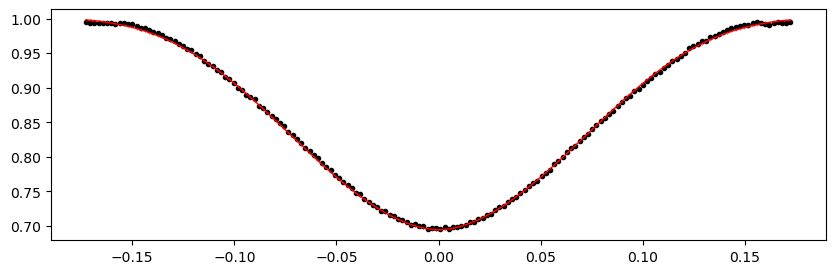

2238.750861 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.36it/s]


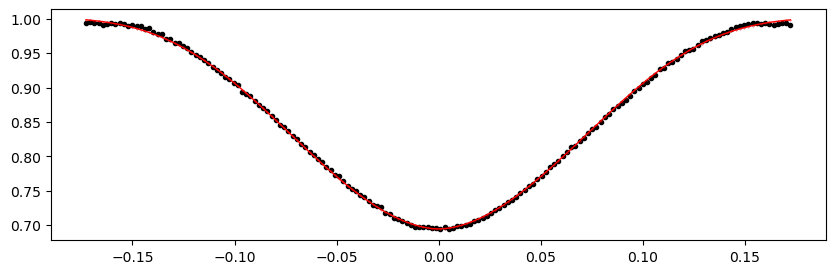

2239.423122 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.14it/s]


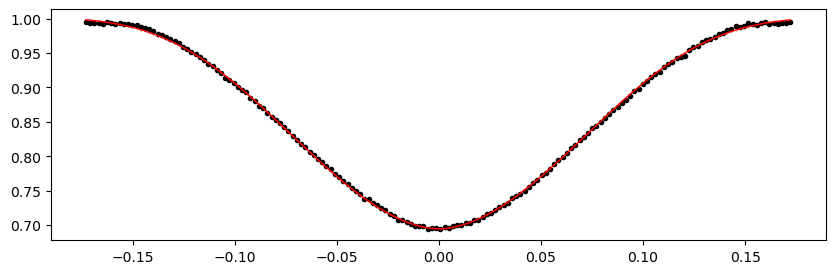

2240.095383 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1310.77it/s]


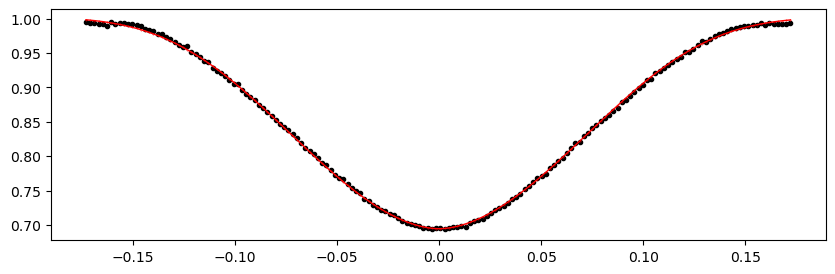

2240.767644 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.12it/s]


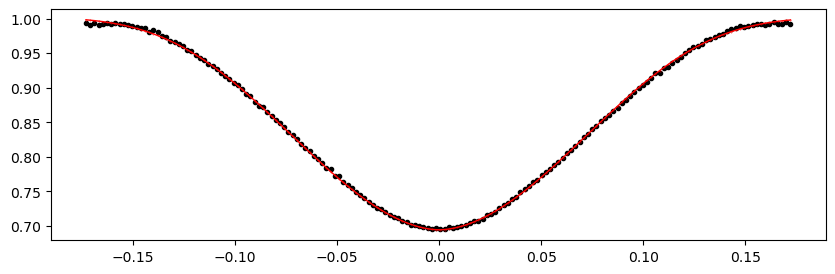

2242.784427 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.19it/s]


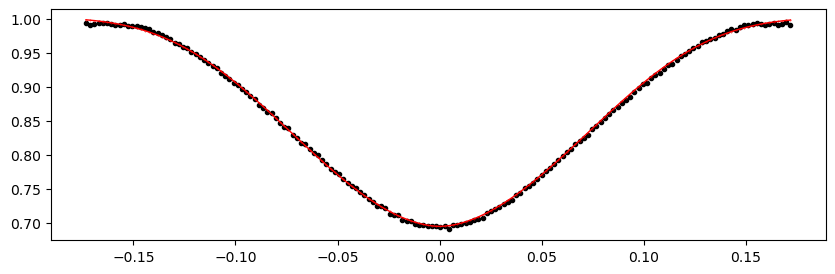

2243.456688 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.26it/s]


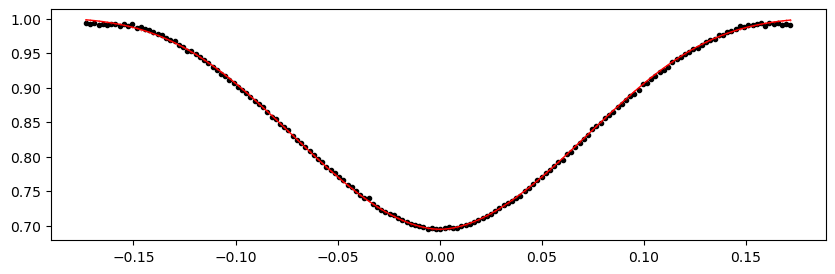

2244.128949 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.88it/s]


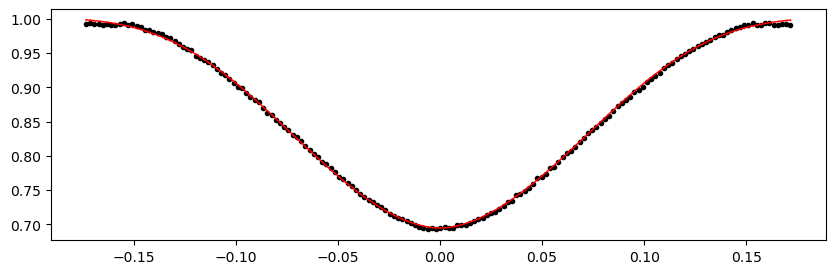

2244.80121 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.99it/s]


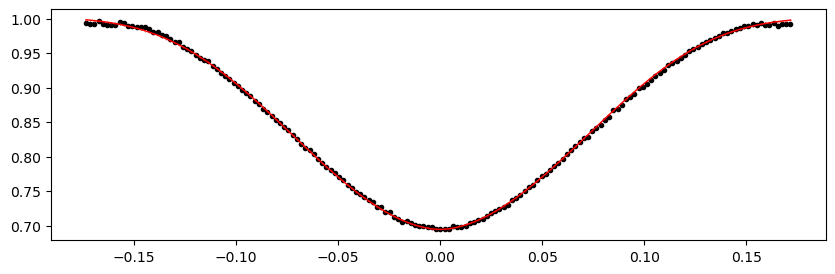

2245.4734710000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.89it/s]


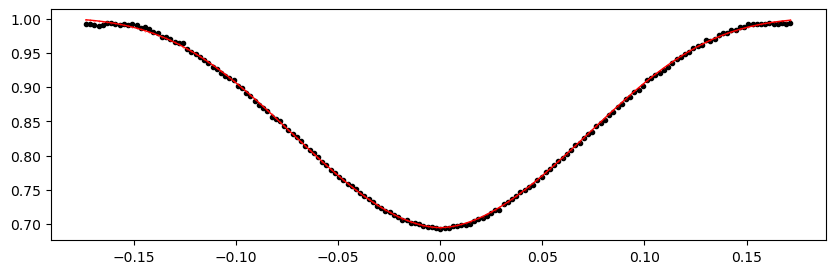

2246.145732 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.75it/s]


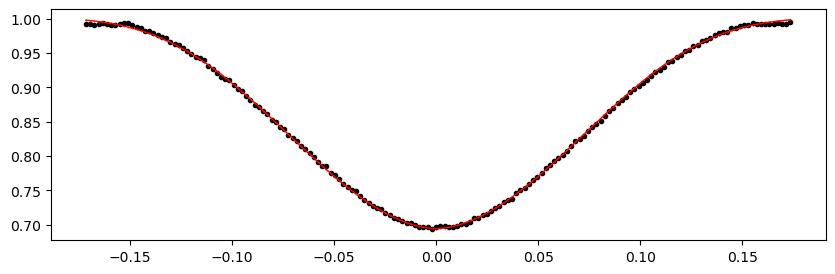

2246.817993 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.66it/s]


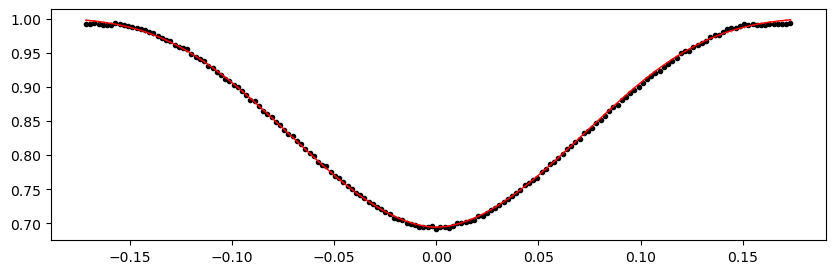

2247.490254 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.00it/s]


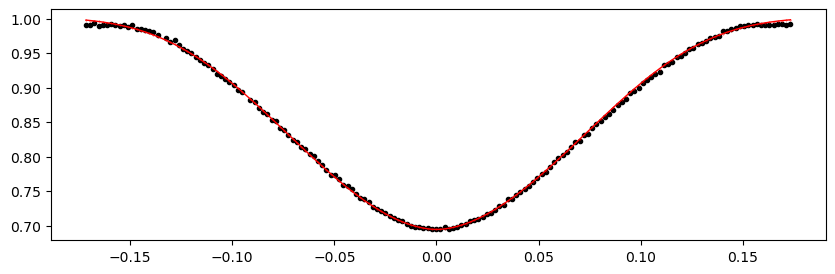

2248.162515 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.82it/s]


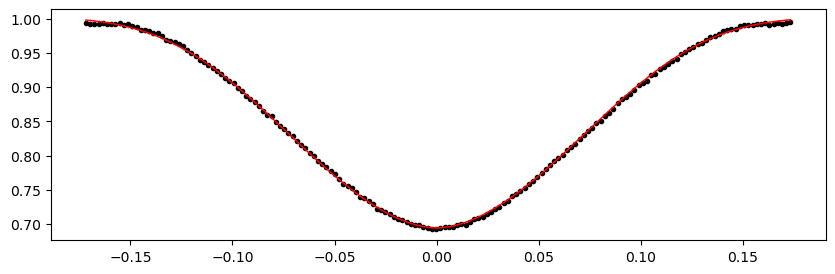

2248.834776 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.08it/s]


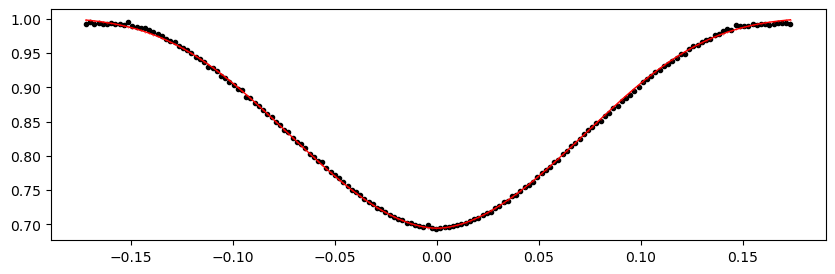

2249.507037 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.18it/s]


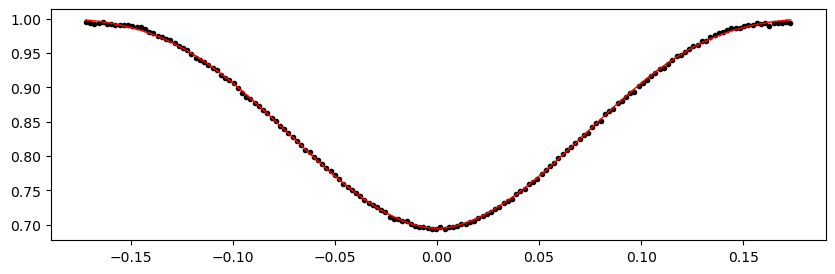

2250.179298 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.70it/s]


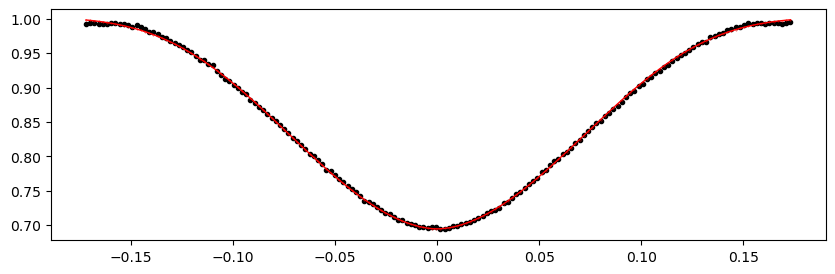

2250.851559 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.48it/s]


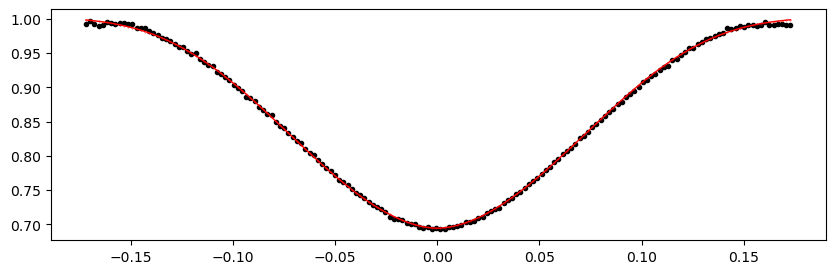

2251.52382 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.96it/s]


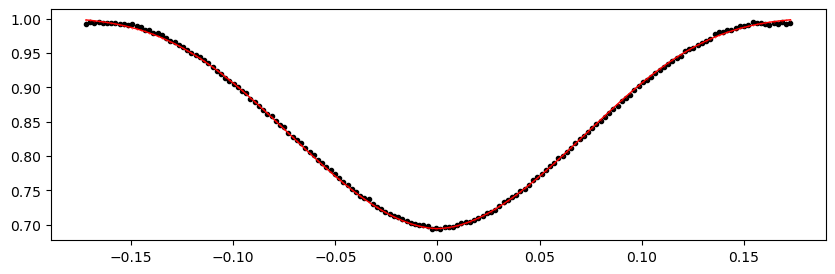

2252.196081 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.21it/s]


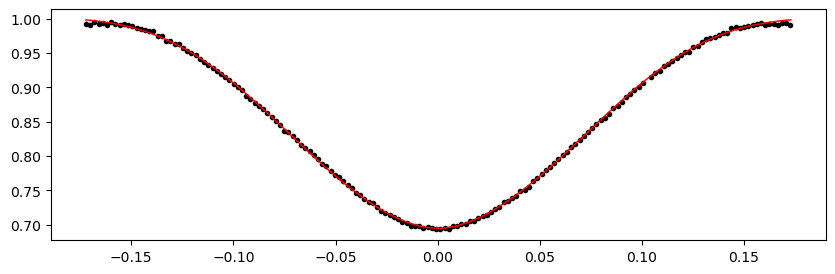

2252.868342 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.42it/s]


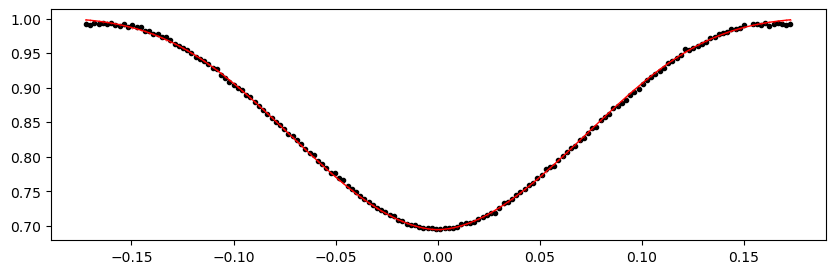

2253.540603 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.56it/s]


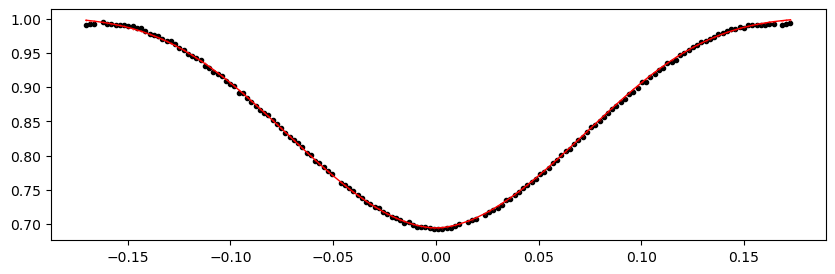

2256.229647 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.16it/s]


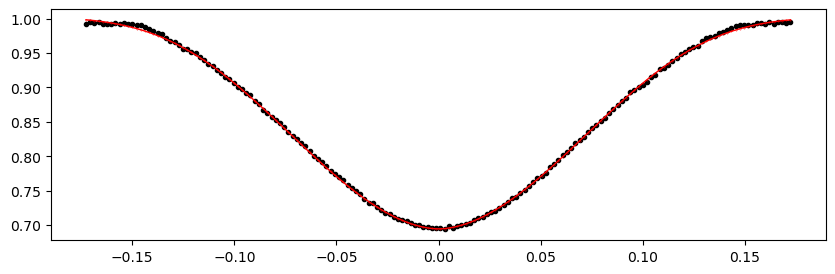

2256.901908 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.79it/s]


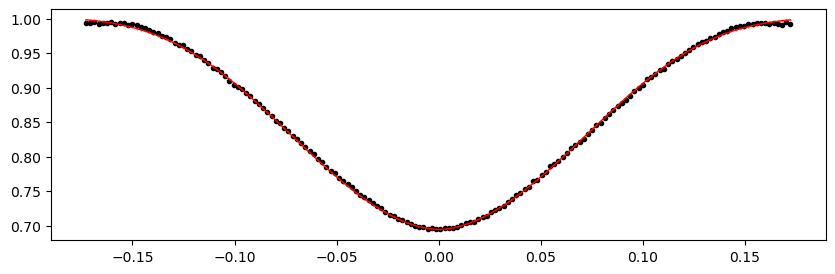

2257.574169 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.37it/s]


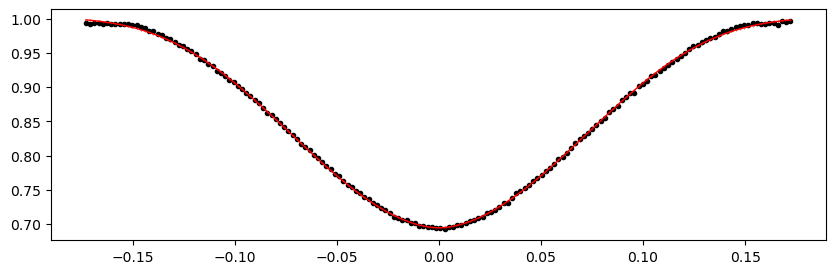

2258.24643 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.98it/s]


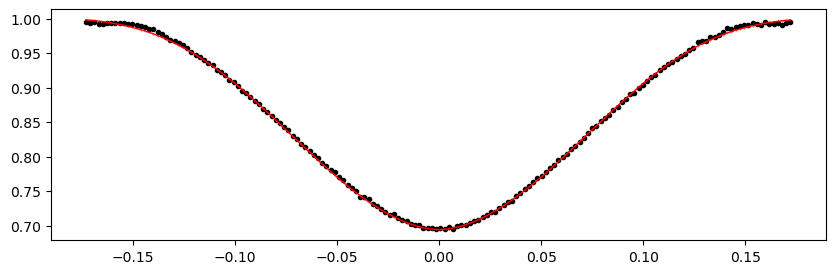

2258.918691 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1316.51it/s]


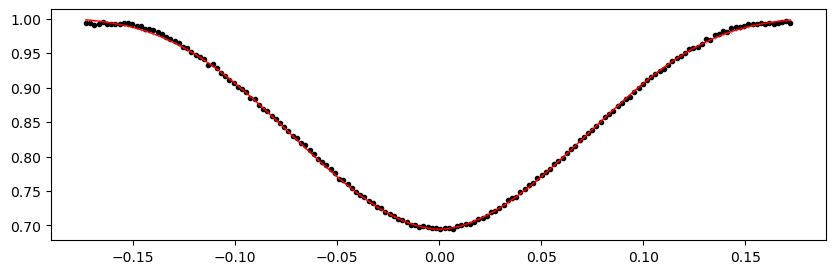

2259.590952 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1325.80it/s]


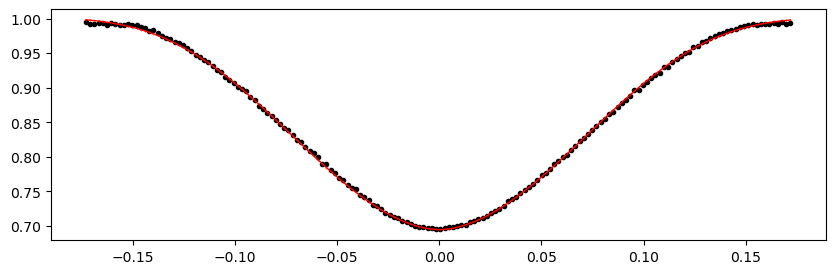

2260.263213 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.13it/s]


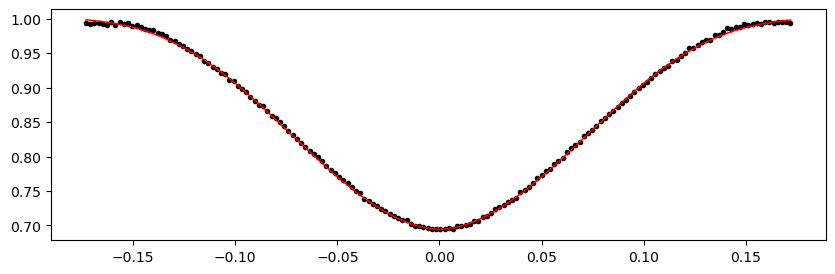

2260.935474 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.47it/s]


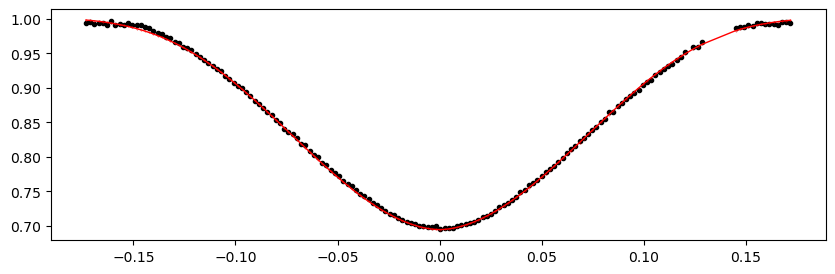

2261.607735 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1325.37it/s]


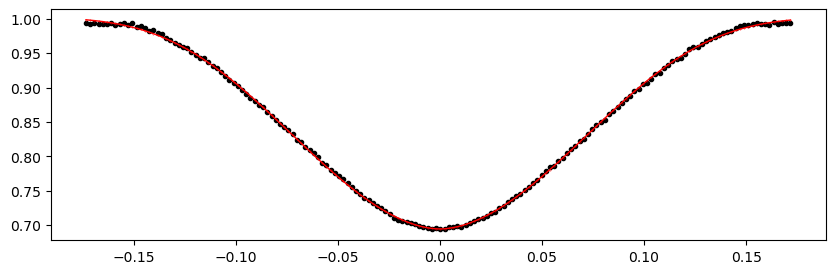

2262.279996 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.37it/s]


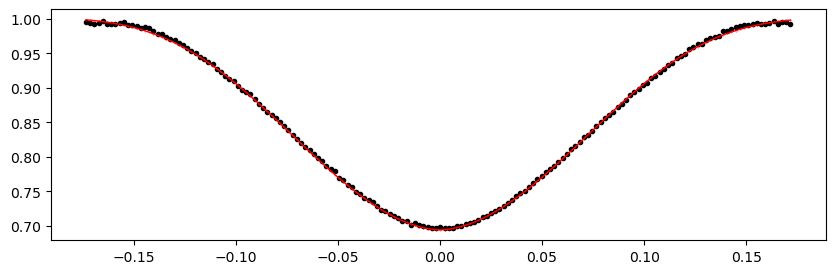

2262.952257 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1301.14it/s]


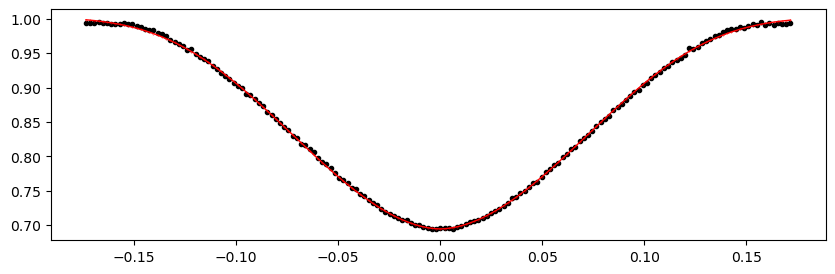

2263.624518 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.75it/s]


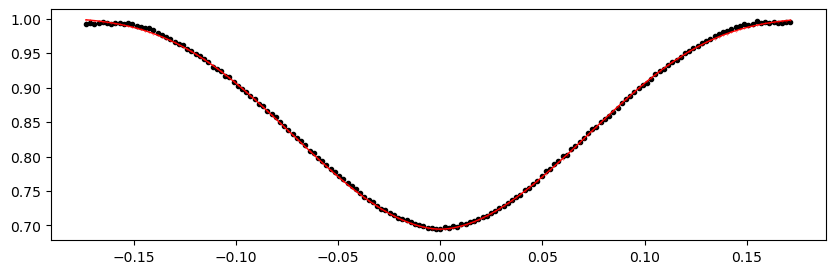

2264.2967790000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.81it/s]


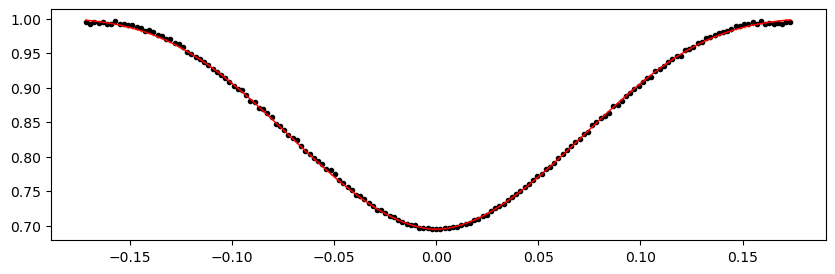

2264.96904 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.74it/s]


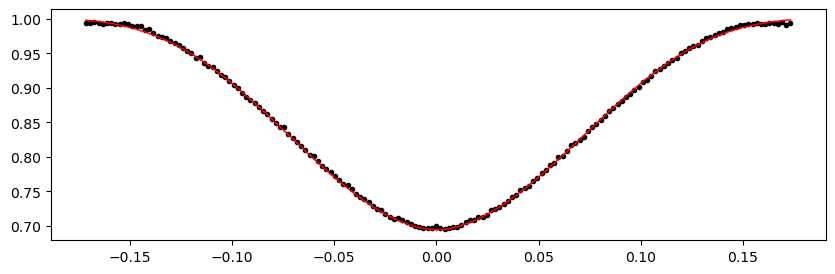

2265.641301 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1331.69it/s]


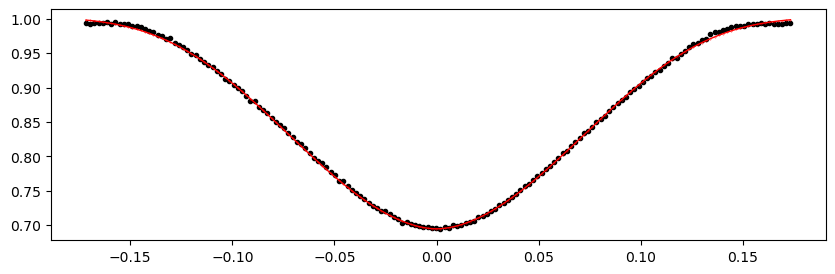

2266.313562 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1317.28it/s]


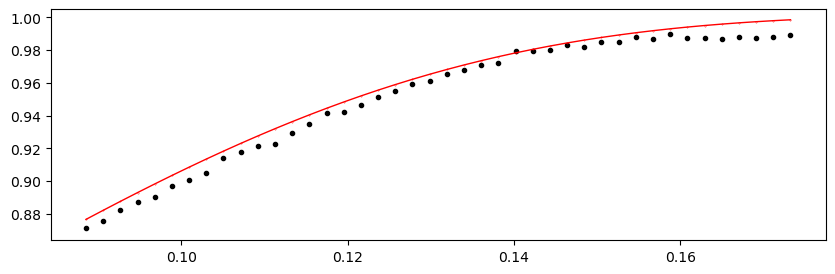

2266.985823 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.82it/s]


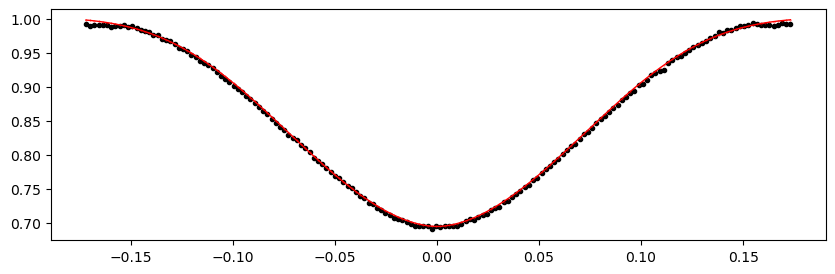

2272.363911 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.22it/s]


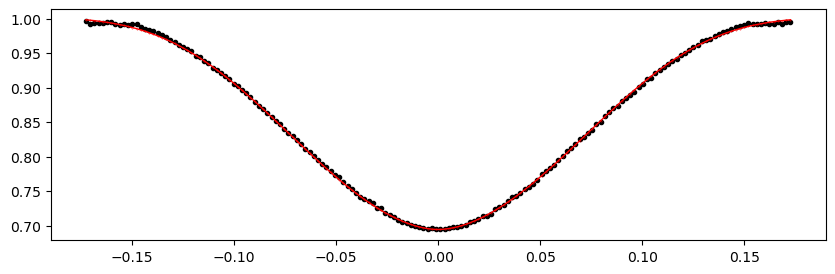

2273.036172 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.94it/s]


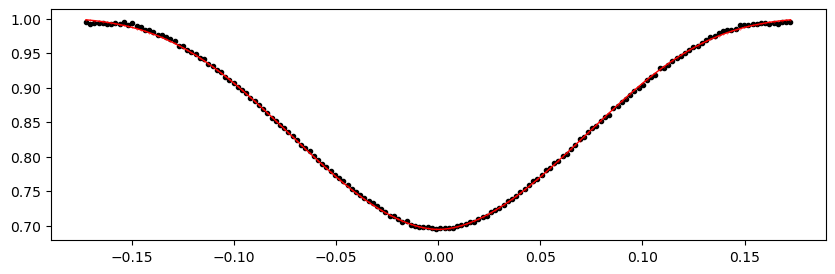

2273.708433 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.80it/s]


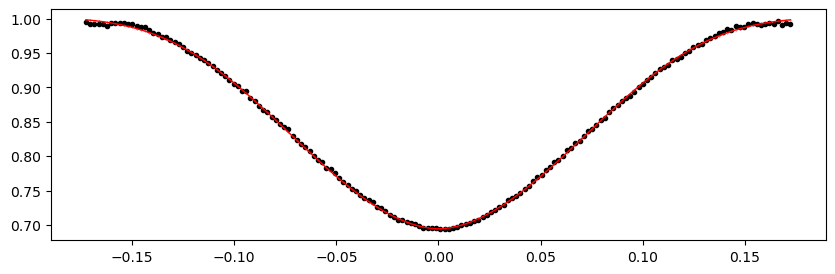

2274.380694 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.92it/s]


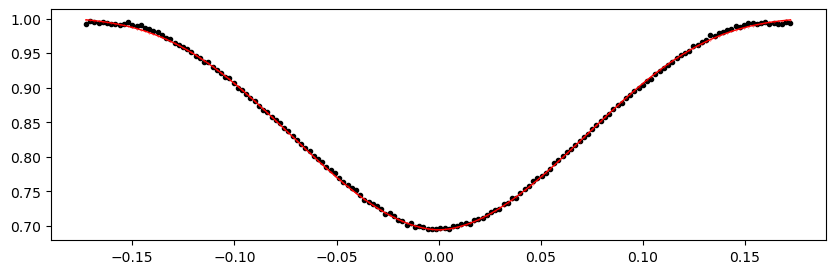

2275.052955 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.26it/s]


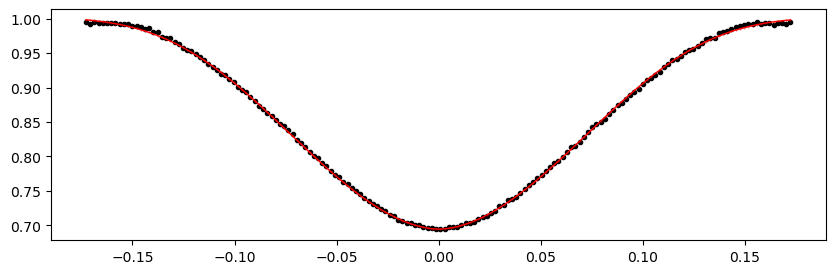

2275.725216 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.51it/s]


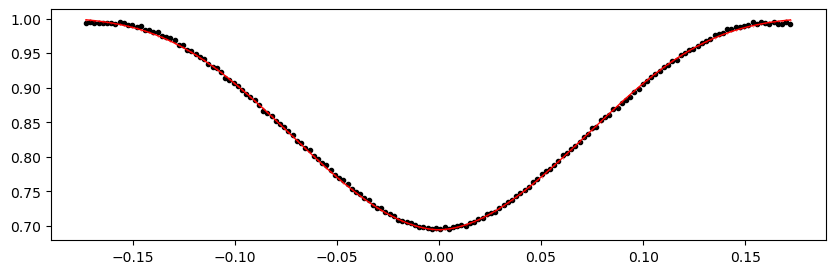

2276.397477 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.94it/s]


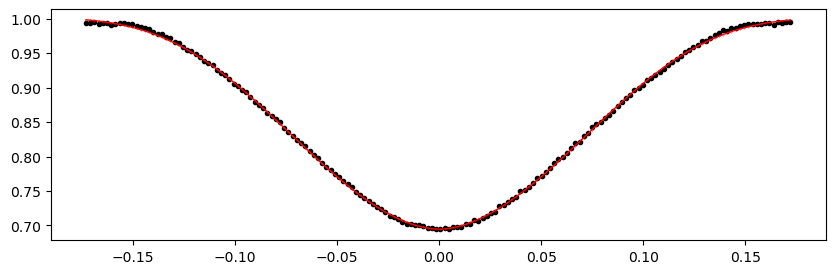

2277.069738 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1323.38it/s]


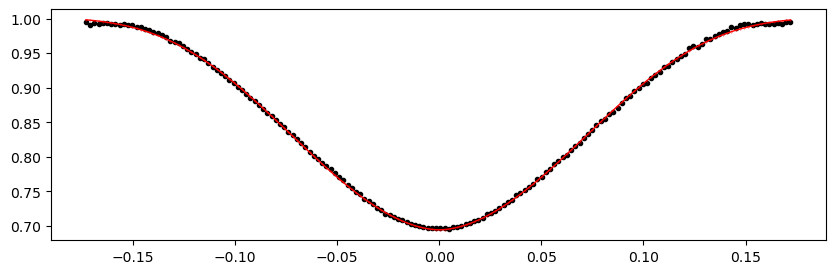

2277.741999 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.08it/s]


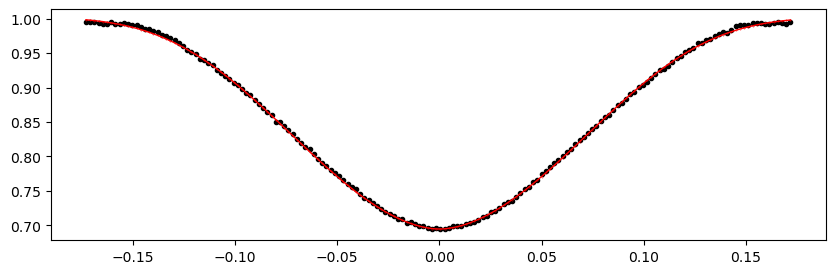

2278.41426 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.14it/s]


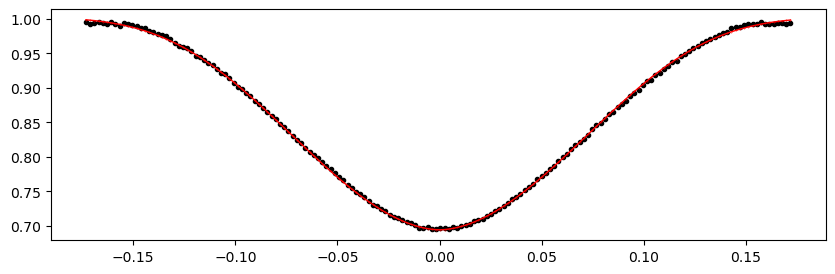

2279.086521 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.89it/s]


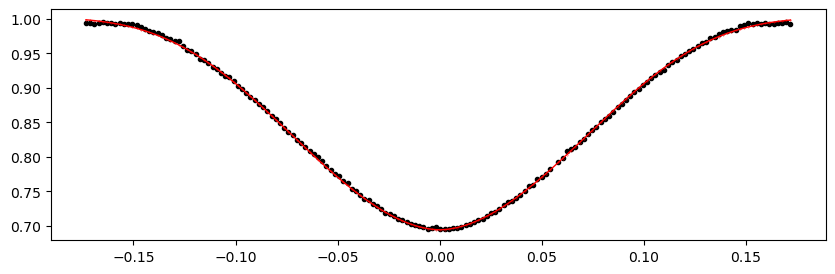

2279.758782 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.87it/s]


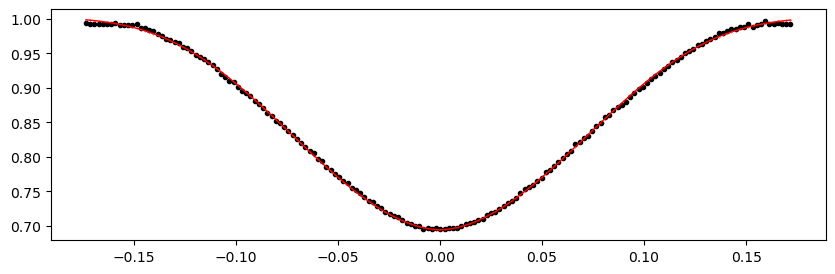

2282.447826 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.95it/s]


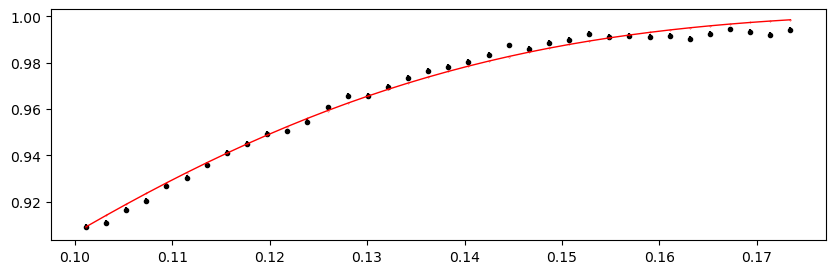

2283.1200870000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.52it/s]


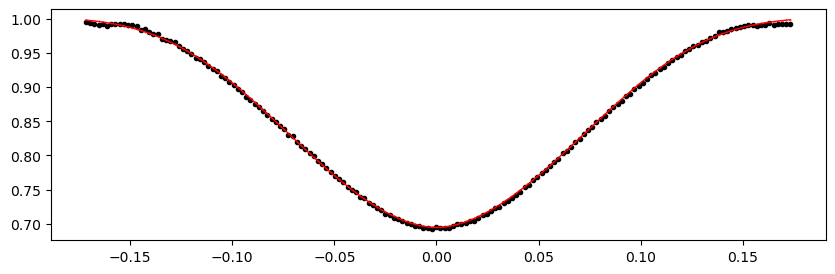

2283.792348 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.79it/s]


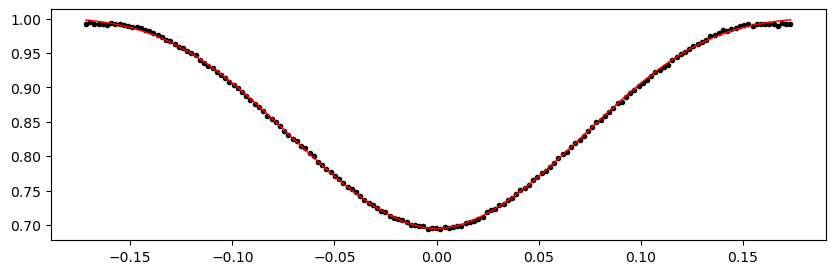

2284.464609 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.15it/s]


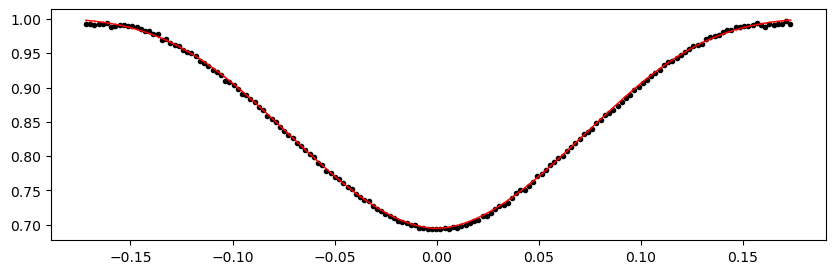

2285.13687 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.63it/s]


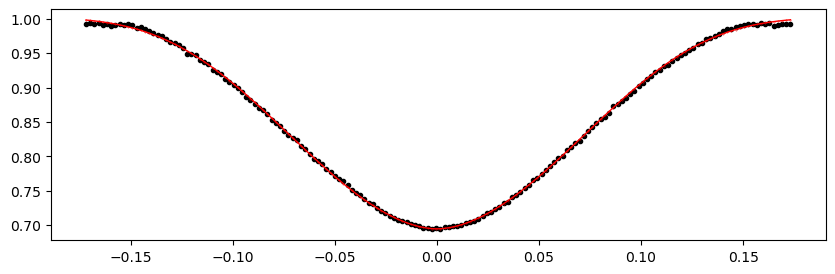

2285.809131 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1261.26it/s]


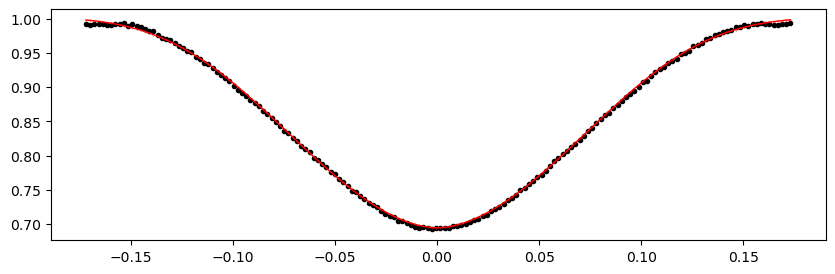

2286.481392 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1282.93it/s]


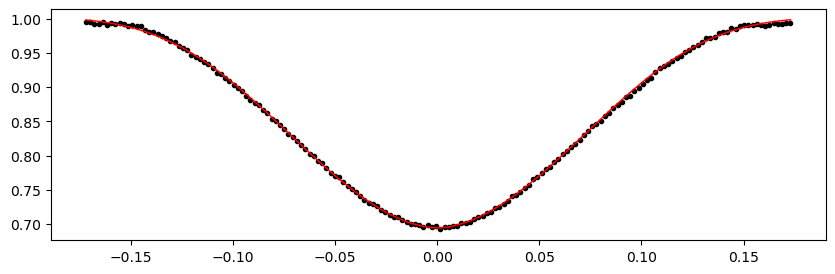

2287.153653 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.70it/s]


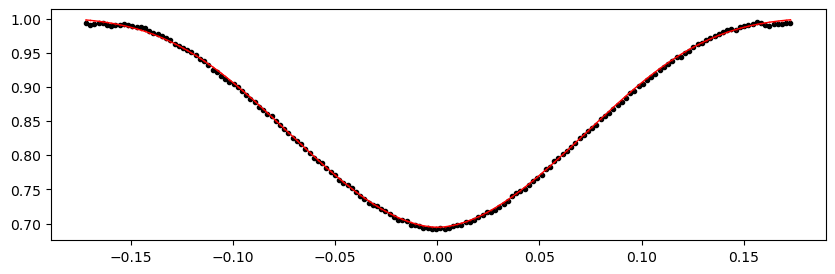

2287.825914 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.20it/s]


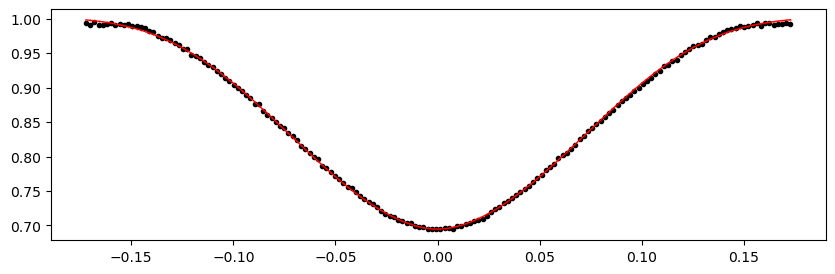

2288.498175 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.91it/s]


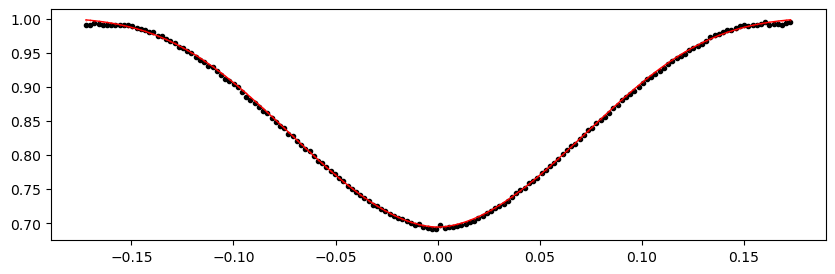

2289.170436 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1307.19it/s]


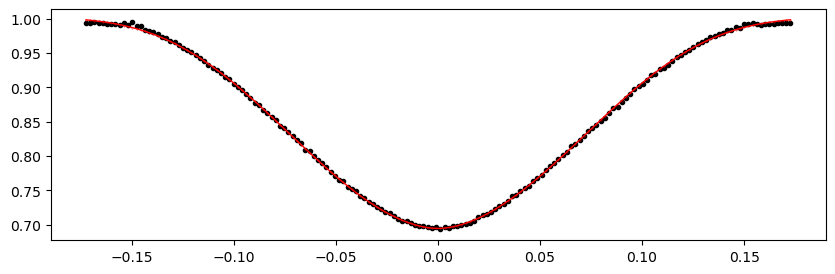

2289.842697 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1323.24it/s]


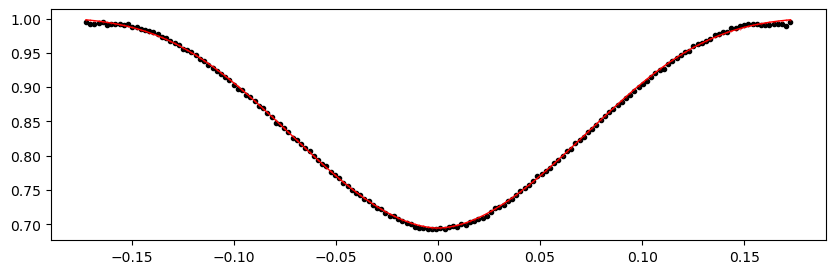

2290.514958 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.68it/s]


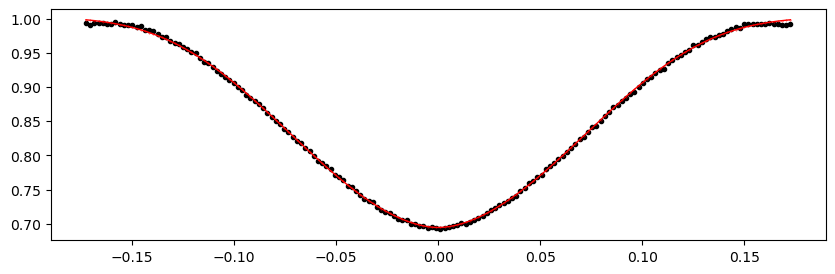

2291.187219 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.06it/s]


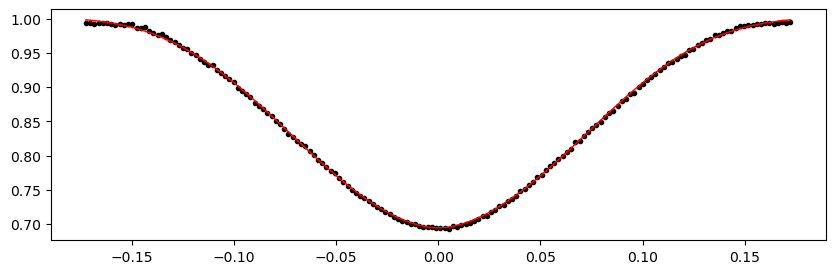

2291.85948 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1320.31it/s]


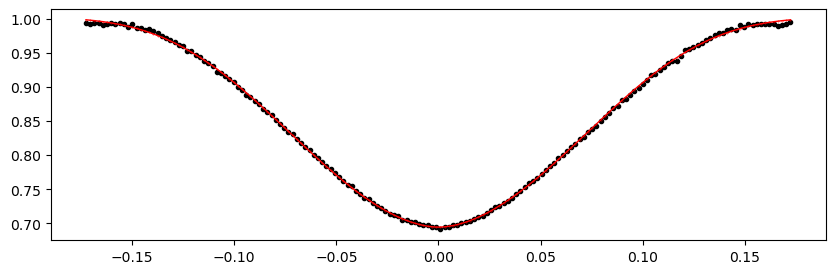

2292.531741 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1332.81it/s]


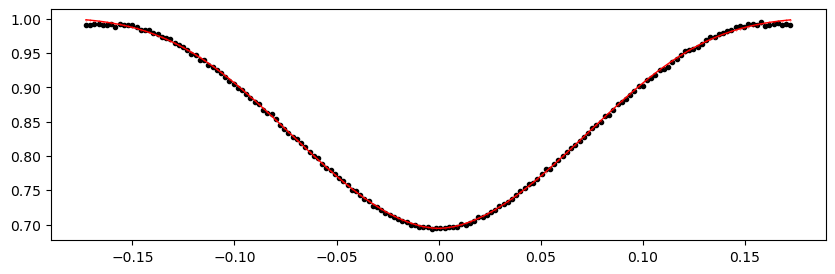

2295.893046 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.03it/s]


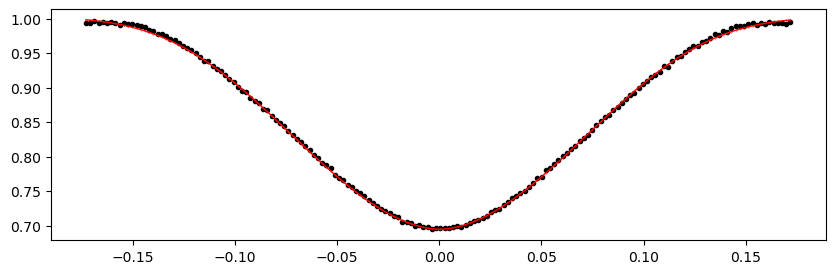

2296.565307 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1333.79it/s]


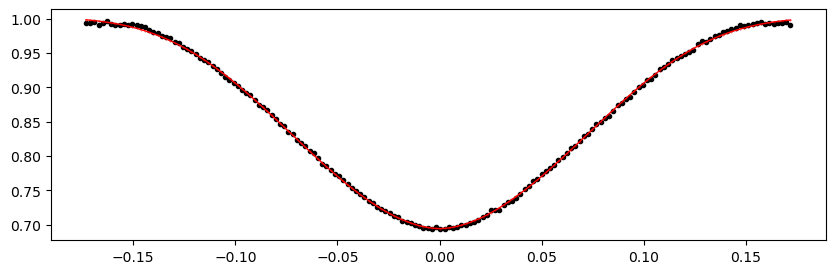

2297.237568 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.16it/s]


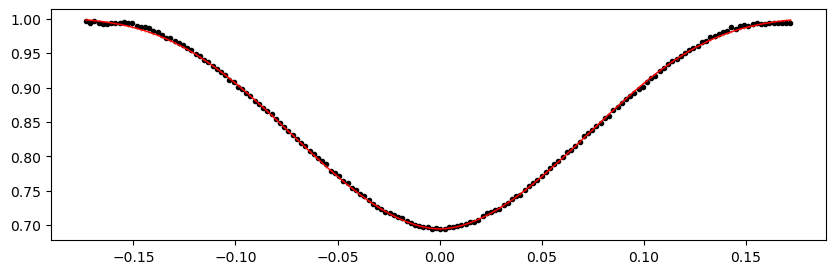

2297.909829 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.77it/s]


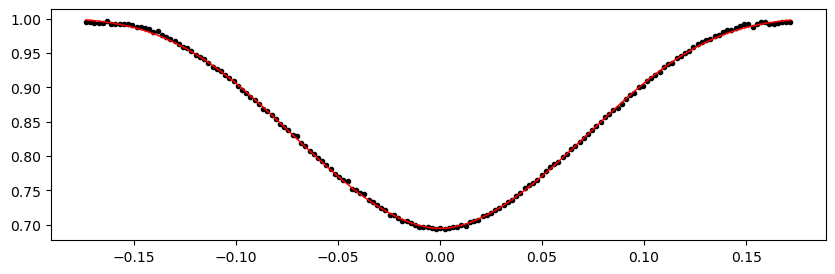

2298.58209 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1319.99it/s]


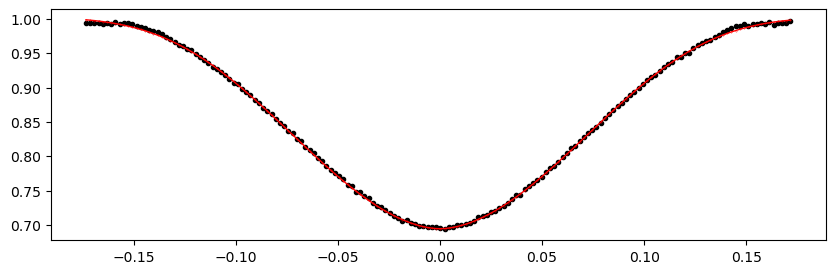

2299.254351 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.28it/s]


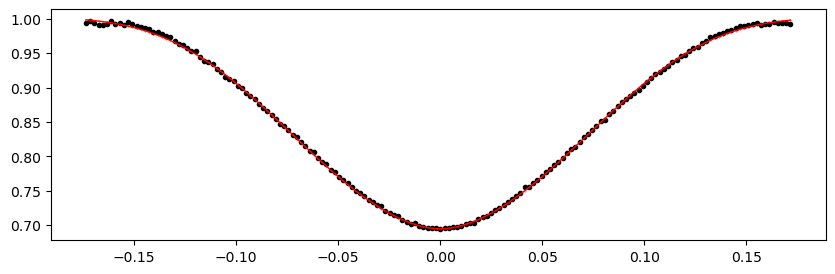

2299.926612 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.88it/s]


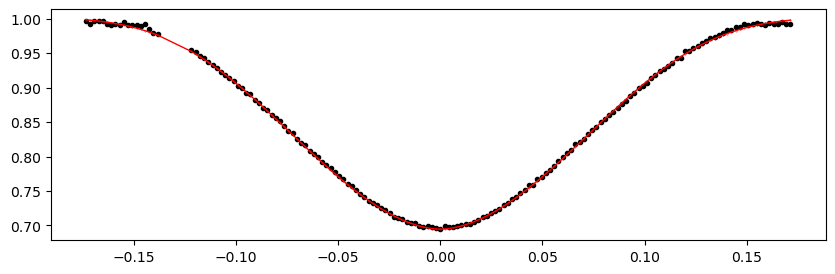

2300.598873 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.97it/s]


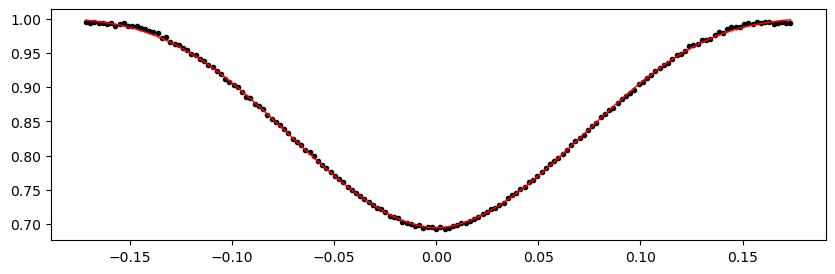

2301.271134 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1333.90it/s]


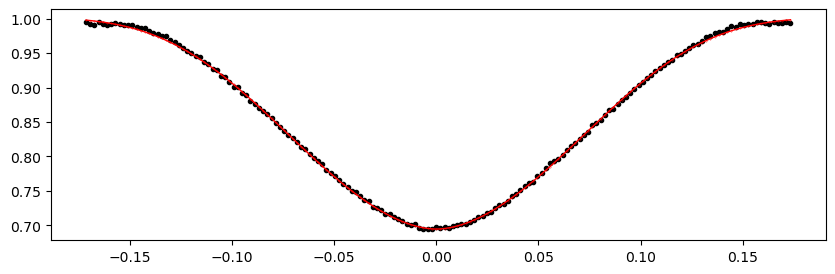

2301.9433950000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1331.89it/s]


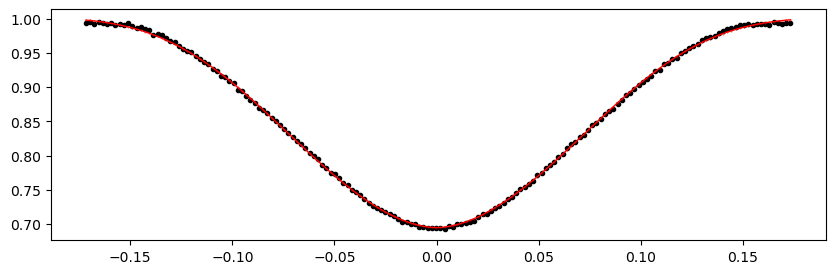

2302.615656 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.14it/s]


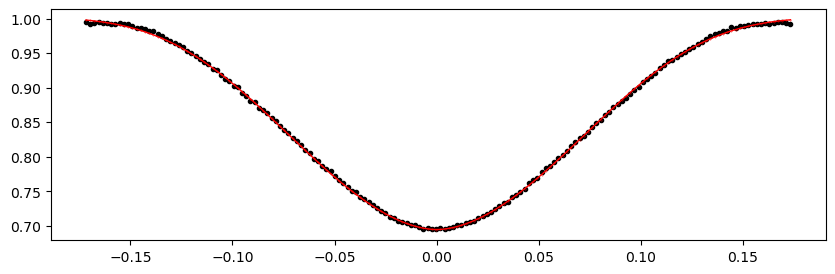

2303.287917 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.29it/s]


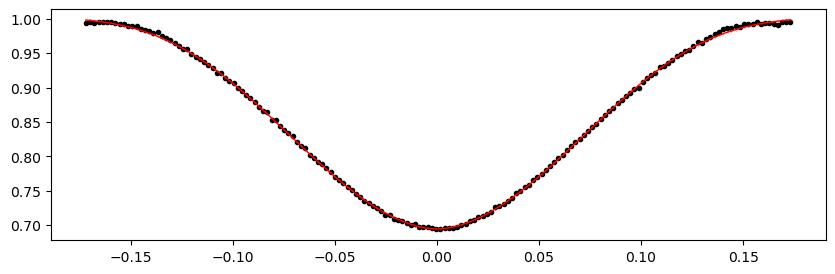

2303.9601780000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.74it/s]


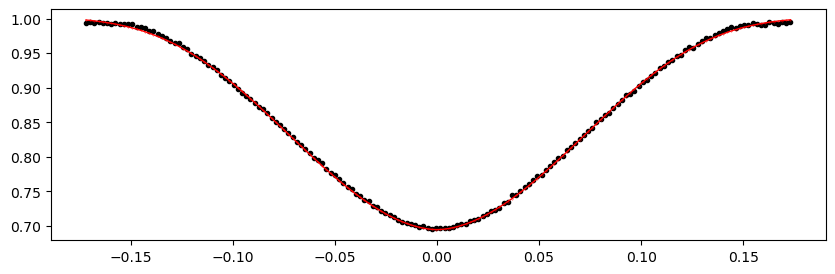

2304.632439 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.28it/s]


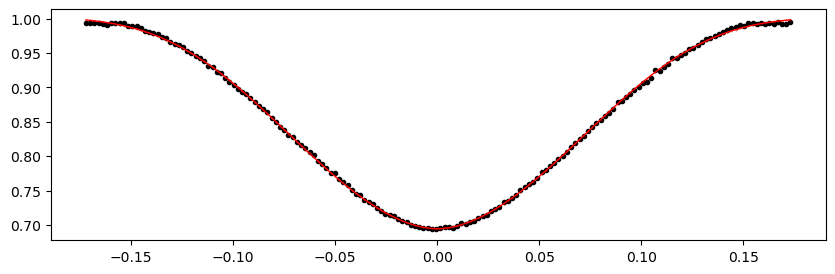

2305.3047 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.41it/s]


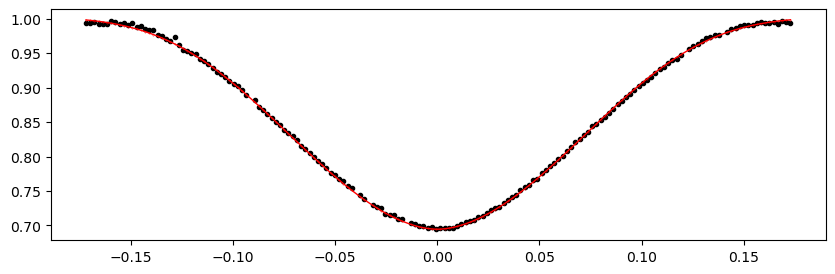

2305.976961 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.54it/s]


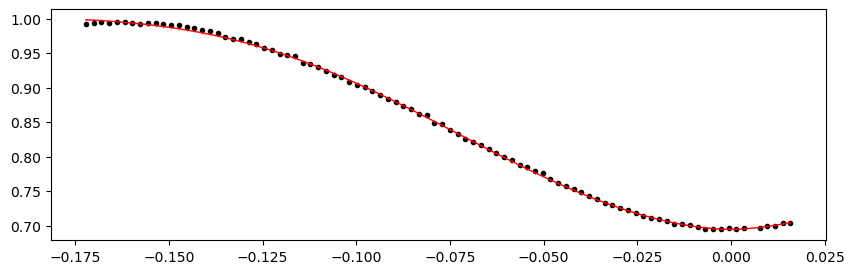

2310.010527 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.24it/s]


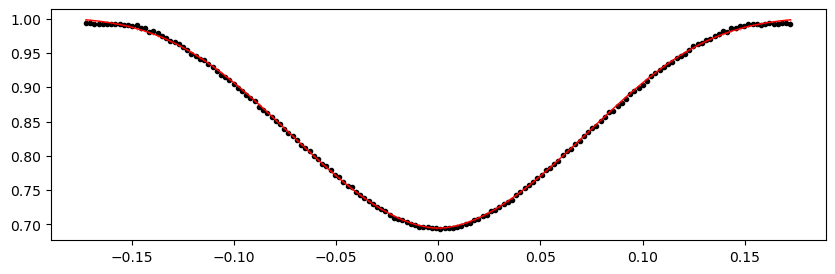

2310.682788 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1313.39it/s]


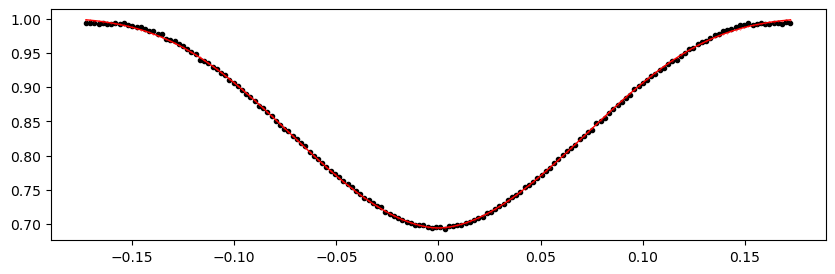

2311.355049 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1268.73it/s]


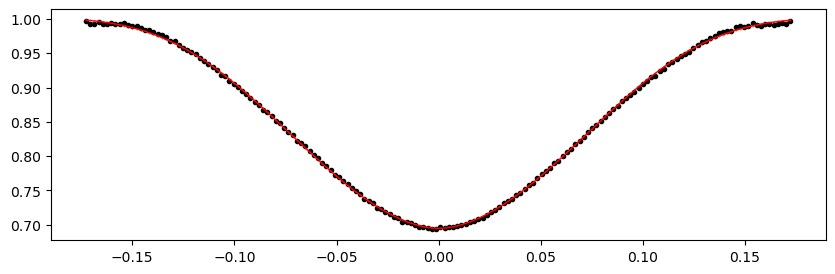

2312.02731 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1265.03it/s]


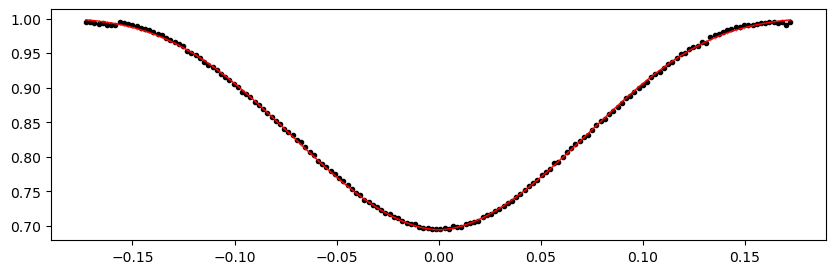

2312.699571 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1289.88it/s]


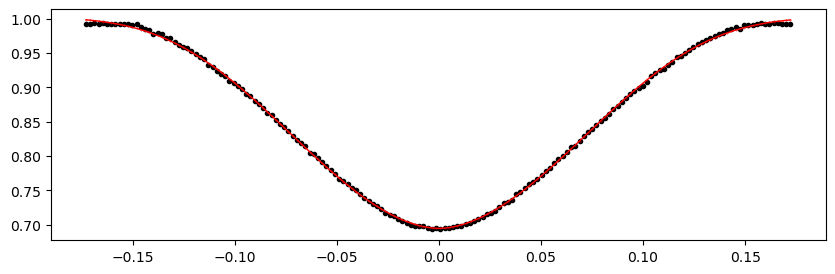

2313.371832 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.33it/s]


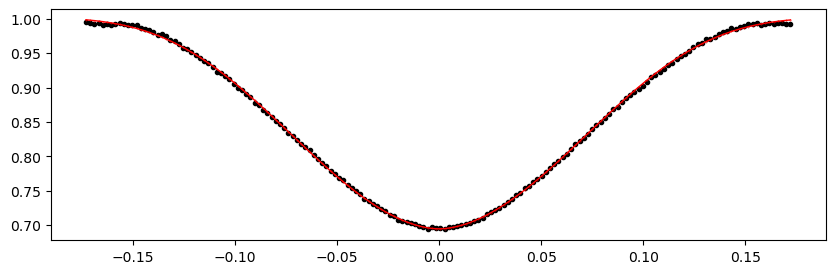

2314.044093 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1315.69it/s]


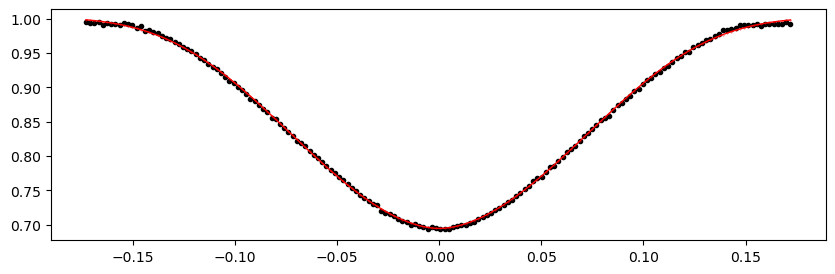

2314.716354 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.02it/s]


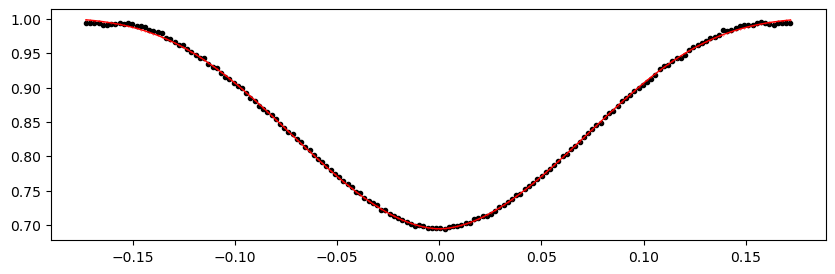

2315.388615 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.07it/s]


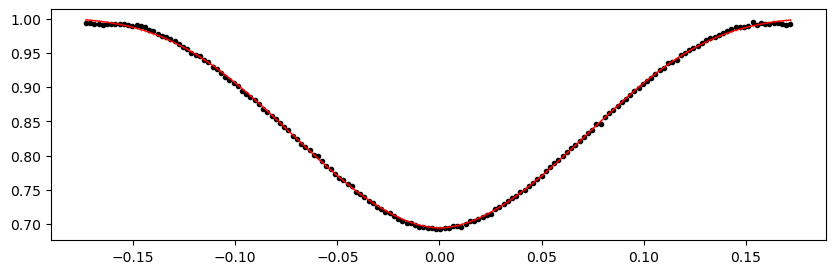

2316.060876 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1321.81it/s]


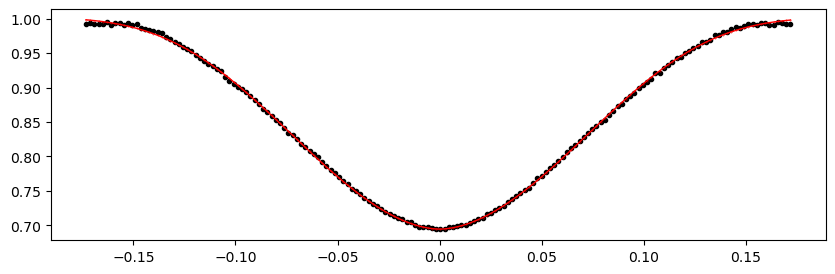

2316.733137 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.94it/s]


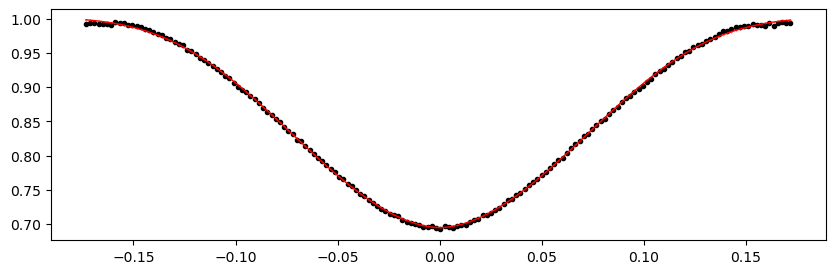

2317.405398 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.68it/s]


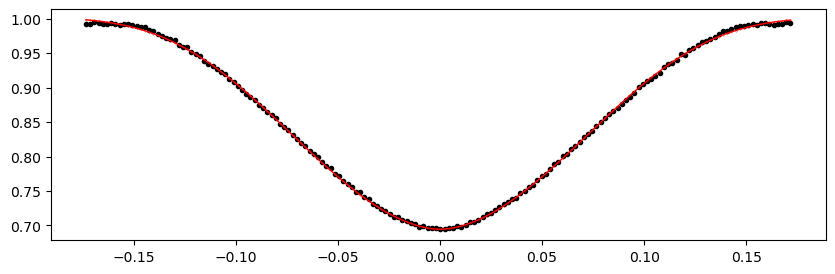

2318.077659 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.20it/s]


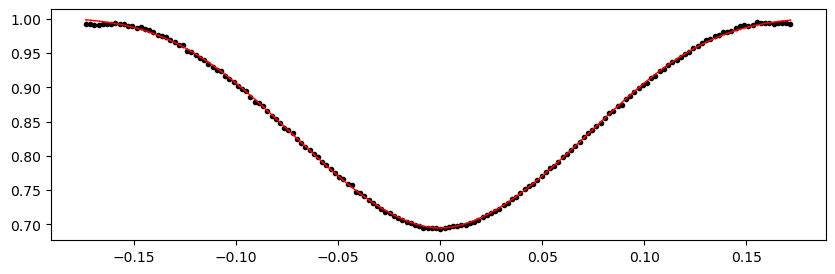

2318.74992 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.26it/s]


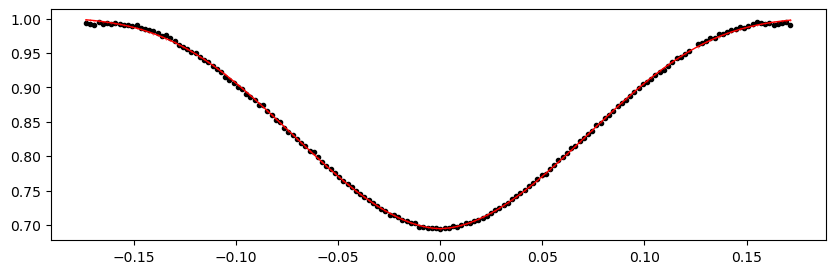

2323.455747 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1317.69it/s]


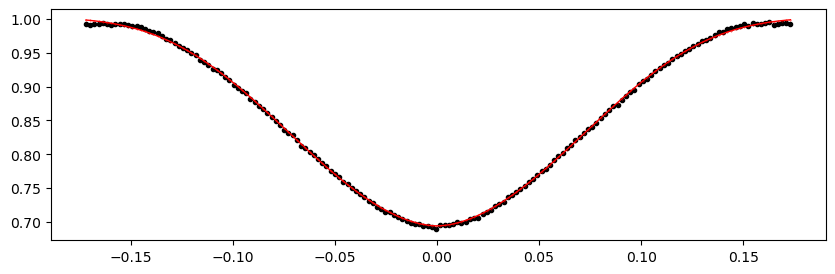

2324.128008 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1330.79it/s]


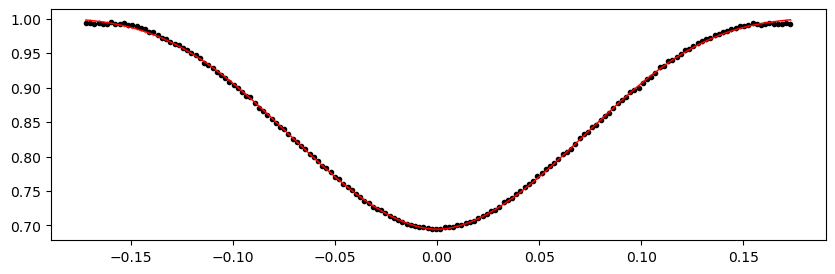

2324.800269 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.12it/s]


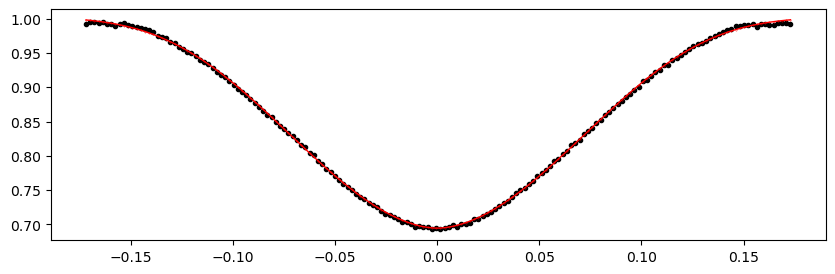

2325.47253 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.63it/s]


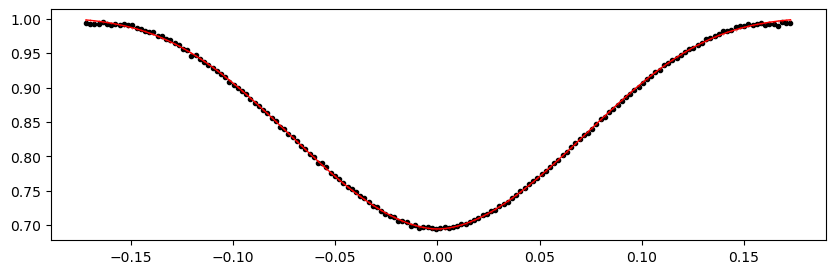

2326.144791 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1319.92it/s]


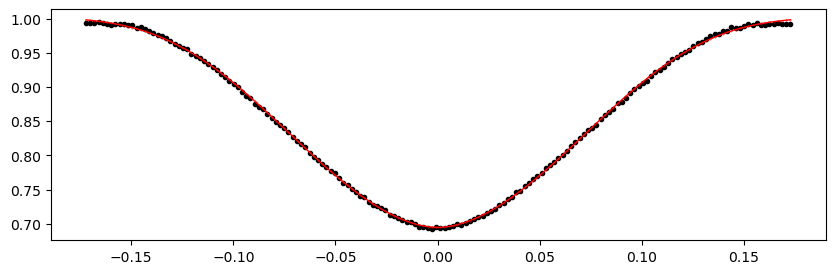

2326.817052 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1318.47it/s]


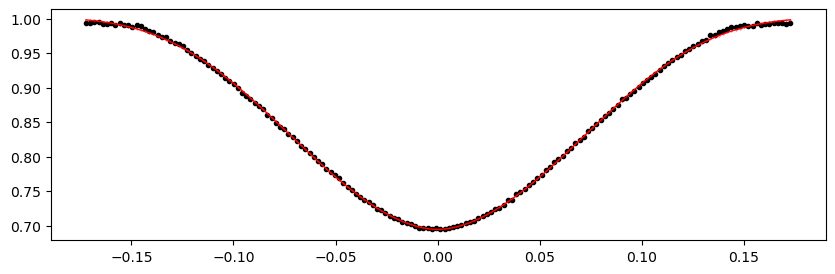

2327.489313 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1331.83it/s]


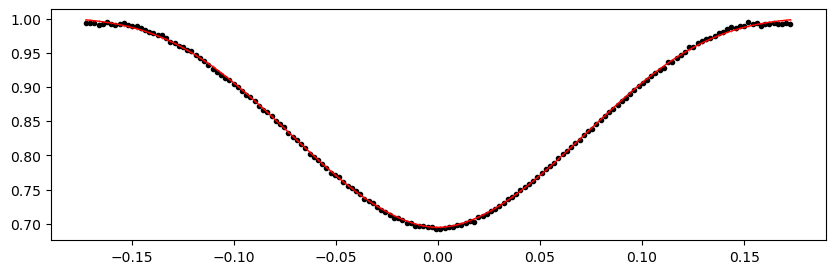

2328.161574 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.75it/s]


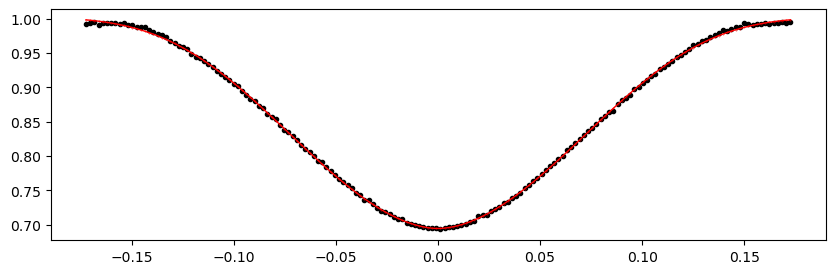

2328.833835 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.44it/s]


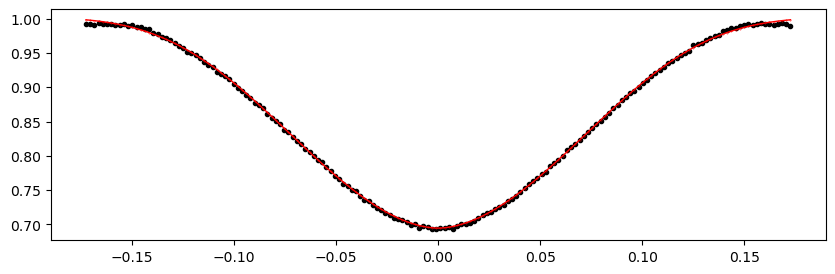

2329.506096 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.00it/s]


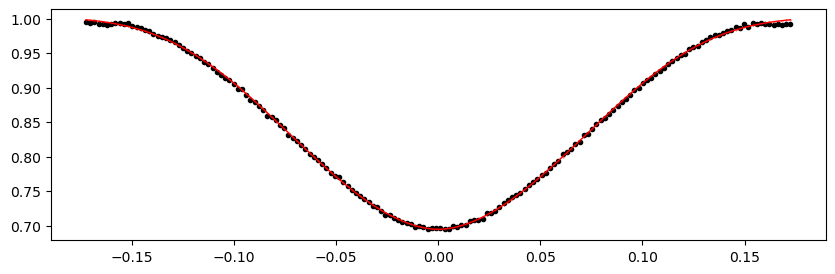

2330.178357 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.85it/s]


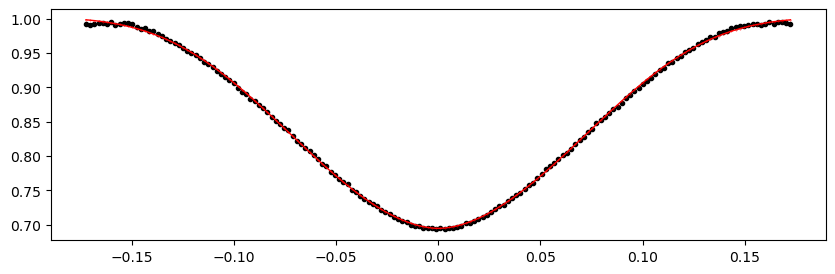

2330.850618 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1268.87it/s]


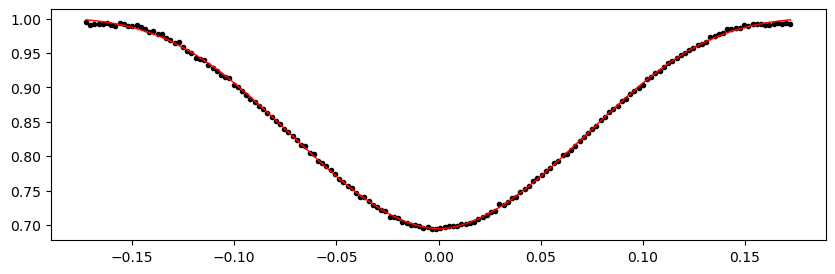

2331.522879 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1323.42it/s]


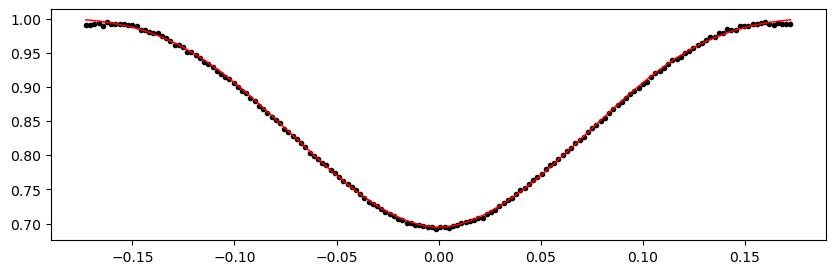

2332.19514 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.23it/s]


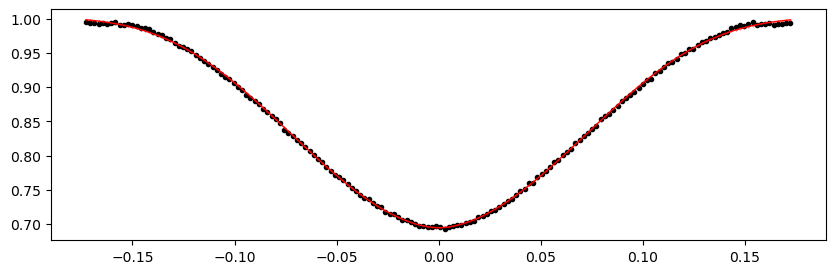

2337.573228 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1333.34it/s]


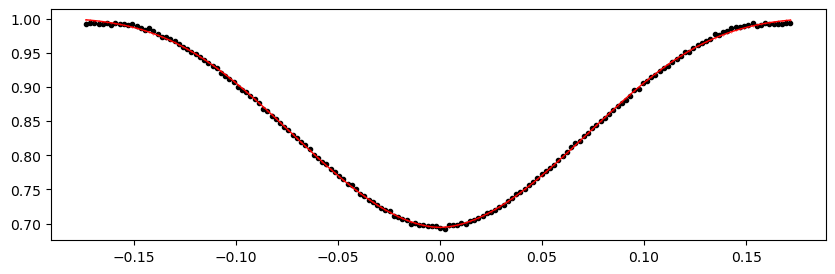

2338.245489 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1307.80it/s]


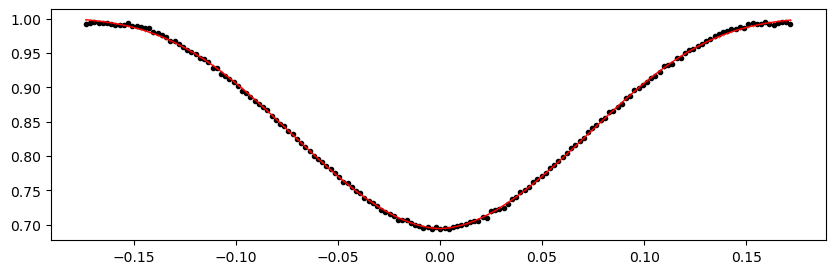

2338.91775 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1326.97it/s]


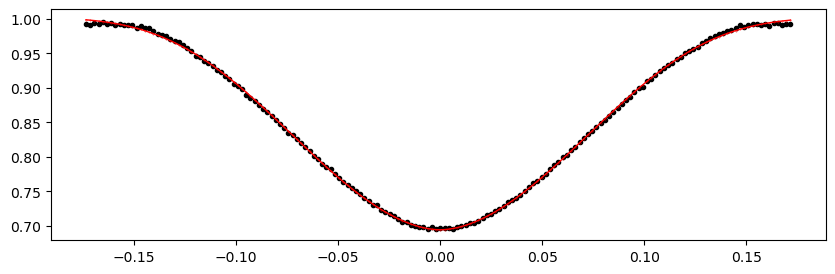

2339.5900110000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.87it/s]


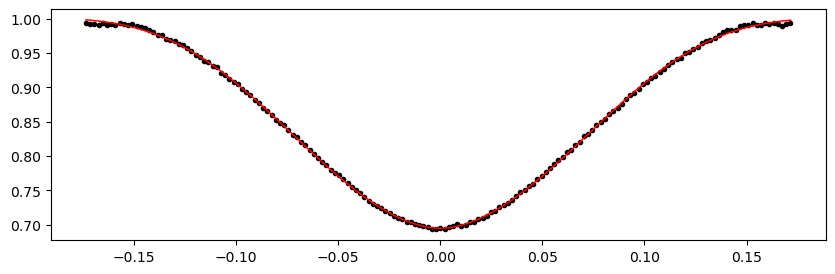

2340.262272 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1331.42it/s]


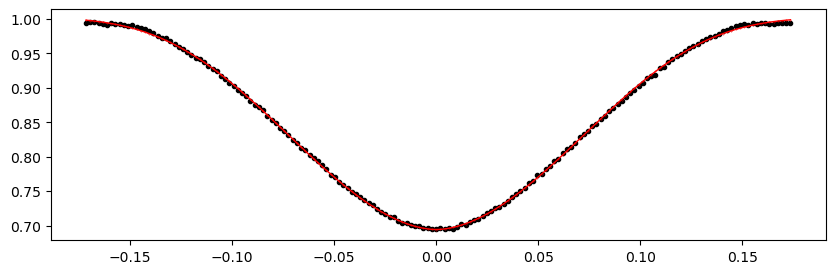

2340.934533 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1333.37it/s]


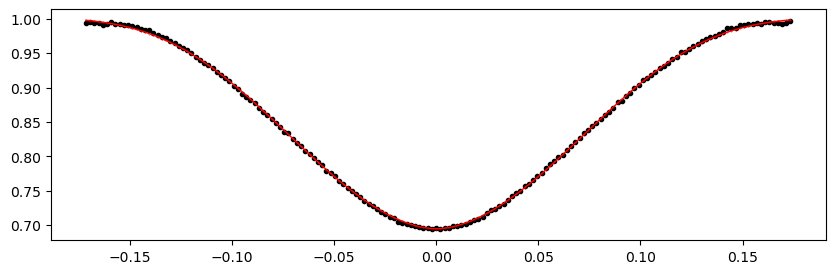

2341.6067940000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.49it/s]


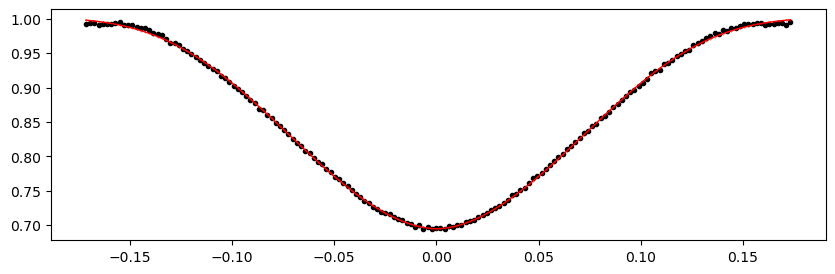

2342.279055 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1358.50it/s]


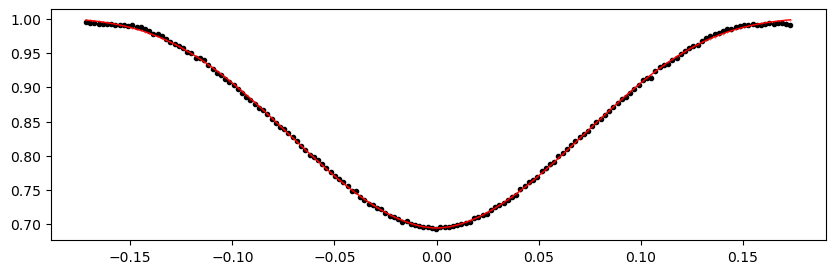

2342.951316 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.12it/s]


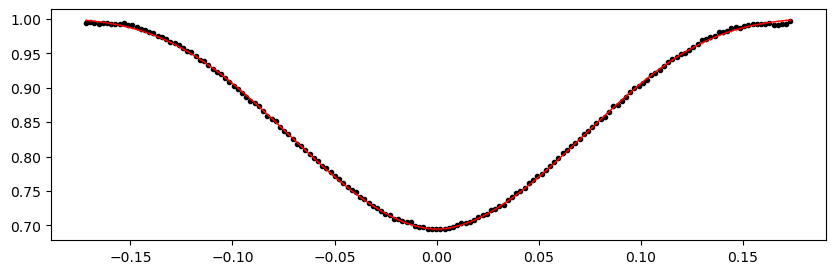

2343.623577 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.04it/s]


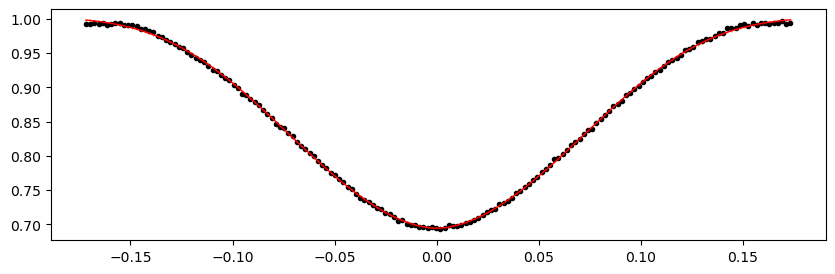

2344.295838 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1321.41it/s]


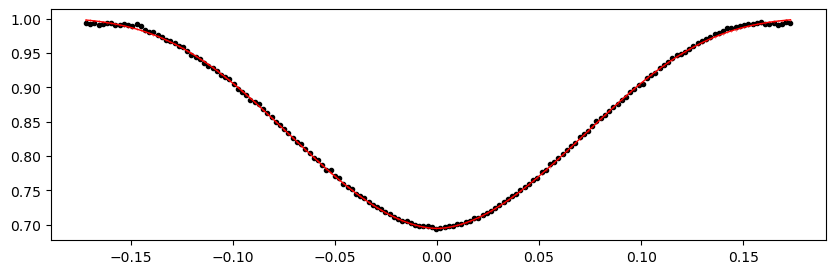

2344.968099 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.82it/s]


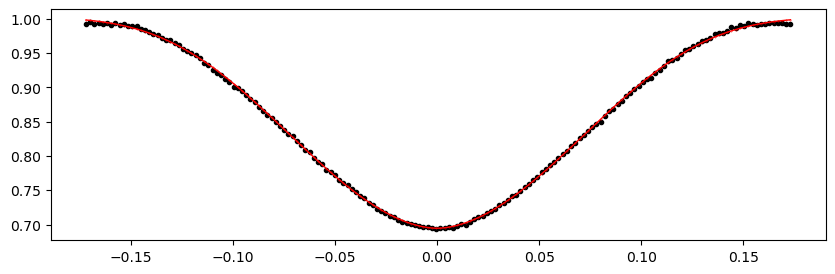

2345.64036 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.23it/s]


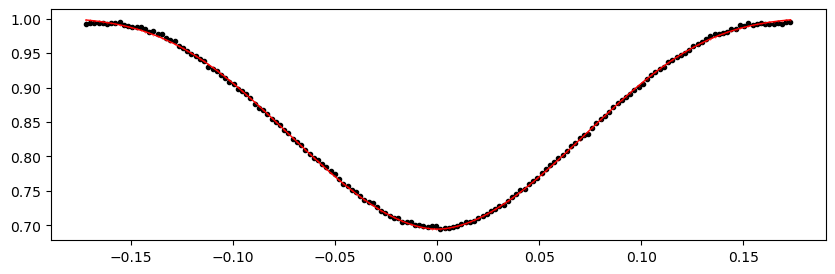

2346.312621 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1321.82it/s]


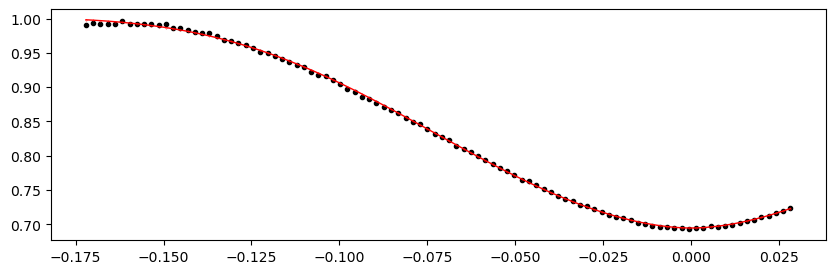

2347.657143 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1328.56it/s]


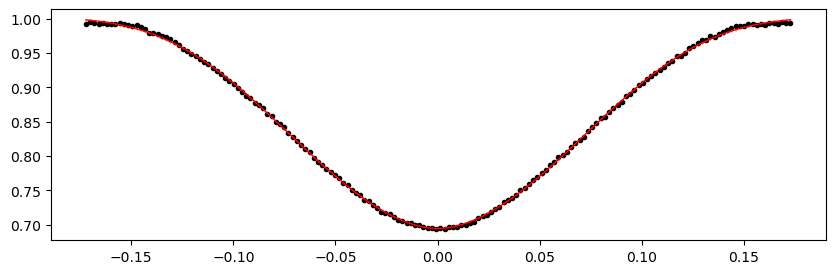

2348.329404 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.08it/s]


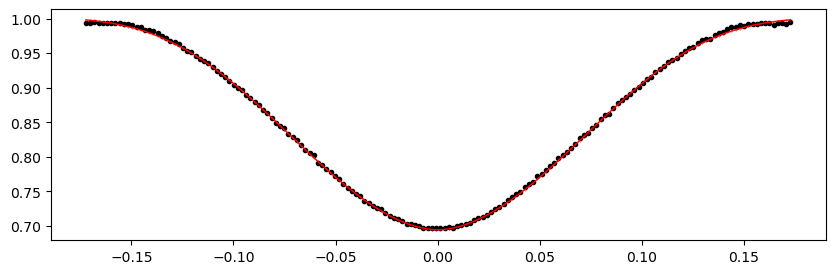

2351.018448 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.47it/s]


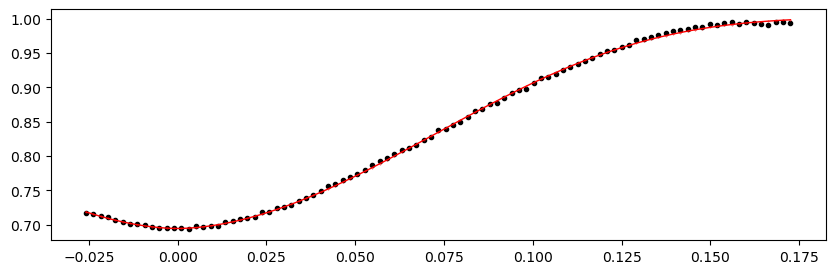

2351.690709 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.21it/s]


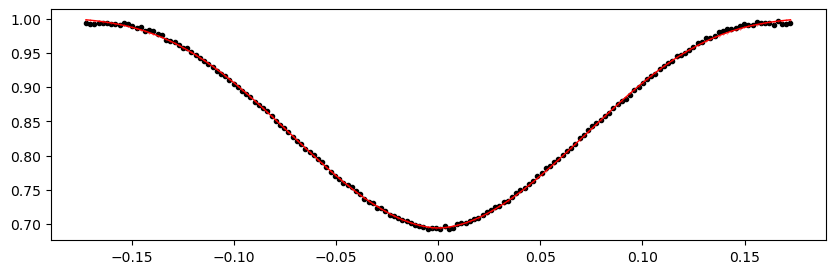

2352.36297 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.77it/s]


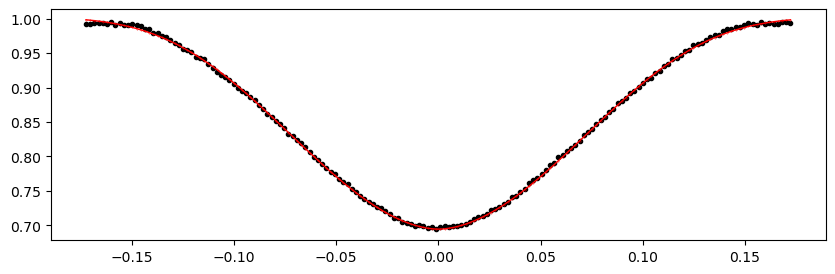

2353.035231 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.45it/s]


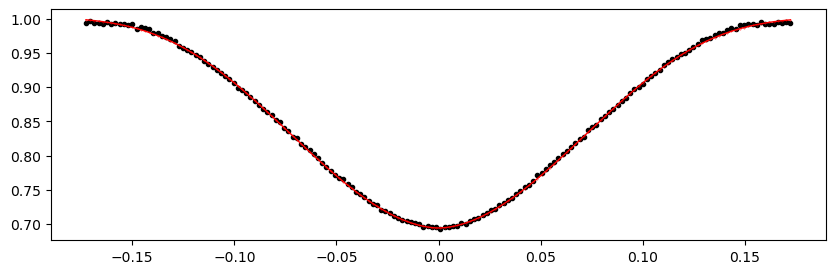

2353.707492 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.35it/s]


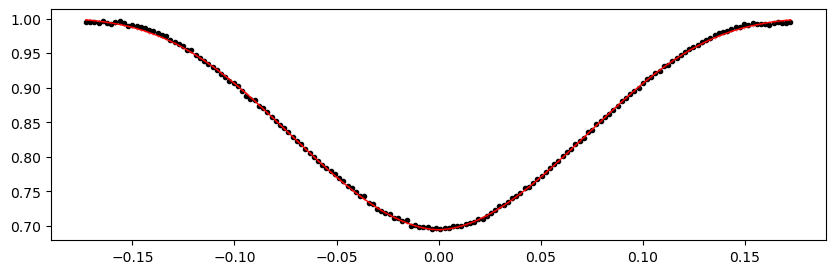

2354.379753 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.46it/s]


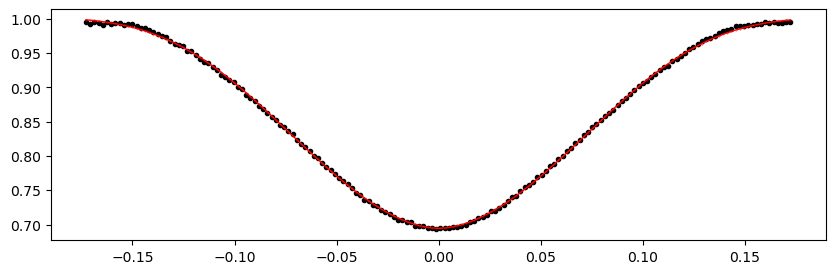

2355.052014 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.72it/s]


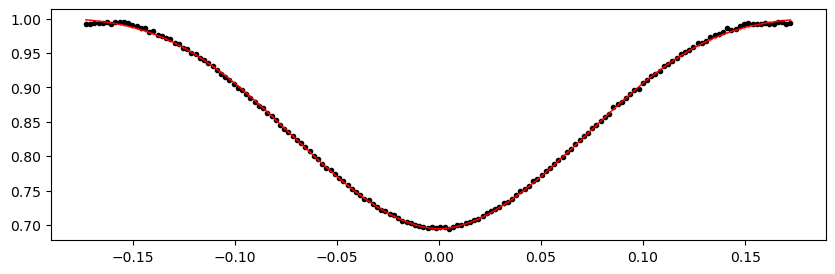

2355.724275 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.62it/s]


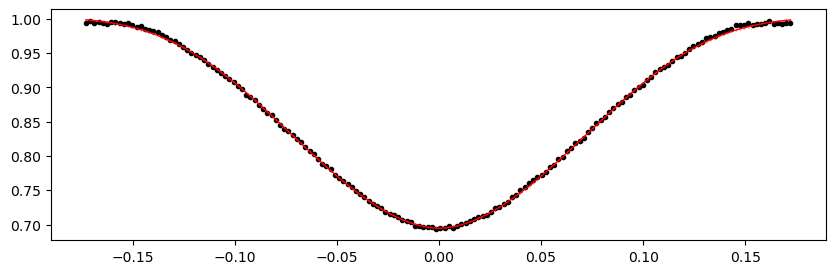

2356.396536 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.18it/s]


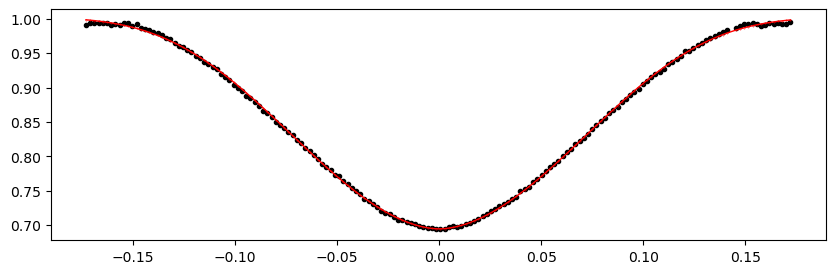

2357.068797 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.70it/s]


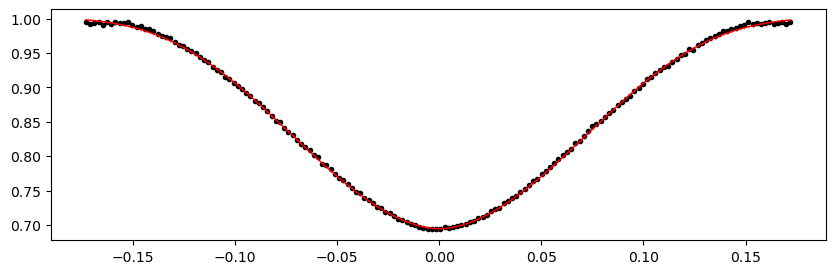

2357.741058 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.25it/s]


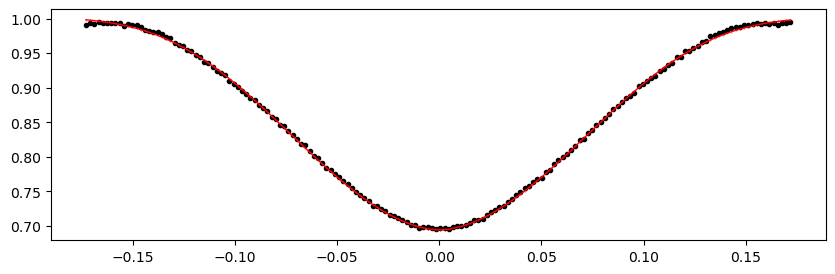

2358.4133190000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.53it/s]


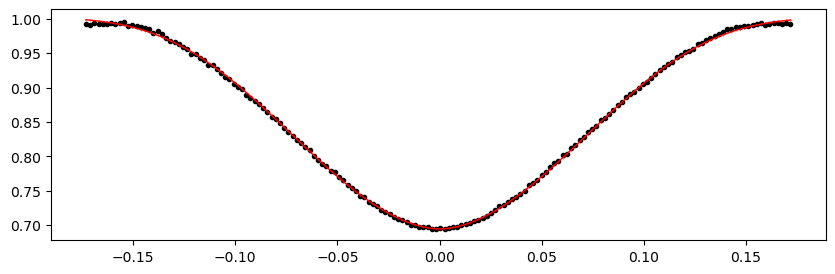

2359.08558 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.89it/s]


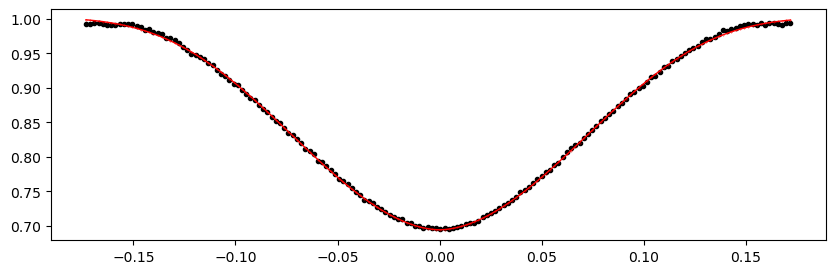

2359.757841 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.68it/s]


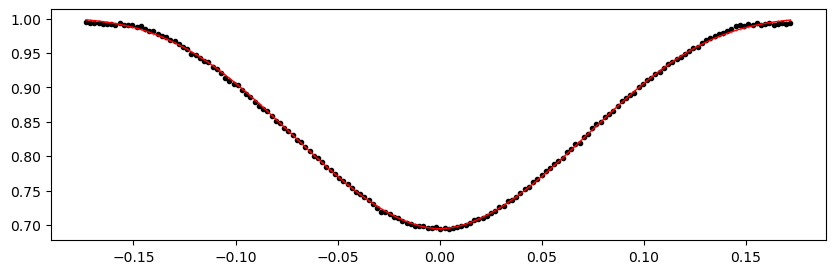

2360.4301020000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.39it/s]


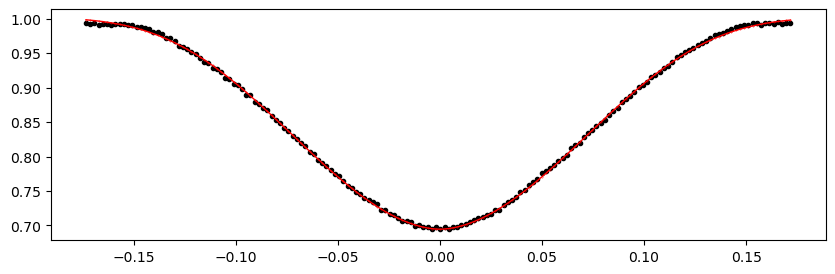

2361.774624 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.89it/s]


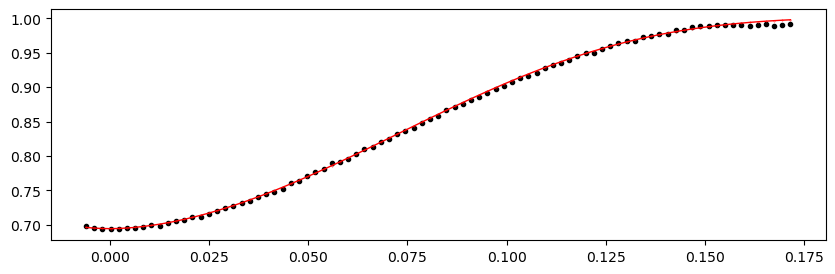

2362.446885 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.09it/s]


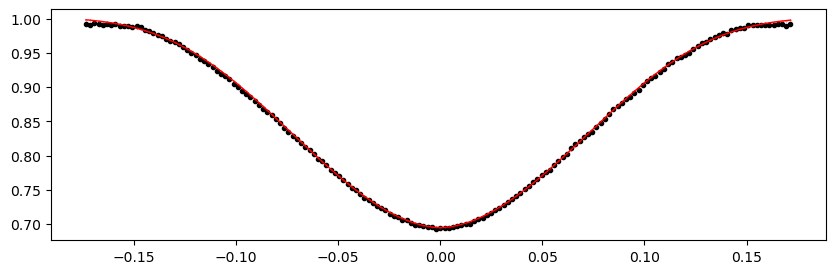

2363.119146 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.02it/s]


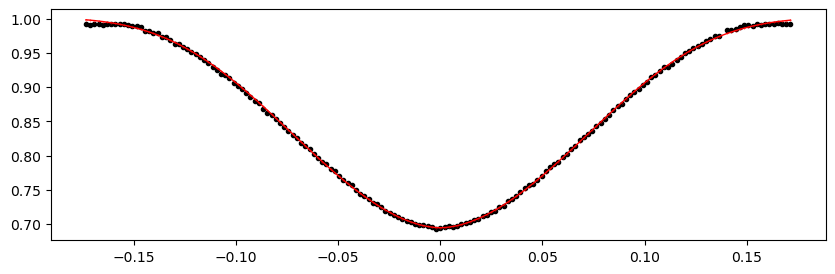

2363.791407 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.11it/s]


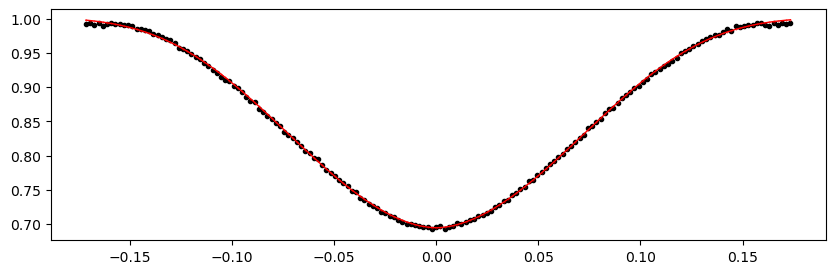

2364.463668 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.57it/s]


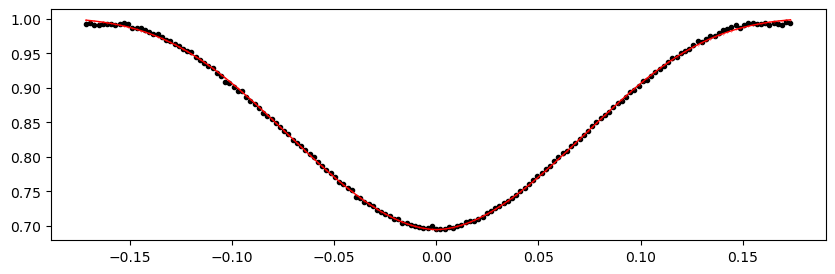

2365.135929 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.58it/s]


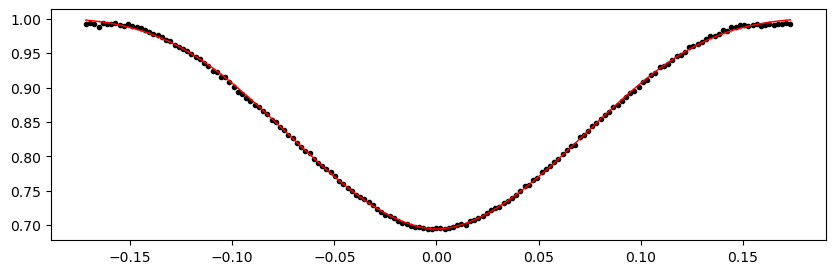

2365.80819 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.04it/s]


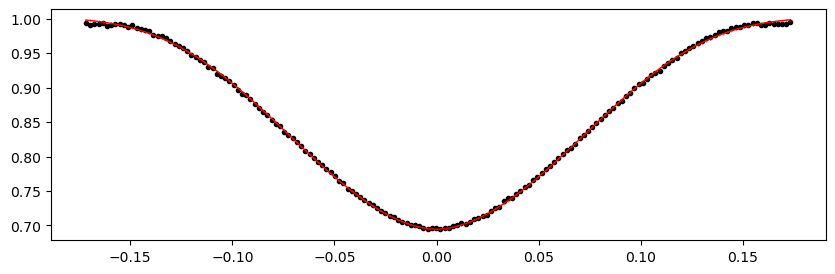

2366.480451 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1360.72it/s]


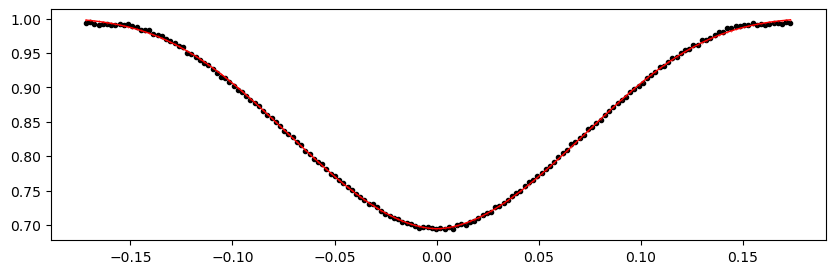

2367.152712 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.66it/s]


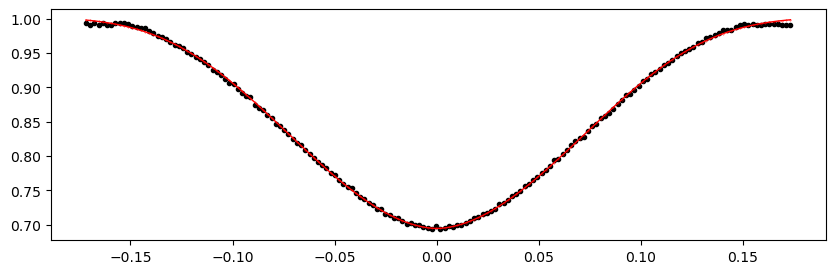

2367.8249729999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.98it/s]


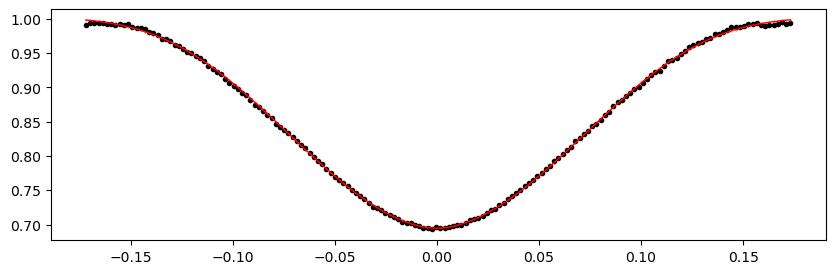

2368.497234 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.99it/s]


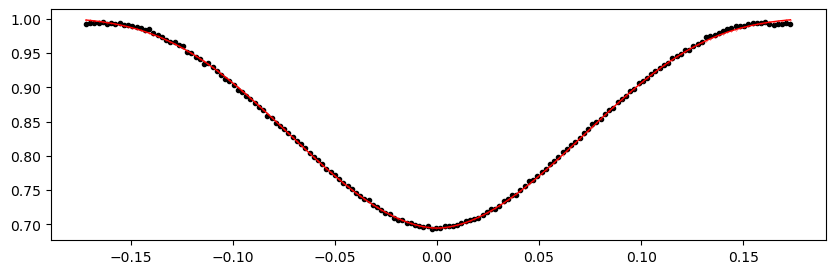

2369.169495 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.35it/s]


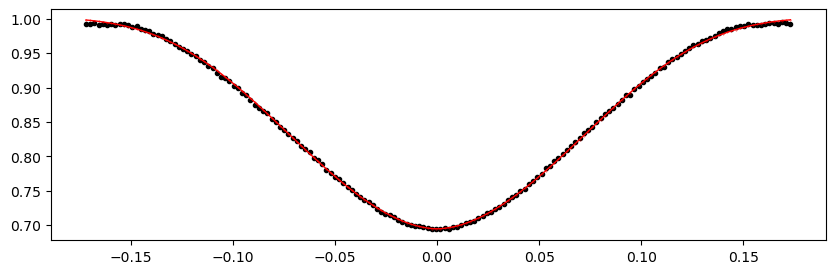

2369.841756 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.71it/s]


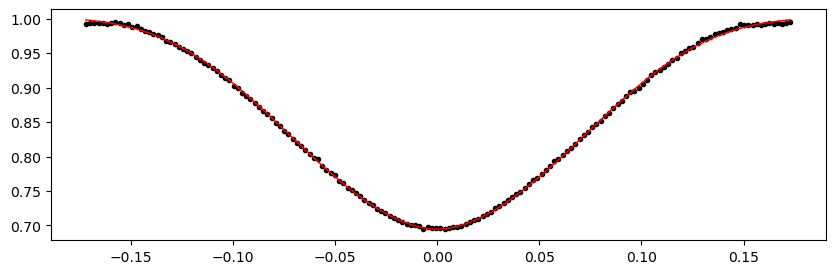

2370.514017 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.50it/s]


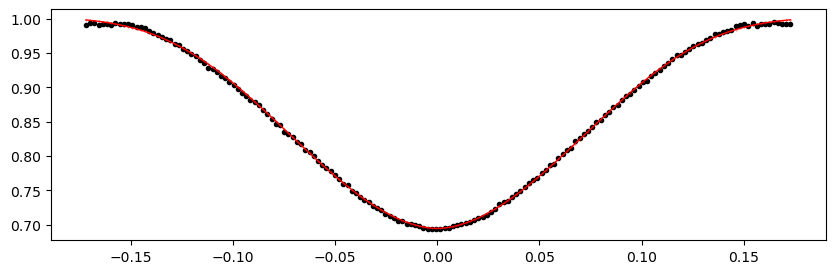

2371.186278 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.96it/s]


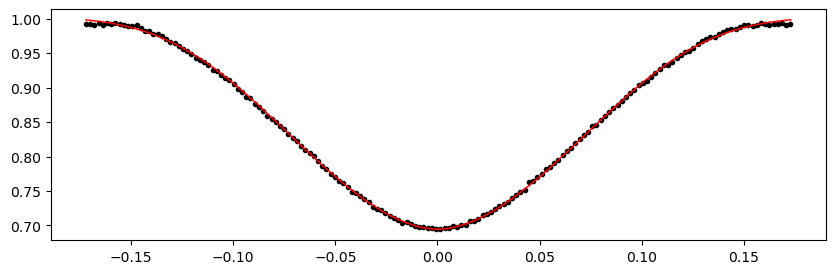

2371.858539 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.15it/s]


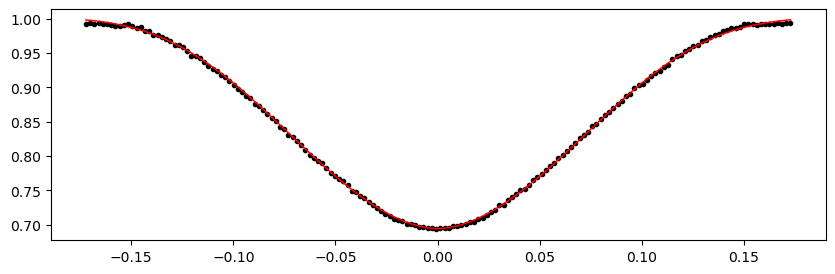

2372.5308 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.37it/s]


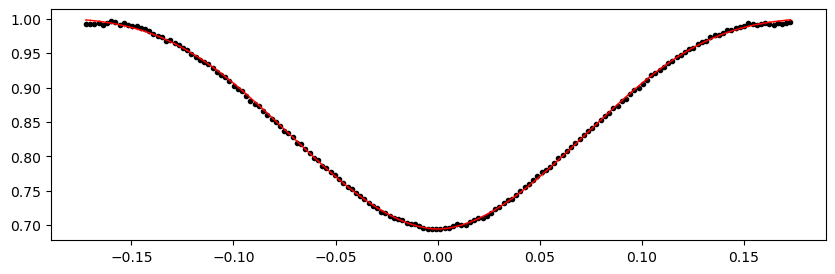

2373.203061 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1356.72it/s]


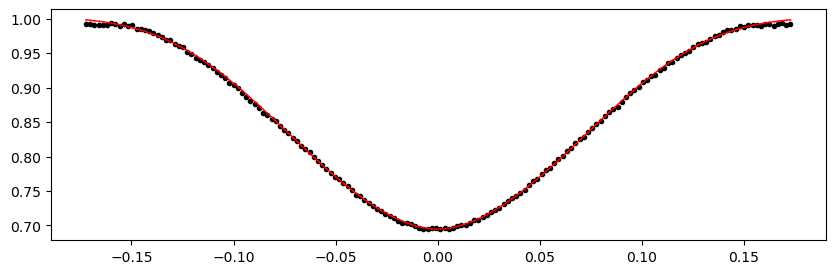

2373.875322 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.39it/s]


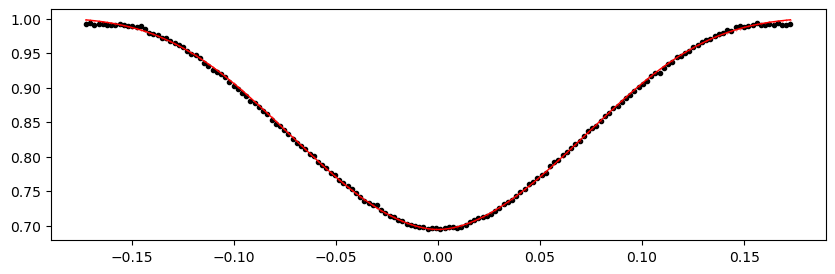

2374.547583 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.24it/s]


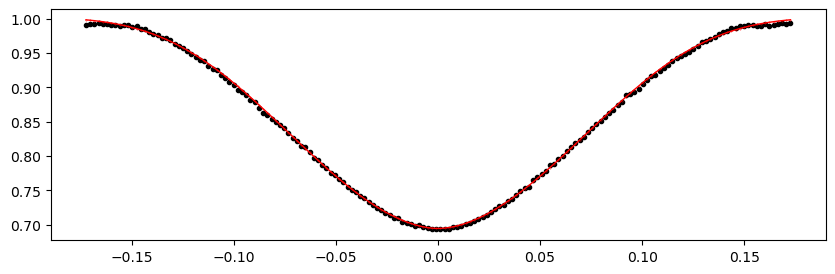

2375.892105 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.56it/s]


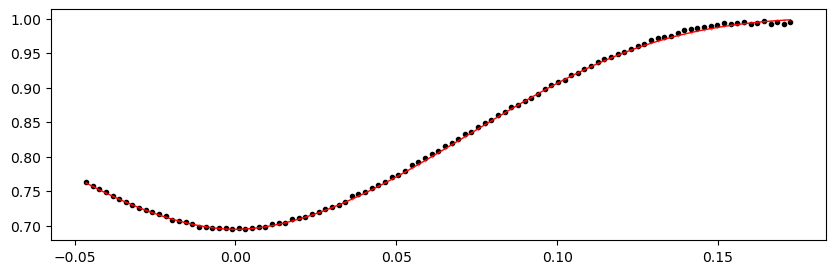

2376.564366 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.14it/s]


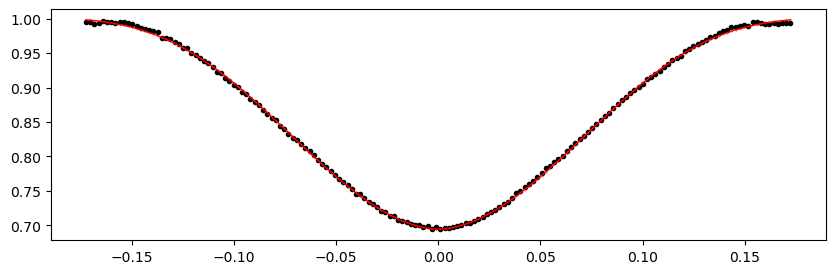

2377.236627 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.14it/s]


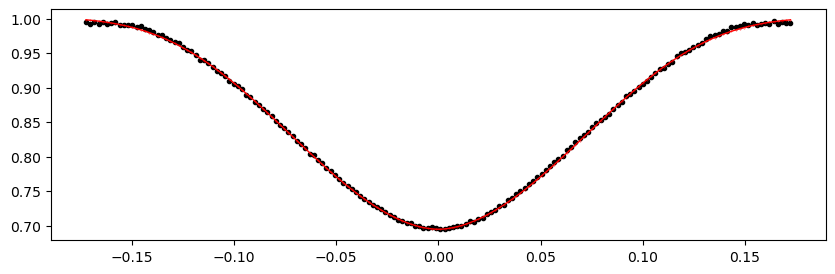

2377.908888 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.32it/s]


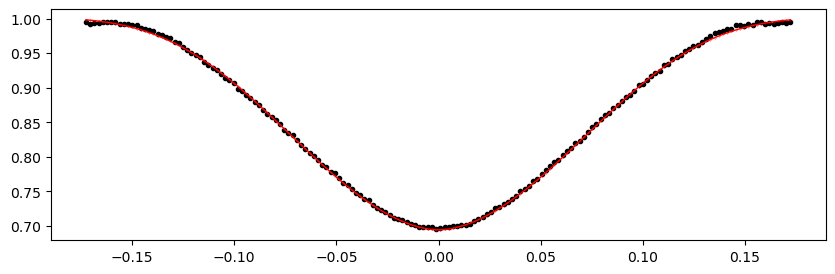

2378.581149 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.87it/s]


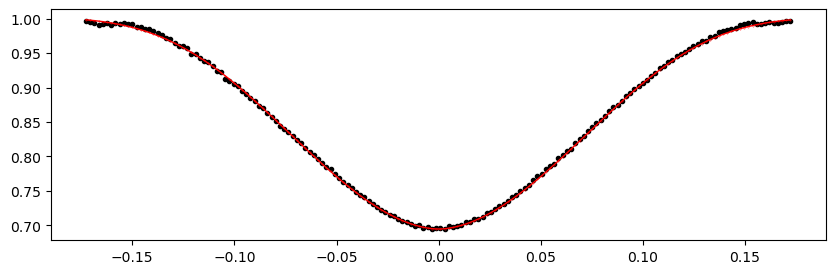

2379.2534100000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1322.01it/s]


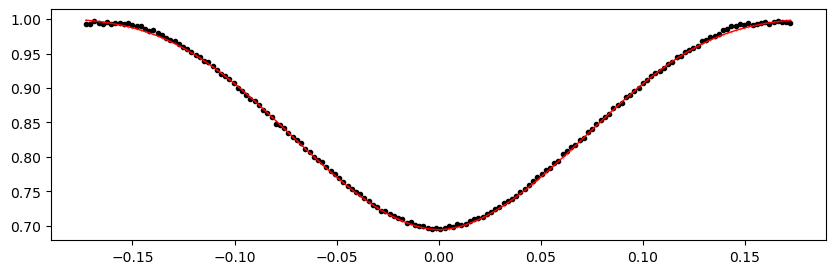

2379.925671 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1320.10it/s]


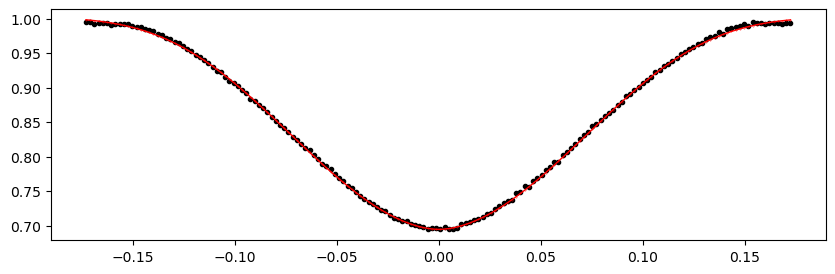

2380.597932 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.69it/s]


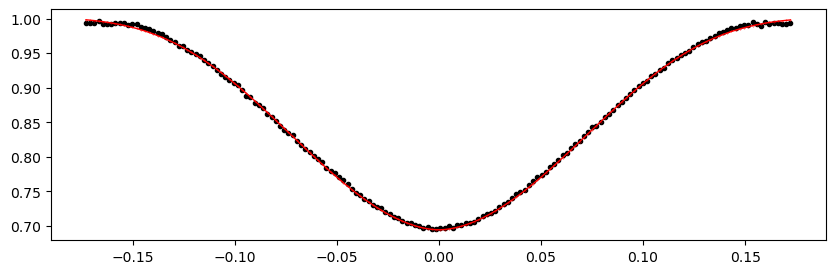

2381.270193 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.66it/s]


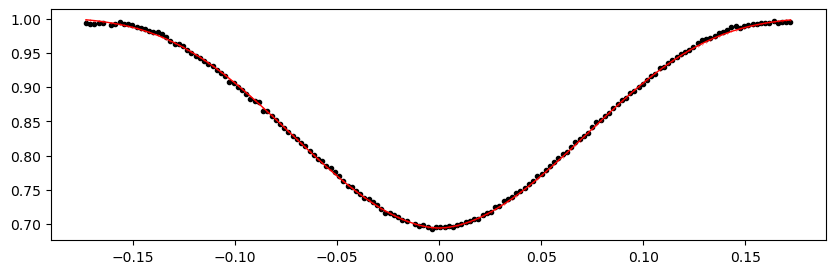

2381.942454 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.23it/s]


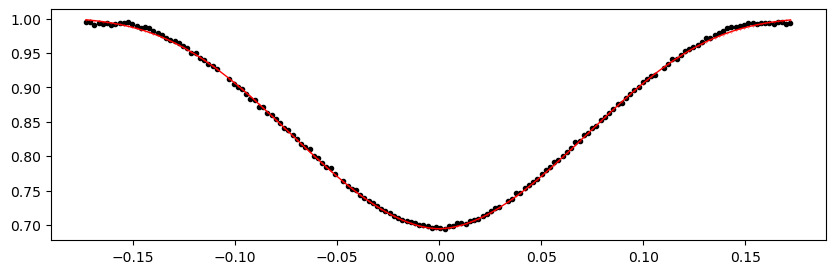

2382.614715 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.53it/s]


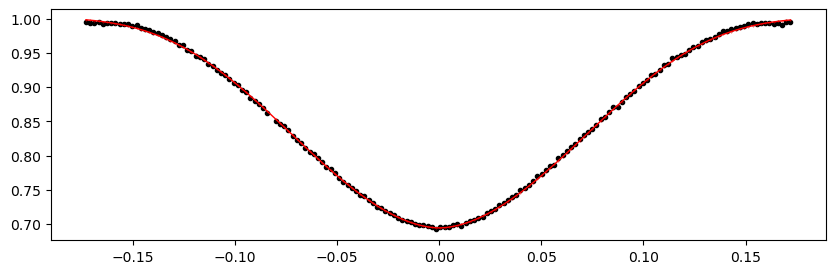

2383.286976 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.90it/s]


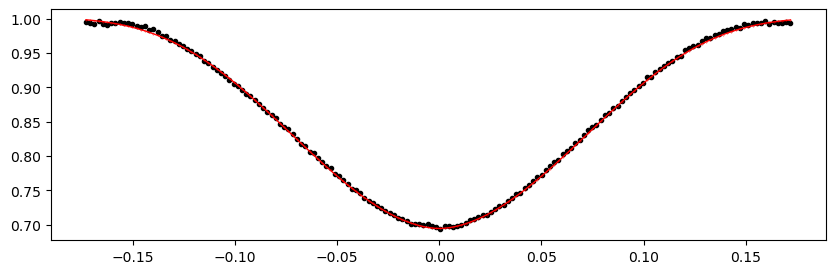

2383.959237 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.13it/s]


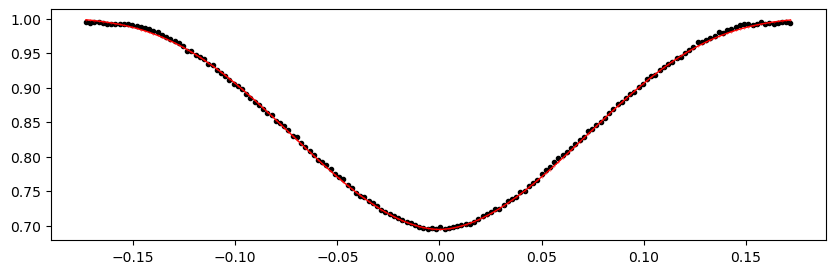

2384.631498 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.11it/s]


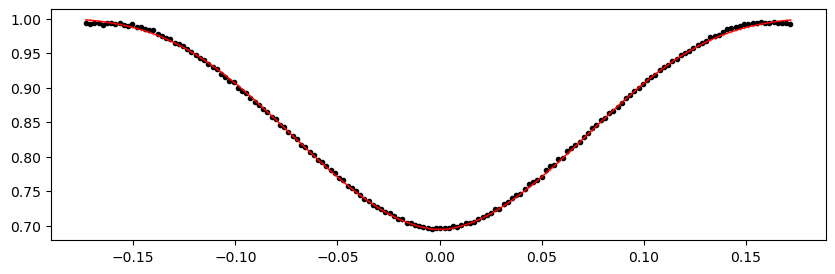

2385.303759 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.22it/s]


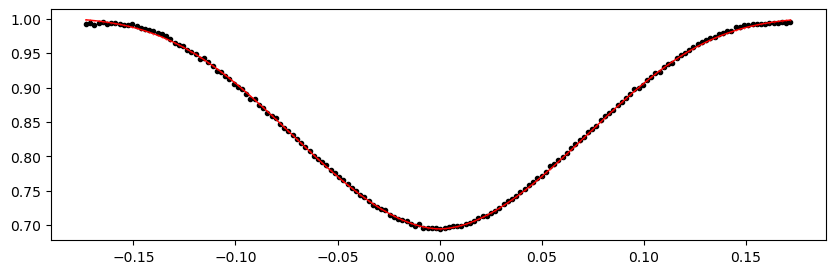

2385.97602 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.30it/s]


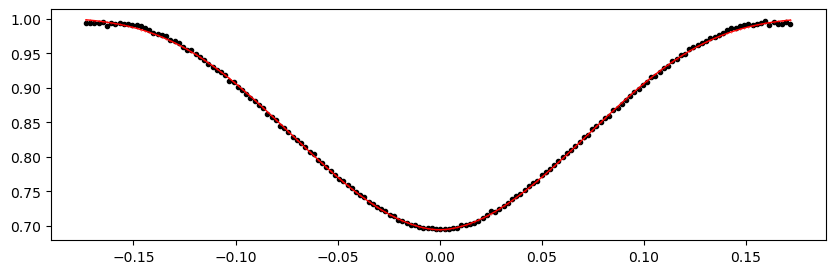

2386.6482809999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.55it/s]


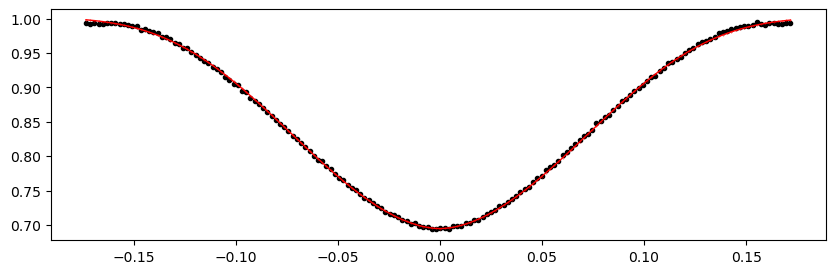

2387.320542 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.82it/s]


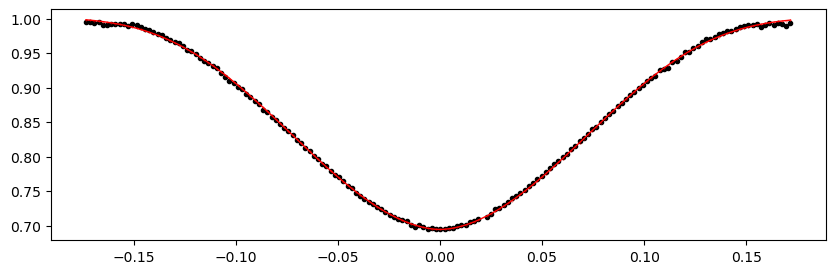

2387.992803 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.85it/s]


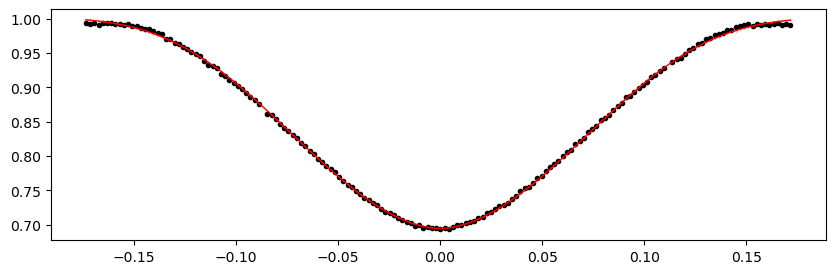

2388.665064 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.38it/s]


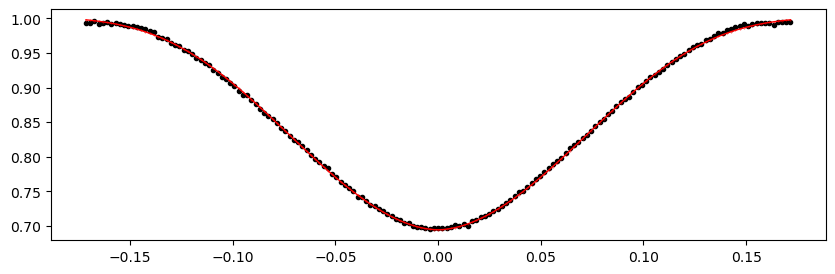

2389.337325 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.63it/s]


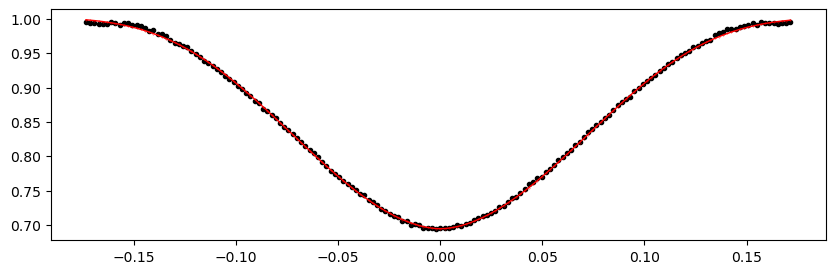

2964.12048 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.80it/s]


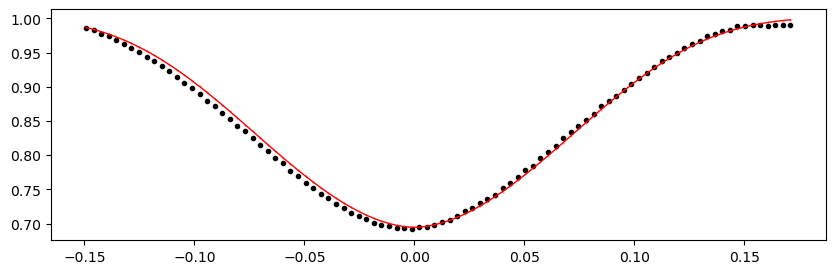

2964.792741 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.38it/s]


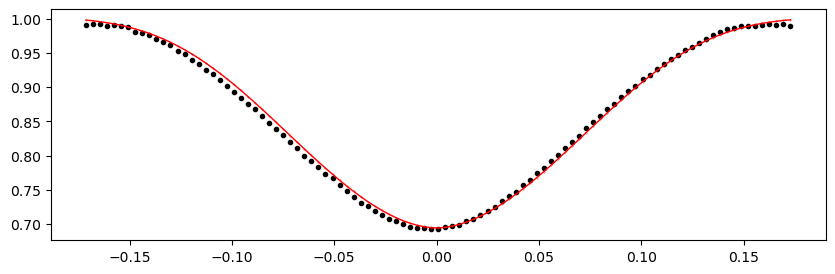

2965.465002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.67it/s]


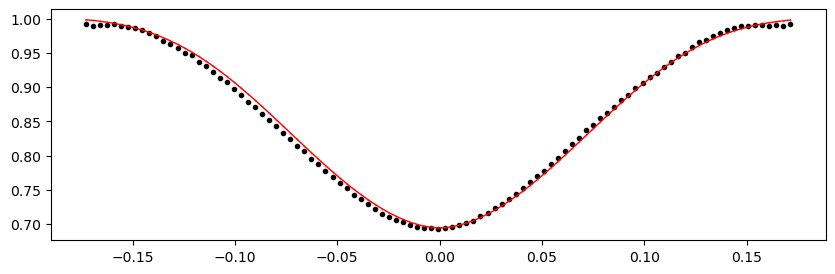

2966.137263 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.38it/s]


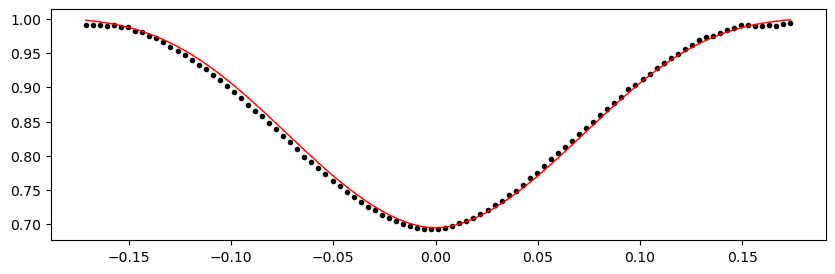

2966.8095240000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.79it/s]


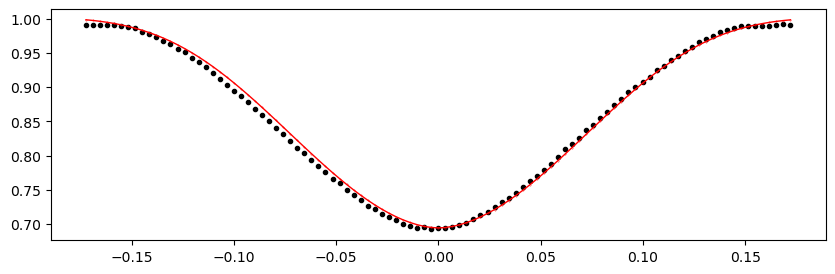

2967.481785 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.44it/s]


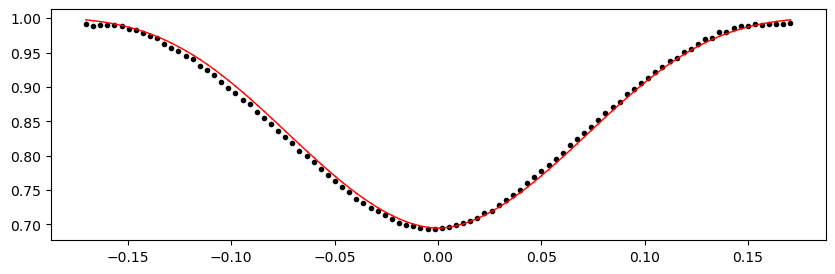

2968.154046 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.72it/s]


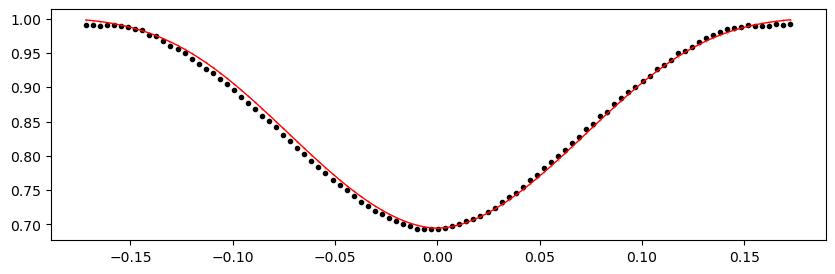

2968.8263070000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.48it/s]


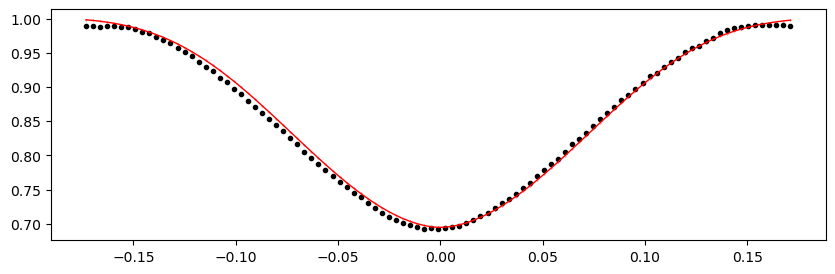

2969.498568 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.50it/s]


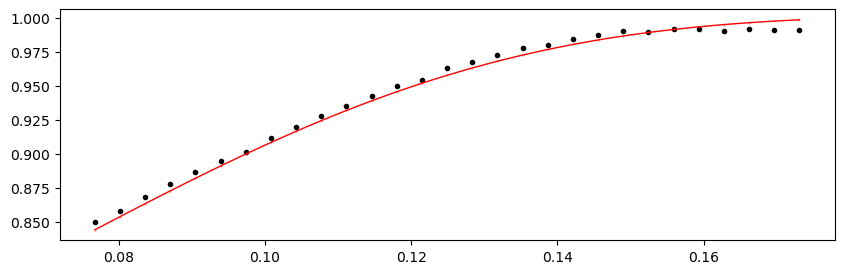

2970.170829 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.47it/s]


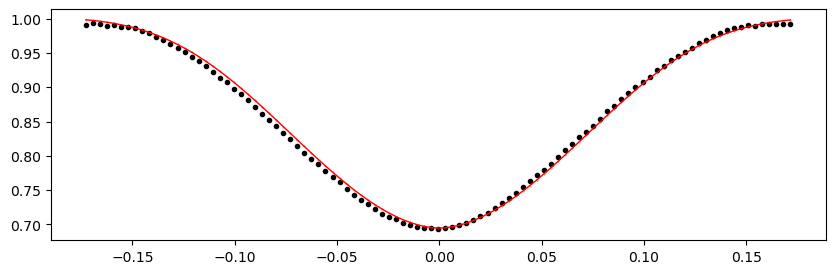

2970.84309 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.97it/s]


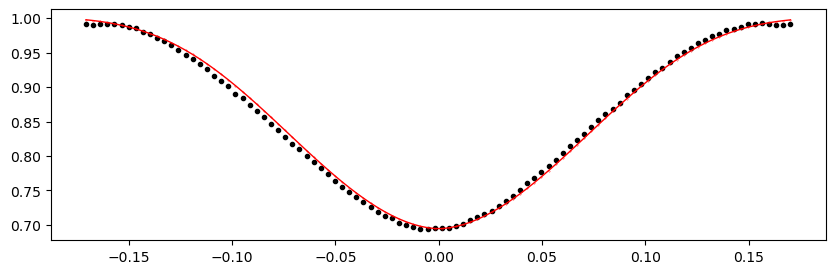

2971.515351 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.78it/s]


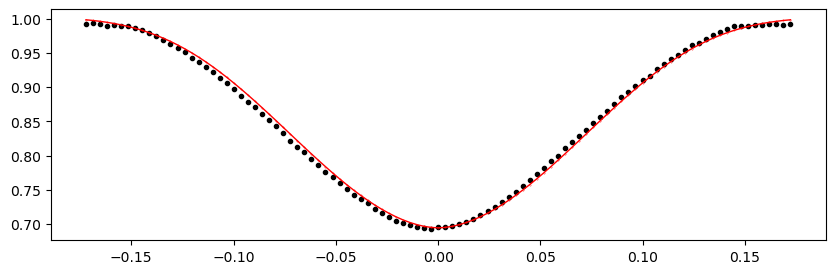

2972.187612 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.24it/s]


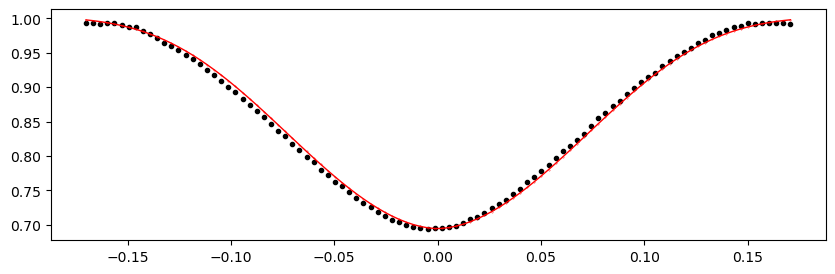

2972.859873 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.80it/s]


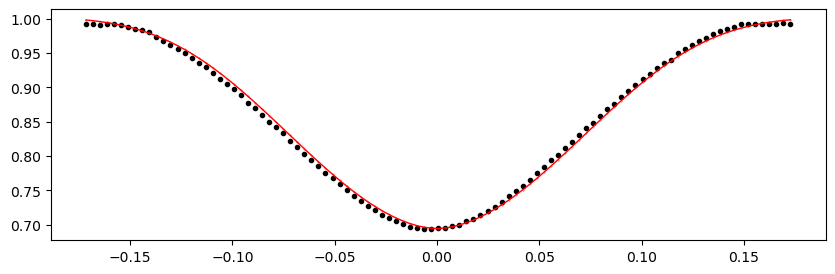

2973.532134 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.14it/s]


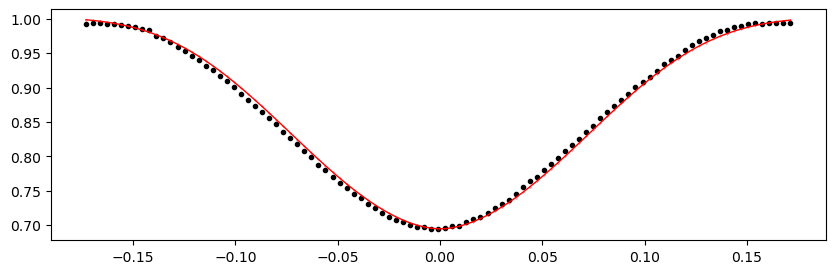

2974.2043949999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.23it/s]


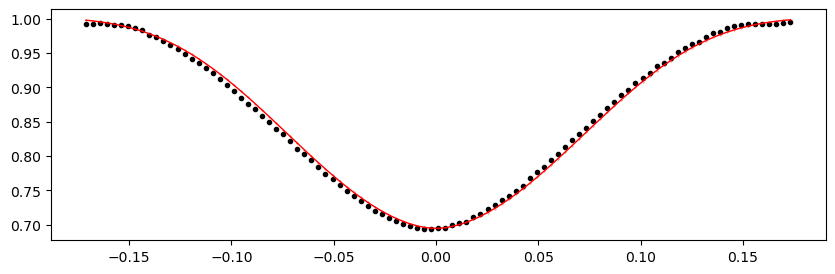

2974.876656 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.91it/s]


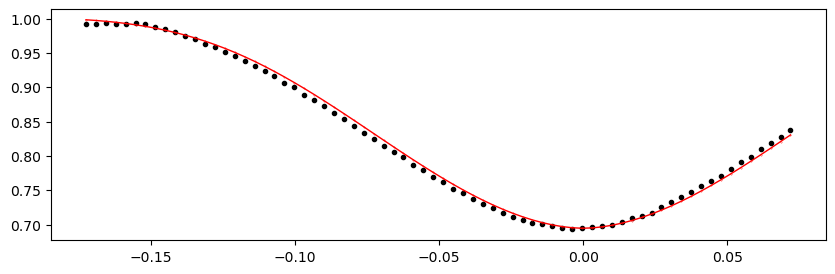

2976.893439 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.82it/s]


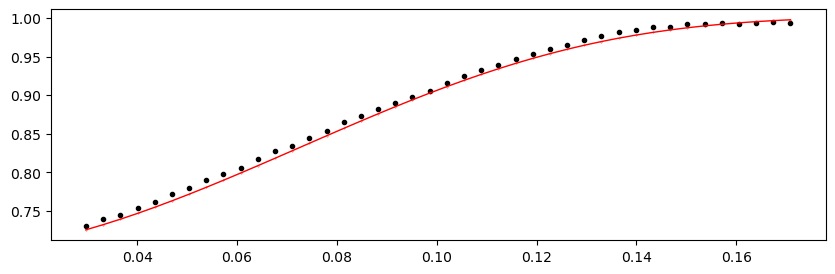

2977.5657 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.89it/s]


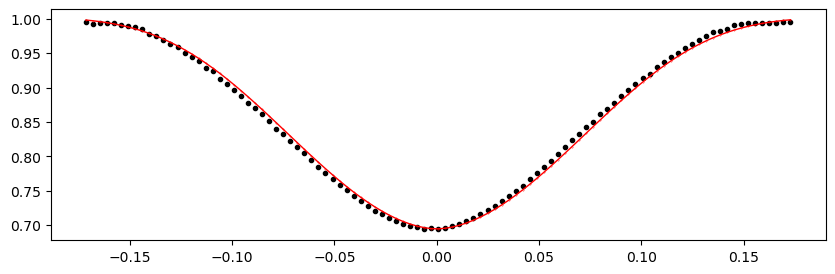

2978.237961 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.74it/s]


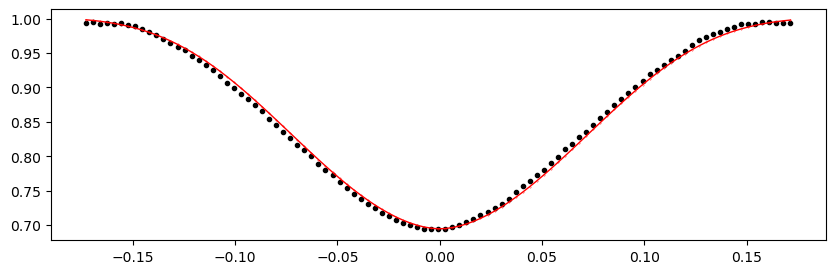

2978.910222 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.62it/s]


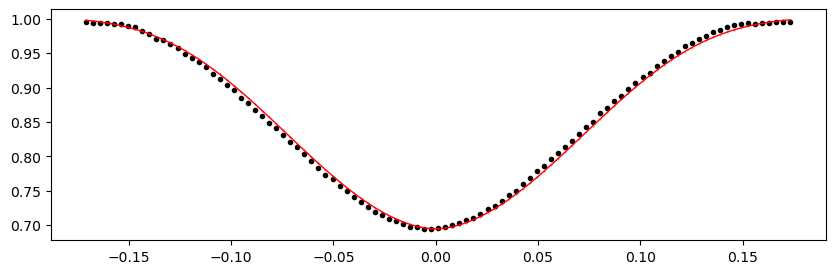

2979.582483 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.22it/s]


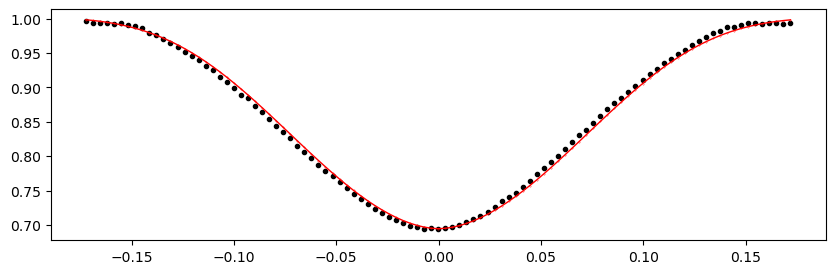

2980.254744 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.55it/s]


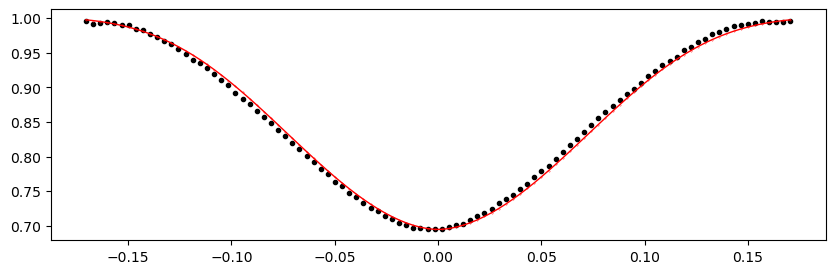

2980.927005 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.63it/s]


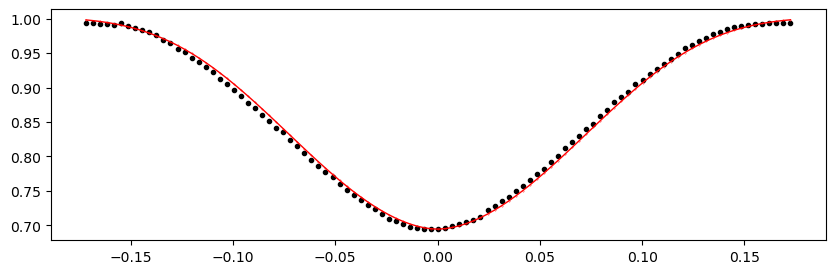

2981.599266 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.32it/s]


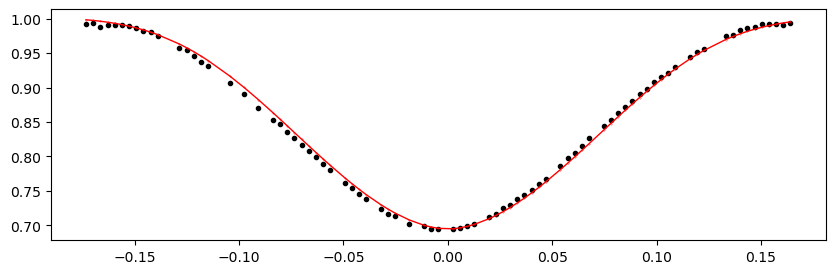

2982.943788 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.03it/s]


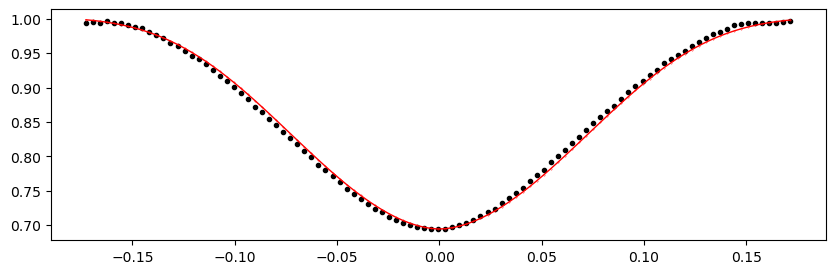

2983.616049 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.04it/s]


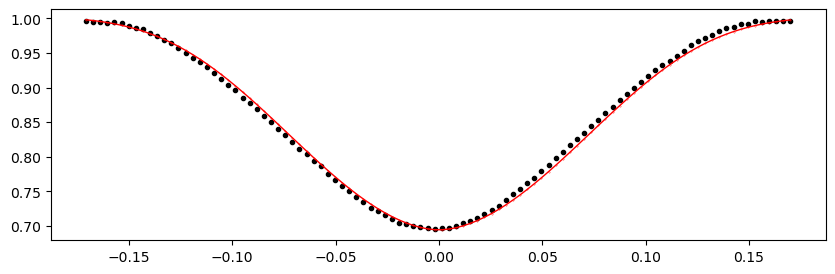

2984.28831 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.86it/s]


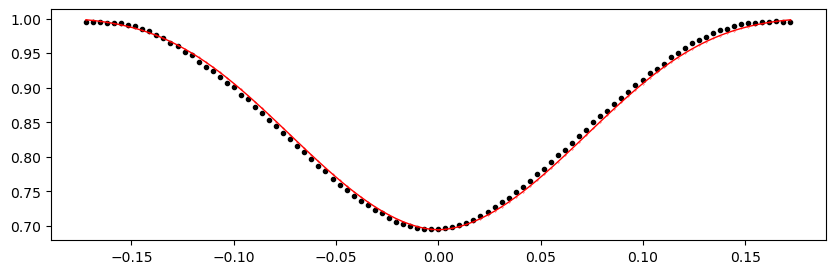

2984.960571 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.50it/s]


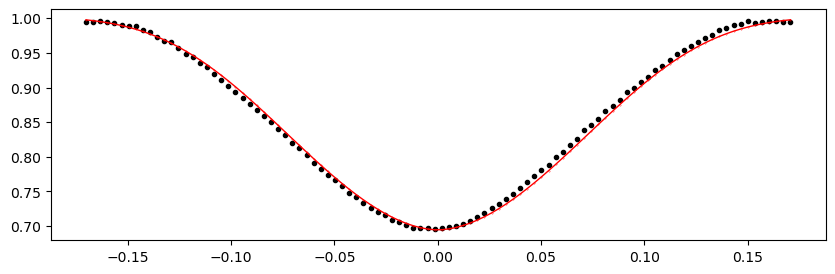

2985.6328320000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.97it/s]


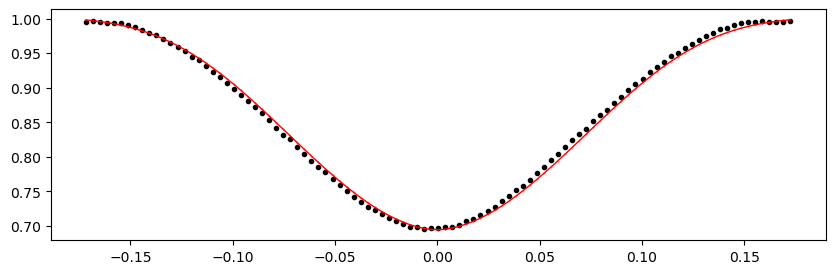

2986.305093 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.74it/s]


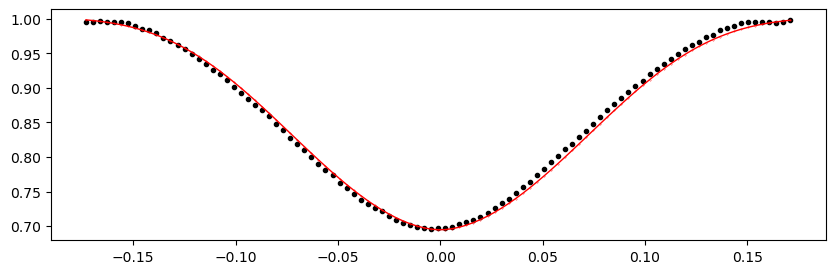

2986.977354 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.59it/s]


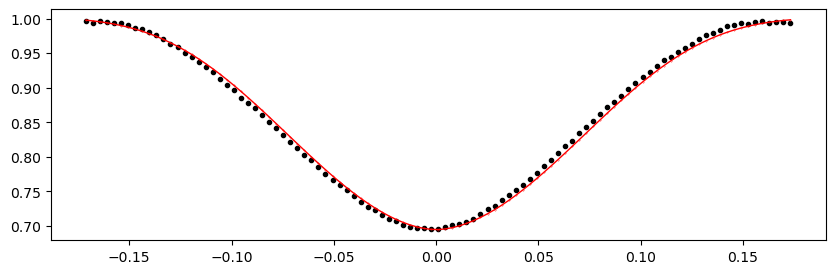

2987.6496150000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1364.07it/s]


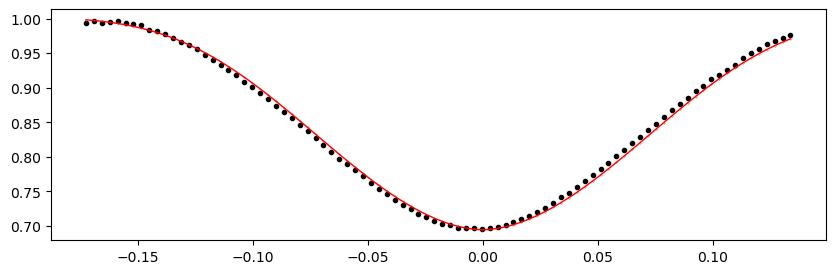

2989.666398 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.23it/s]


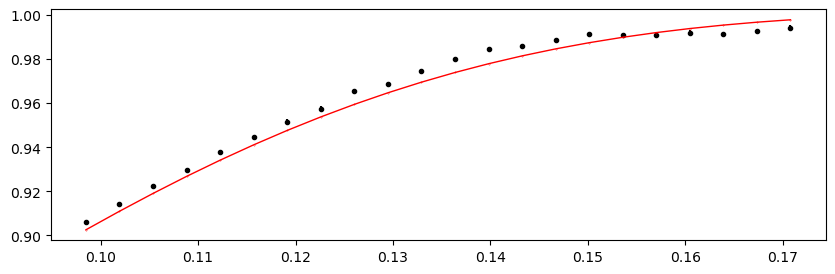

2990.338659 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.85it/s]


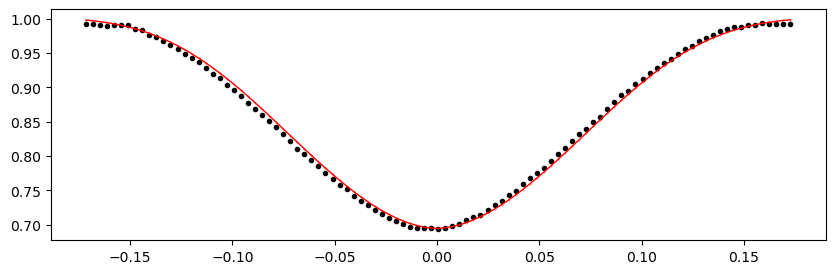

2991.01092 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1362.14it/s]


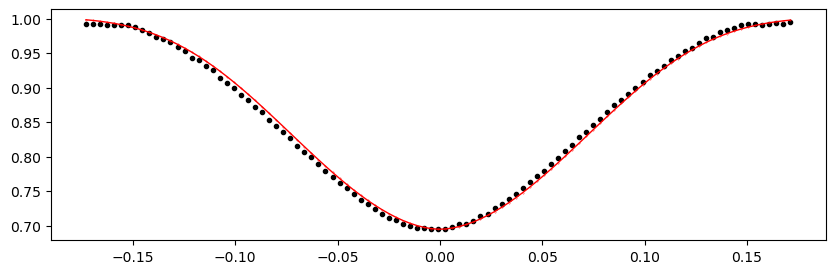

2991.683181 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1372.56it/s]


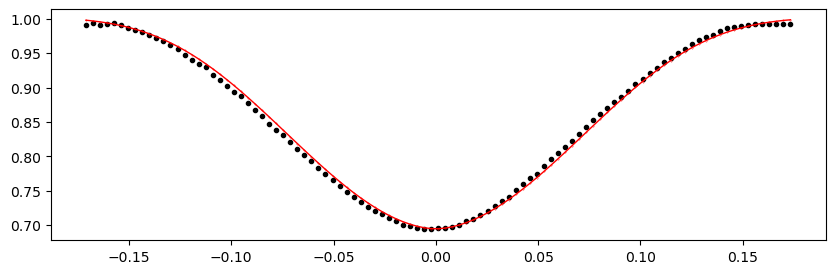

2992.355442 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1370.27it/s]


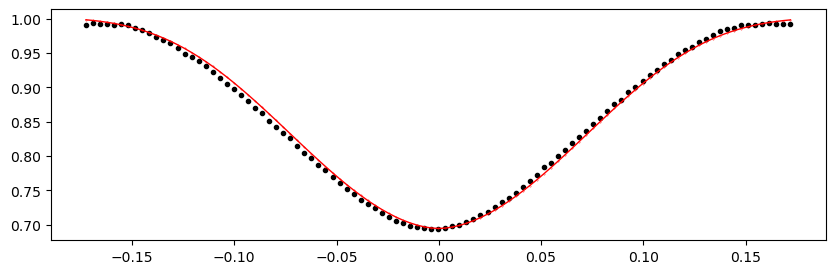

2993.0277029999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1367.73it/s]


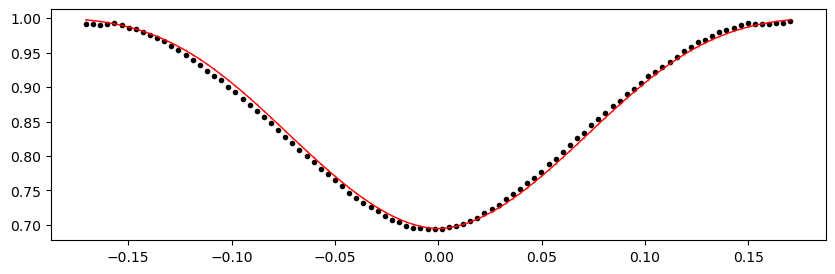

2993.699964 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1363.09it/s]


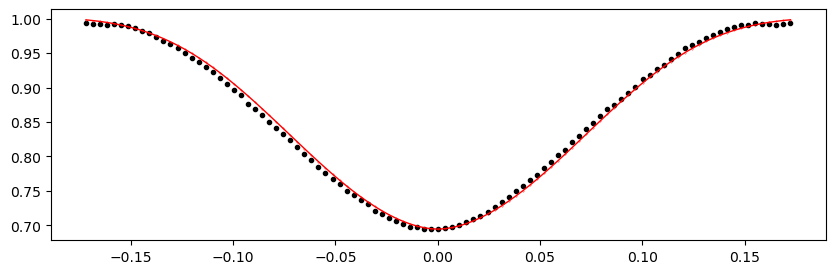

2994.372225 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1375.99it/s]


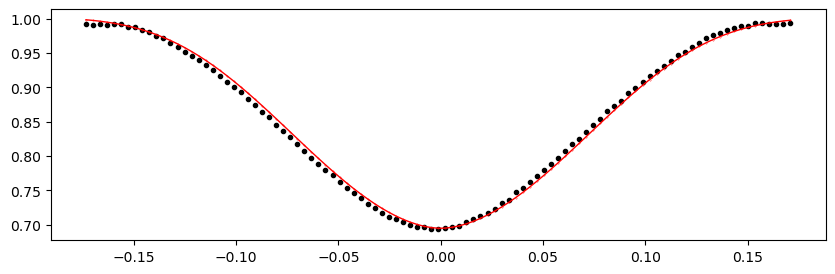

2995.044486 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1370.09it/s]


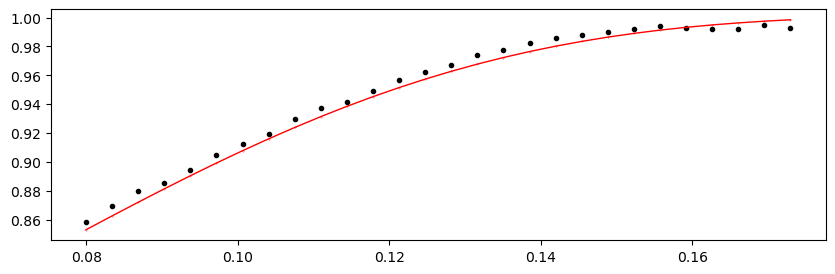

2995.716747 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1365.99it/s]


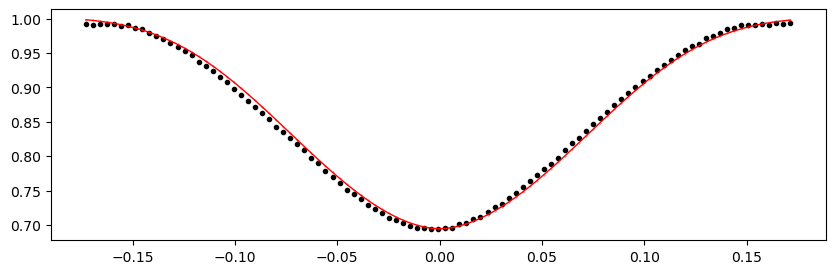

2996.389008 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1362.48it/s]


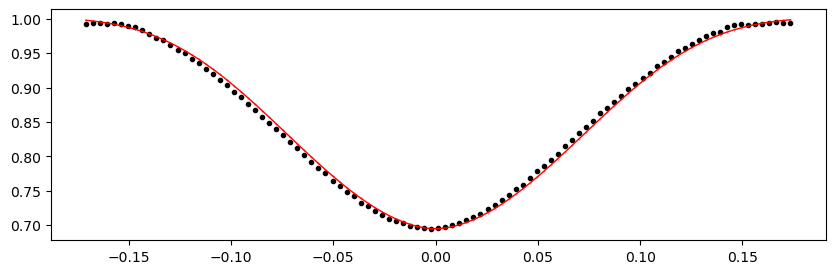

2997.061269 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1364.06it/s]


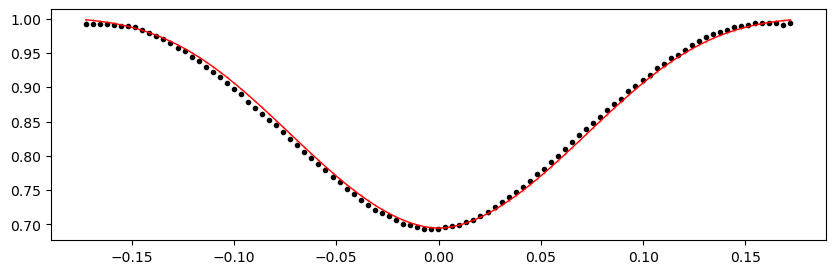

2997.73353 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1373.71it/s]


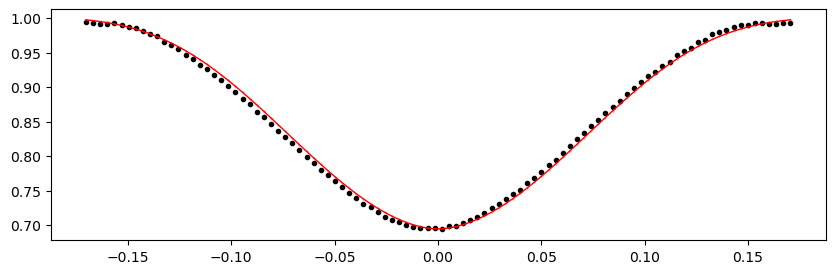

2998.405791 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1373.06it/s]


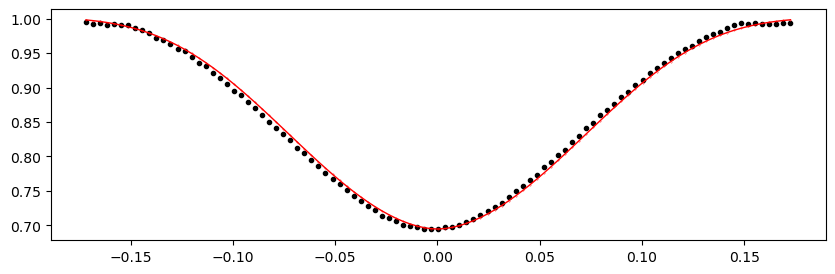

2999.078052 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1368.57it/s]


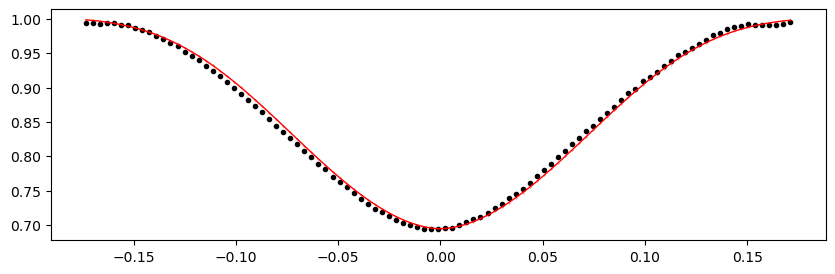

2999.750313 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.86it/s]


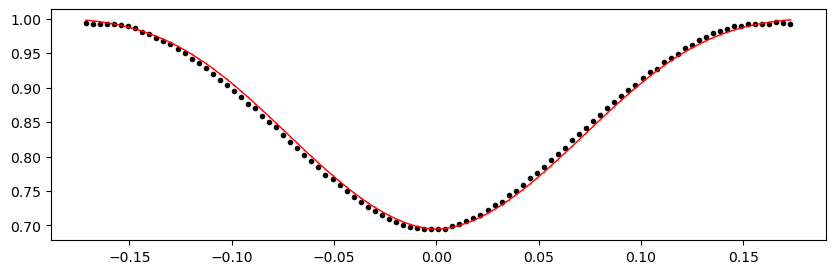

3000.422574 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.40it/s]


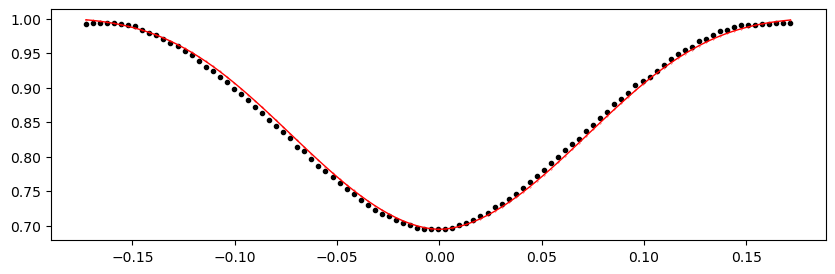

3003.111618 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1371.74it/s]


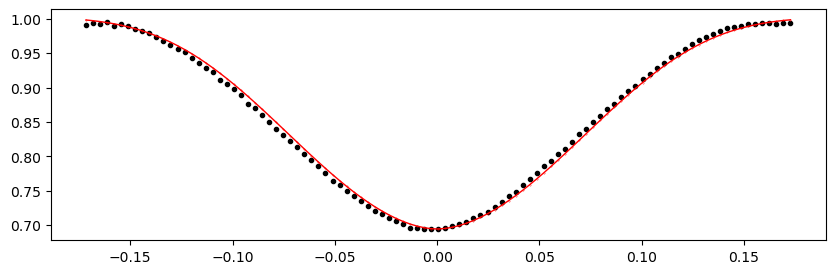

3003.783879 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1357.28it/s]


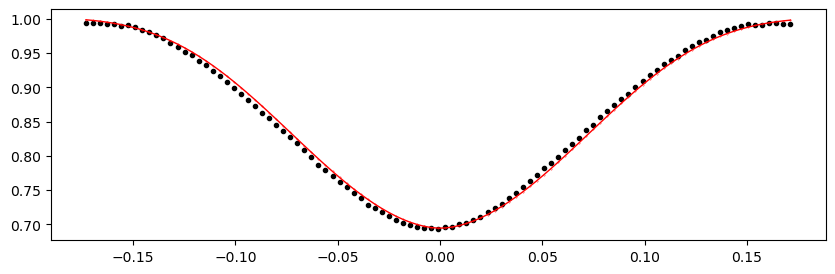

3004.4561400000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1362.33it/s]


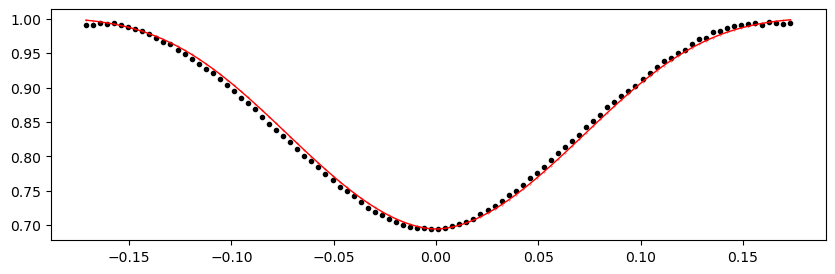

3005.128401 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1368.27it/s]


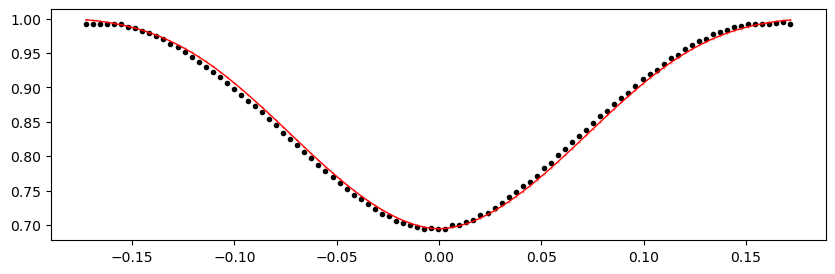

3005.800662 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1375.44it/s]


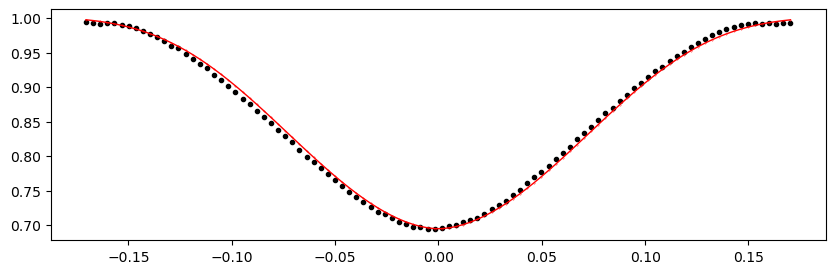

3006.4729230000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1370.09it/s]


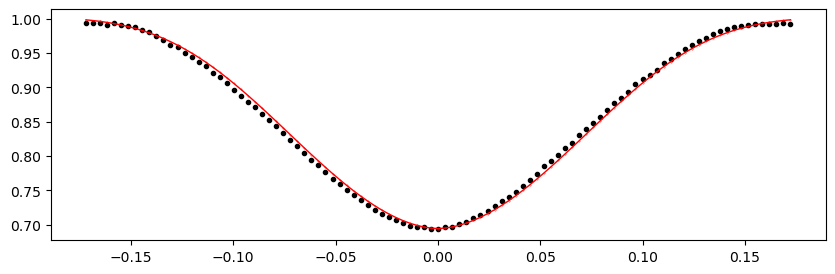

3007.145184 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1373.17it/s]


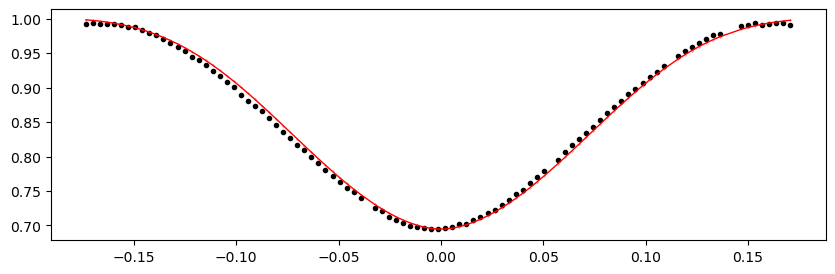

3007.817445 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1359.49it/s]


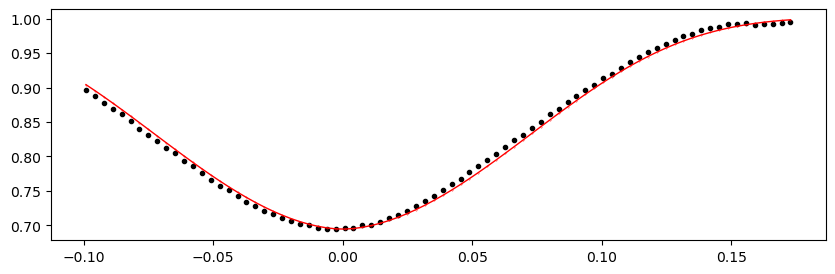

3008.489706 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1369.91it/s]


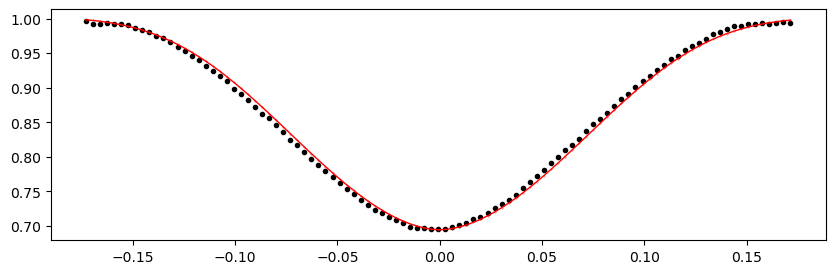

3009.161967 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1367.78it/s]


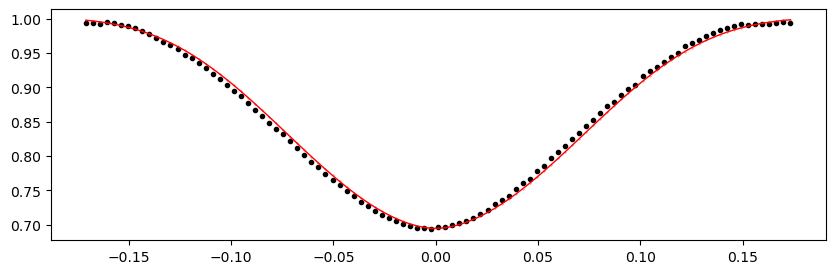

3009.834228 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1367.95it/s]


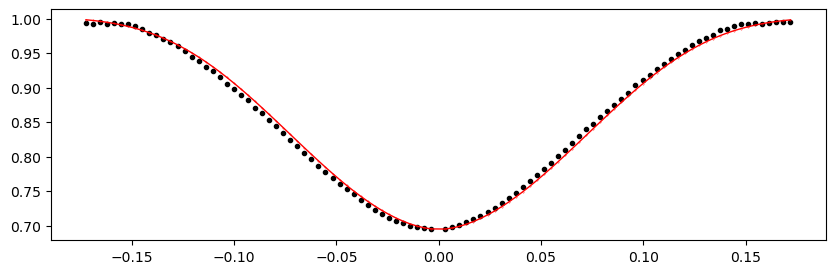

3010.506489 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.52it/s]


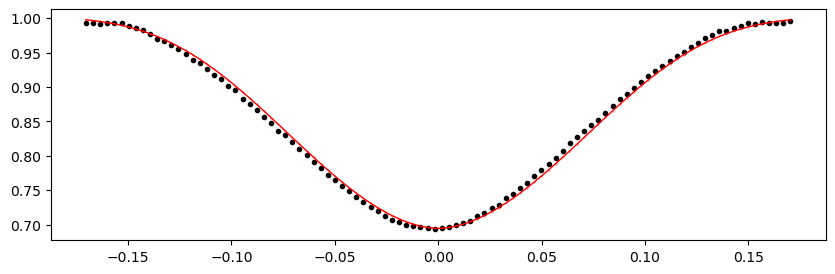

3011.17875 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1370.01it/s]


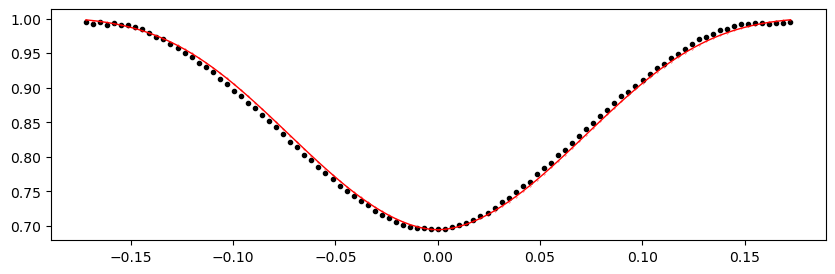

3011.8510109999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1373.42it/s]


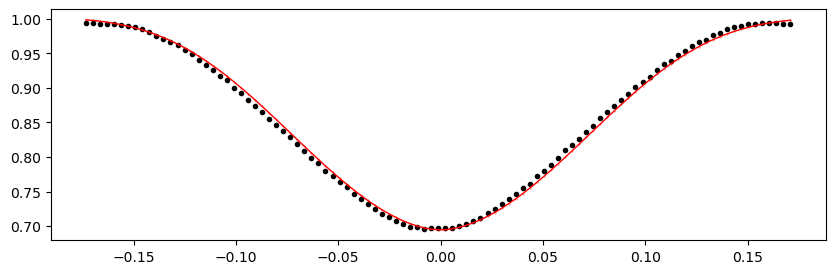

3012.523272 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1358.42it/s]


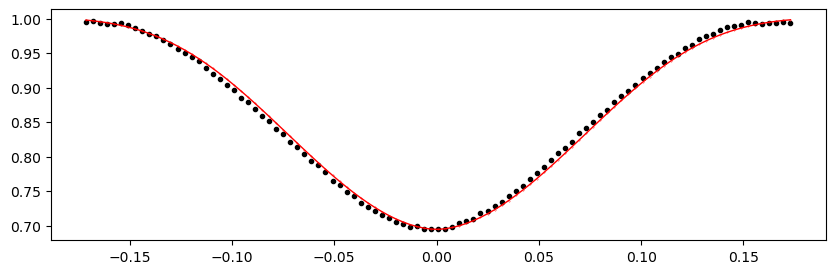

3013.195533 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1389.30it/s]


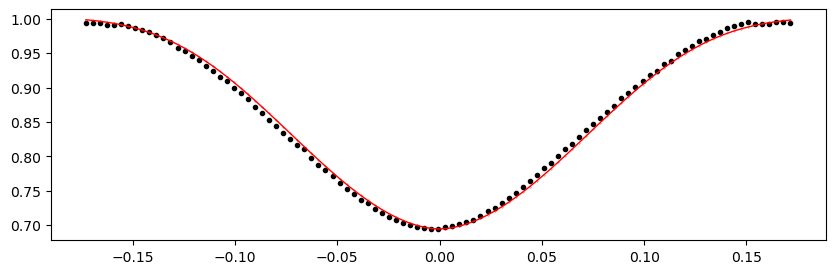

3013.867794 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1375.72it/s]


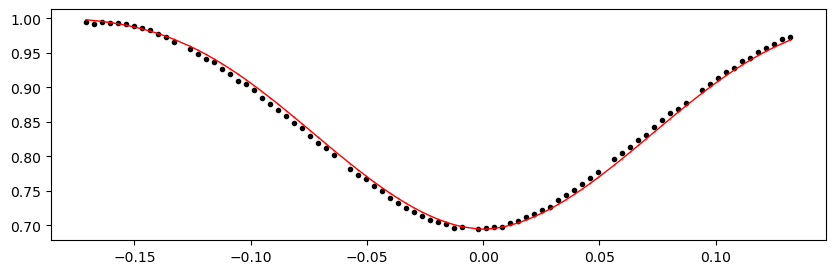

3015.212316 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1365.12it/s]


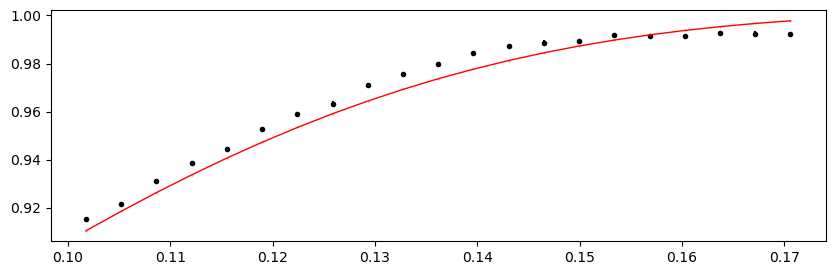

3015.884577 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:09<00:00, 1042.38it/s]


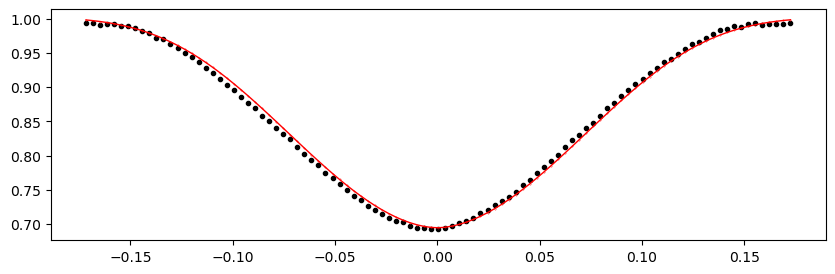

3016.556838 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1166.11it/s]


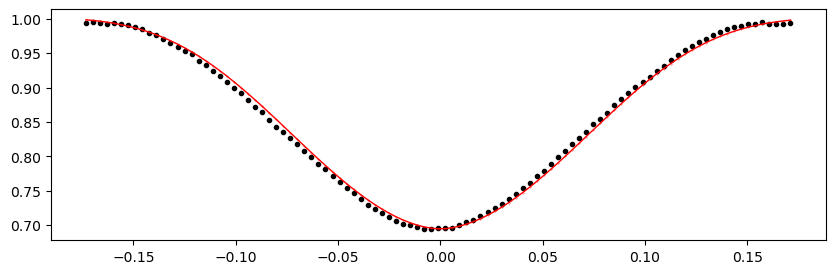

3017.229099 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.79it/s]


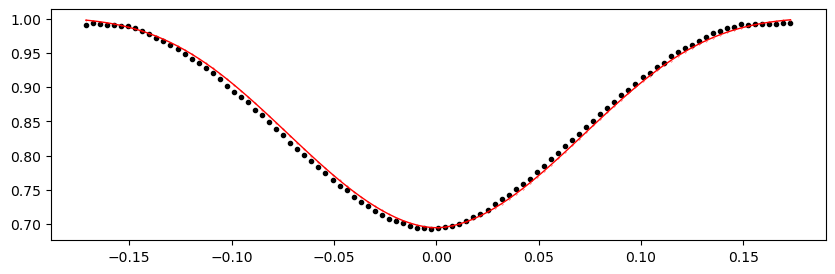

3017.90136 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1329.33it/s]


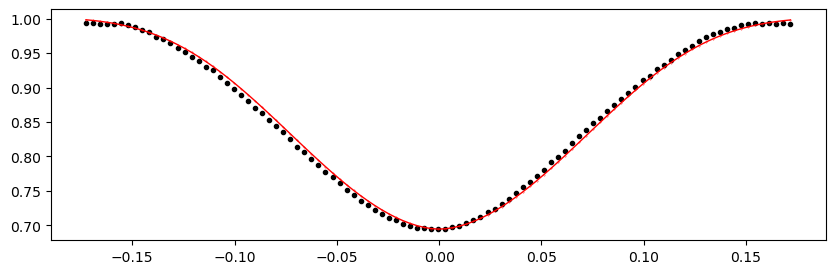

3018.573621 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1328.64it/s]


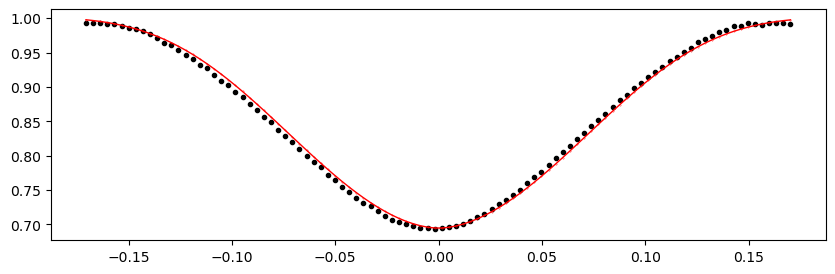

3019.245882 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.50it/s]


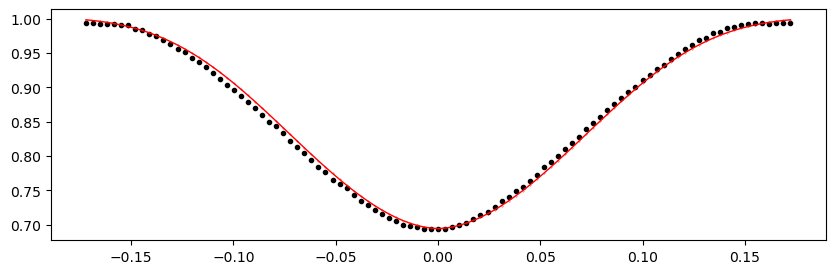

3019.918143 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.98it/s]


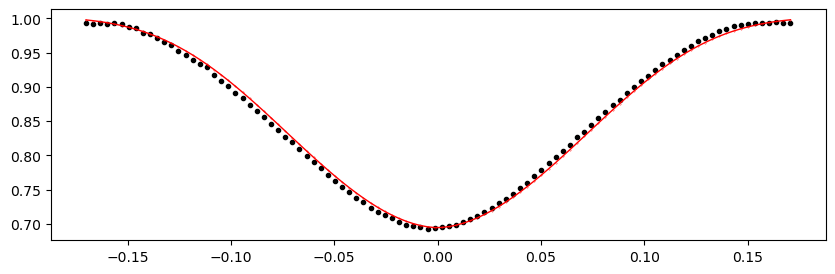

3020.590404 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.98it/s]


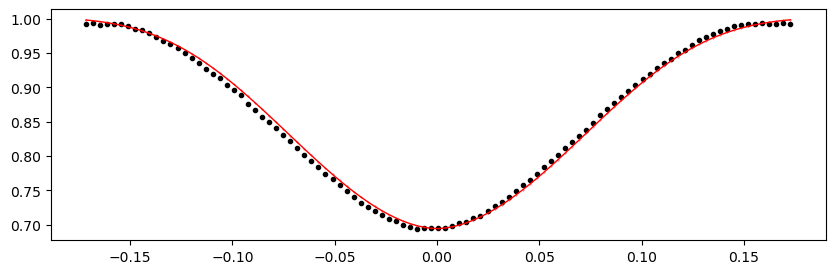

3021.934926 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.92it/s]


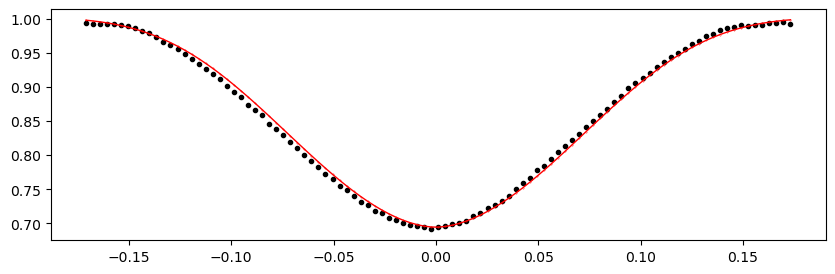

3022.607187 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.25it/s]


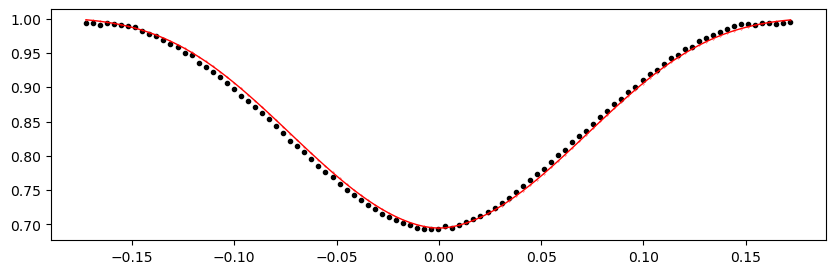

3023.2794480000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.61it/s]


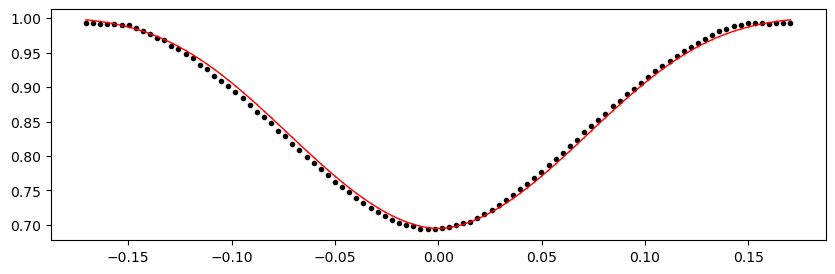

3023.951709 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.77it/s]


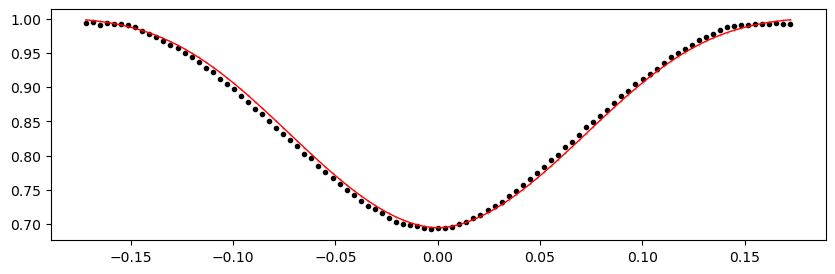

3024.62397 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.08it/s]


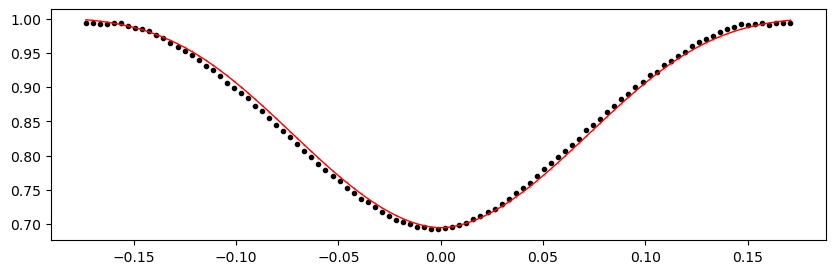

3025.2962310000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1281.80it/s]


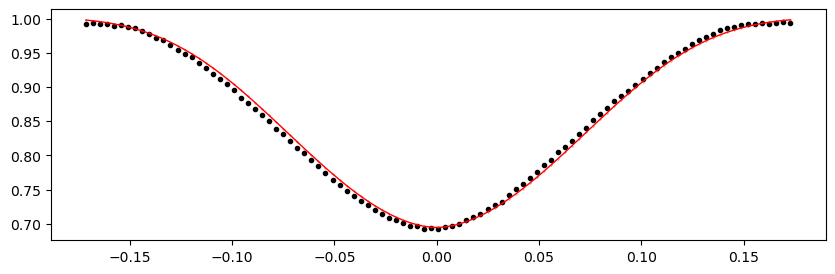

3025.968492 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1350.44it/s]


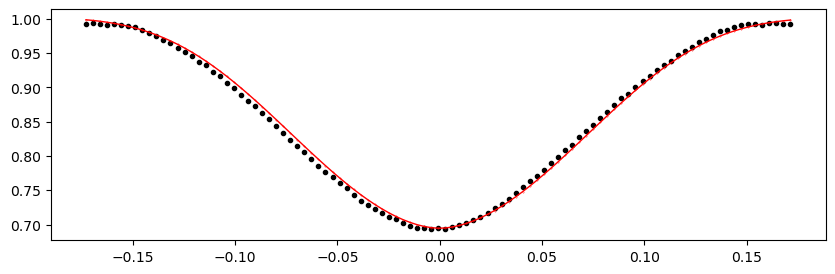

3026.640753 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1328.08it/s]


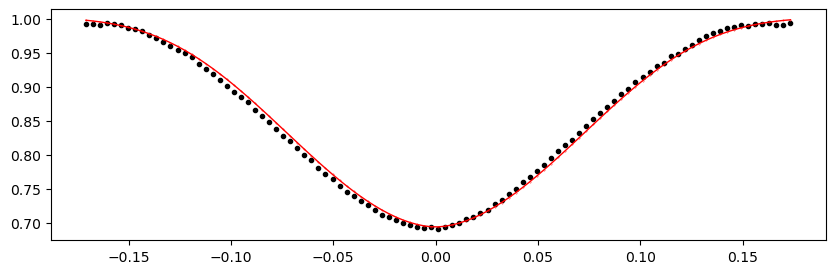

3027.3130140000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.22it/s]


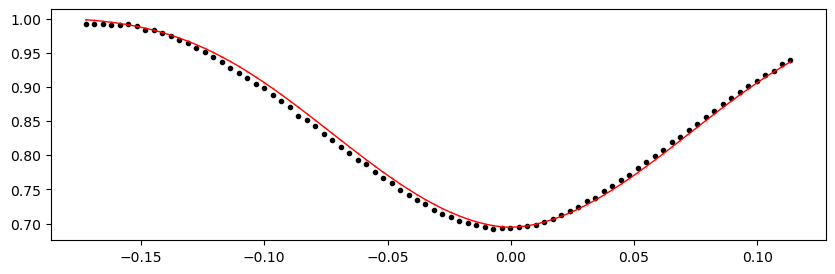

3027.985275 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.87it/s]


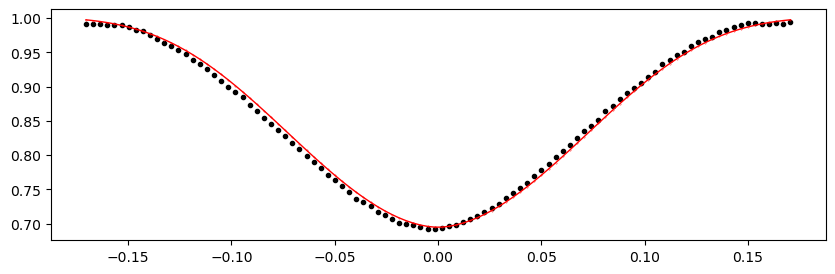

3028.657536 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.69it/s]


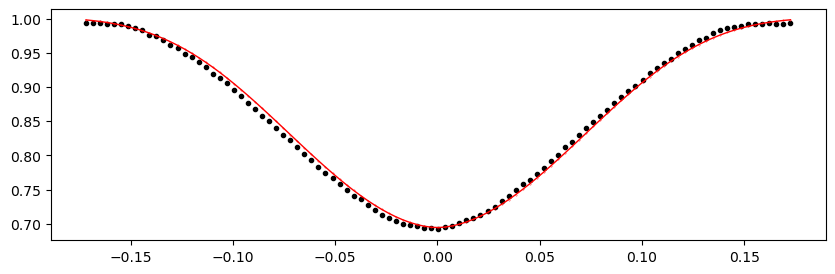

3029.329797 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.63it/s]


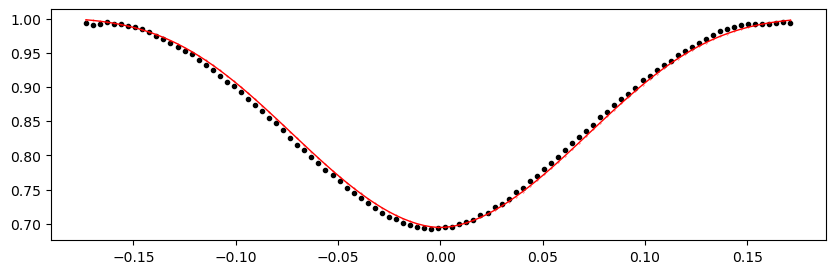

3030.002058 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.95it/s]


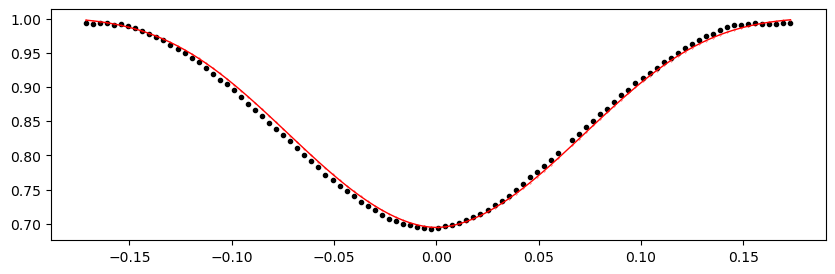

3030.6743189999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.34it/s]


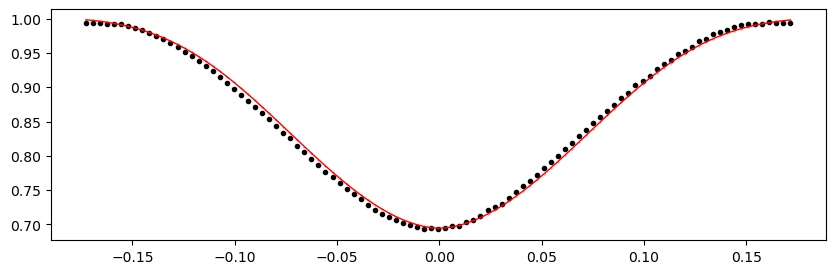

3031.34658 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.43it/s]


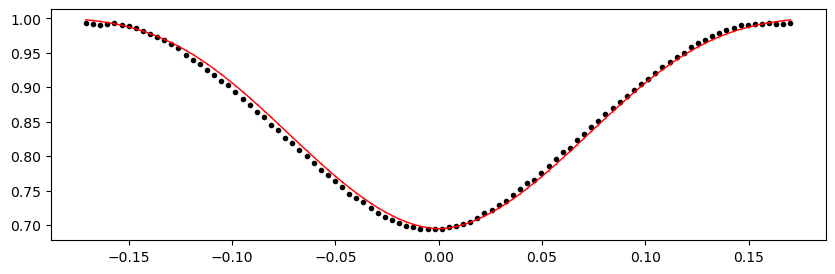

3032.018841 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1308.09it/s]


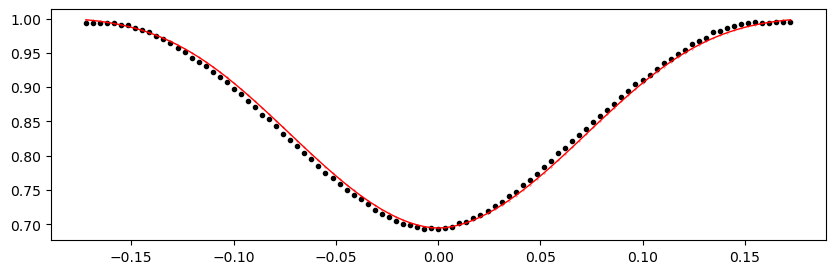

3032.691102 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.72it/s]


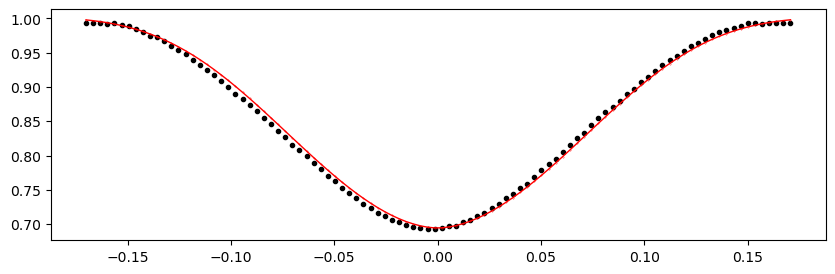

3033.363363 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.89it/s]


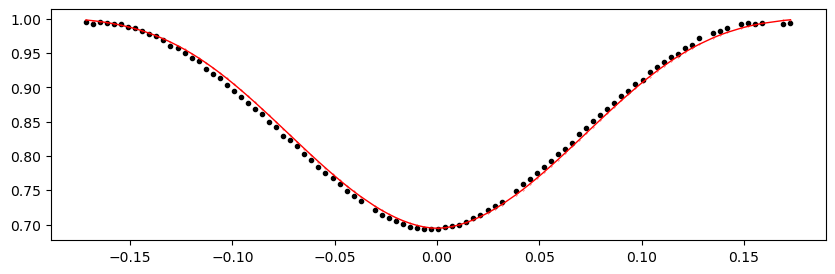

3034.035624 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1350.80it/s]


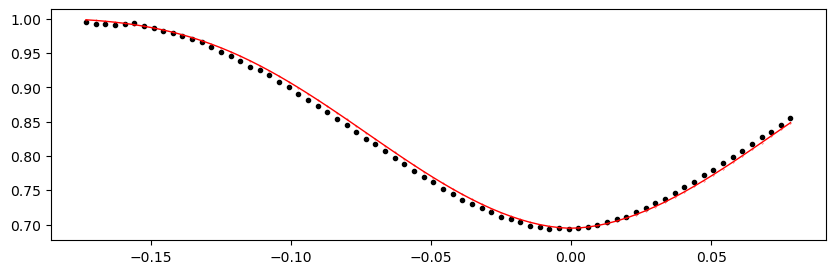

3034.707885 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1361.29it/s]


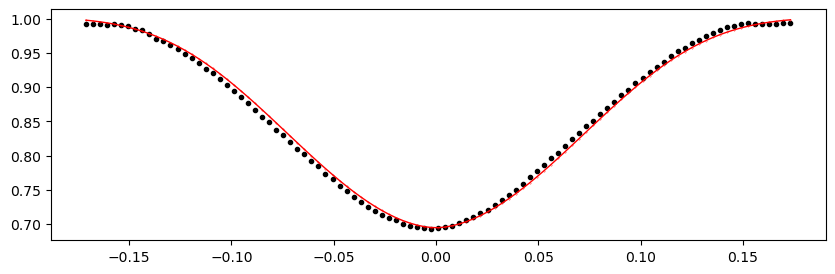

3035.380146 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.37it/s]


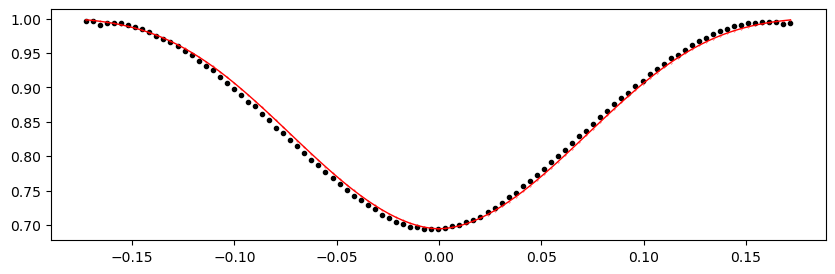

3036.052407 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1357.46it/s]


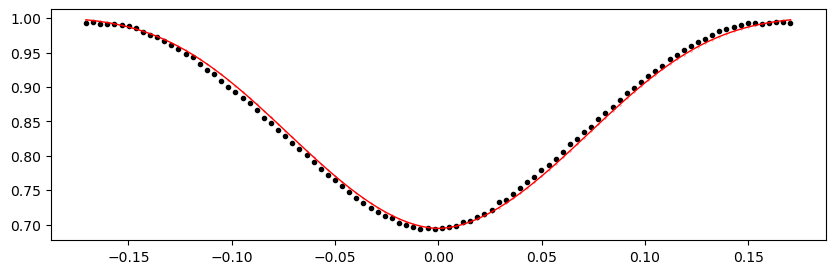

3036.724668 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.75it/s]


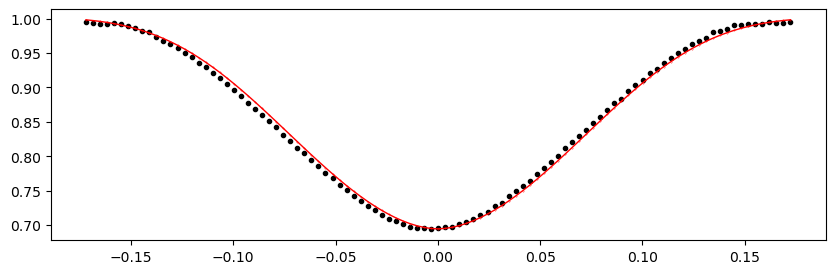

3037.396929 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.32it/s]


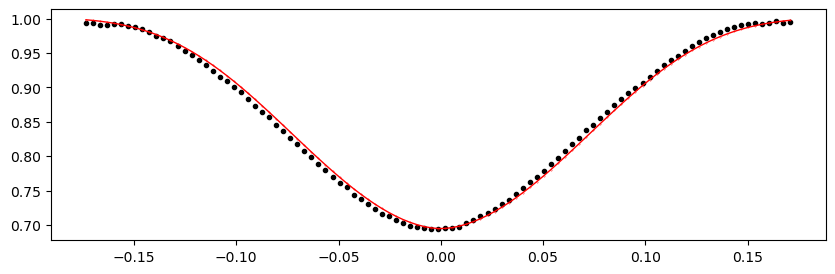

3038.06919 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1362.27it/s]


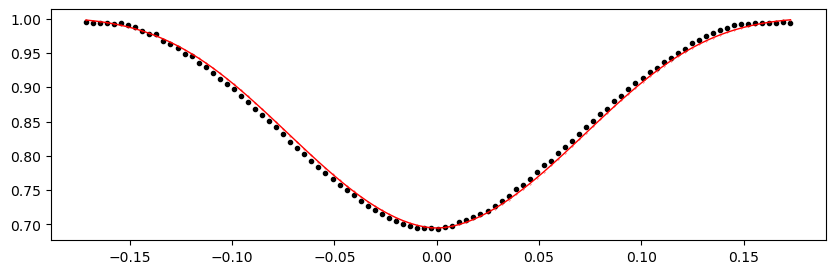

3038.741451 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1358.65it/s]


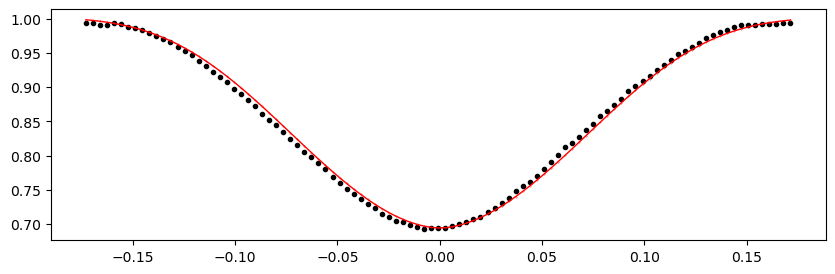

3039.413712 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1362.43it/s]


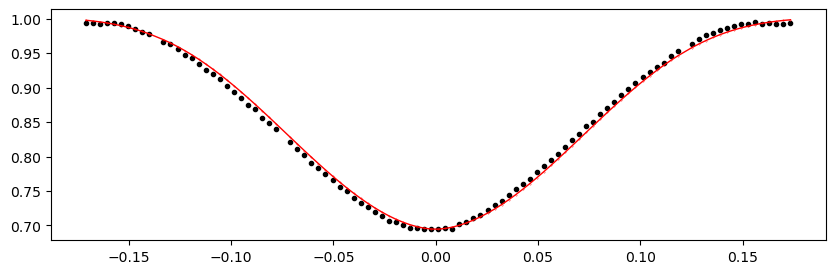

3040.085973 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.22it/s]


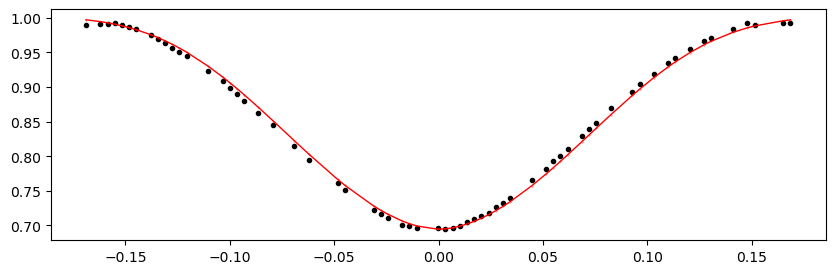

3040.758234 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.77it/s]


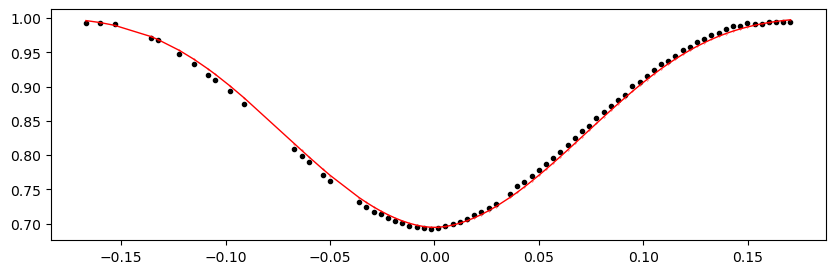

3041.430495 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1357.83it/s]


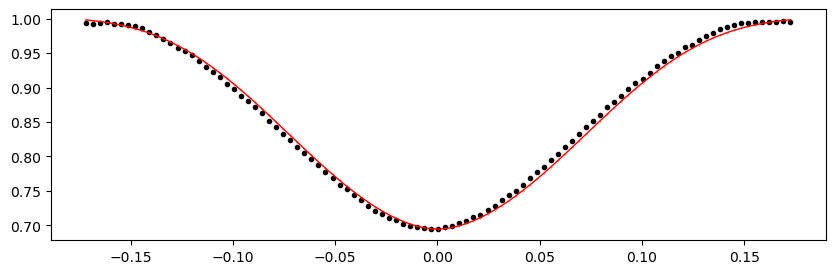

3042.102756 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.61it/s]


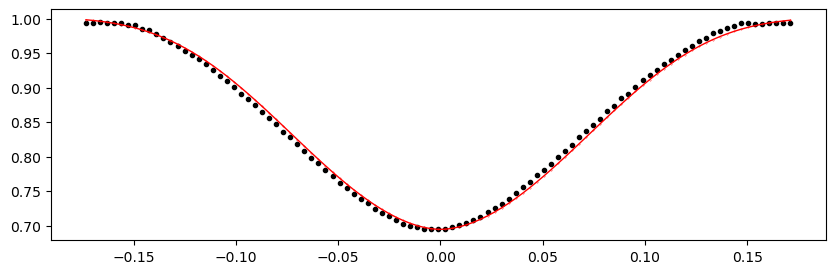

3042.775017 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.88it/s]


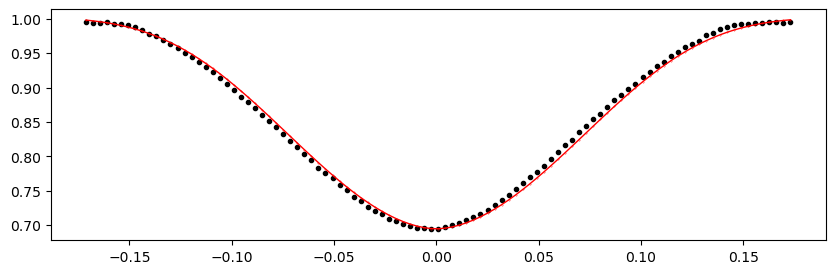

3043.447278 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.50it/s]


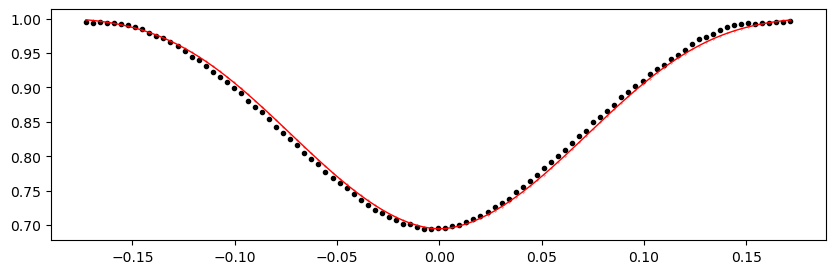

3044.1195390000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.50it/s]


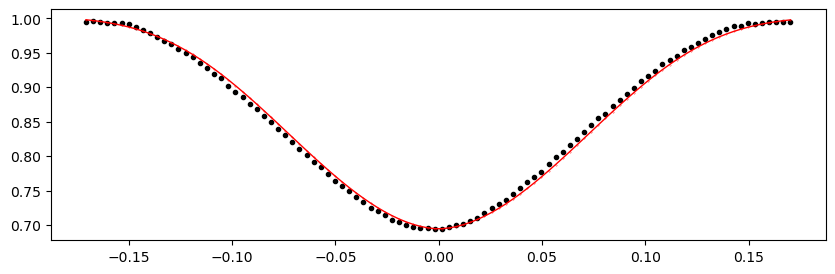

3044.7918 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.17it/s]


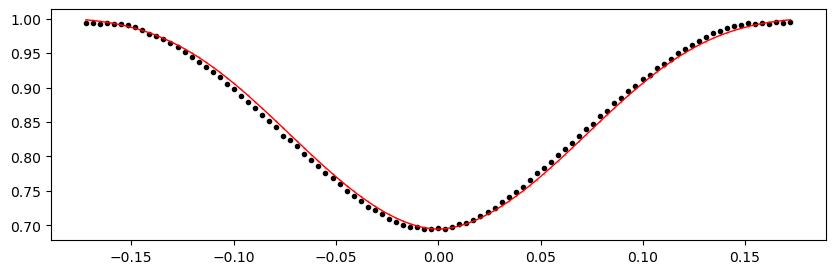

3045.464061 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.24it/s]


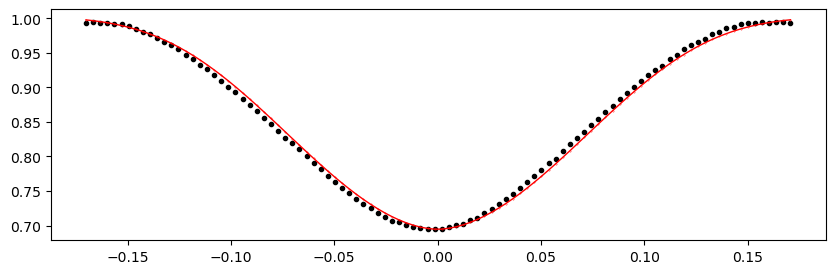

3046.1363220000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.32it/s]


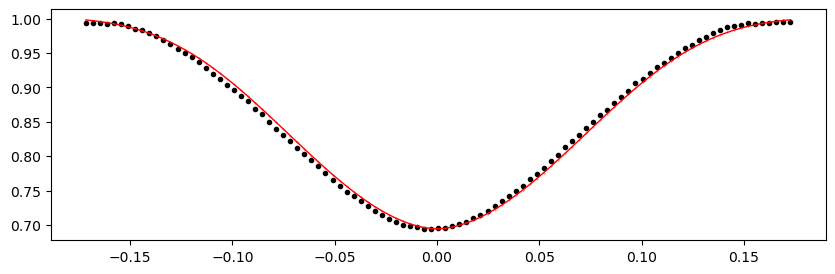

3046.808583 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.84it/s]


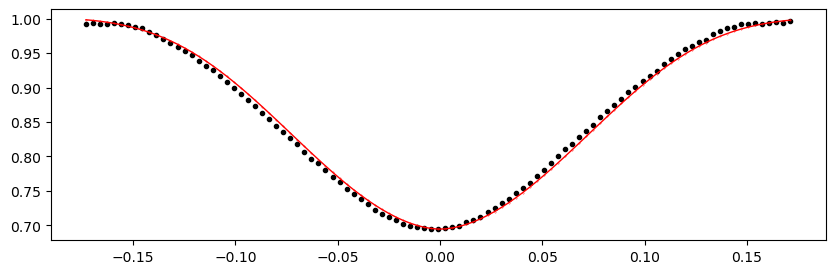

3047.480844 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.37it/s]


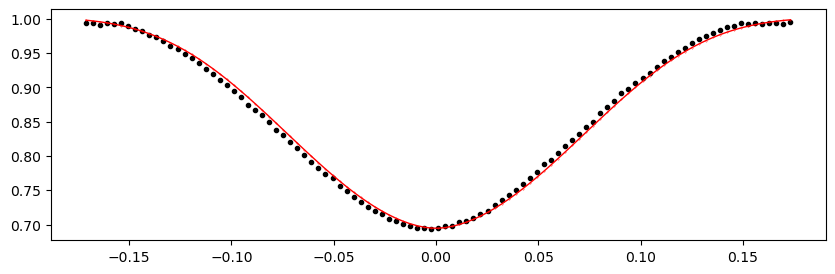

3048.153105 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.87it/s]


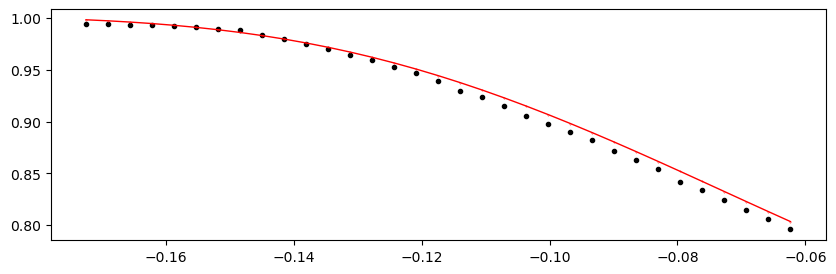

3048.825366 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.10it/s]


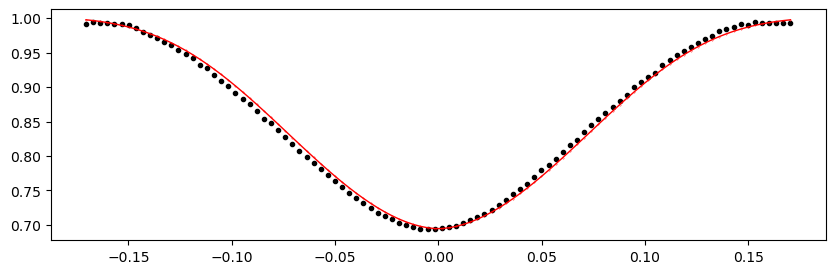

3049.4976269999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.71it/s]


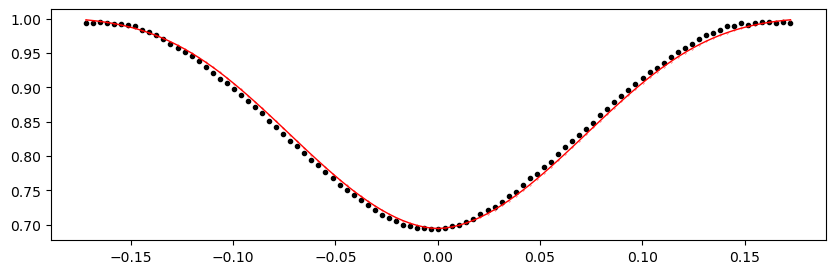

3050.169888 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.77it/s]


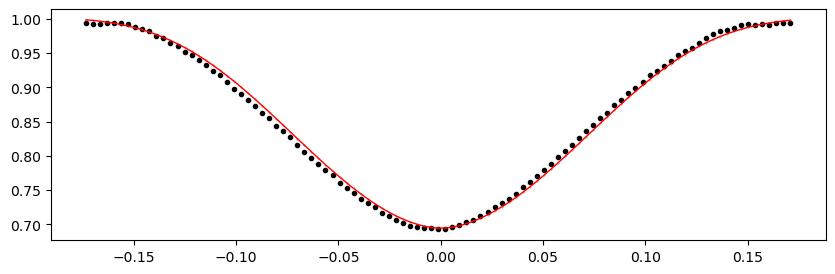

3050.842149 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.03it/s]


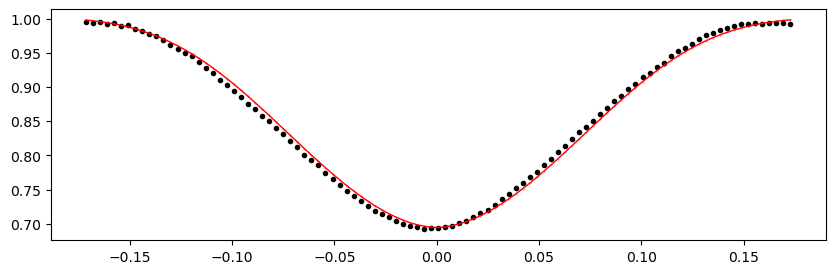

3051.5144099999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.52it/s]


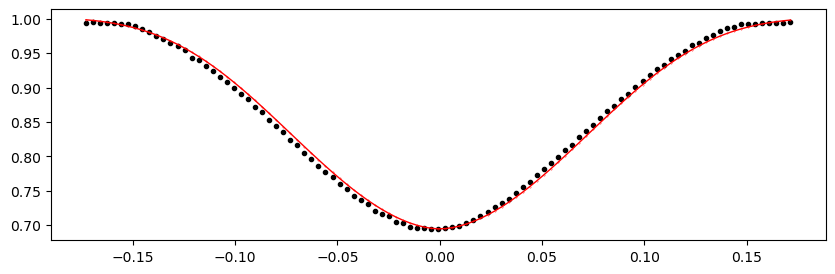

3052.186671 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.76it/s]


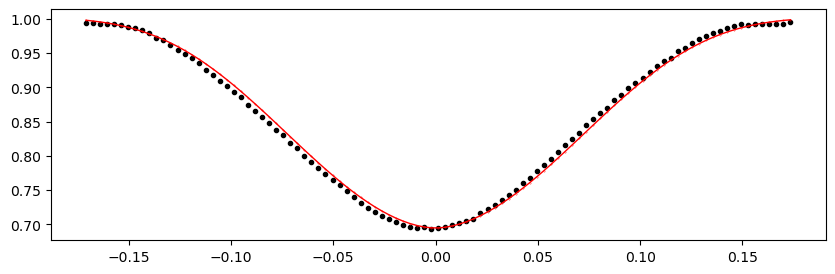

3052.858932 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.32it/s]


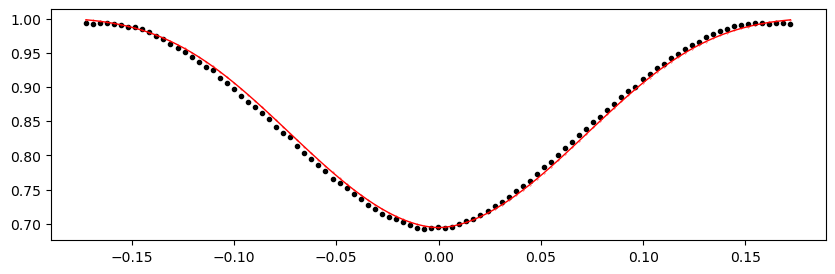

3053.531193 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.53it/s]


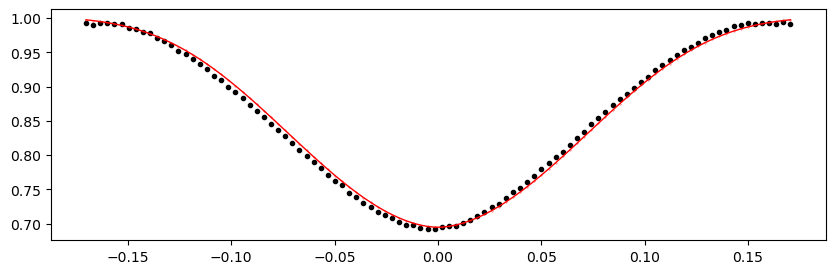

3054.203454 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.52it/s]


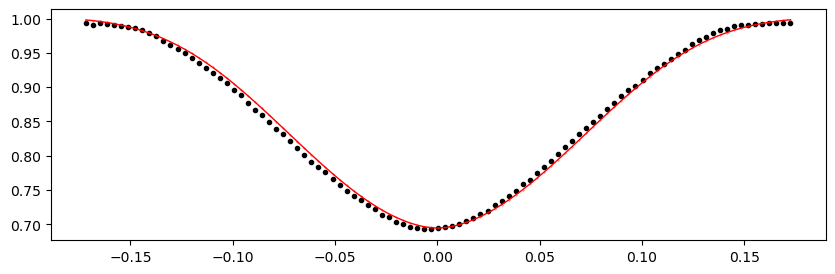

3054.875715 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.65it/s]


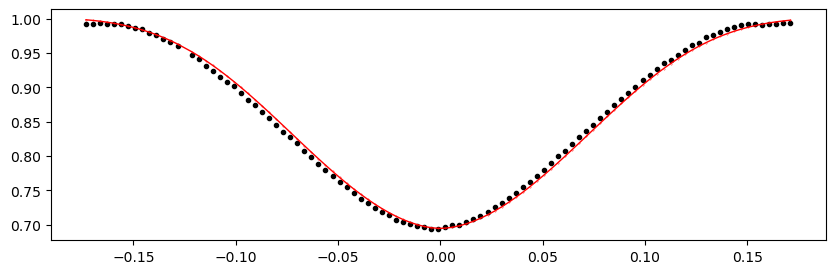

3055.547976 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.61it/s]


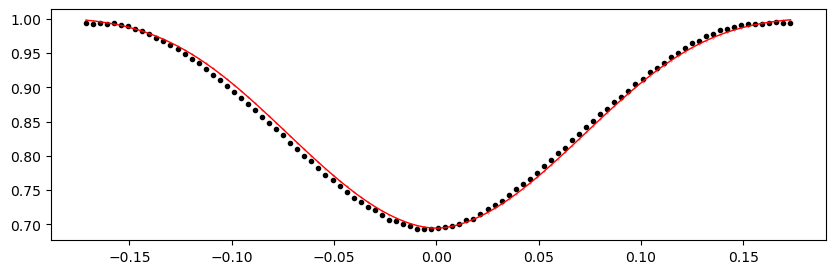

3056.220237 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.80it/s]


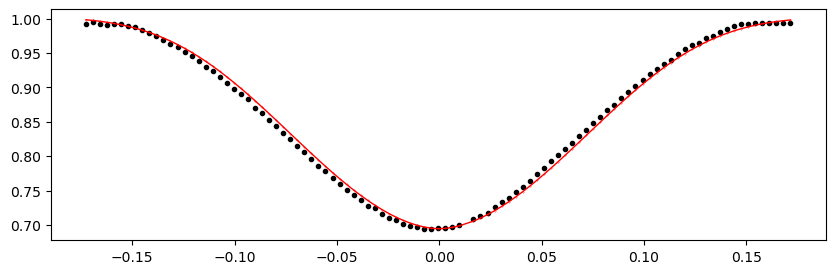

3056.892498 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1359.80it/s]


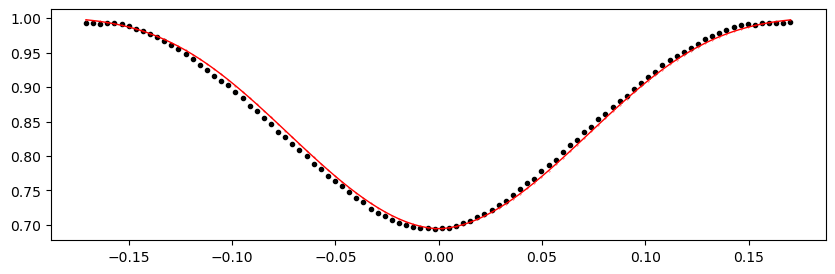

3057.564759 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.94it/s]


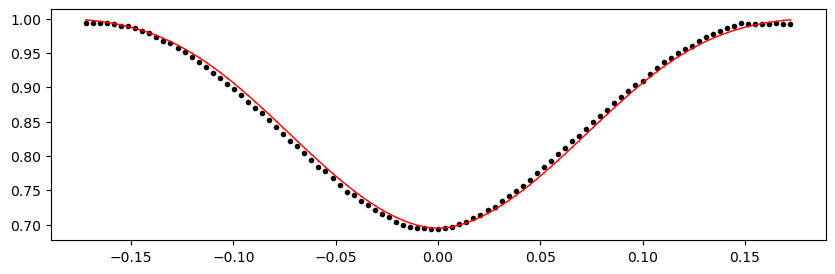

3058.23702 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.08it/s]


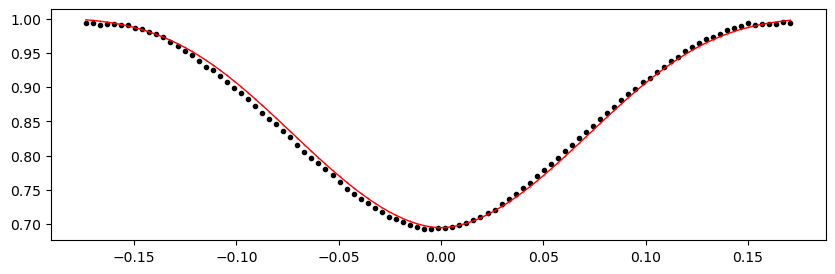

3058.909281 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1350.53it/s]


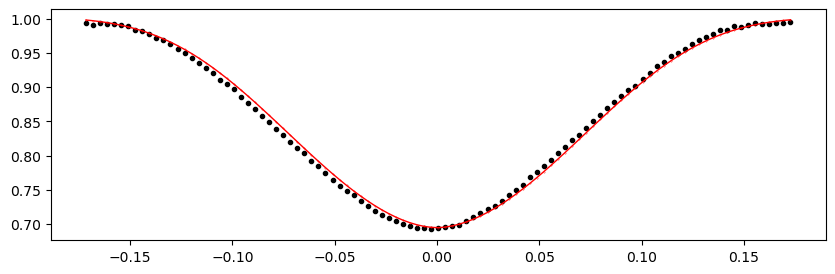

3059.581542 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.33it/s]


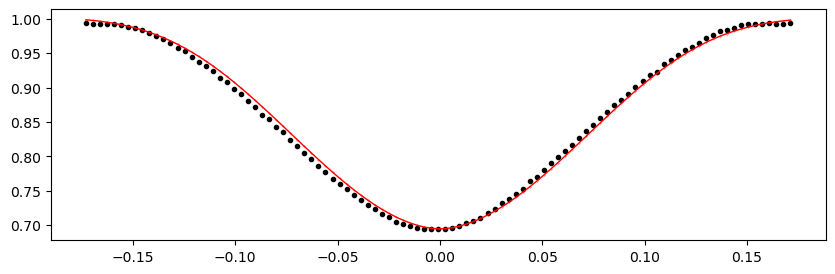

3060.253803 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1343.17it/s]


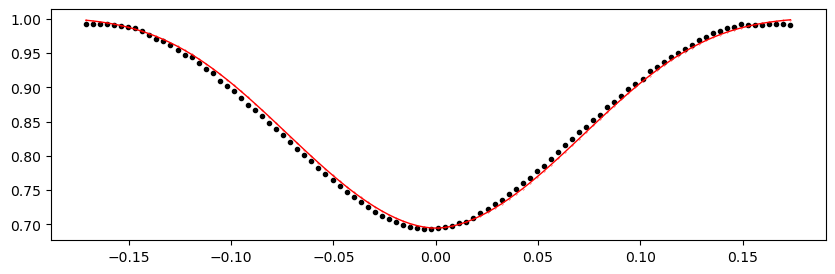

3060.926064 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.27it/s]


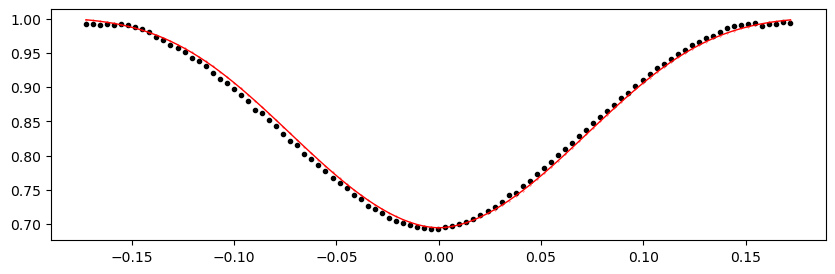

3061.598325 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.82it/s]


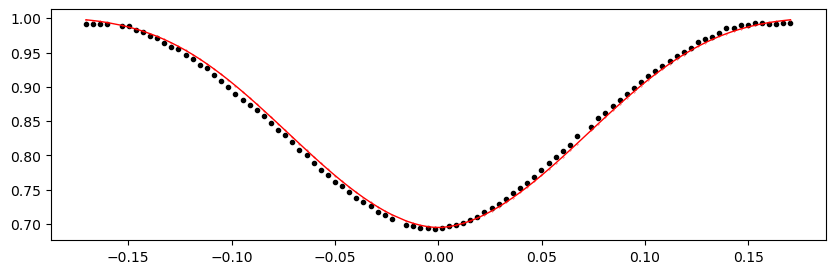

3062.270586 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.74it/s]


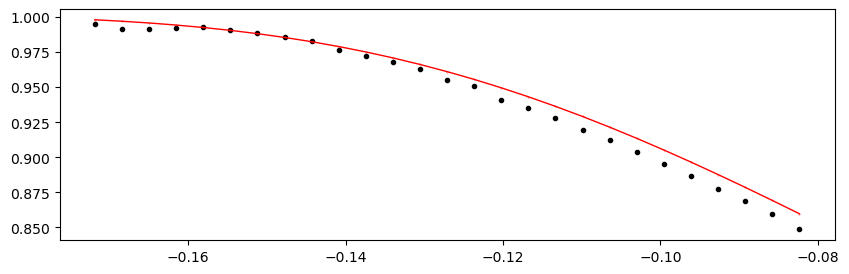

3062.9428470000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.81it/s]


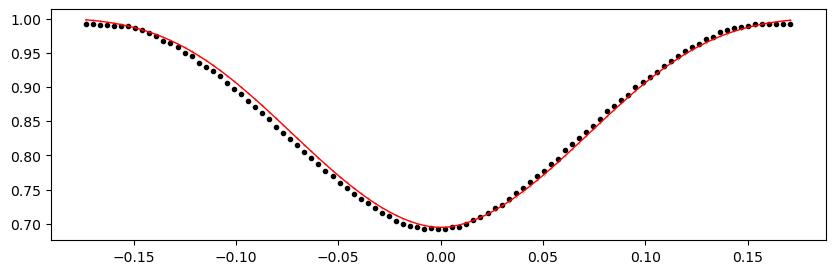

3063.615108 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.82it/s]


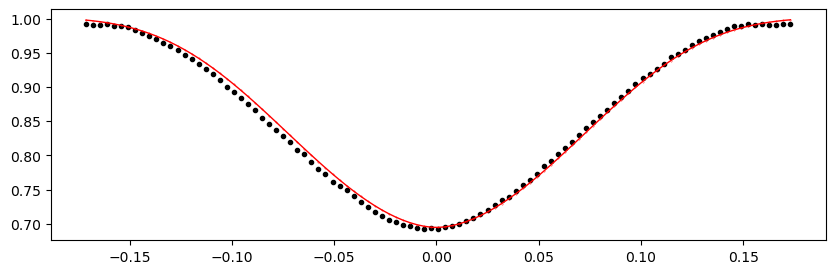

3064.2873689999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.02it/s]


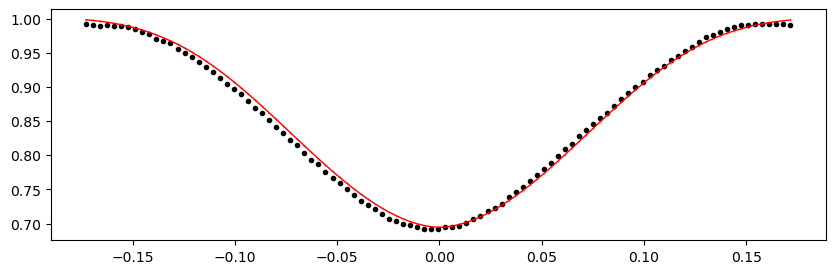

3064.9596300000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1364.69it/s]


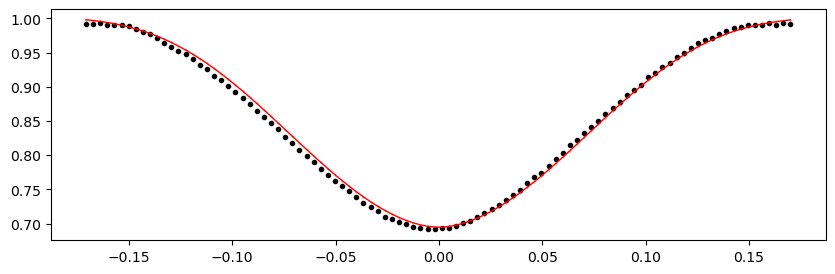

3065.631891 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.68it/s]


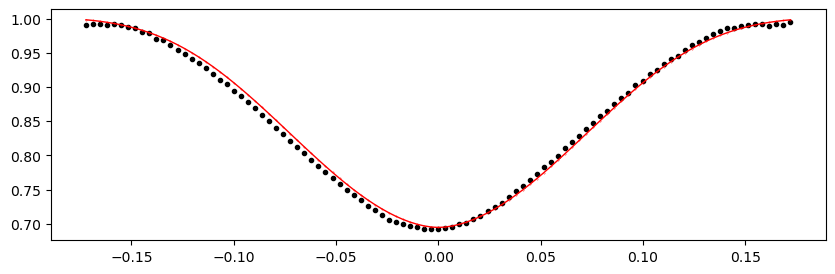

3066.3041519999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.26it/s]


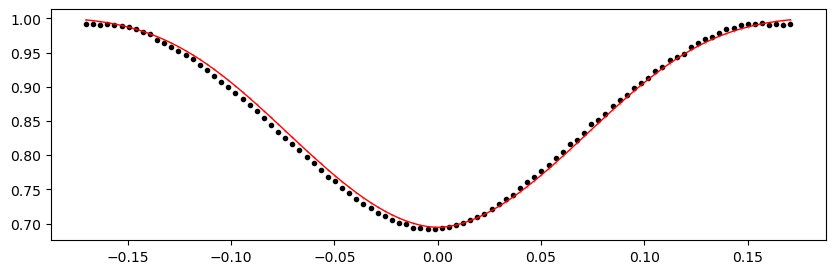

3066.9764130000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.20it/s]


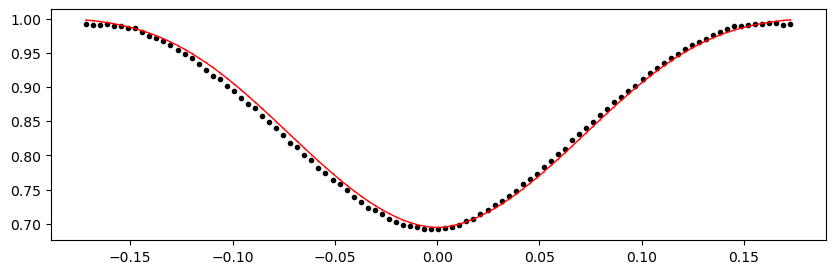

3067.648674 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.14it/s]


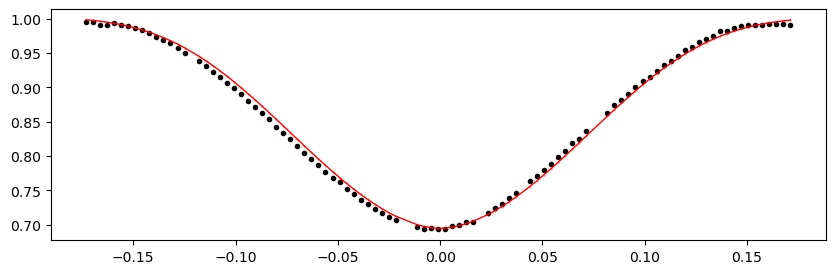

3068.9931960000004 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.55it/s]


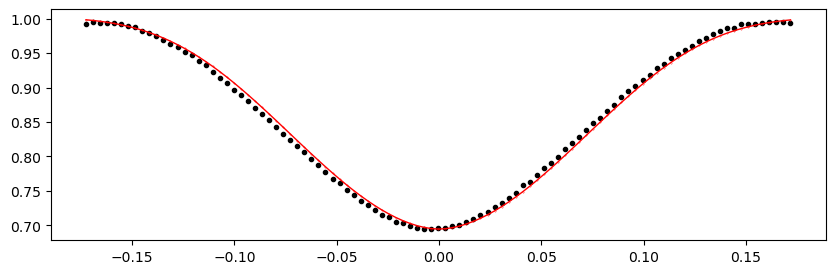

3069.665457 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.30it/s]


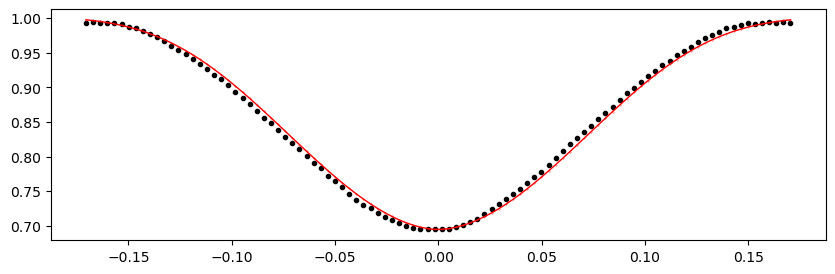

3070.3377179999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.21it/s]


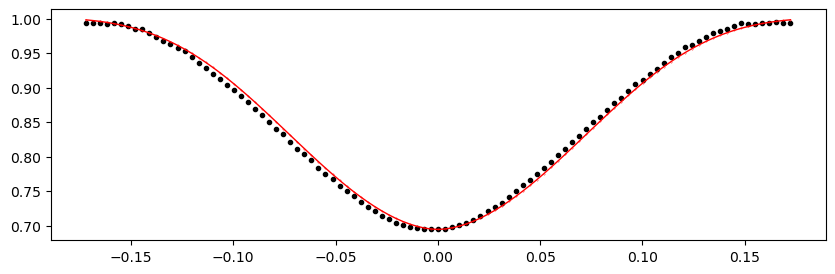

3071.009979 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.36it/s]


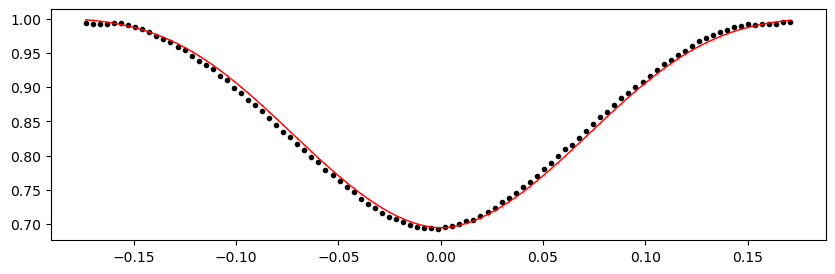

3071.68224 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1355.01it/s]


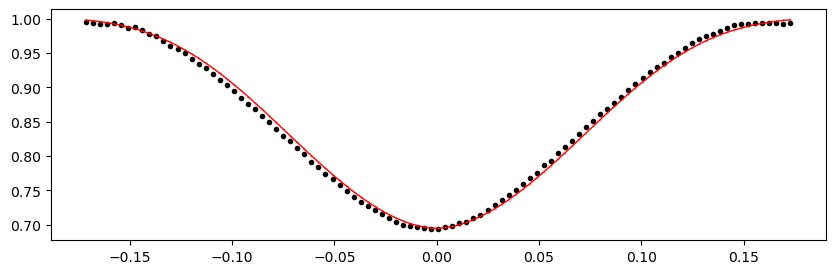

3072.354501 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.06it/s]


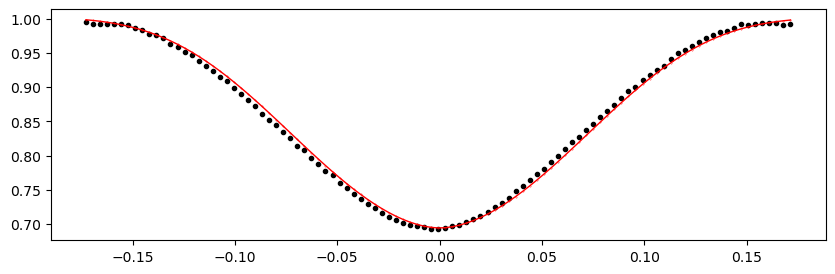

3073.026762 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.56it/s]


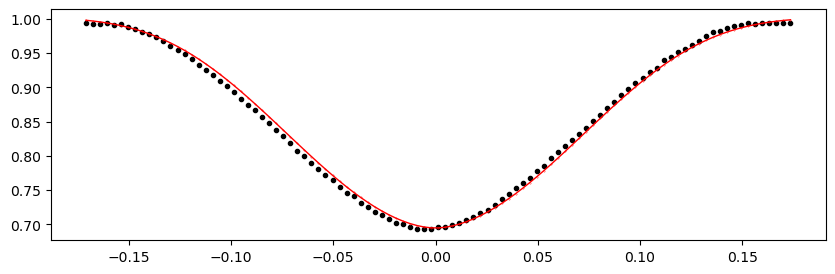

3073.699023 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.85it/s]


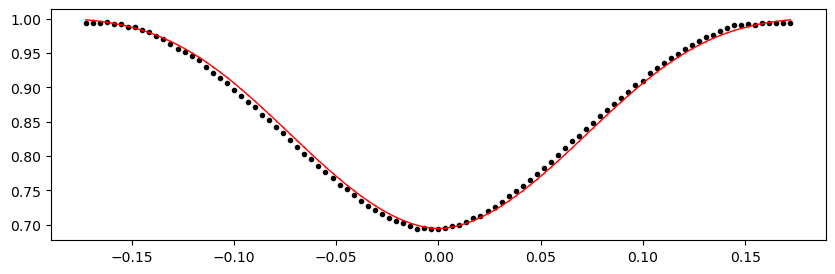

3074.371284 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.01it/s]


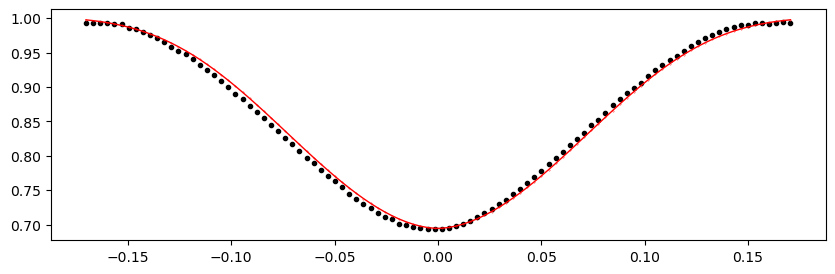

3075.043545 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.66it/s]


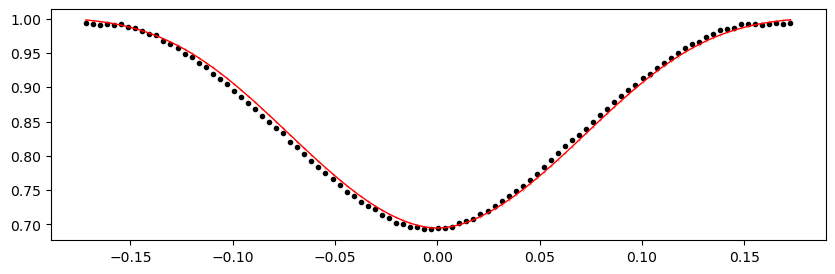

3075.715806 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.68it/s]


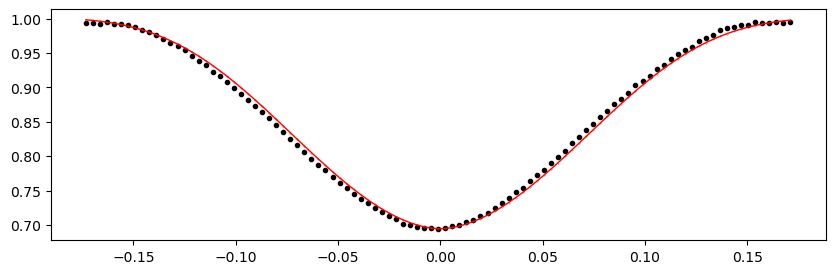

3076.388067 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.19it/s]


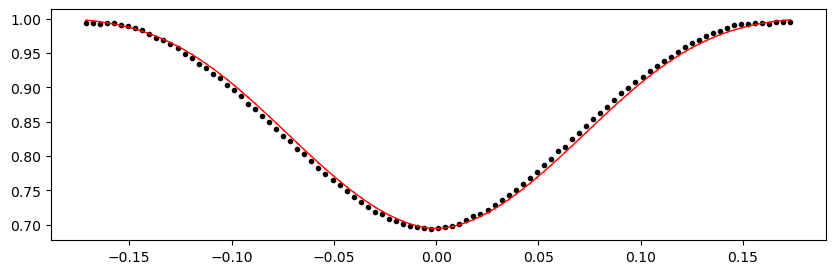

3082.438416 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.73it/s]


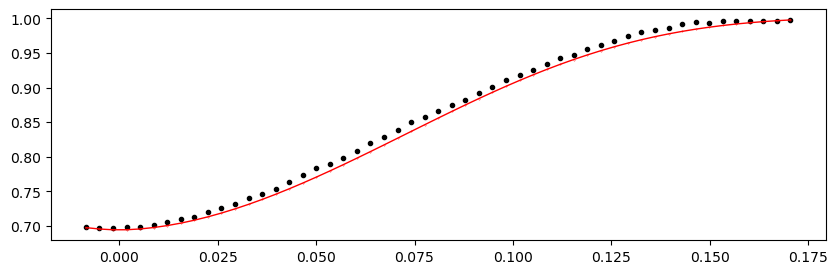

3083.110677 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.47it/s]


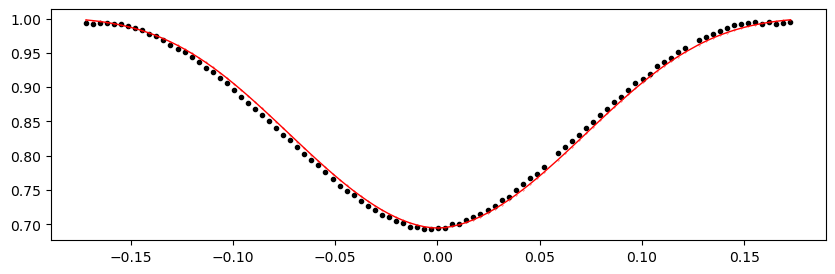

3083.7829380000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.83it/s]


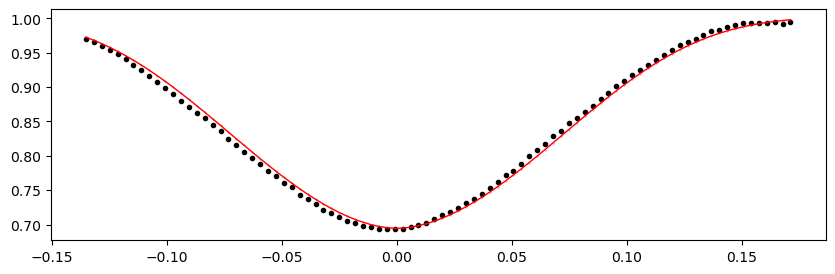

3084.455199 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1352.26it/s]


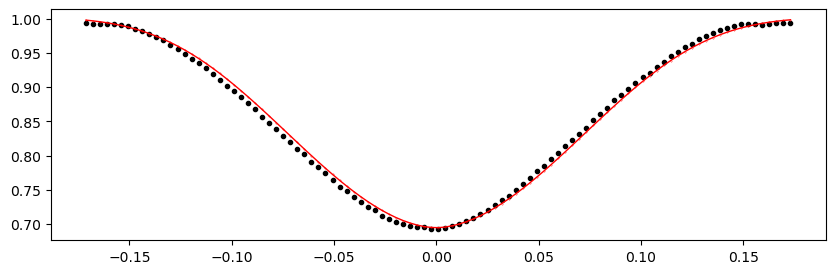

3085.1274599999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.28it/s]


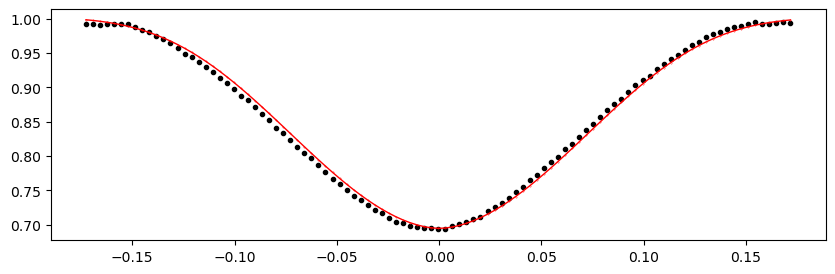

3085.7997210000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.04it/s]


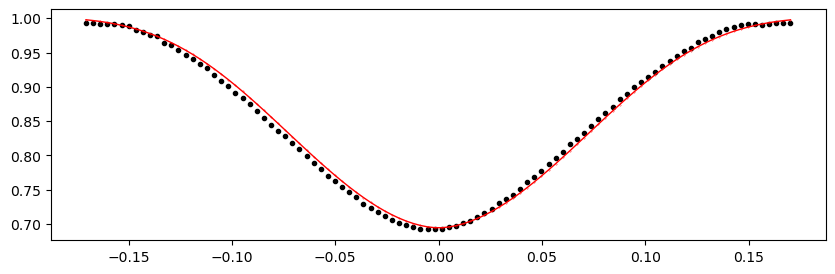

3086.471982 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1338.62it/s]


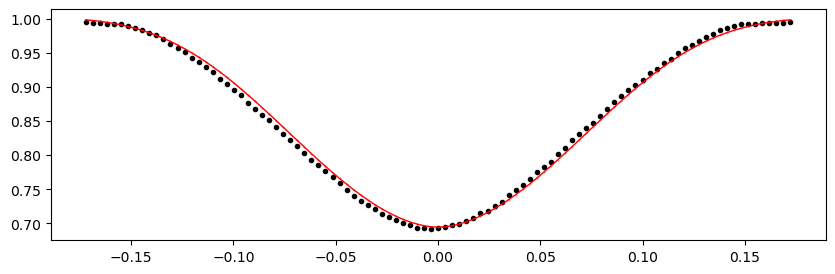

3087.1442429999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.97it/s]


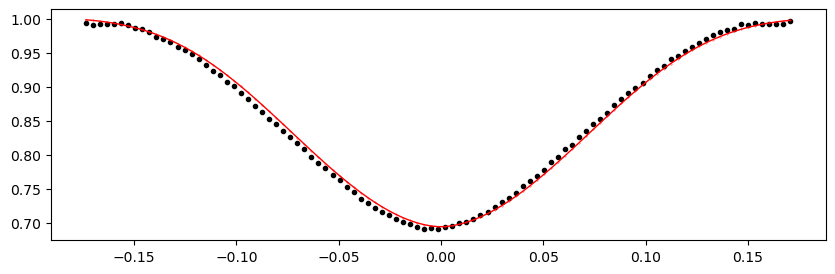

3087.8165040000004 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.88it/s]


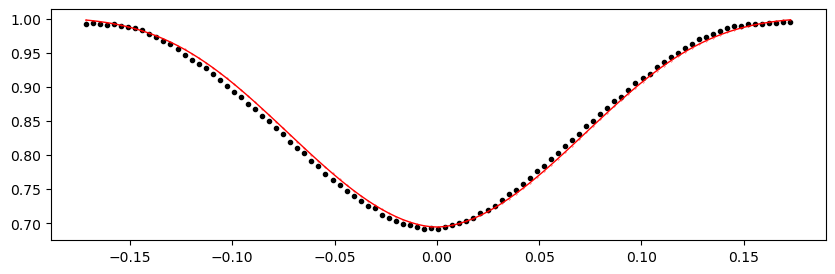

3088.488765 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.05it/s]


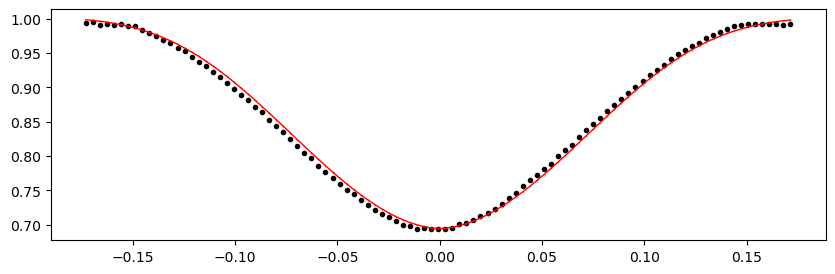

3089.1610259999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.55it/s]


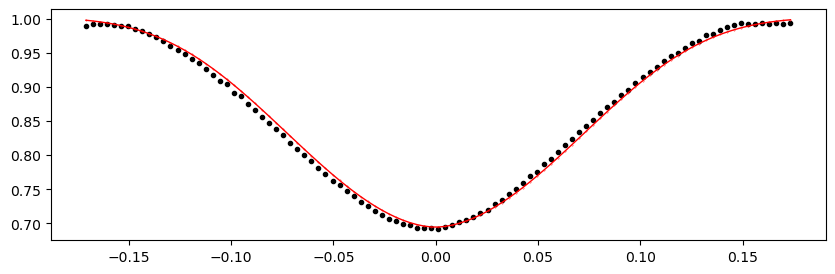

3089.833287 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1350.43it/s]


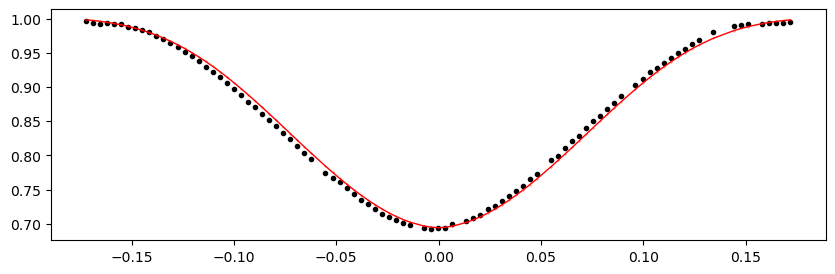

3090.505548 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.15it/s]


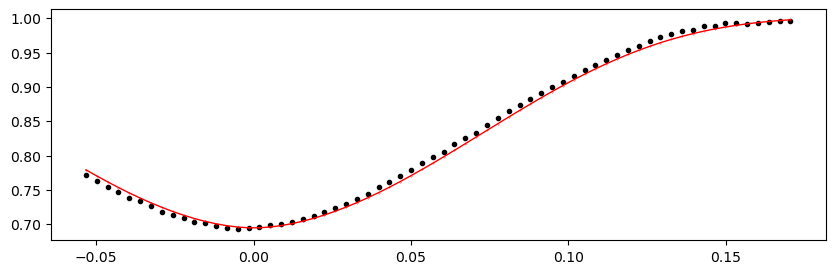

3126.8076419999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.57it/s]


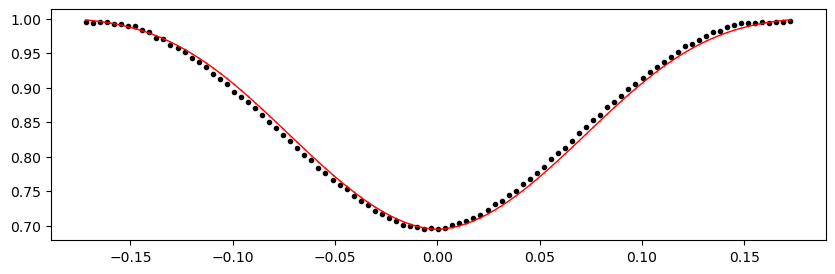

3127.479903 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1349.55it/s]


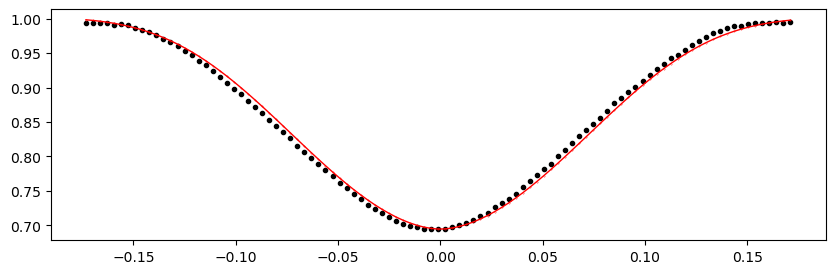

3128.152164 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.30it/s]


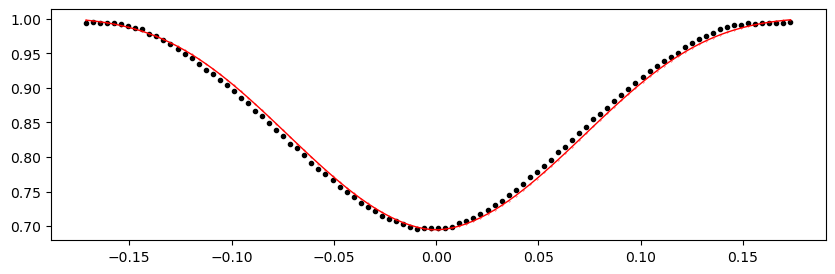

3128.824425 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1366.10it/s]


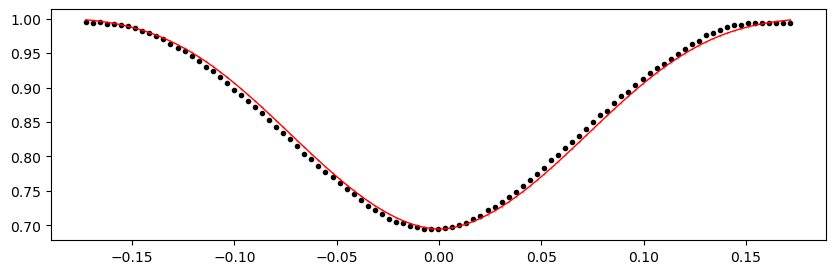

3129.496686 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1357.79it/s]


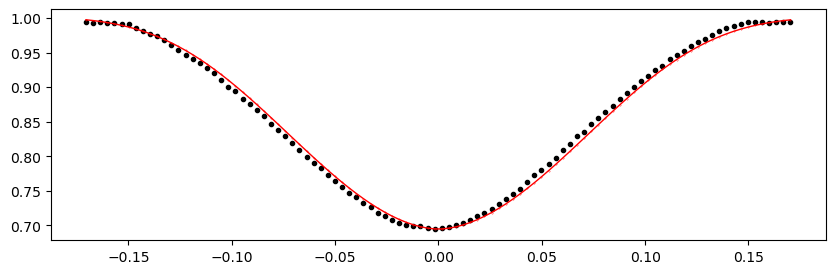

3130.168947 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1356.99it/s]


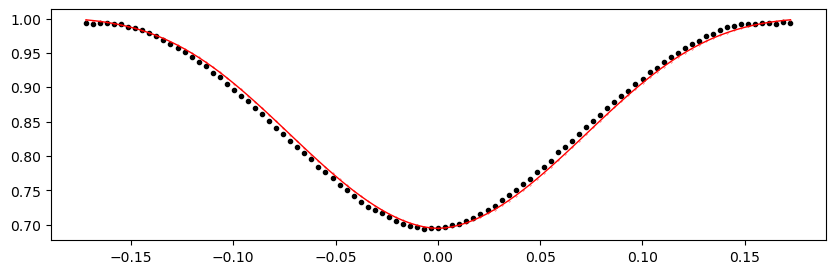

3130.841208 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1177.25it/s]


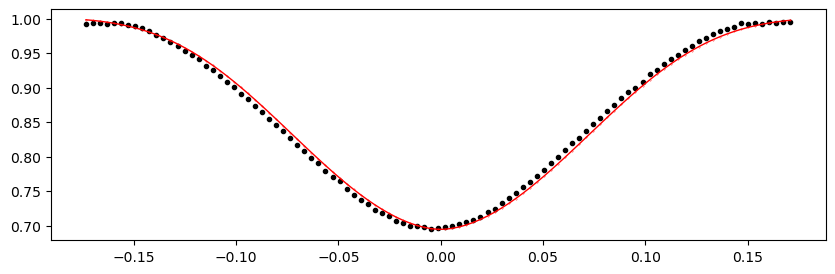

3131.513469 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:09<00:00, 1030.87it/s]


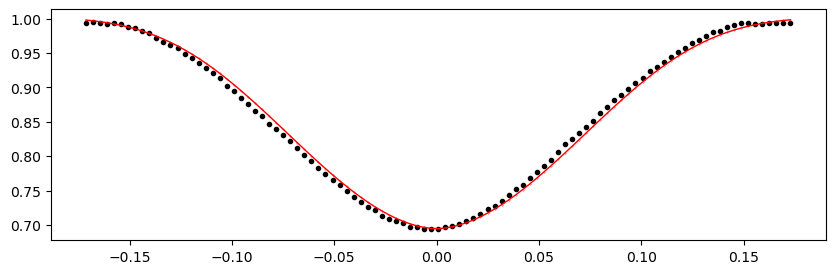

3132.18573 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1281.21it/s]


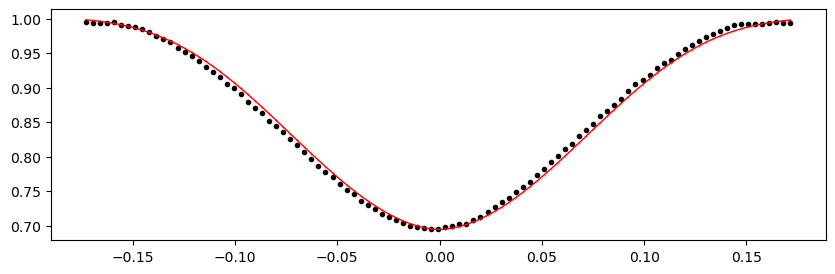

3132.857991 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.49it/s]


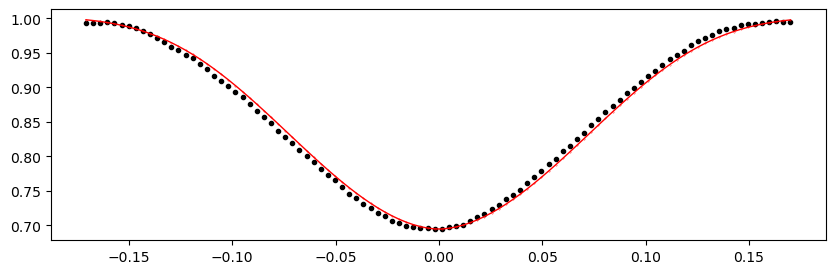

3133.530252 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.83it/s]


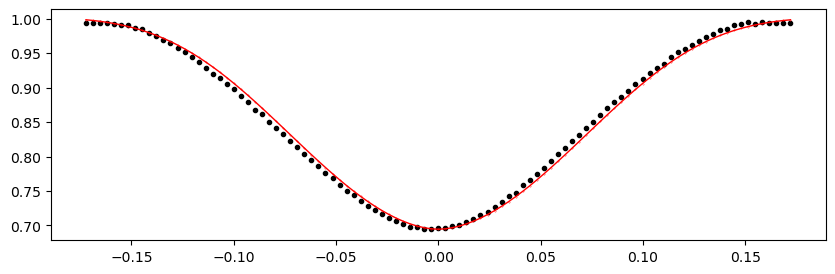

3134.202513 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.65it/s]


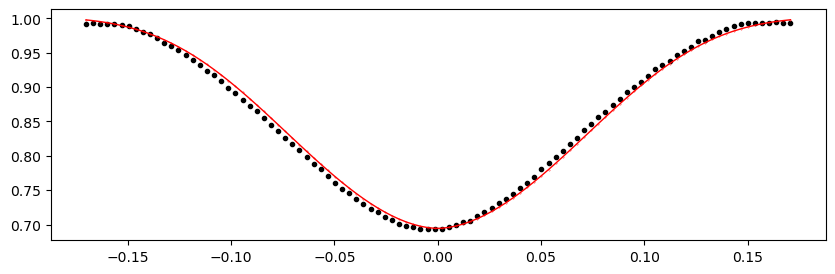

3140.925123 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.78it/s]


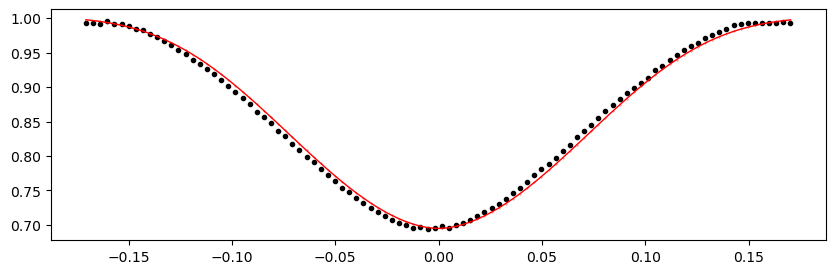

3141.5973839999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.00it/s]


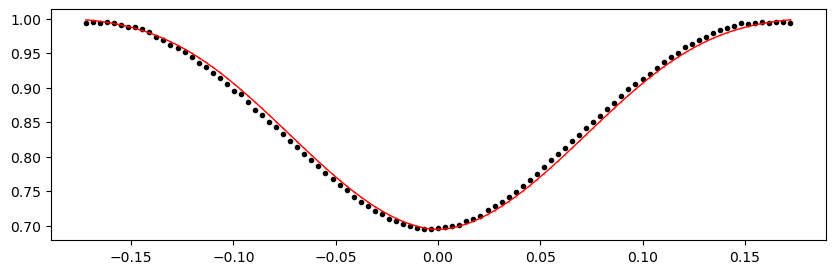

3142.2696450000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.47it/s]


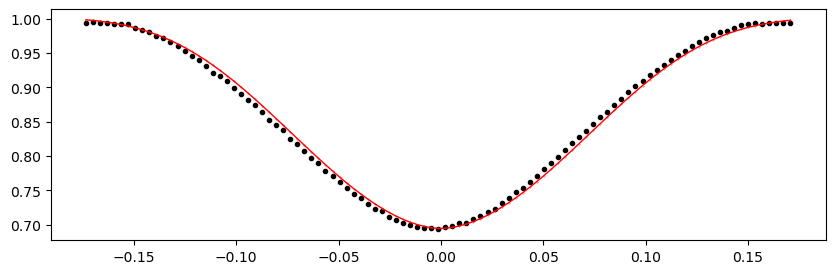

3142.941906 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.52it/s]


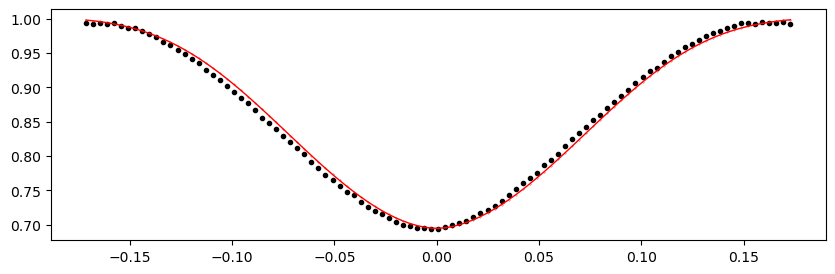

3143.6141669999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1333.66it/s]


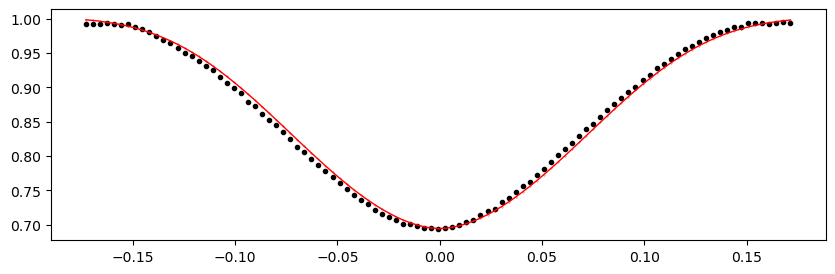

3144.2864280000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1342.32it/s]


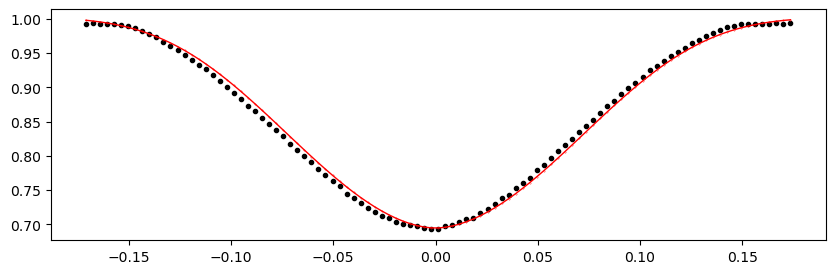

3144.958689 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.79it/s]


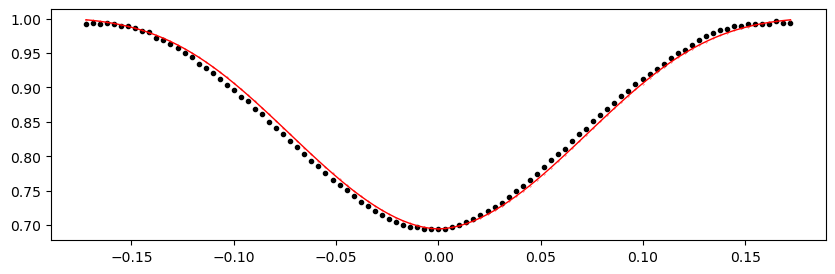

3145.6309499999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1121.07it/s]


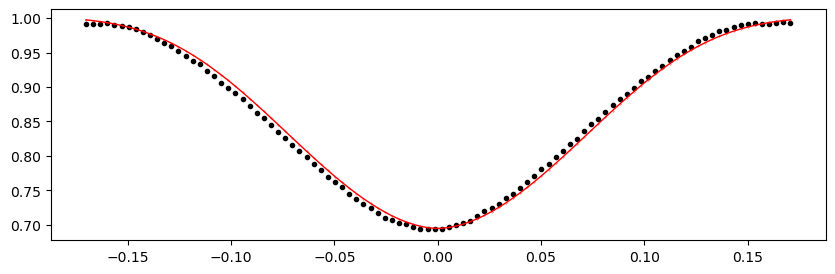

3146.303211 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:08<00:00, 1126.76it/s]


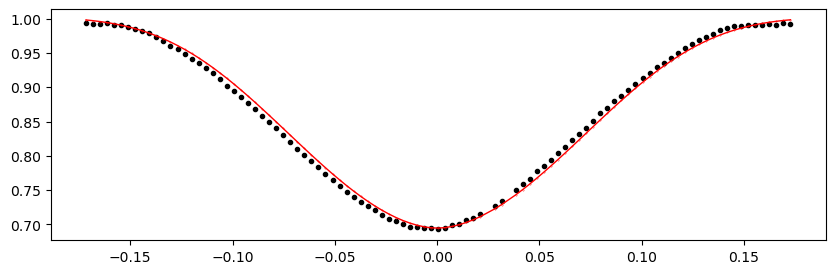

3146.975472 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.61it/s]


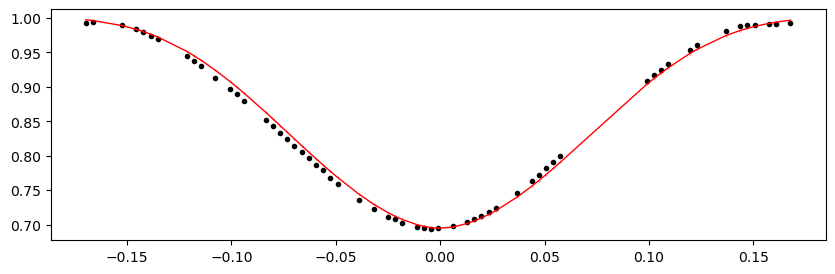

3147.647733 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1339.58it/s]


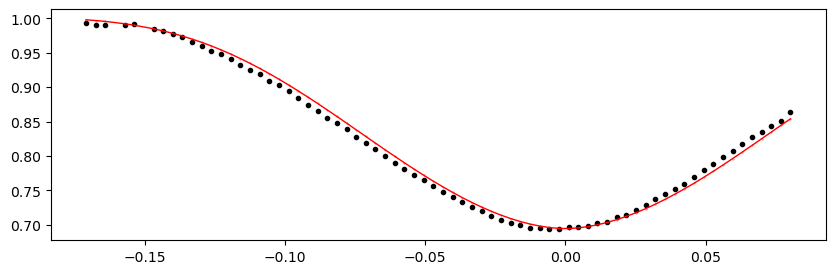

3148.319994 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.40it/s]


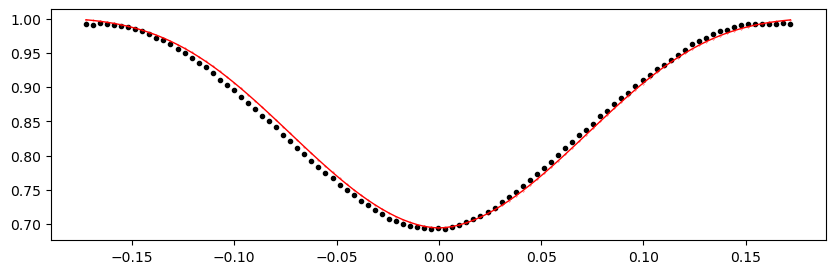

3148.992255 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.68it/s]


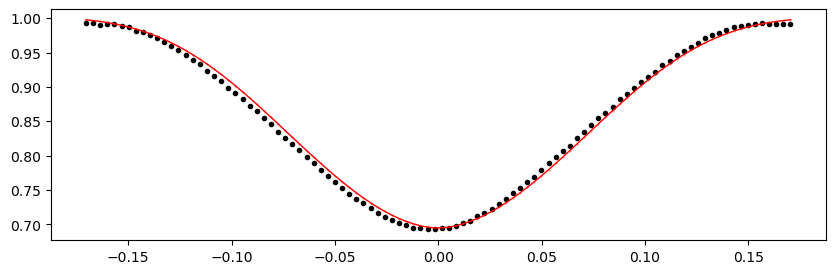

3155.042604 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.43it/s]


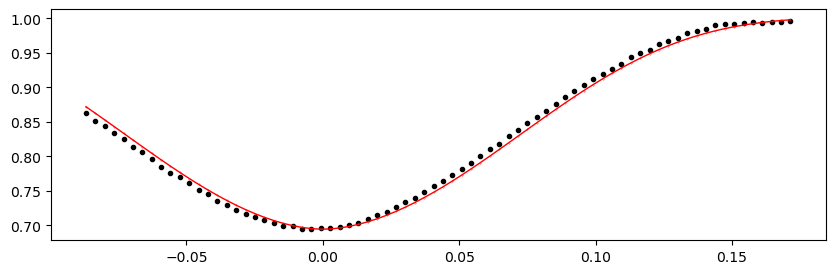

3155.714865 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.33it/s]


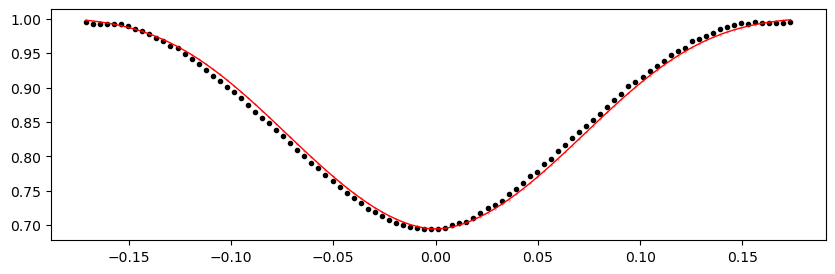

3156.387126 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.89it/s]


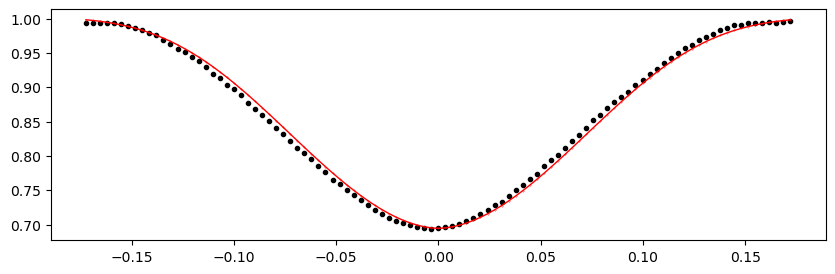

3157.0593870000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.99it/s]


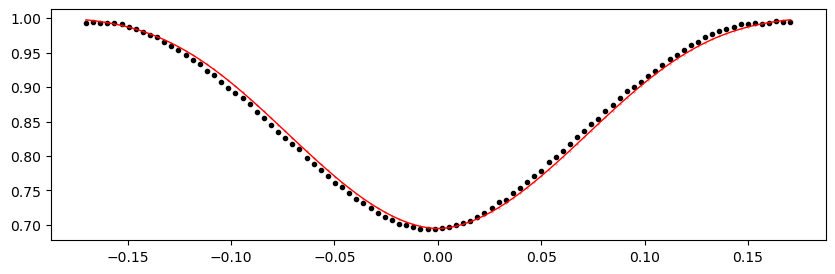

3157.731648 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1350.44it/s]


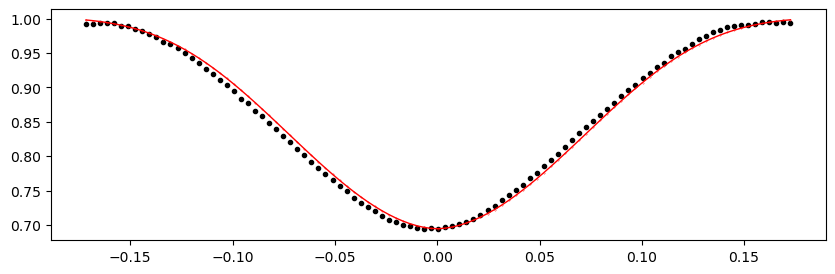

3158.403909 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1334.18it/s]


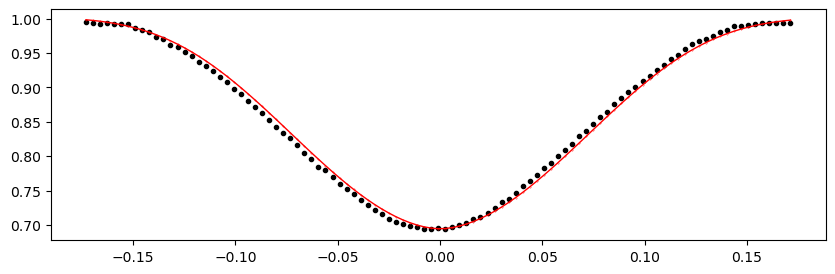

3159.0761700000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.49it/s]


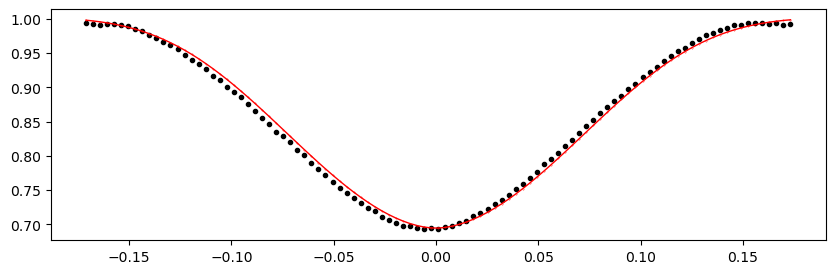

3159.748431 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1341.34it/s]


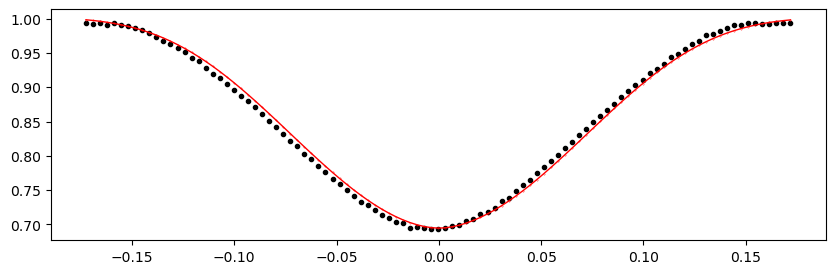

3160.4206919999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.06it/s]


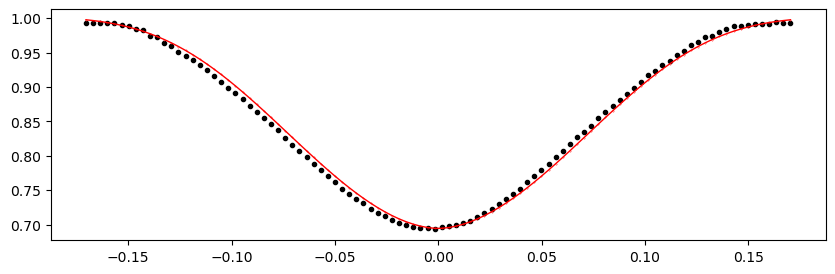

3161.0929530000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.70it/s]


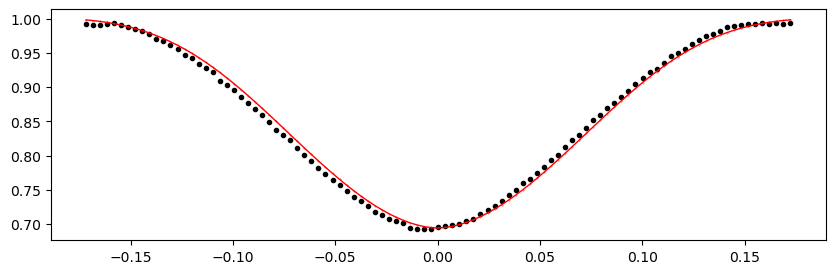

3161.765214 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.01it/s]


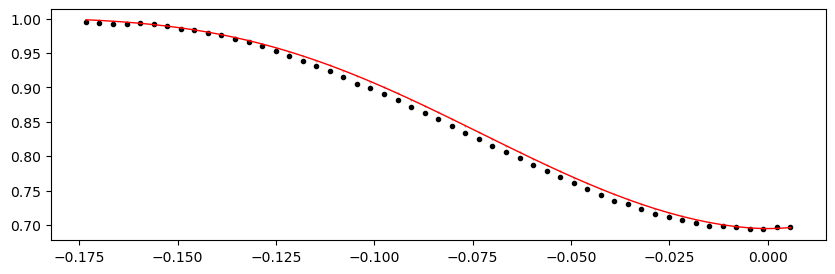

3162.4374749999997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.38it/s]


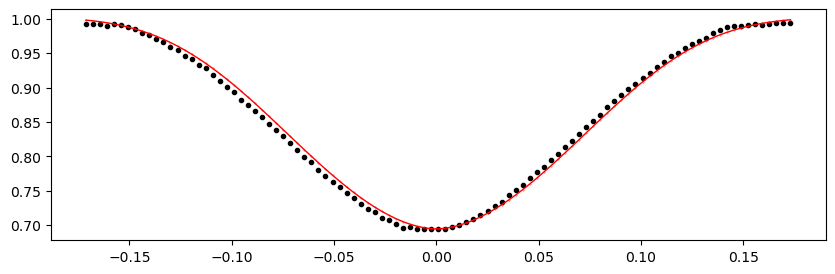

3163.1097360000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1351.37it/s]


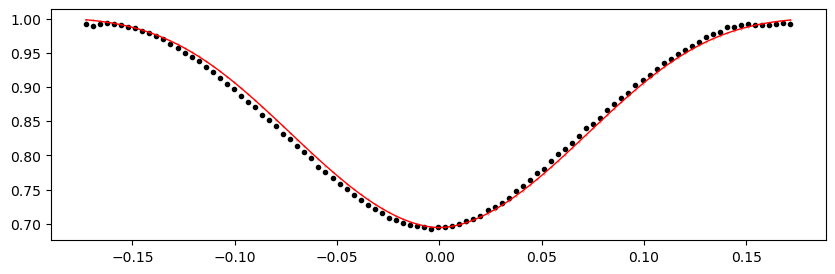

3163.781997 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1323.24it/s]


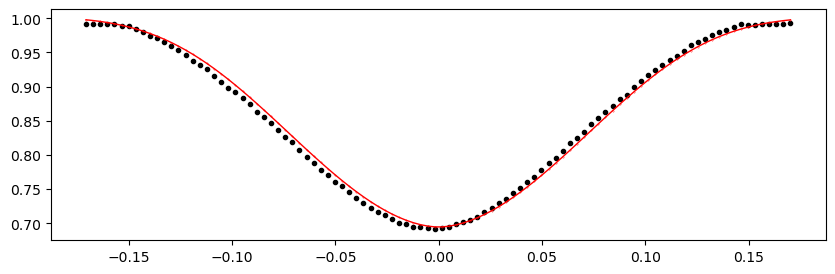

3164.4542579999998 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1336.90it/s]


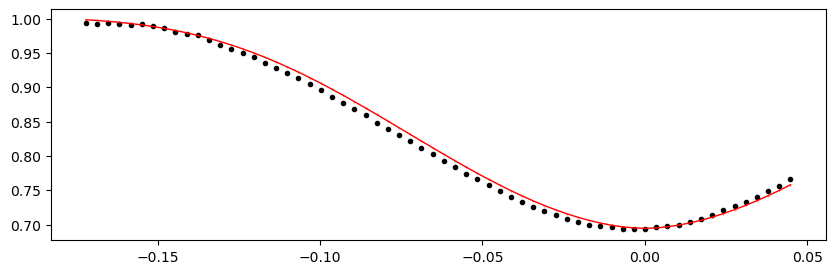

3169.160085 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.63it/s]


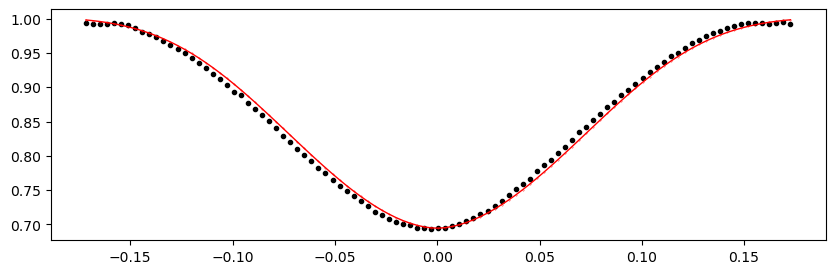

3169.832346 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1324.45it/s]


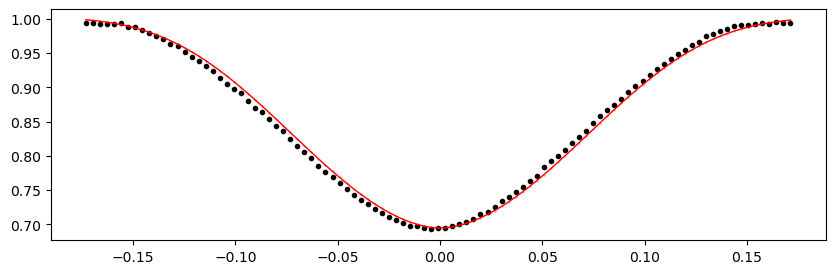

3170.504607 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.16it/s]


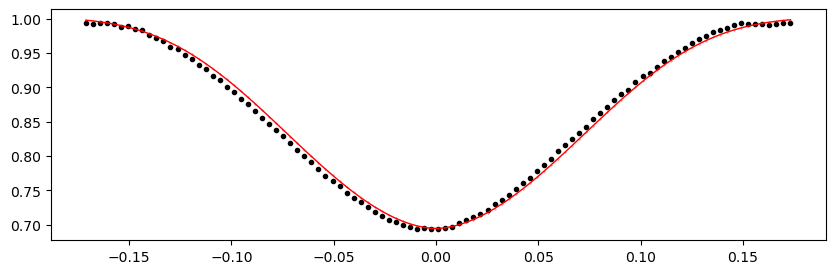

3171.176868 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1354.96it/s]


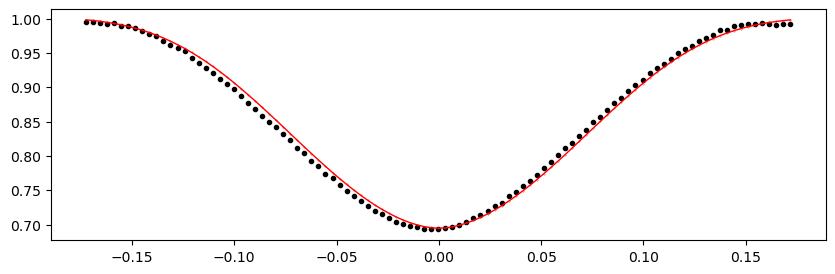

3171.849129 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1344.13it/s]


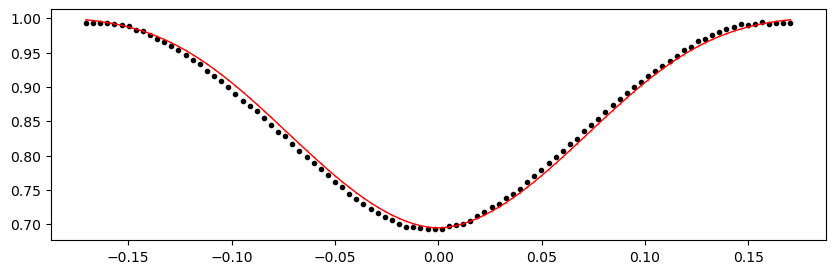

3172.52139 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1353.40it/s]


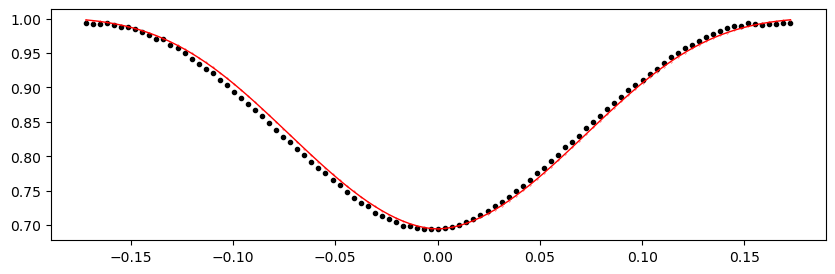

3173.193651 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1346.88it/s]


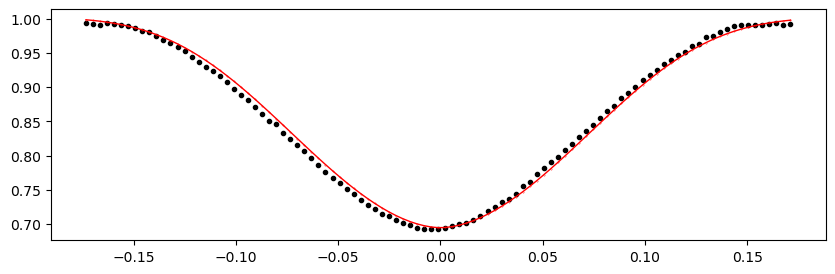

3173.865912 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1335.13it/s]


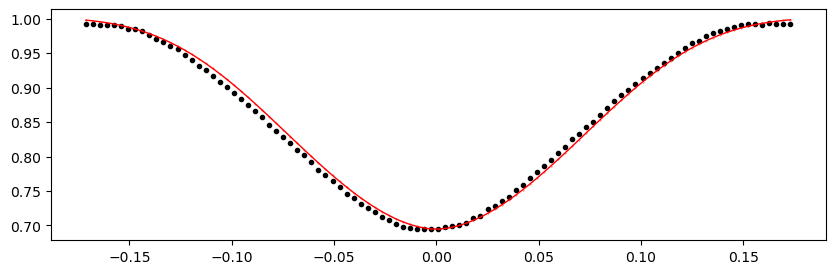

3174.538173 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1340.51it/s]


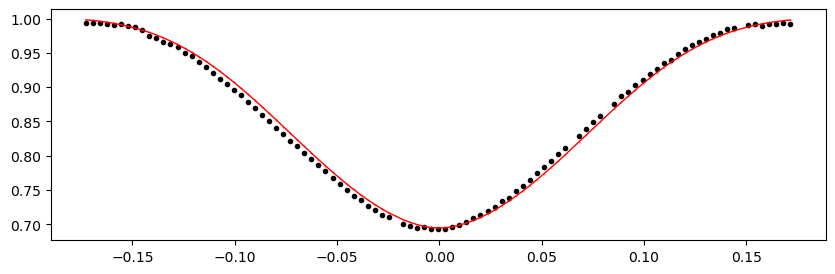

3175.210434 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1348.62it/s]


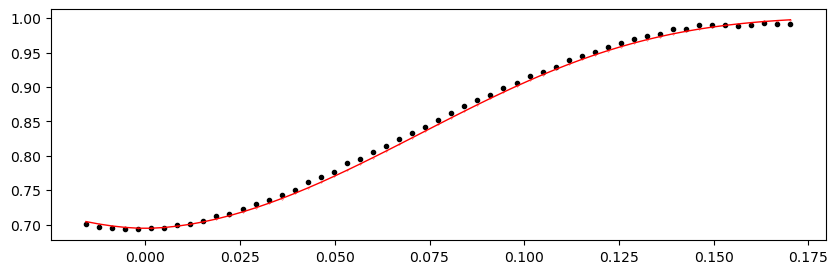

3175.8826950000002 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1337.70it/s]


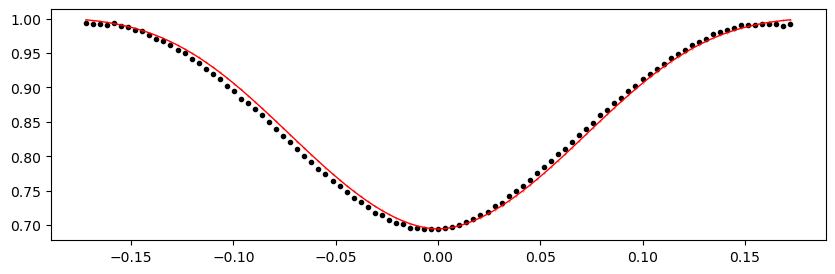

3176.554956 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.68it/s]


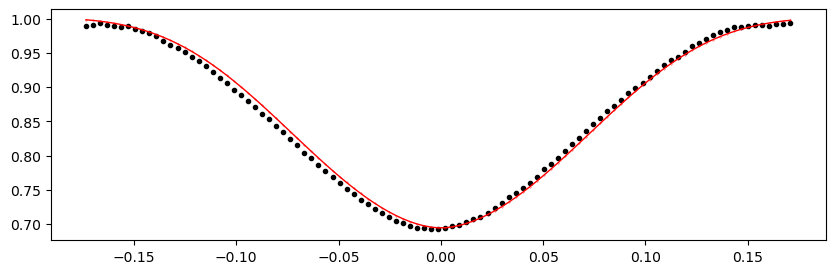

3177.227217 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1345.80it/s]


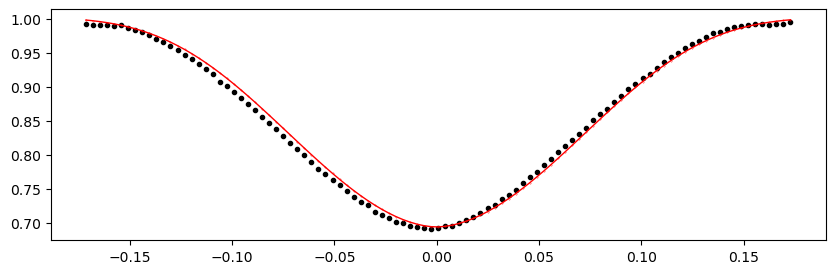

3177.8994780000003 1.0019893158108606 -0.3074318350805525 0.18030609273784778


100%|██████████████████████████████████████████████████████| 10000/10000 [00:07<00:00, 1347.68it/s]


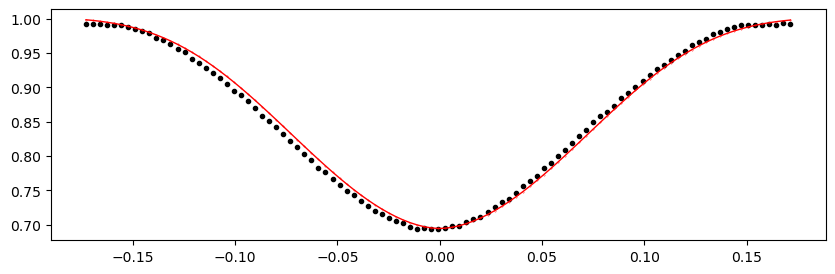

In [78]:
%matplotlib inline

print("Fitting individual primary eclipses...")
etv_functions.fit_each_eclipse(data_primary, n_transits, t0_primary, period, mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau, outfile_path)
!$NOTIFY_CMD "Individual primary eclipses fit done"

In [79]:
%matplotlib inline

if t0_secondary is not None:
    print("Fitting individual secondary eclipses...")
    etv_functions.fit_each_eclipse(data_secondary, n_transits, t0_secondary, period, mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s, outfile_path_s)
    !$NOTIFY_CMD "Individual secondary eclipses fit done"
else:
    print("No secondary eclipses defined. No-Op.")

No secondary eclipses defined. No-Op.


## ETV O-C plot

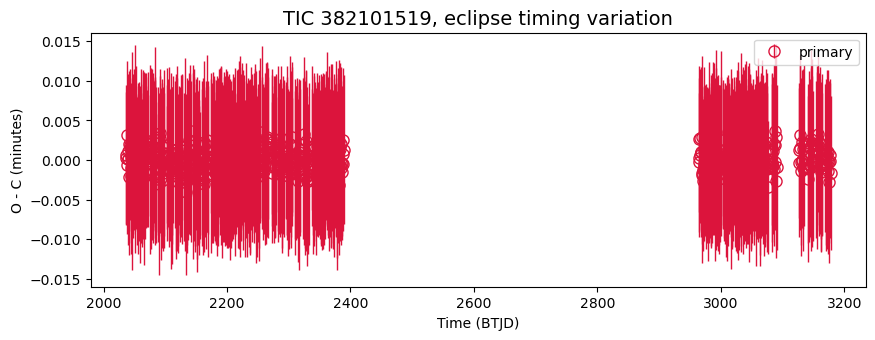

In [84]:
%matplotlib inline
# %matplotlib widget

#plot the extracted transit times to check for ETVs

num_rows = 2 if t0_secondary is not None else 1
figsize_y = 3.3 if num_rows == 1 else num_rows * 3.5

fig, axs = plt.subplots(num_rows, 1, figsize=(10, figsize_y), sharex=True)
if isinstance(axs, plt.Axes):  # handle edge case that num_rows == 1, returned axs is not a list
    axs = [axs]

in_df_primary = pd.read_csv(outfile_path)
in_df_primary['midpoint'] = in_df_primary['epoch'] + (in_df_primary['t0']*period)
in_df_primary['shift_mins'] = in_df_primary['t0']*period*24*60
in_df_primary['std_mins'] = in_df_primary['stdv_t0']*period*24*60


axs[0].errorbar(in_df_primary['epoch'], in_df_primary['shift_mins'], yerr = in_df_primary['std_mins'], 
             lw = 0, marker = 'o', elinewidth = 1, markersize = 8, color = 'None', ecolor='crimson', markeredgecolor = 'crimson', label="primary")

if t0_secondary is not None:
    in_df_secondary = pd.read_csv(outfile_path_s)
    in_df_secondary['midpoint'] = in_df_secondary['epoch'] + (in_df_secondary['t0']*period)
    in_df_secondary['shift_mins'] = in_df_secondary['t0']*period*24*60
    in_df_secondary['std_mins'] = in_df_secondary['stdv_t0']*period*24*60
    axs[1].errorbar(in_df_secondary['epoch'], in_df_secondary['shift_mins'], yerr = in_df_secondary['std_mins'], 
                 lw = 0, marker = 'x', elinewidth = 1, markersize = 9, color = 'navy', zorder = -2, label="secondary" );

for ax in axs:
    ax.set_ylabel("O - C (minutes)")
    ax.legend();

axs[-1].set_xlabel("Time (BTJD)")
axs[0].set_title(f"TIC {ticid}, eclipse timing variation", fontsize=14)

plt.subplots_adjust(hspace=0.05)
plt.show()

## make a periodogram 

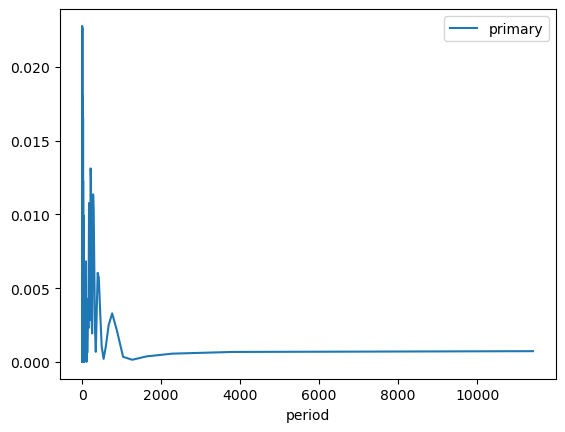

In [85]:
frequency, power = LombScargle(in_df_primary['epoch'], in_df_primary['shift_mins']).autopower()

fig, ax = plt.subplots()

plt.plot(1/frequency, power, label = 'primary')    

if t0_secondary is not None:
    frequency_s, power_s = LombScargle(in_df_secondary['epoch'], in_df_secondary['shift_mins']).autopower()
    plt.plot(1/frequency_s, power_s, label = 'secondary')    

plt.xlabel("period")

plt.legend()
plt.show()

## Results Summary

In [101]:
# FILL-IN the ETV results / comments
has_etv = "N"
comments = "included 7 sectors of 200s TESS-SPOC data to increase the time span"

# Eclipse depth from the model
depth_pct_p = round(-mean_alpha1 * 100, 2)
if t0_secondary is not None:
    depth_pct_s = round(-mean_alpha1_s * 100, 2)
else:
    depth_pct_s = None

summary = {
    "tic": ticid,
    "has_etv": has_etv,
    "comments": comments,
    "period": period,  # the period used in ETV analysis
    "depth_pct_p": depth_pct_p,
    "depth_pct_s": depth_pct_s,
    "epoch_p": t0_primary,
    "epoch_s": t0_secondary,
    "num_sectors": len(sr),
    "time_span": round(time[-1] - time[0], 2),
    "time_start": round(time[0], 2),
    "time_end": round(time[-1], 2),
}

summary = pd.DataFrame.from_dict(summary, orient="index")
with pd.option_context('display.max_colwidth', None, 'display.max_rows', 999, 'display.max_columns', 99):
    display(summary);

# Single line to be added to a CSV
print("")
print(summary.transpose().to_csv(
    index=False,
    header=True, 
))

,0
tic,382101519
has_etv,N
comments,included 7 sectors of 200s TESS-SPOC data to increase the time span
period,0.672261
depth_pct_p,30.74
depth_pct_s,None
epoch_p,2036.4003
epoch_s,None
num_sectors,20
time_span,1145.86



tic,has_etv,comments,period,depth_pct_p,depth_pct_s,epoch_p,epoch_s,num_sectors,time_span,time_start,time_end
382101519,N,included 7 sectors of 200s TESS-SPOC data to increase the time span,0.672261,30.74,,2036.4003,,20,1145.86,2036.28,3182.14

